# GUC Clustering Project 

**Objective:** 
The objective of this project teach students how to apply clustering to real data sets

The projects aims to teach student: 
* Which clustering approach to use
* Compare between Kmeans, Hierarchal, DBScan, and Gaussian Mixtures  
* How to tune the parameters of each data approach
* What is the effect of different distance functions (optional) 
* How to evaluate clustering approachs 
* How to display the output
* What is the effect of normalizing the data 

Students in this project will use ready-made functions from Sklearn, plotnine, numpy and pandas 
 



In [1]:
# !pip install plotnine

Running this project require the following imports 

In [2]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns 
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import sklearn.preprocessing as prep
from sklearn.datasets import make_blobs
from sklearn.cluster import AgglomerativeClustering, KMeans, DBSCAN
from sklearn.metrics import silhouette_score
from scipy.cluster.hierarchy import dendrogram, linkage
from plotnine import *   
# StandardScaler is a function to normalize the data 
# You may also check MinMaxScaler and MaxAbsScaler 
#from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import NearestNeighbors

from sklearn.mixture import GaussianMixture

%matplotlib inline

In [3]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X,km=[],num_clusters=0):
    color = ['Red', 'Blue', 'Green', 'Yellow', 'Purple', 'Orange', 'Pink', 'Brown', 'White', 'Gray', 'Cyan', 'Magenta', 'Turquoise', 'Olive', 'Maroon', 'Navy', 'Teal', 'Lavender', 'Salmon', 'Gold', 'Silver', 'Lime', 'Tan', 'Beige', 'Indigo', 'Violet', 'Crimson', 'Fuchsia', 'Black']
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        for i in range(-1,num_clusters,1):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i%len(color)],alpha = alpha,s=s)
#             plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

def display_cluster_gmm(X, gmm=None, num_clusters=0):
    color = ['Red', 'Blue', 'Green', 'Yellow', 'Purple', 'Orange', 'Pink', 'Brown', 'White', 'Gray', 'Cyan', 'Magenta', 'Turquoise', 'Olive', 'Maroon', 'Navy', 'Teal', 'Lavender', 'Salmon', 'Gold', 'Silver', 'Lime', 'Tan', 'Beige', 'Indigo', 'Violet', 'Crimson', 'Fuchsia', 'Black']
    alpha = 0.5  #color obaque
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
        labels = gmm.predict(X)
        for i in range(num_clusters):
            plt.scatter(X[labels==i,0],X[labels==i,1],c = color[i%len(color)],alpha = alpha,s=s)
#             plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)


## Multi Blob Data Set 
* The Data Set generated below has 6 cluster with varying number of users and varing densities
* Cluster the data set below using 



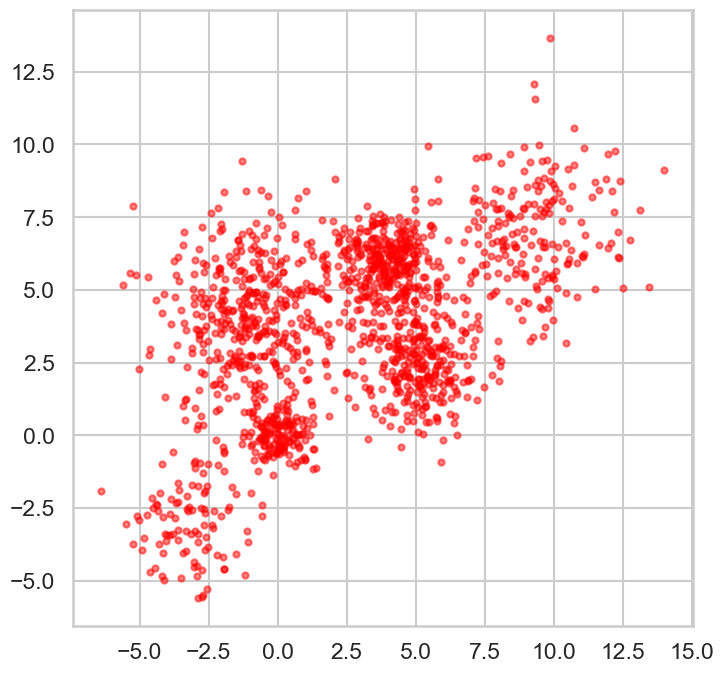

In [4]:
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")

n_bins = 6  
centers = [(-3, -3), (0, 0), (5,2.5),(-1, 4), (4, 6), (9,7)]
Multi_blob_Data, y = make_blobs(n_samples=[100,150, 300, 400,300, 200], n_features=2, cluster_std=[1.3,0.6, 1.2, 1.7,0.9,1.7],
                  centers=centers, shuffle=False, random_state=42)
display_cluster(Multi_blob_Data)

### Kmeans 
* Use Kmeans with different values of K to cluster the above data 
* Display the outcome of each value of K 
* Plot distortion function versus K and choose the approriate value of k 
* Plot the silhouette_score versus K and use it to choose the best K 
* Store the silhouette_score for the best K for later comparison with other clustering techniques. 

In [5]:
df_copy = np.array(None)

def kmeans(data,n_clusters):

        global df_copy 
        df_copy= data.copy()
        # create an instance of the KMeans class
        kmeans = KMeans(n_clusters)

        # fit the model to the data
        kmeans.fit(data)

        # get the labels of the clusters
        labels = kmeans.labels_

        # get the centroids of the clusters
        centroids = kmeans.cluster_centers_
        
        return kmeans

KMeans(n_clusters=1)
KMeans(n_clusters=2)
KMeans(n_clusters=3)
KMeans(n_clusters=4)
KMeans(n_clusters=5)
KMeans(n_clusters=6)
KMeans(n_clusters=7)
KMeans()
KMeans(n_clusters=9)
KMeans(n_clusters=10)


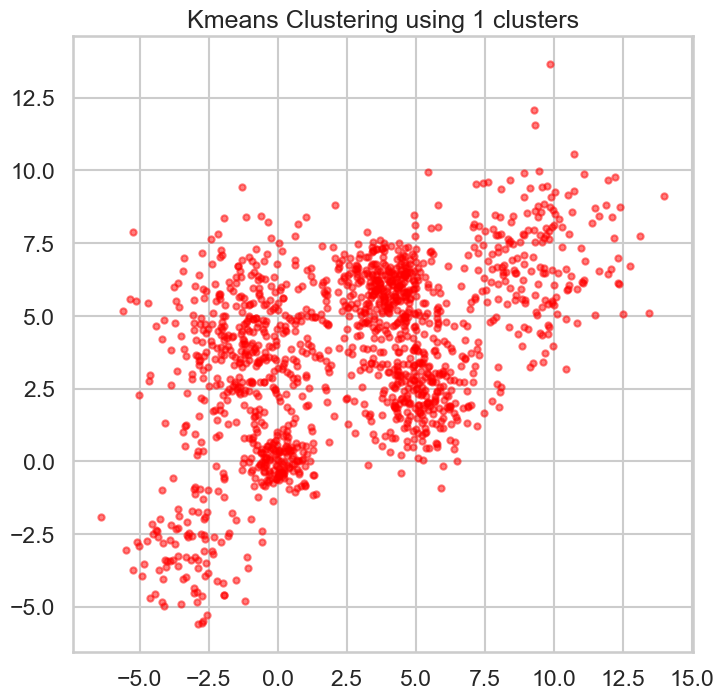

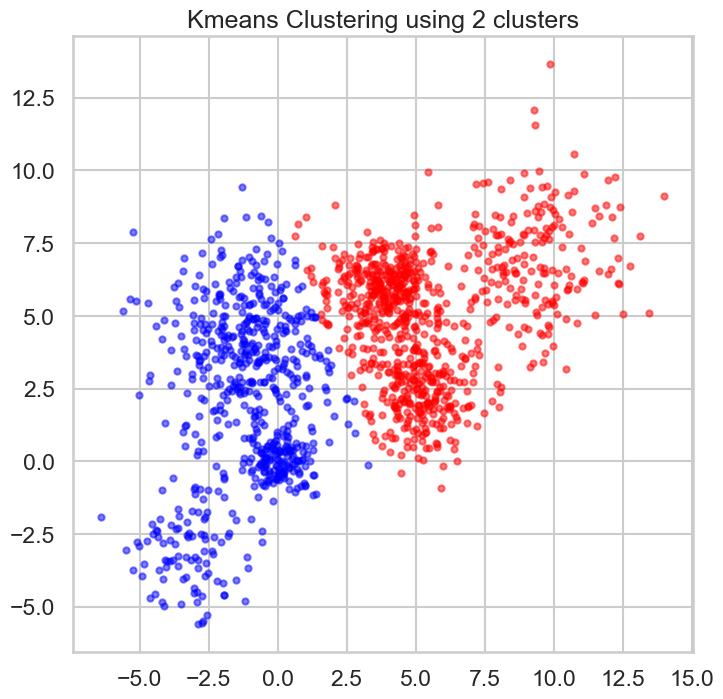

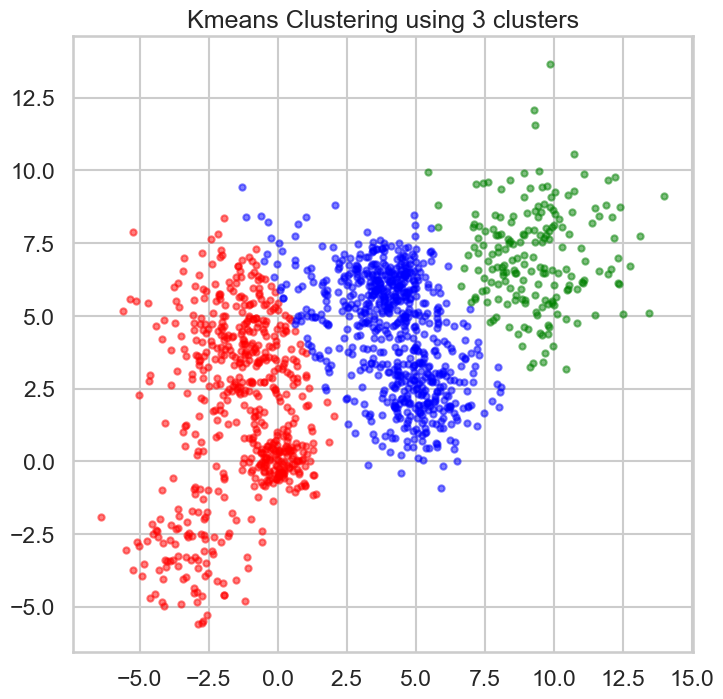

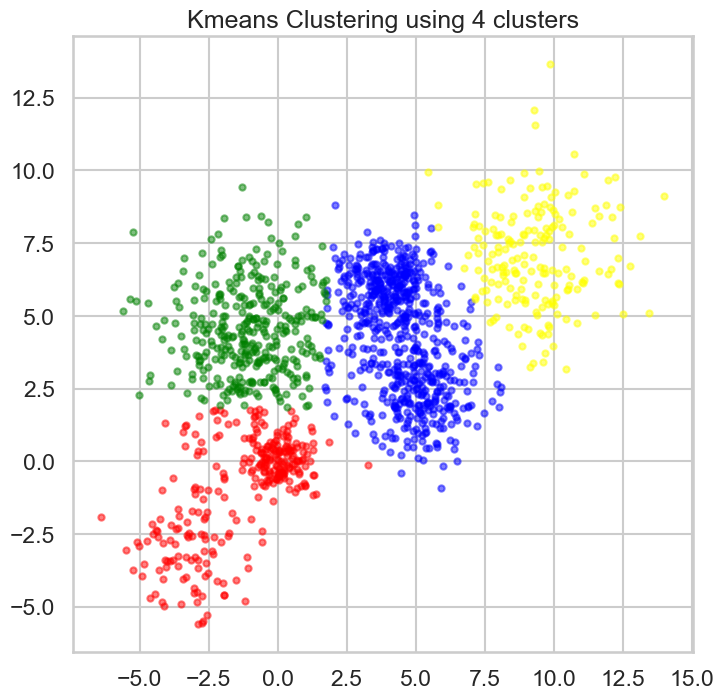

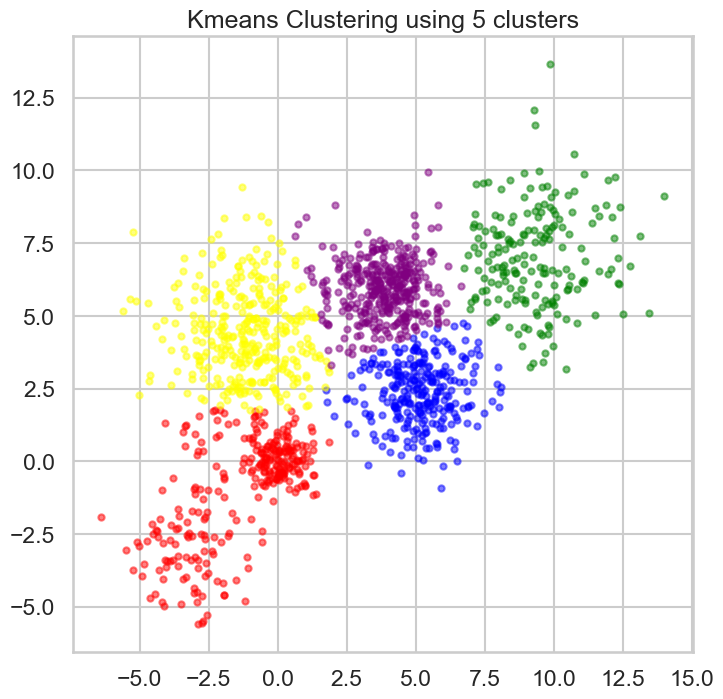

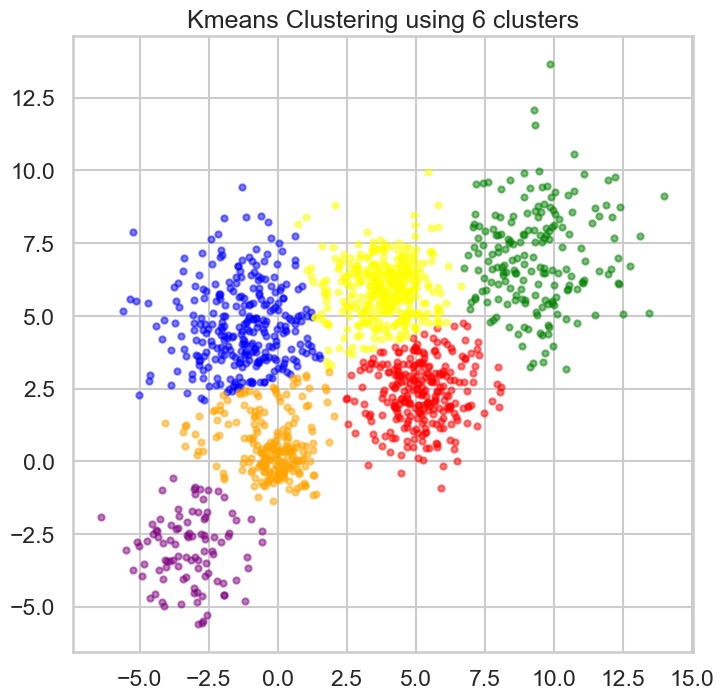

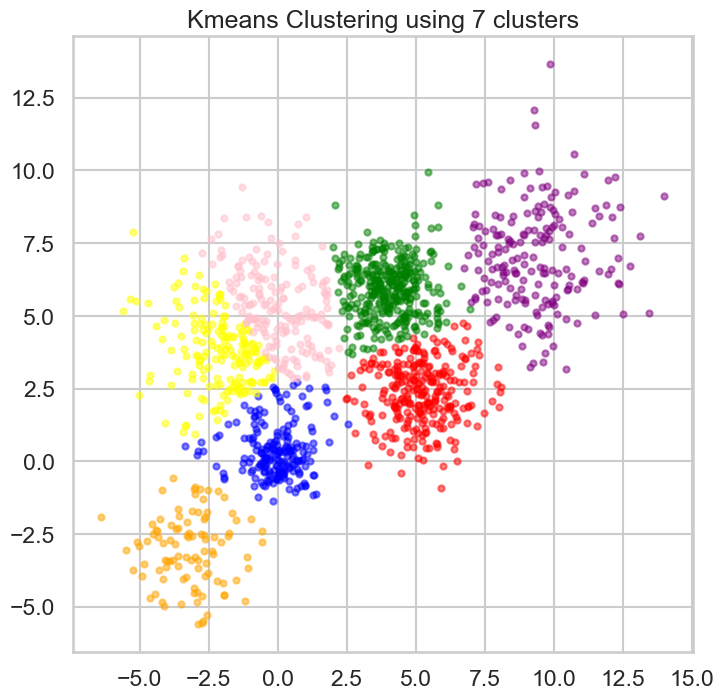

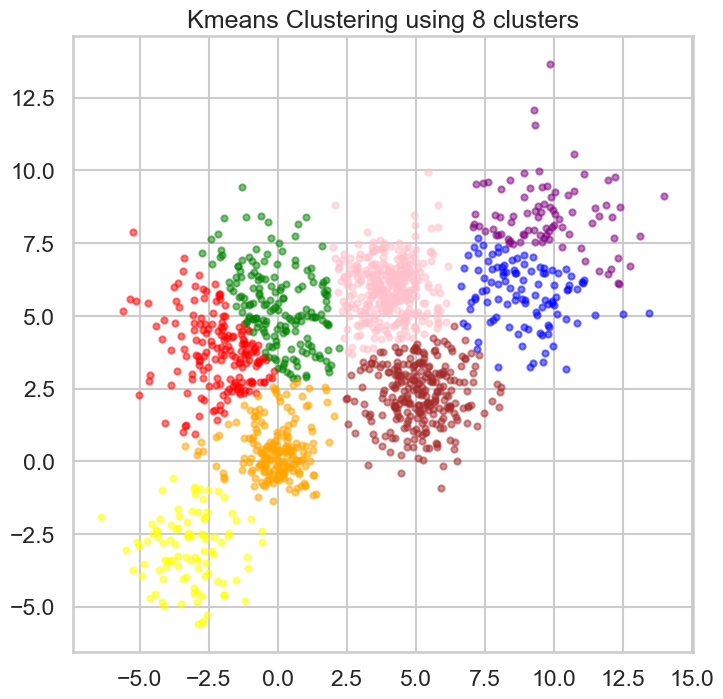

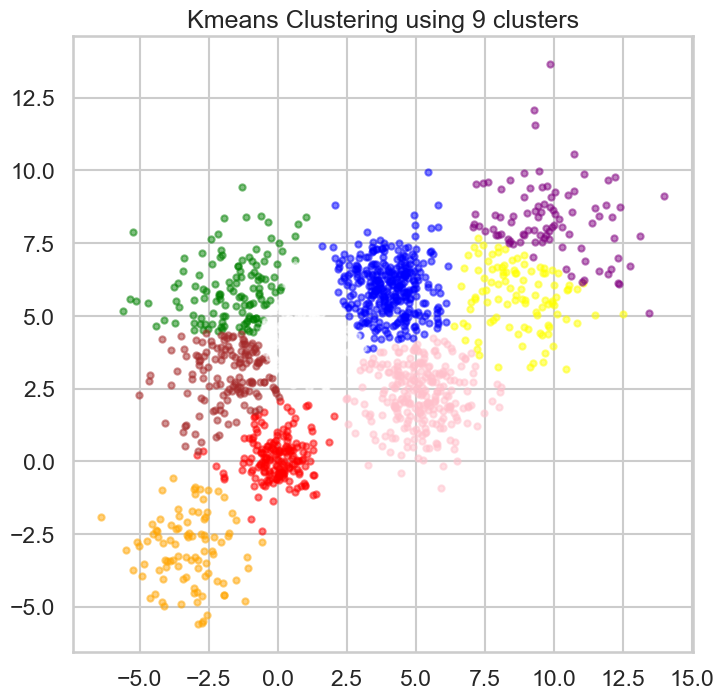

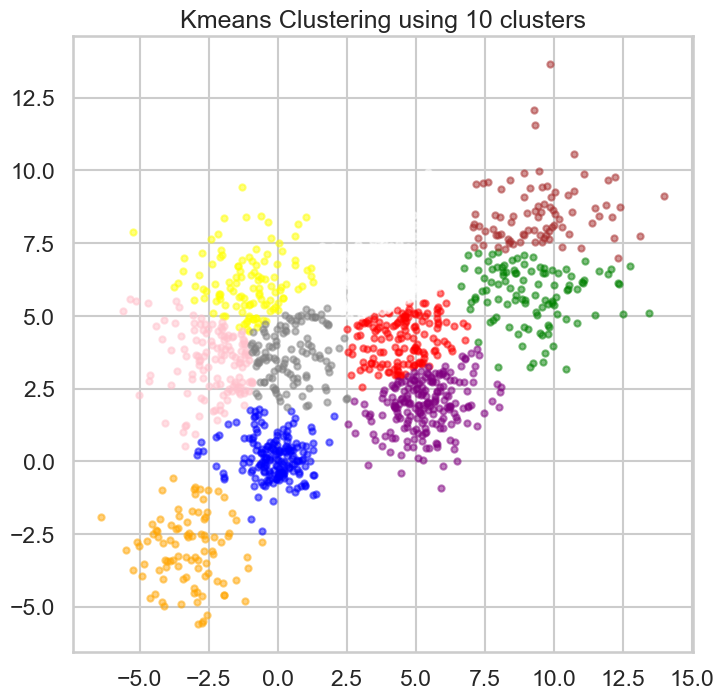

In [6]:
Kmeans_output = []

for i in range(10):
    km = kmeans(pd.DataFrame(Multi_blob_Data), i+1)
    
    print(km)

    plt.figure()
    plt.title(f'Kmeans Clustering using {i+1} clusters')
    display_cluster(df_copy.to_numpy(copy=True), km, i+1)
    
    Kmeans_output.append(km)

### Hierarchal Clustering
* Use AgglomerativeClustering function to  to cluster the above data 
* In the  AgglomerativeClustering change the following parameters 
    * Affinity (use euclidean, manhattan and cosine)
    * Linkage( use average and single )
    * Distance_threshold (try different)
* For each of these trials plot the Dendograph , calculate the silhouette_score and display the resulting clusters  
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observation 

In [7]:
df = pd.DataFrame(Multi_blob_Data).copy()
# print(df[0][0])
# display_cluster(X.to_numpy(copy=True), X,model.n_clusters_)


def agg_clus(data,num_clusters = None, affinity='euclidean', linkage_type='average', distance_threshold=1.0):
    df_copy = data.copy()
    model = AgglomerativeClustering(n_clusters=num_clusters, affinity=affinity, linkage=linkage_type, distance_threshold=distance_threshold)
    model.fit(data)
    
    return model

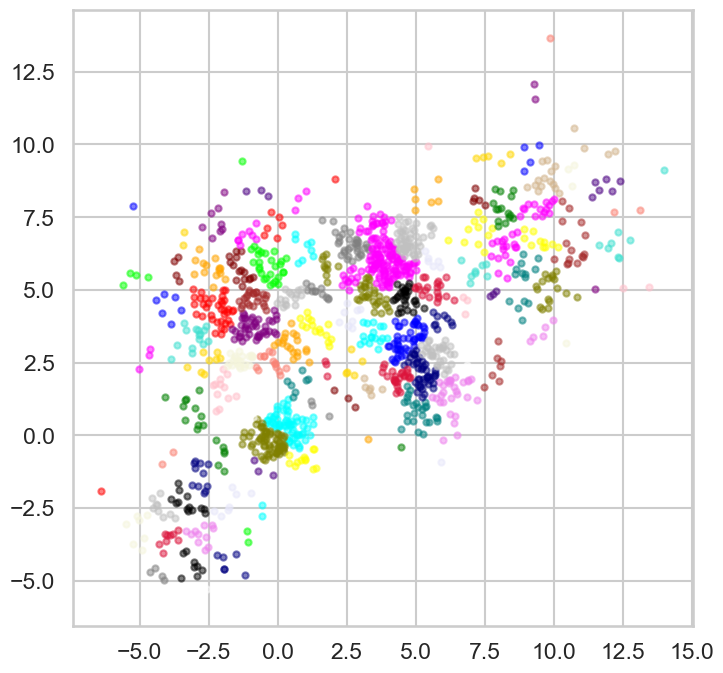

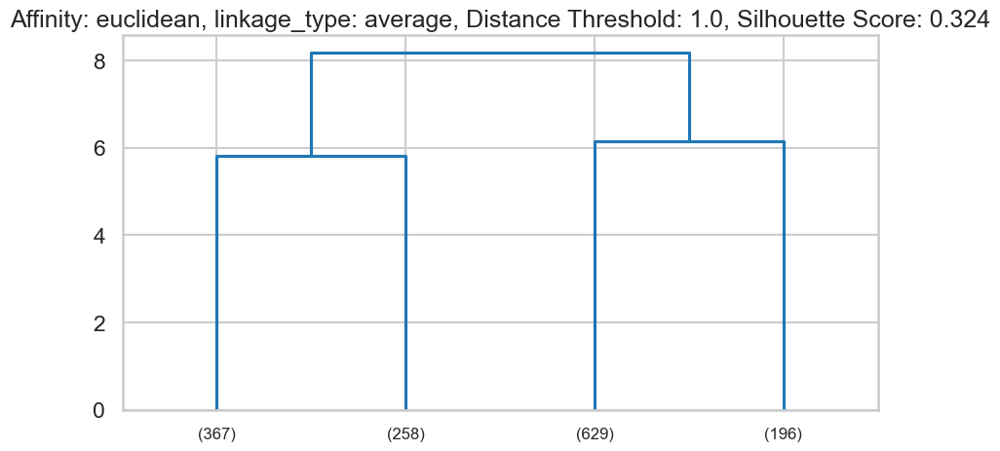

Affinity: euclidean, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.324
[112  89 112 ...  76  93  31]


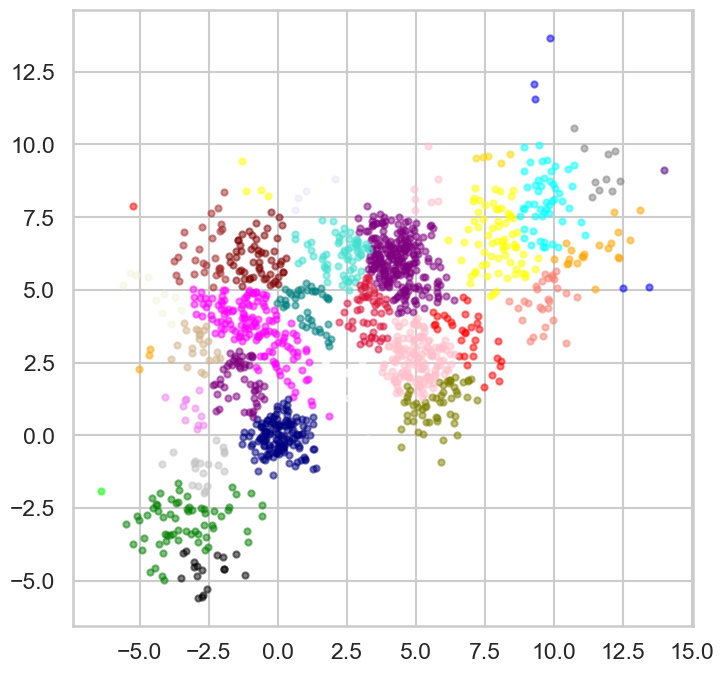

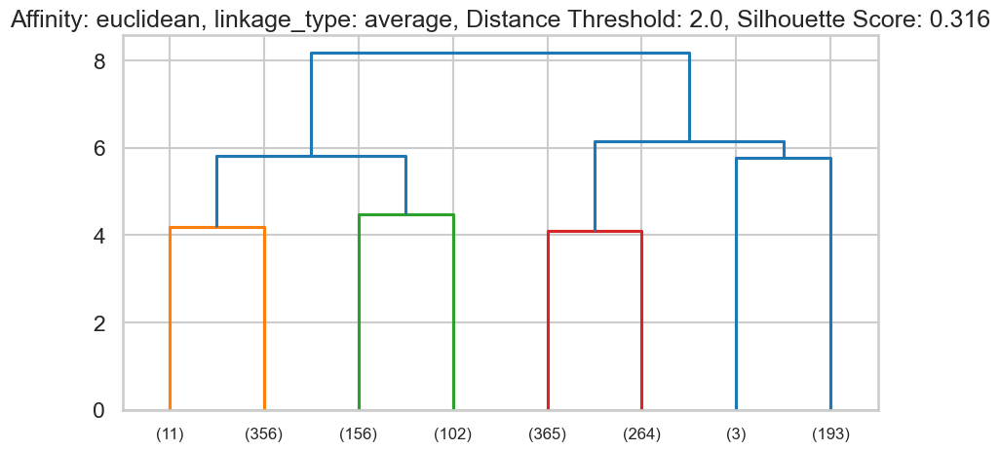

Affinity: euclidean, linkage_type: average, Distance Threshold: 2.0, Silhouette Score: 0.316
[ 2 20  2 ...  1  6  3]


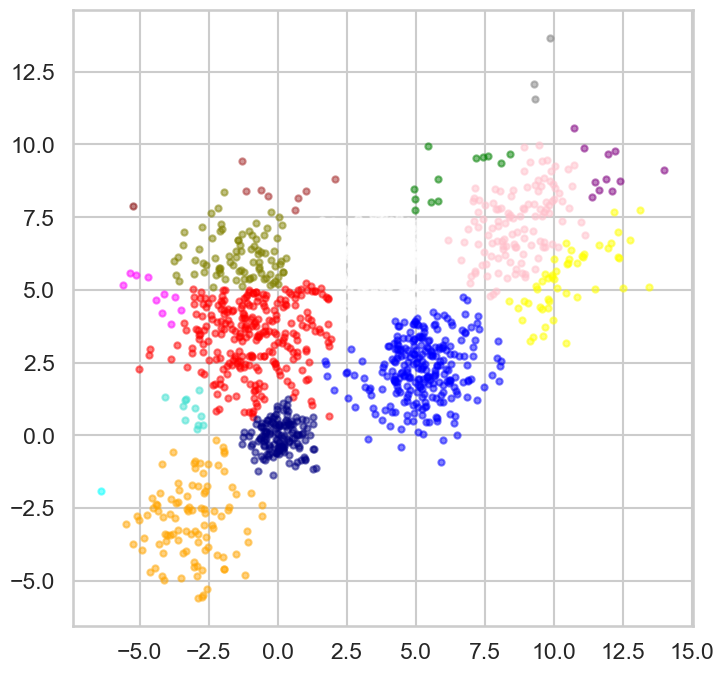

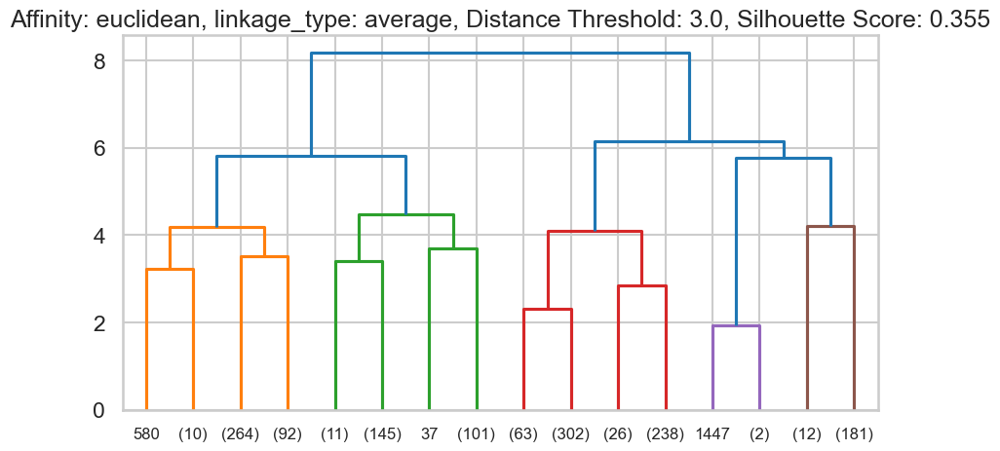

Affinity: euclidean, linkage_type: average, Distance Threshold: 3.0, Silhouette Score: 0.355
[5 5 5 ... 9 2 6]


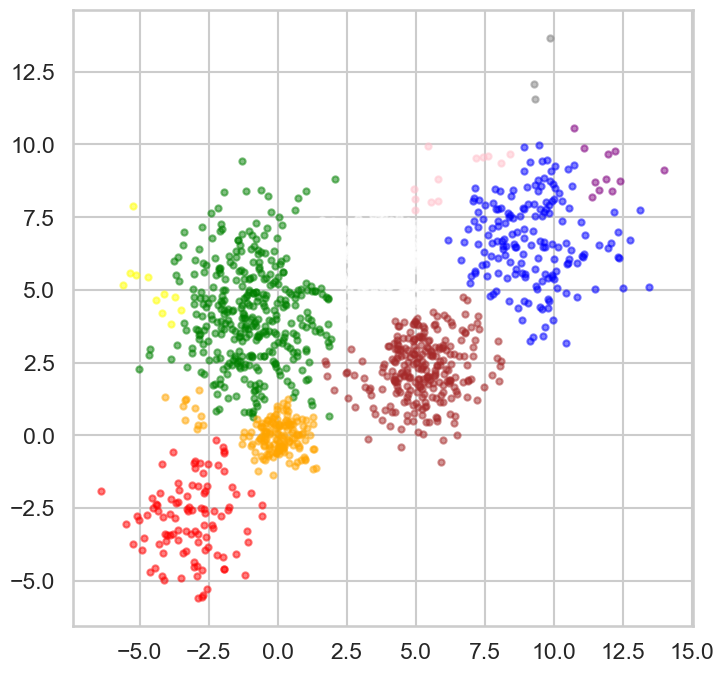

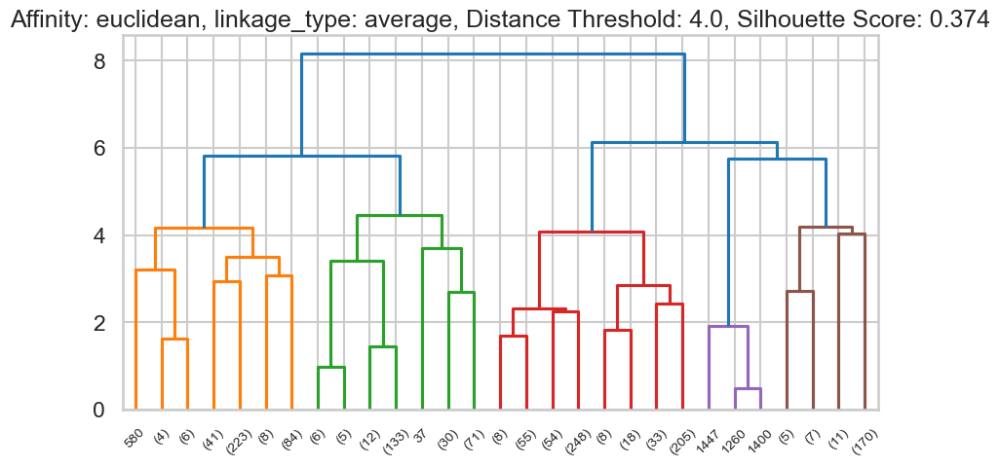

Affinity: euclidean, linkage_type: average, Distance Threshold: 4.0, Silhouette Score: 0.374
[0 0 0 ... 9 6 1]


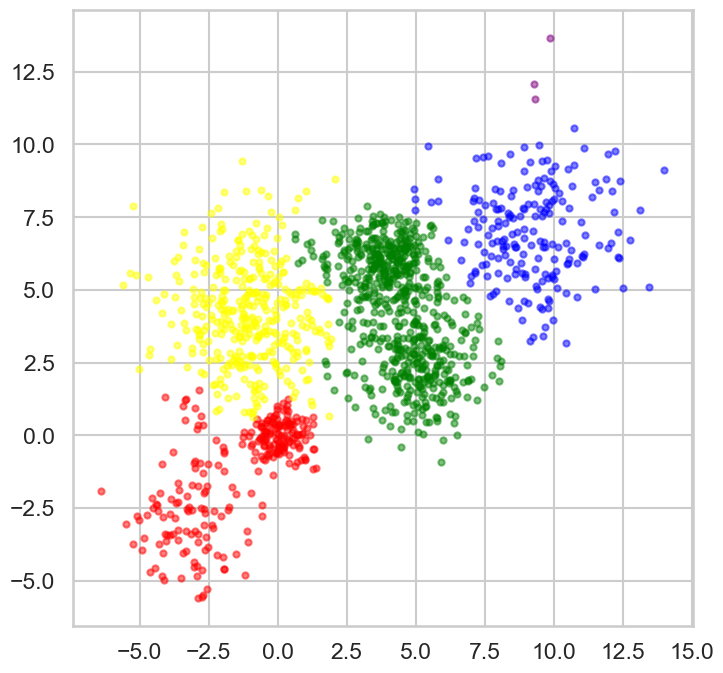

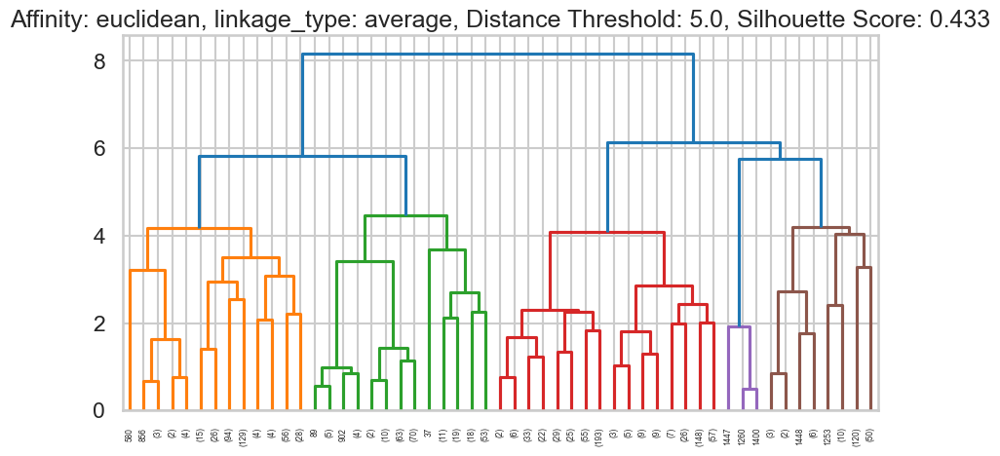

Affinity: euclidean, linkage_type: average, Distance Threshold: 5.0, Silhouette Score: 0.433
[0 0 0 ... 4 1 1]


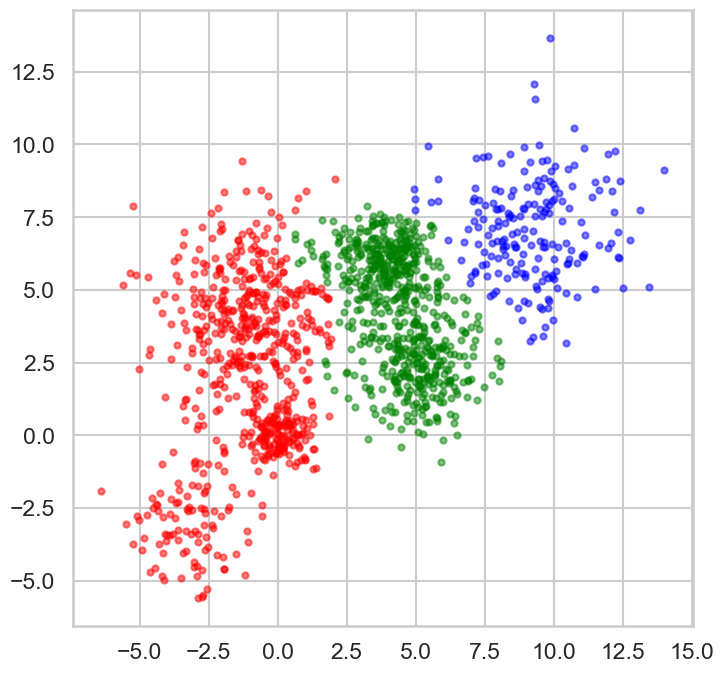

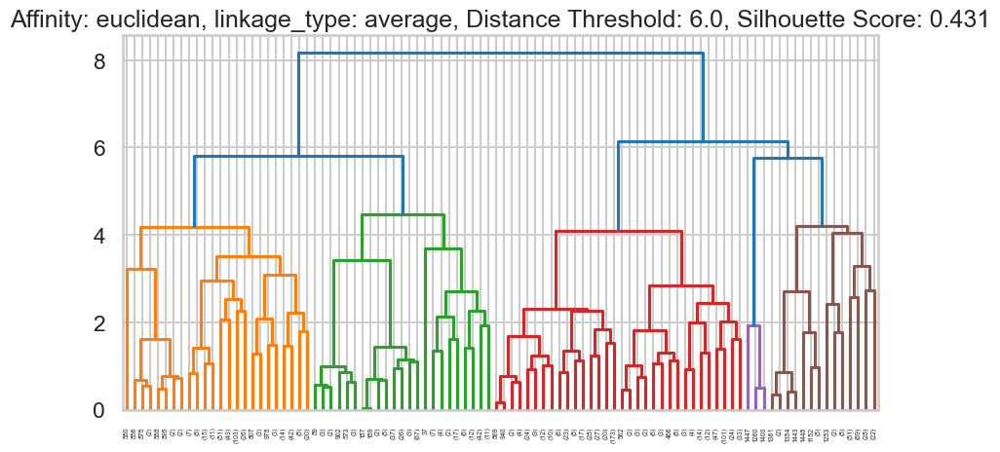

Affinity: euclidean, linkage_type: average, Distance Threshold: 6.0, Silhouette Score: 0.431
[0 0 0 ... 1 1 1]


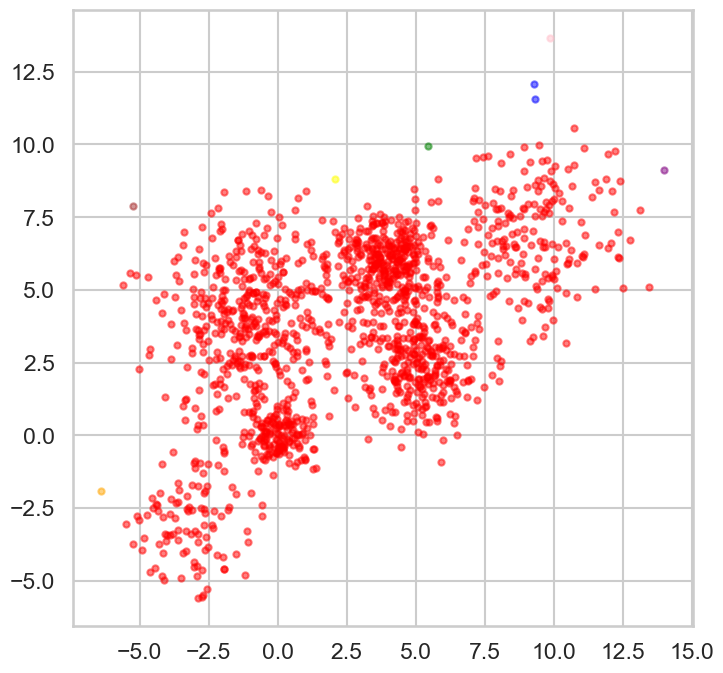

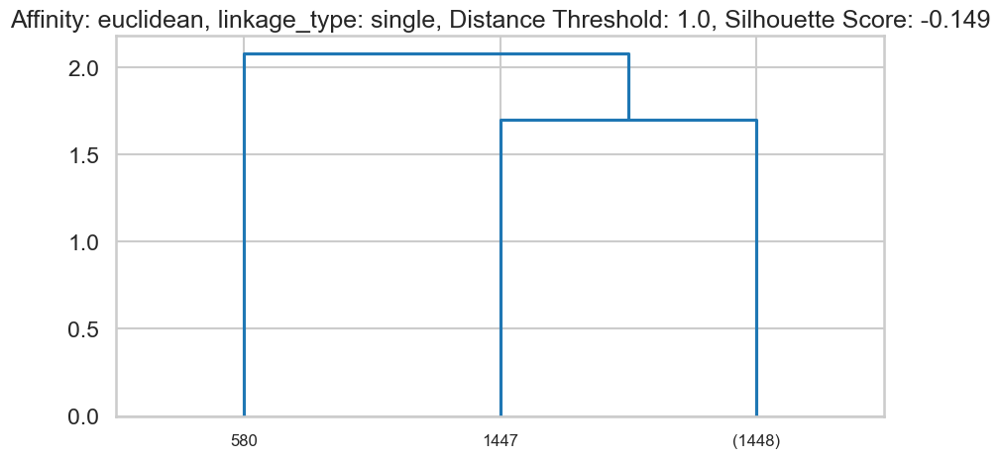

Affinity: euclidean, linkage_type: single, Distance Threshold: 1.0, Silhouette Score: -0.149
[0 0 0 ... 6 2 0]


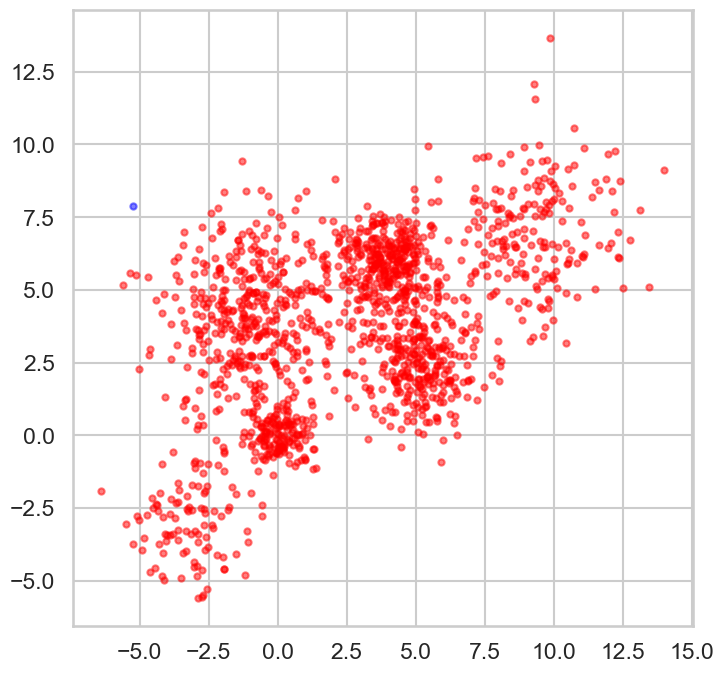

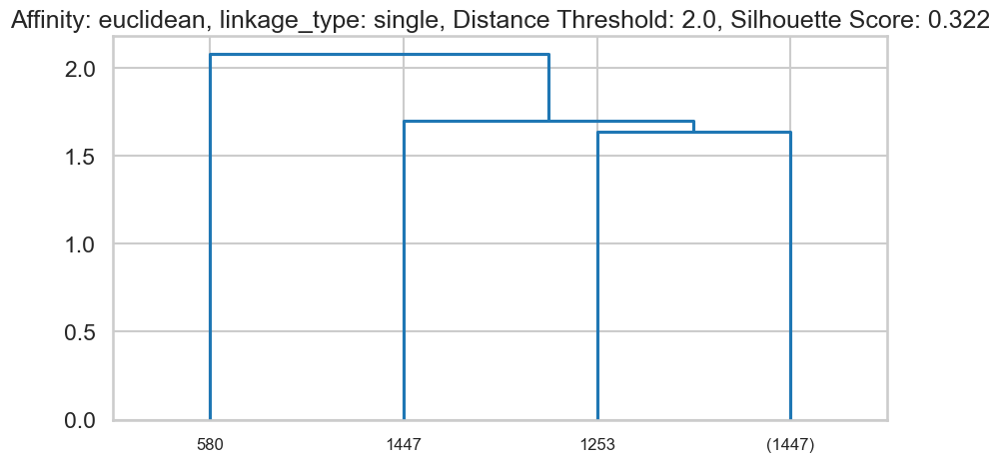

Affinity: euclidean, linkage_type: single, Distance Threshold: 2.0, Silhouette Score: 0.322
[0 0 0 ... 0 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


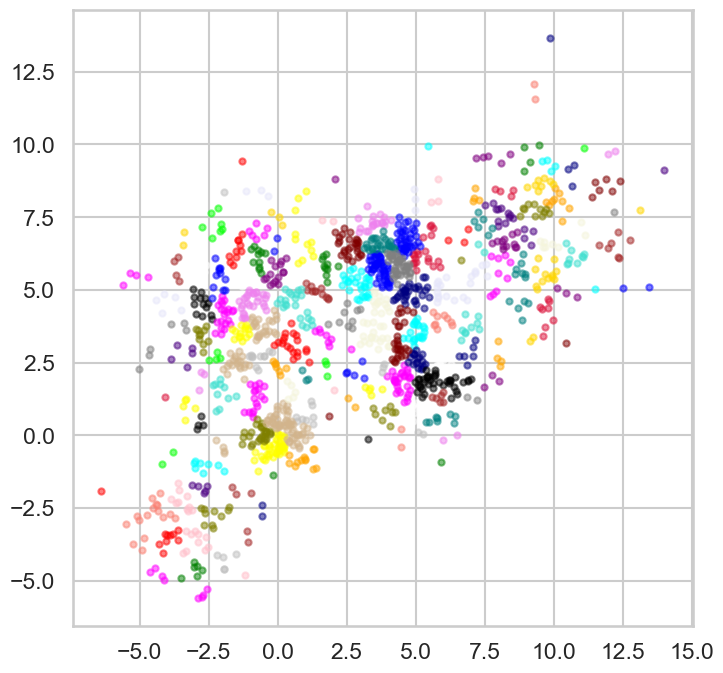

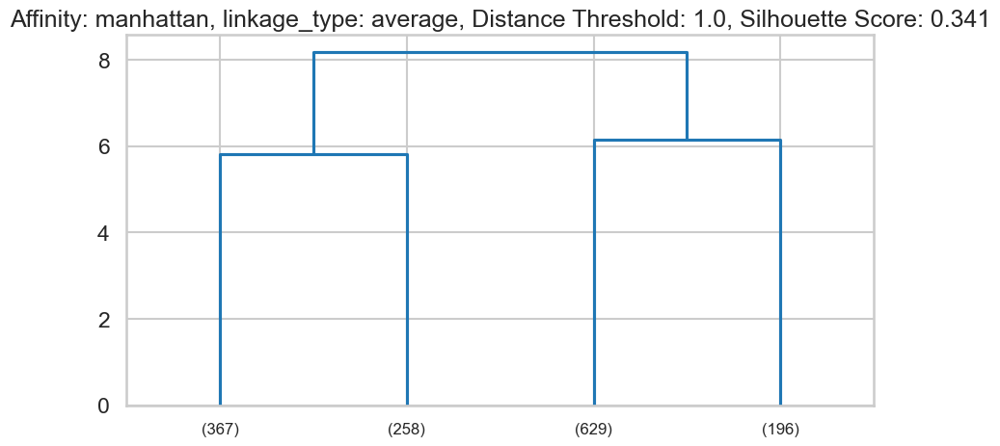

Affinity: manhattan, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.341
[ 13  39   6 ... 160  97  24]


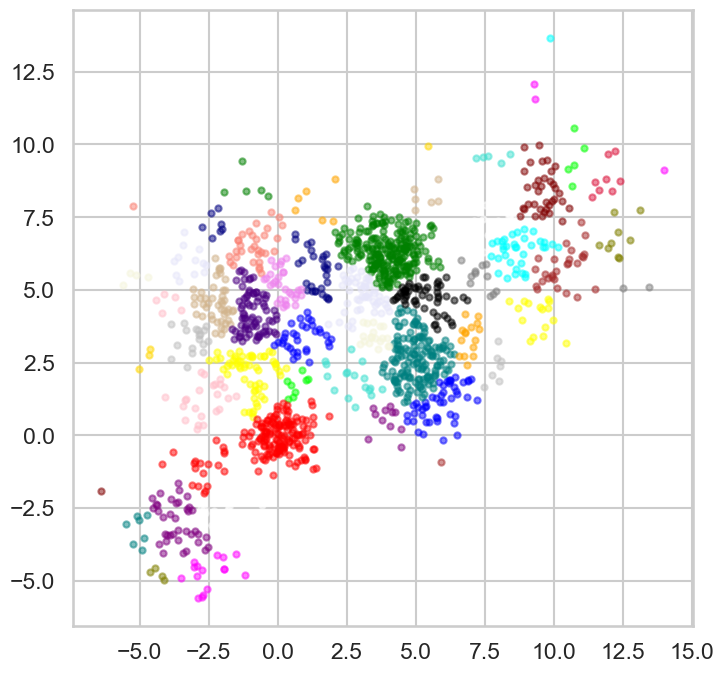

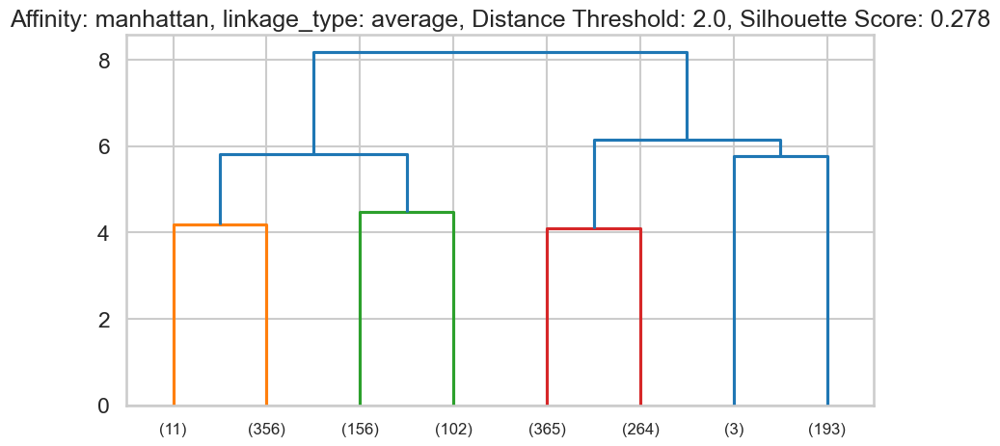

Affinity: manhattan, linkage_type: average, Distance Threshold: 2.0, Silhouette Score: 0.278
[ 8  0  4 ... 39 48 37]


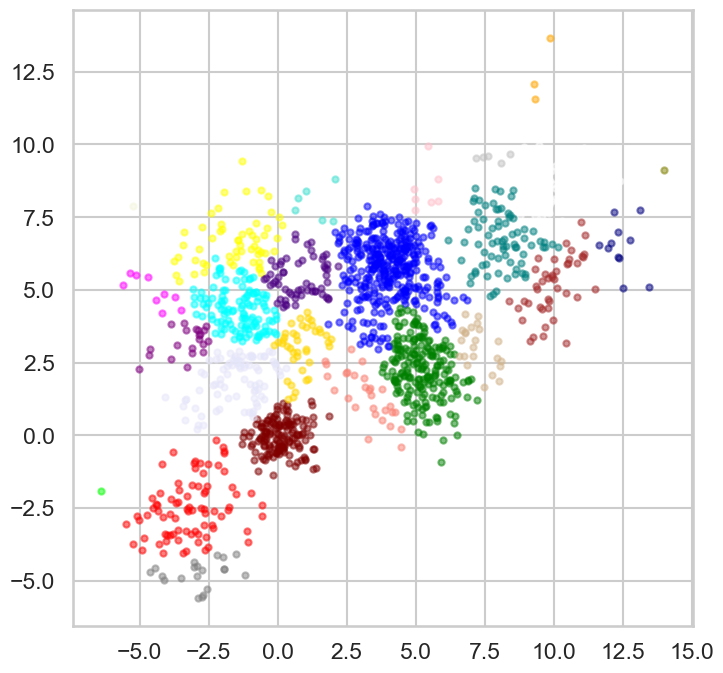

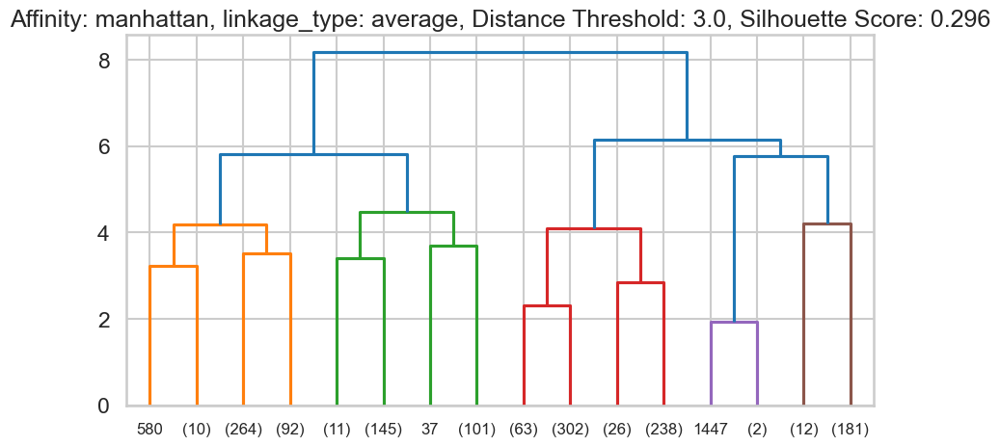

Affinity: manhattan, linkage_type: average, Distance Threshold: 3.0, Silhouette Score: 0.296
[ 0  0  0 ...  5  6 16]


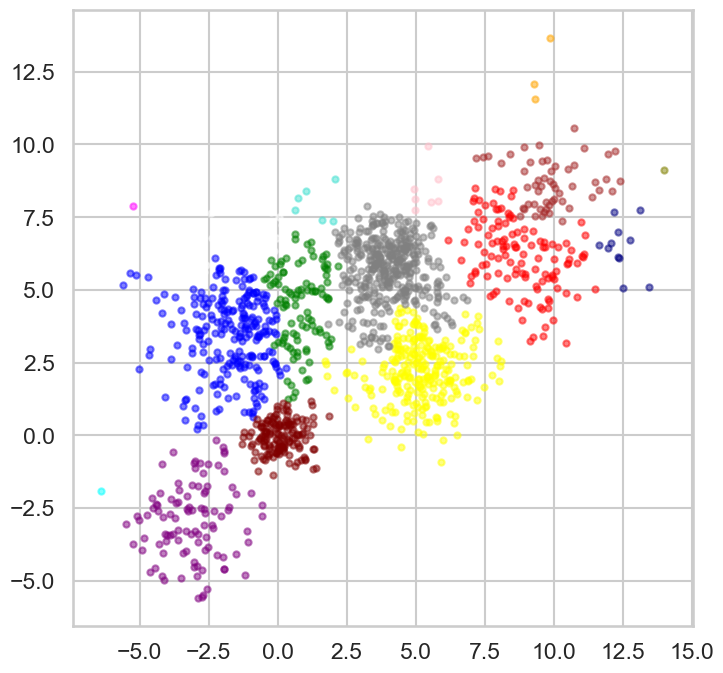

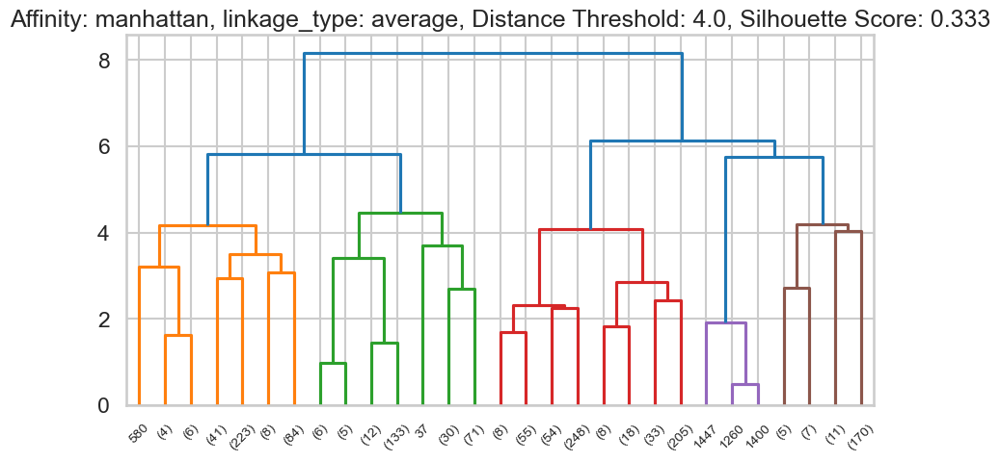

Affinity: manhattan, linkage_type: average, Distance Threshold: 4.0, Silhouette Score: 0.333
[4 4 4 ... 5 6 0]


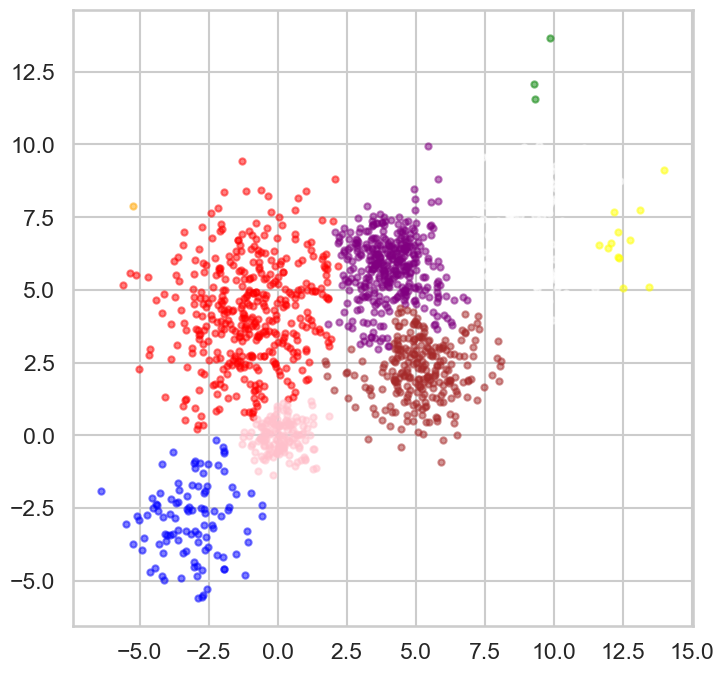

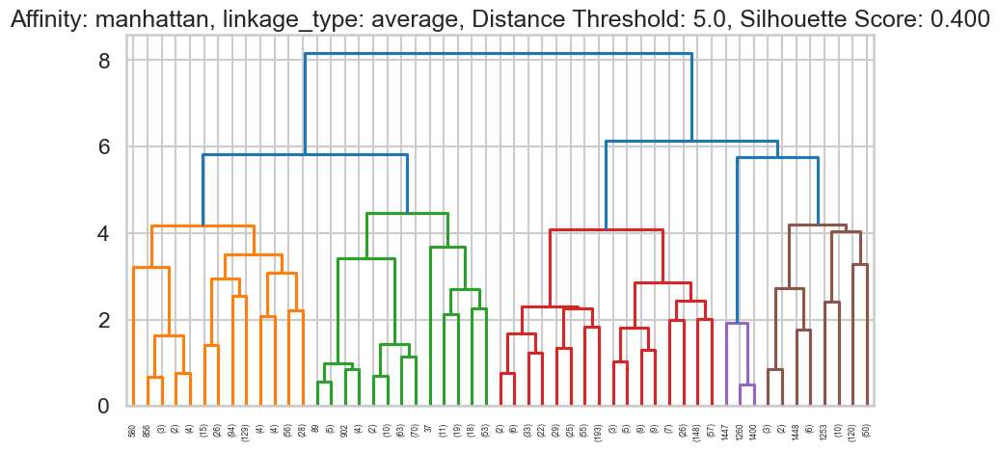

Affinity: manhattan, linkage_type: average, Distance Threshold: 5.0, Silhouette Score: 0.400
[1 1 1 ... 2 4 8]


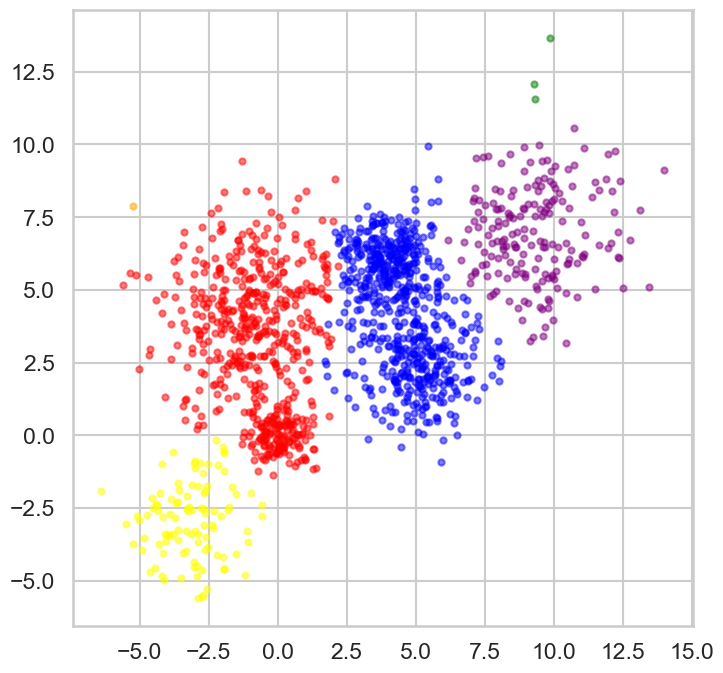

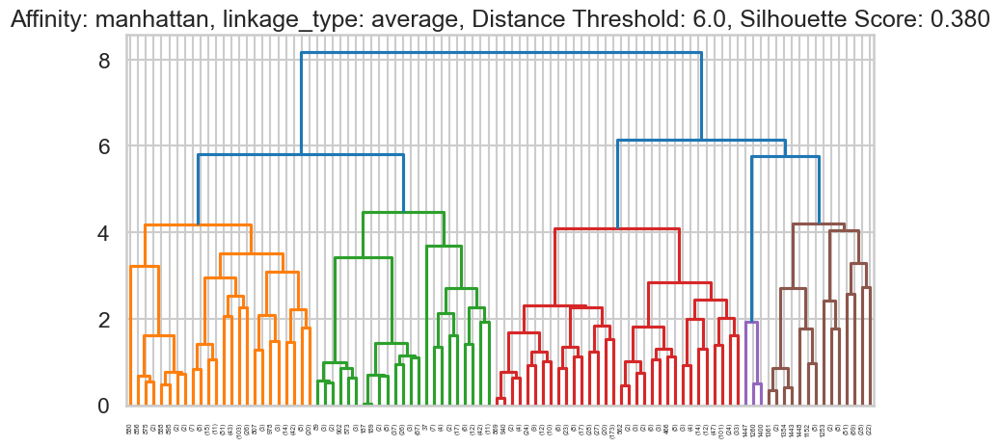

Affinity: manhattan, linkage_type: average, Distance Threshold: 6.0, Silhouette Score: 0.380
[3 3 3 ... 2 1 4]


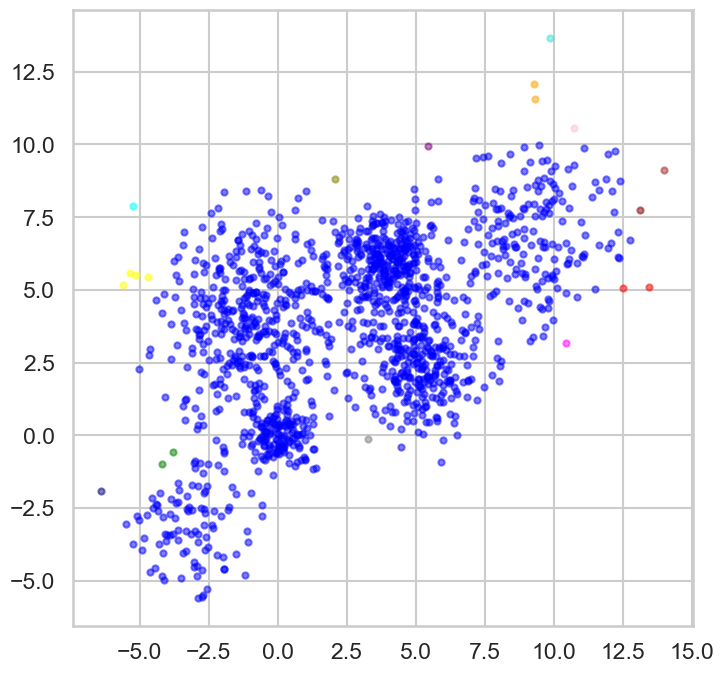

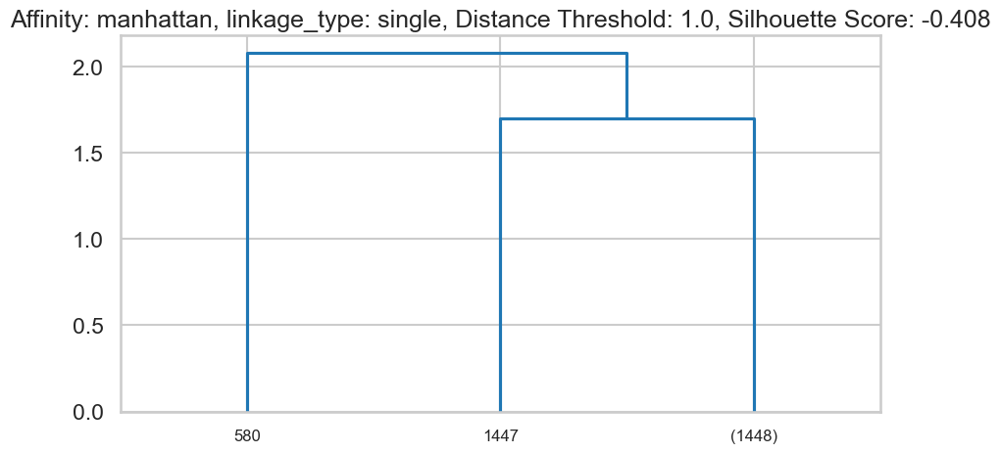

Affinity: manhattan, linkage_type: single, Distance Threshold: 1.0, Silhouette Score: -0.408
[ 1  1  1 ... 12  4  1]


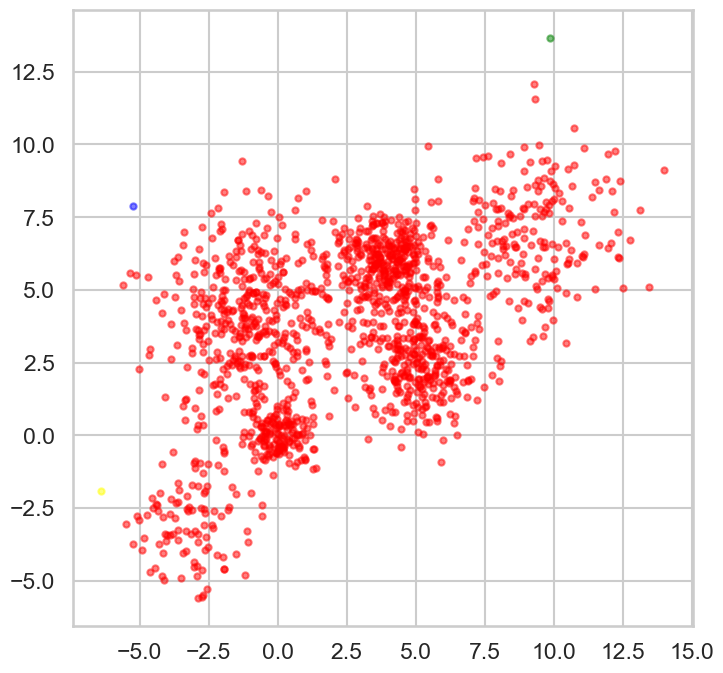

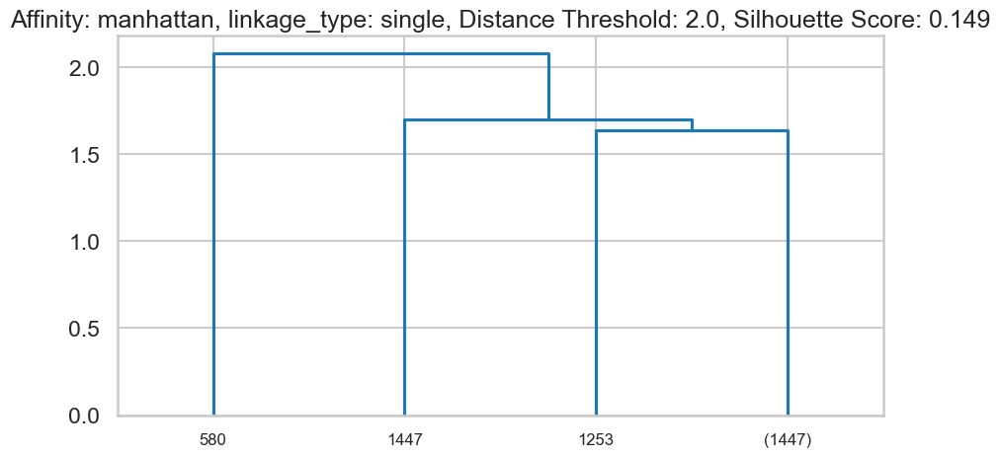

Affinity: manhattan, linkage_type: single, Distance Threshold: 2.0, Silhouette Score: 0.149
[0 0 0 ... 2 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


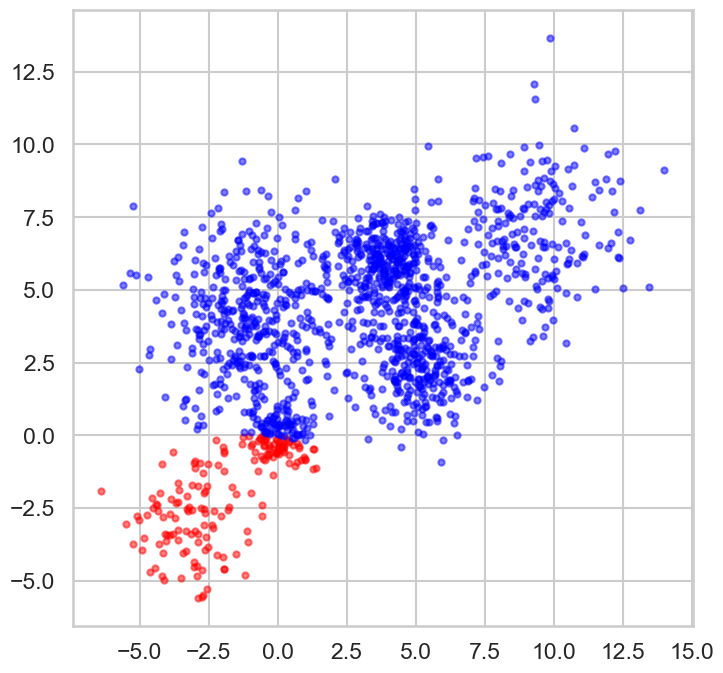

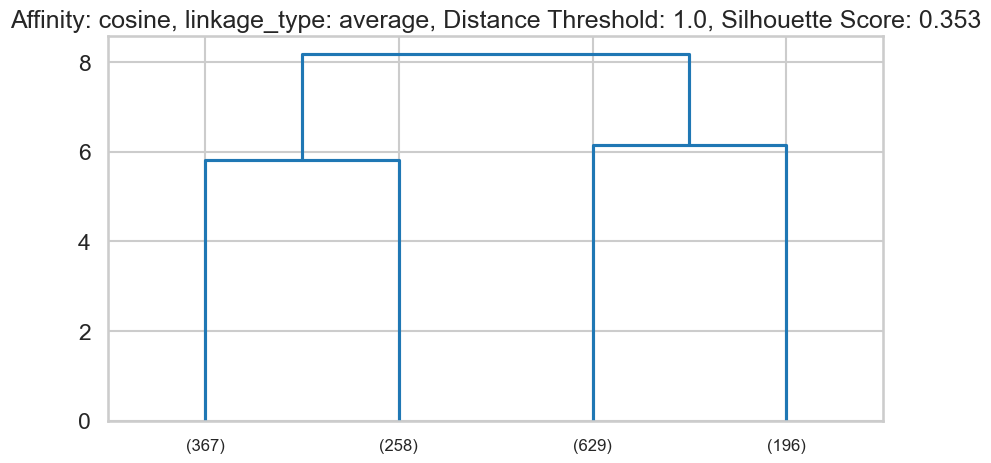

Affinity: cosine, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.353
[0 0 0 ... 1 1 1]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inc

In [8]:
# Define parameters to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkage_types = ['average', 'single']
distance_thresholds = [1.0,2.0,3.0, 4.0,5.0,6.0]

# Store results
best_score = -1
best_params = None
all_scores = {}
        
# Try different parameters
for affinity in affinities:
    for linkage_type in linkage_types:
        for distance_threshold in distance_thresholds:
            try:
                # Perform hierarchical clustering
                X = agg_clus(df, affinity=affinity, linkage_type=linkage_type, distance_threshold=distance_threshold)


                # Compute silhouette score
                score = silhouette_score(df, X.labels_)

                # Store results
                params = (affinity, linkage_type, distance_threshold)
                all_scores[params] = score

                # Plot clusters
                display_cluster(df.to_numpy(copy=True), X, len(np.unique(X.labels_)) )            

                # Plot dendrogram
                fig, ax = plt.subplots(figsize=(10, 5))
                n = linkage(pd.DataFrame(Multi_blob_Data),method=linkage_type)
                dendrogram(n, truncate_mode='level', p=distance_threshold)
                plt.title(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                plt.show()

                # Print resulting clusters
                print(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                print(X.labels_)

                # Update best score
                if score > best_score:
                    best_score = score
                    best_params = params
            except Exception as e:
                print(f"An error occurred: {e}")
                continue

# Print best parameters and score
print(f'Best Parameters: {best_params}, Silhouette Score: {best_score:.3f}')

### DBScan
* Use DBScan function to  to cluster the above data 
* In the  DBscan change the following parameters 
    * EPS (from 0.1 to 3)
    * Min_samples (from 5 to 25)
* Plot the silhouette_score versus the variation in the EPS and the min_samples
* Plot the resulting Clusters in this case 
* Find the set of paramters that would find result in the best silhouette_score and store this score for later comparison with other clustering techniques. 
* Record your observations and comments 

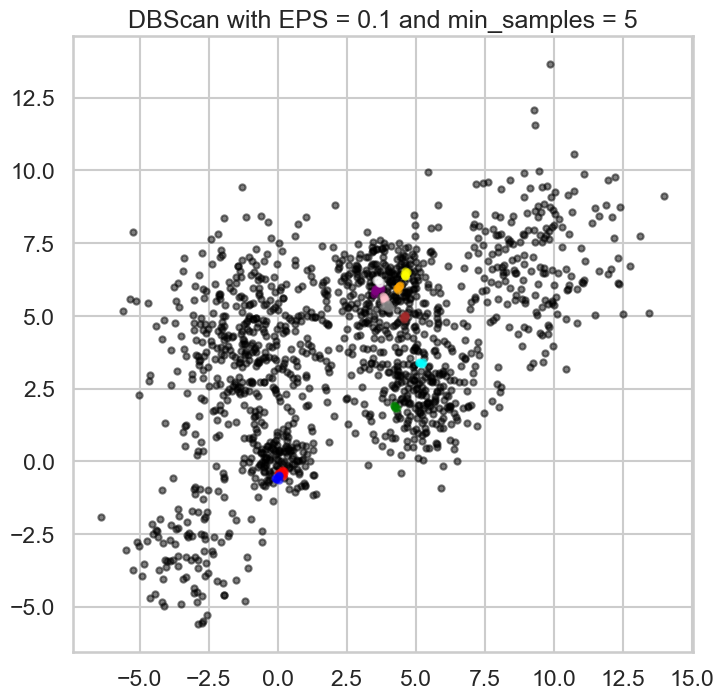

EPS: 0.1, Min Samples: 5, Silhouette Score: -0.542
[-1 -1 -1 ... -1 -1 -1]


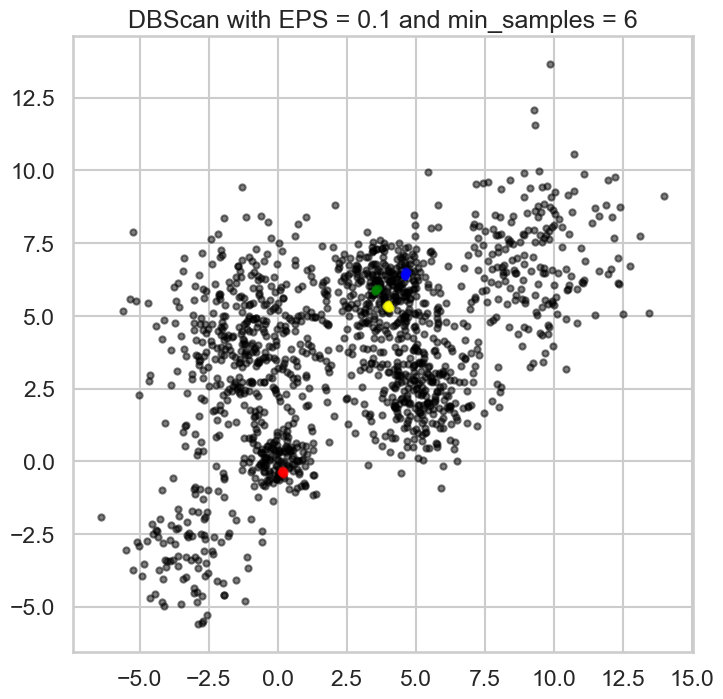

EPS: 0.1, Min Samples: 6, Silhouette Score: -0.501
[-1 -1 -1 ... -1 -1 -1]


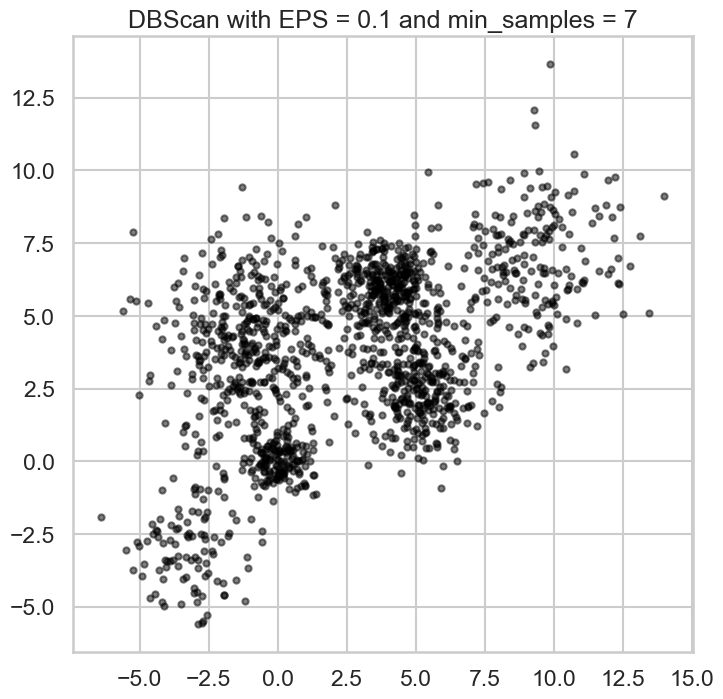

EPS: 0.1, Min Samples: 7, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


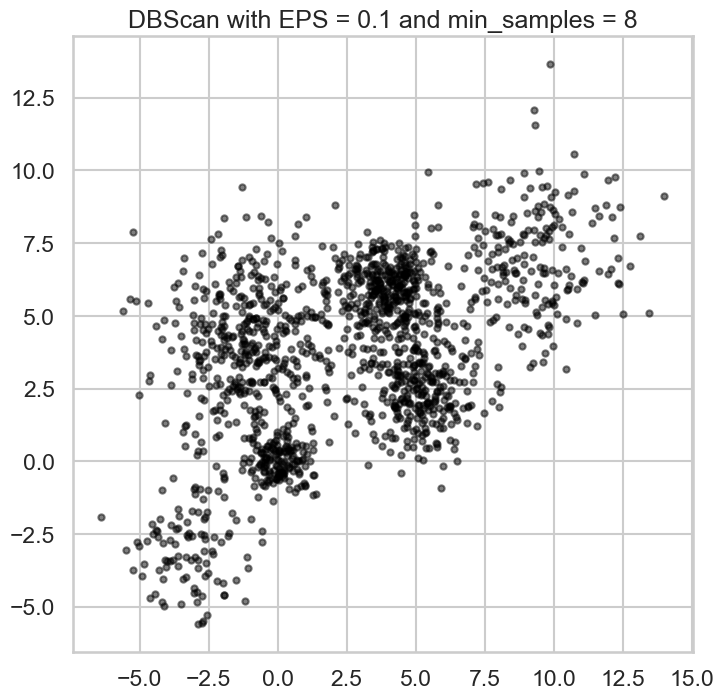

EPS: 0.1, Min Samples: 8, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


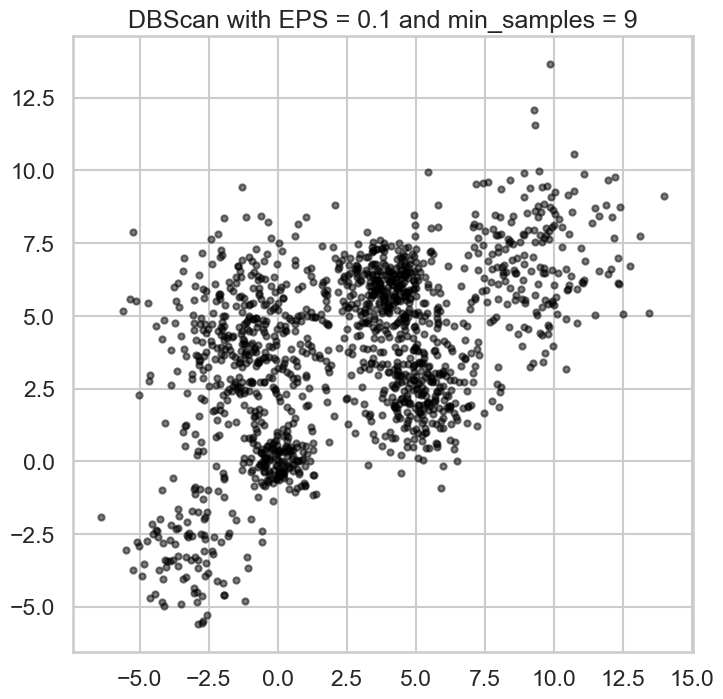

EPS: 0.1, Min Samples: 9, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


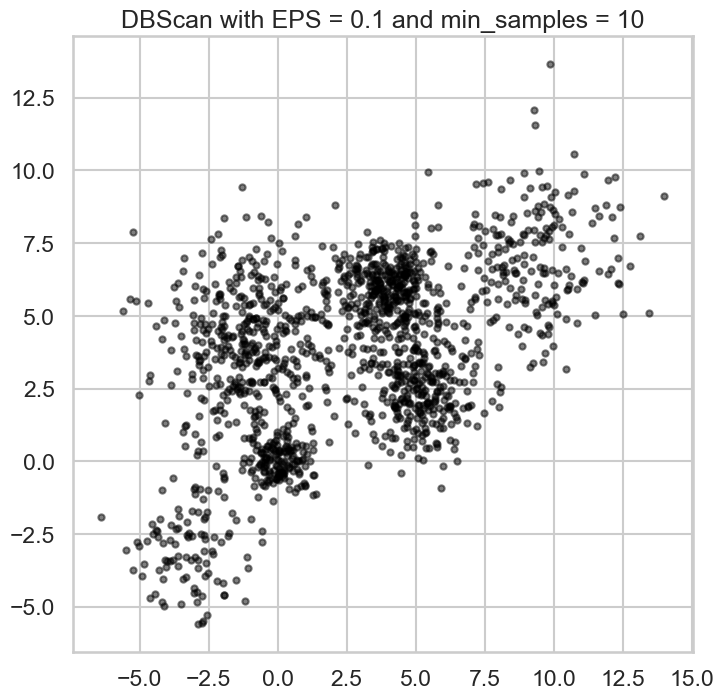

EPS: 0.1, Min Samples: 10, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


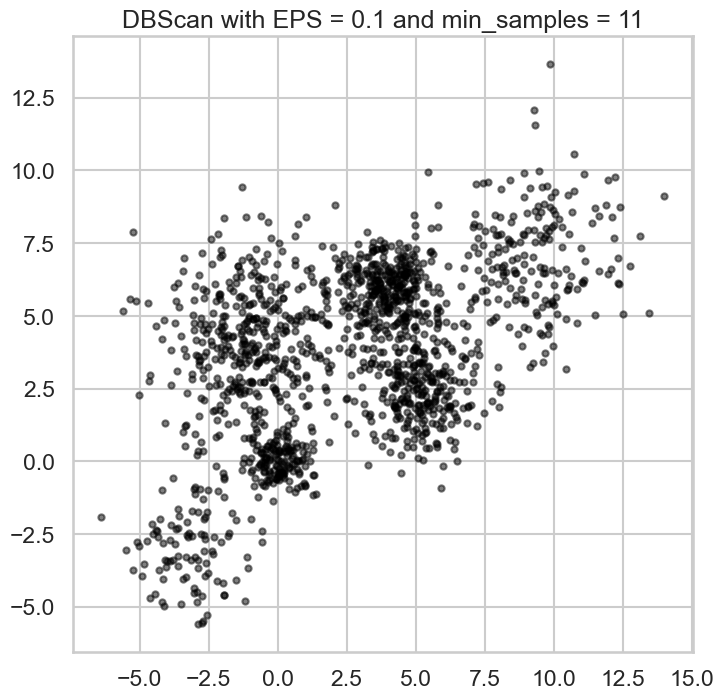

EPS: 0.1, Min Samples: 11, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


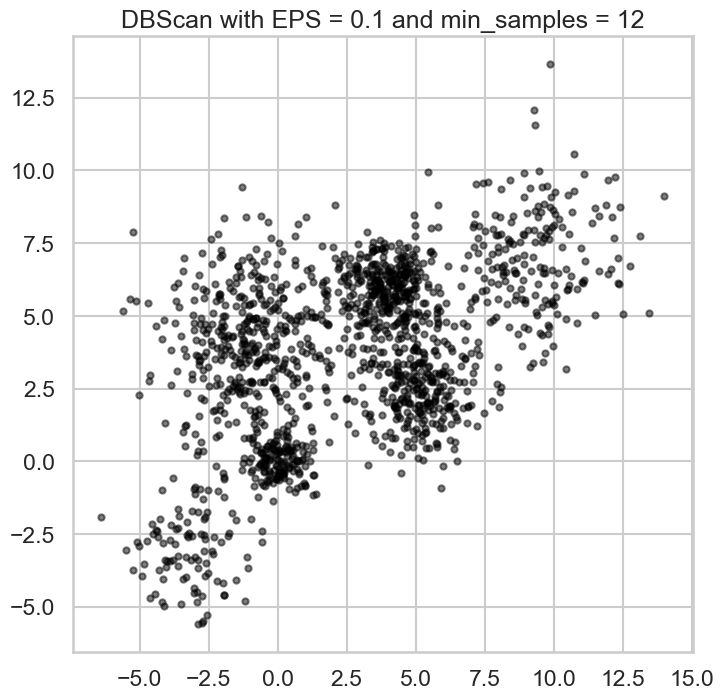

EPS: 0.1, Min Samples: 12, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


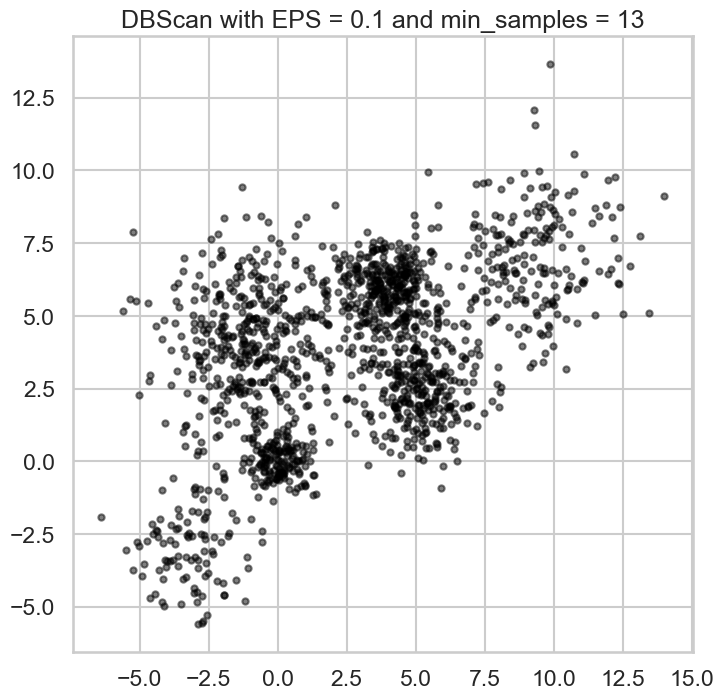

EPS: 0.1, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


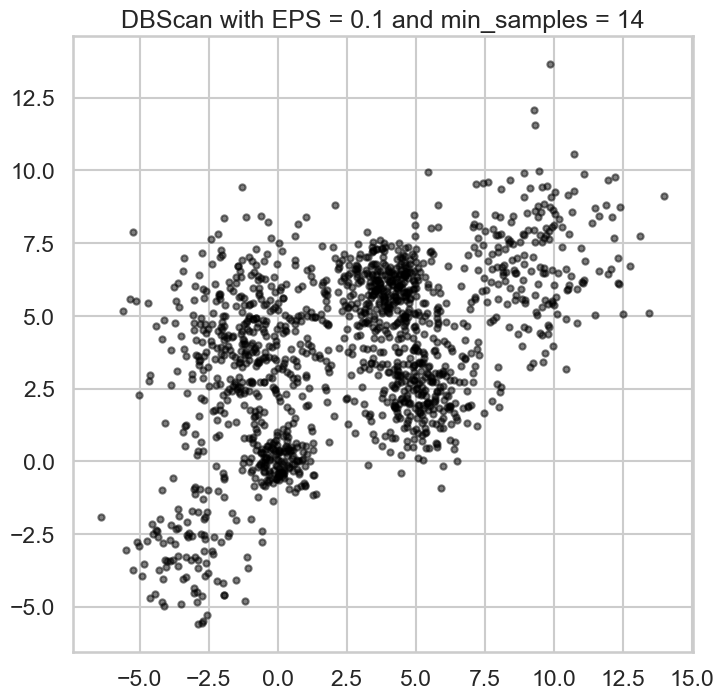

EPS: 0.1, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 ... -1 -1 -1]


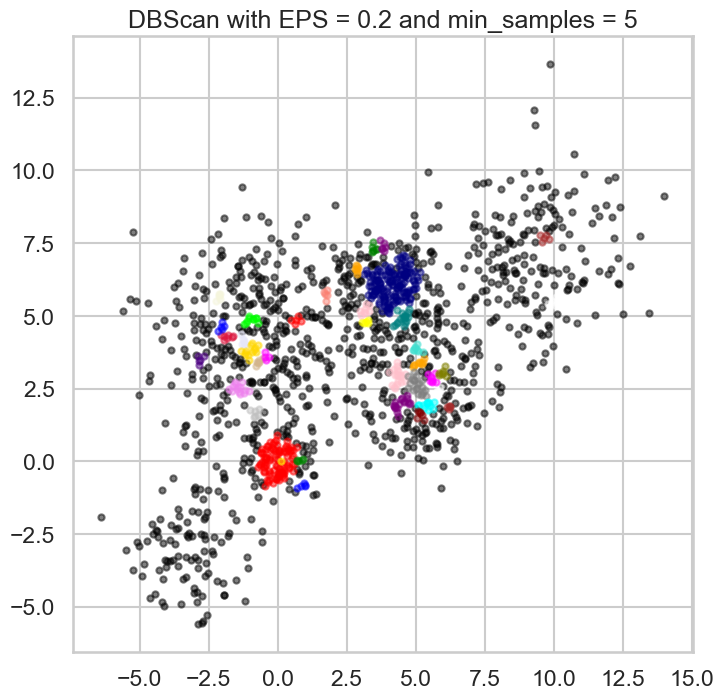

EPS: 0.2, Min Samples: 5, Silhouette Score: -0.400
[-1 -1 -1 ... -1 -1 -1]


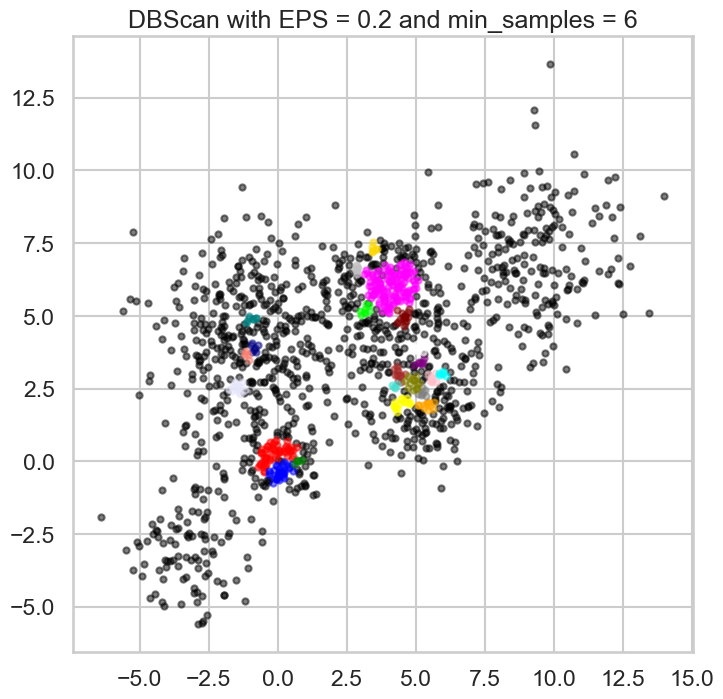

EPS: 0.2, Min Samples: 6, Silhouette Score: -0.418
[-1 -1 -1 ... -1 -1 -1]


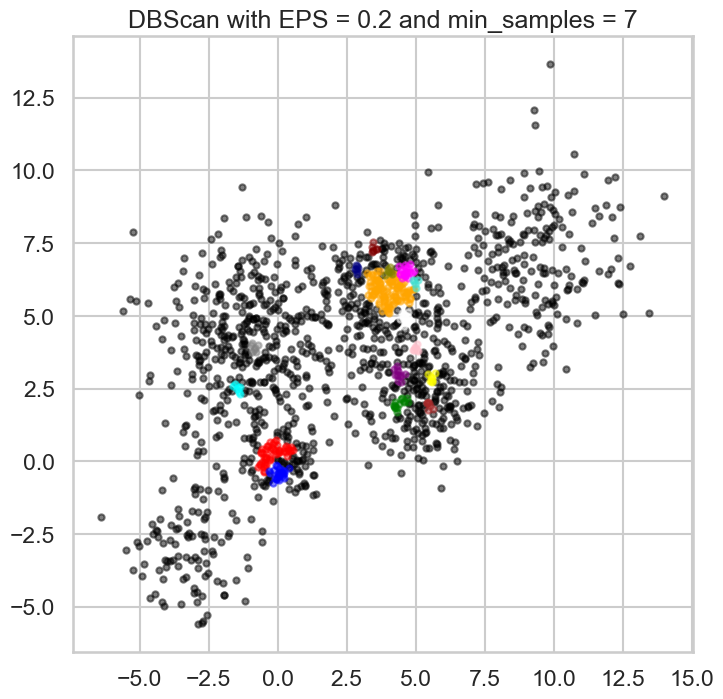

EPS: 0.2, Min Samples: 7, Silhouette Score: -0.489
[-1 -1 -1 ... -1 -1 -1]


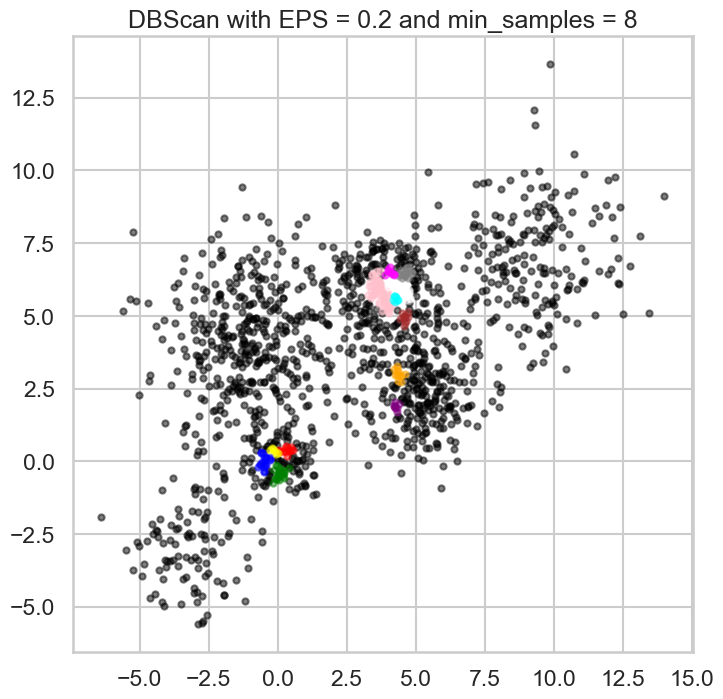

EPS: 0.2, Min Samples: 8, Silhouette Score: -0.446
[-1 -1 -1 ... -1 -1 -1]


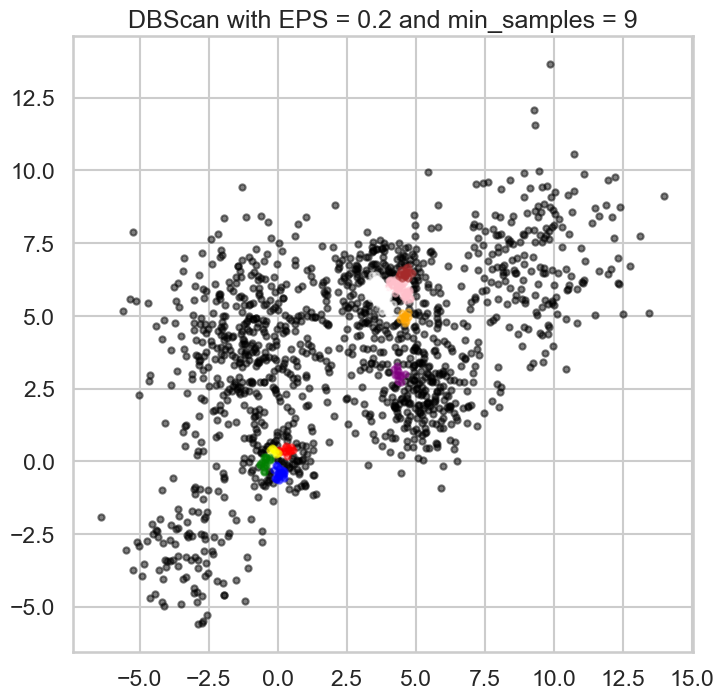

EPS: 0.2, Min Samples: 9, Silhouette Score: -0.448
[-1 -1 -1 ... -1 -1 -1]


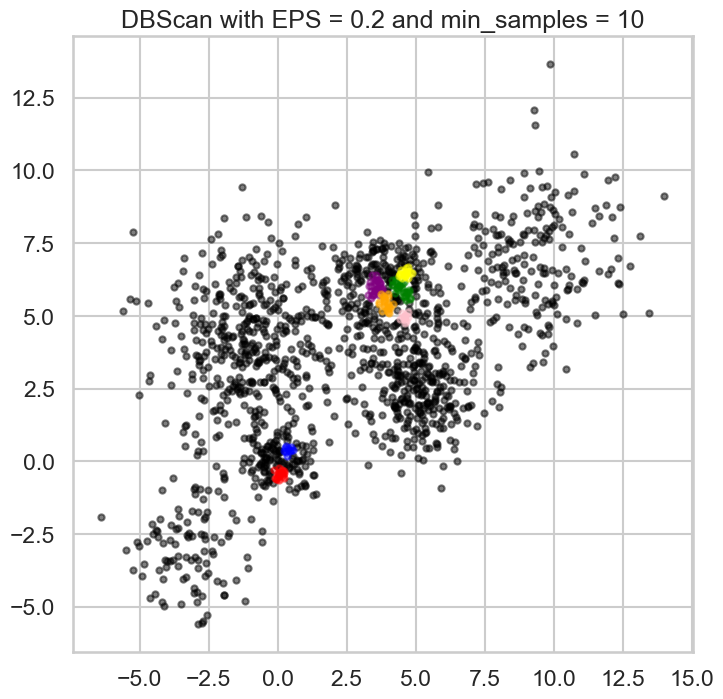

EPS: 0.2, Min Samples: 10, Silhouette Score: -0.434
[-1 -1 -1 ... -1 -1 -1]


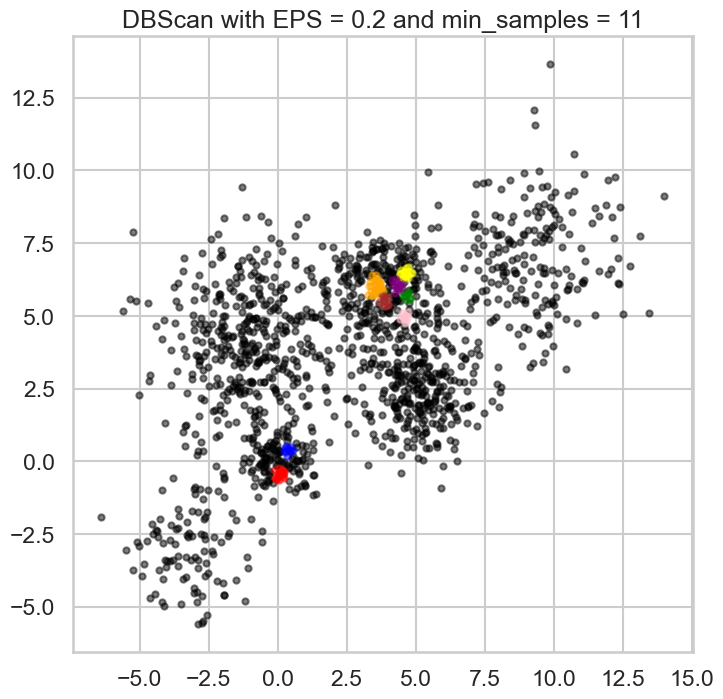

EPS: 0.2, Min Samples: 11, Silhouette Score: -0.447
[-1 -1 -1 ... -1 -1 -1]


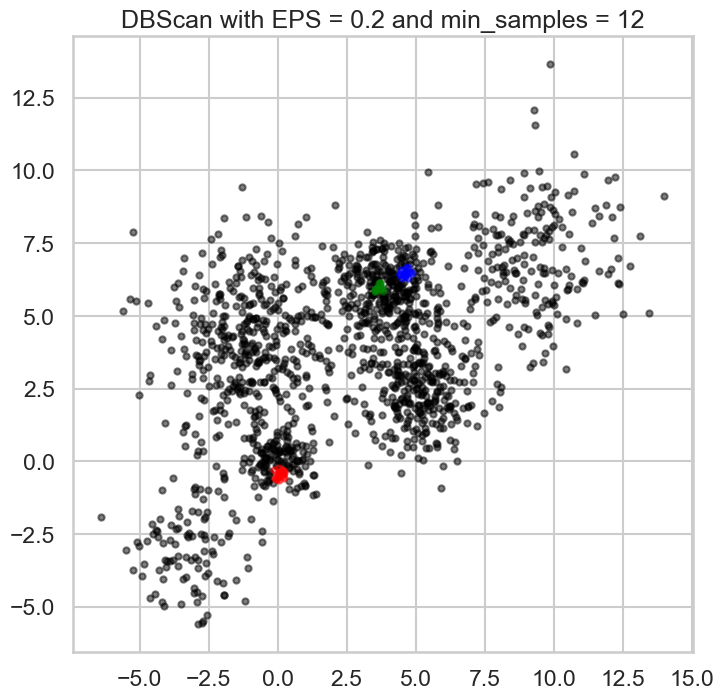

EPS: 0.2, Min Samples: 12, Silhouette Score: -0.441
[-1 -1 -1 ... -1 -1 -1]


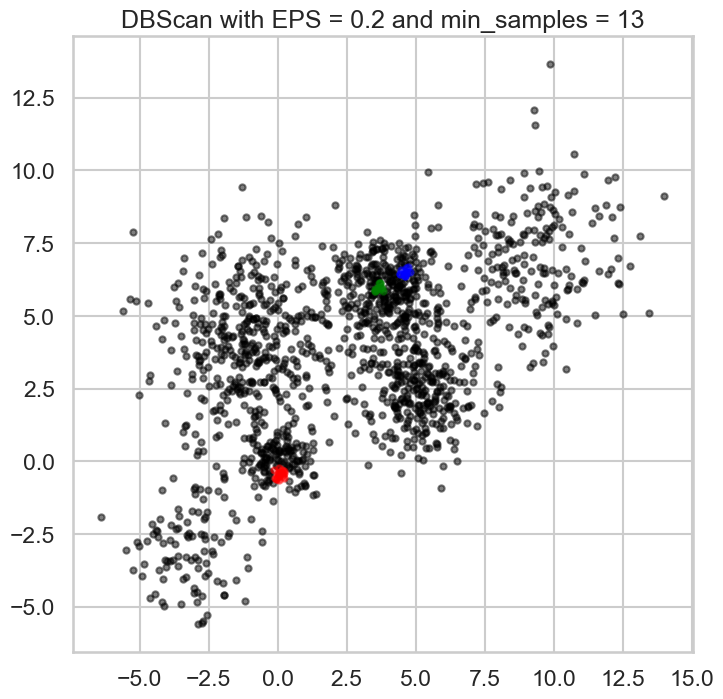

EPS: 0.2, Min Samples: 13, Silhouette Score: -0.444
[-1 -1 -1 ... -1 -1 -1]


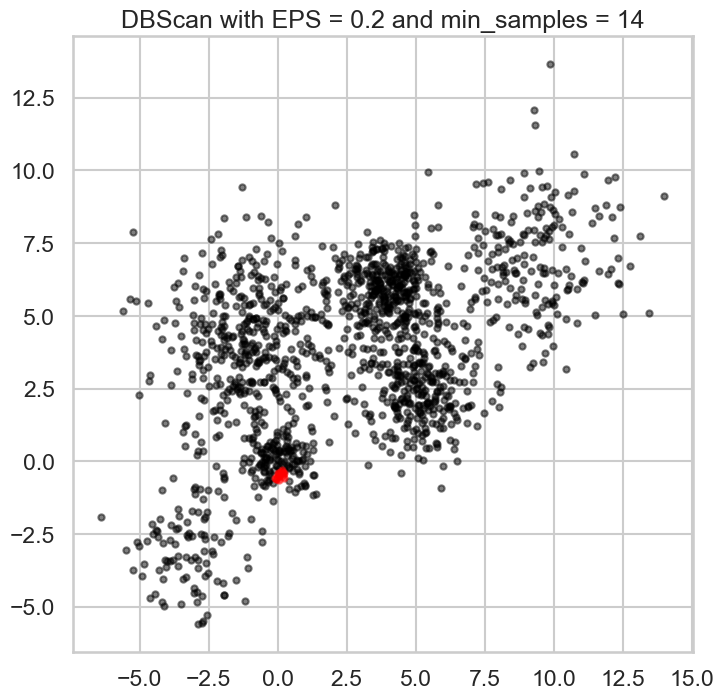

EPS: 0.2, Min Samples: 14, Silhouette Score: -0.008
[-1 -1 -1 ... -1 -1 -1]


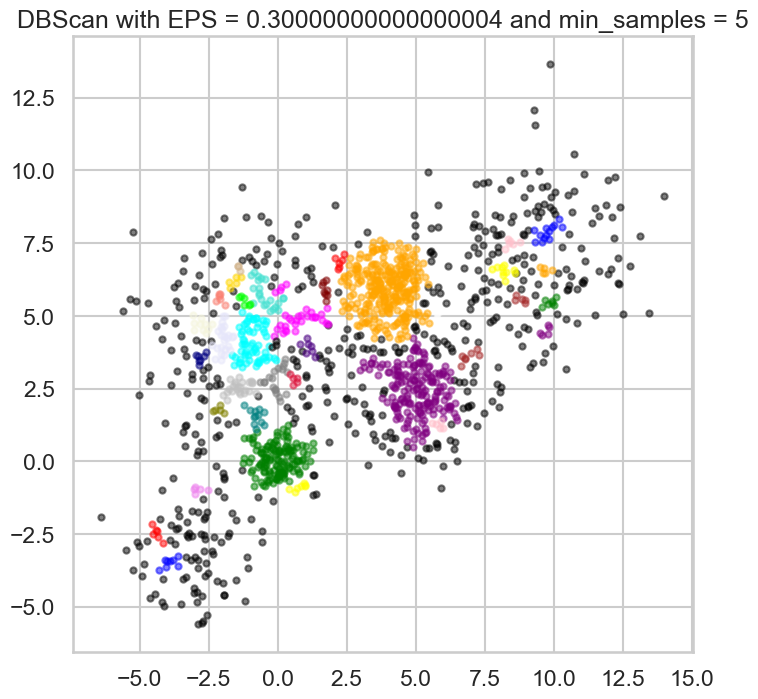

EPS: 0.30000000000000004, Min Samples: 5, Silhouette Score: -0.138
[-1 -1 -1 ... -1 -1 35]


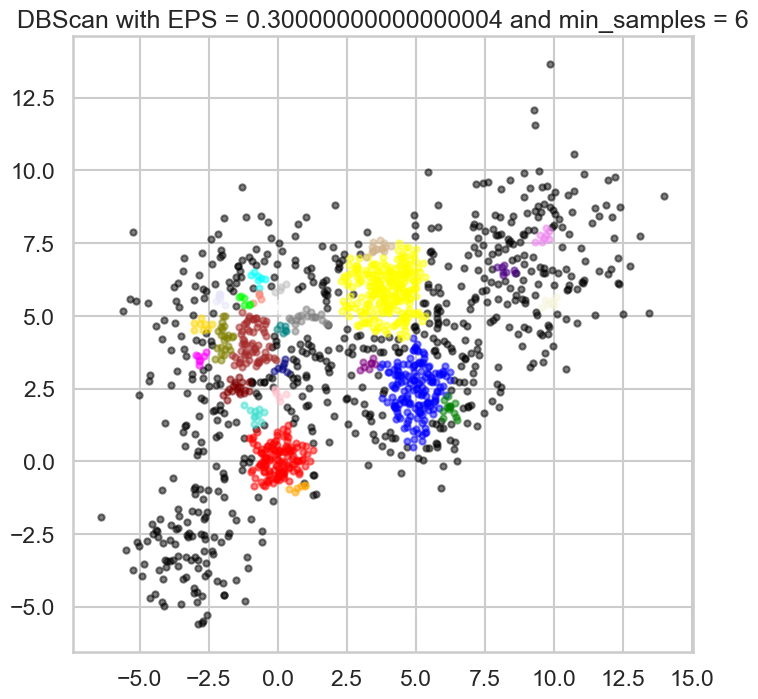

EPS: 0.30000000000000004, Min Samples: 6, Silhouette Score: -0.202
[-1 -1 -1 ... -1 -1 -1]


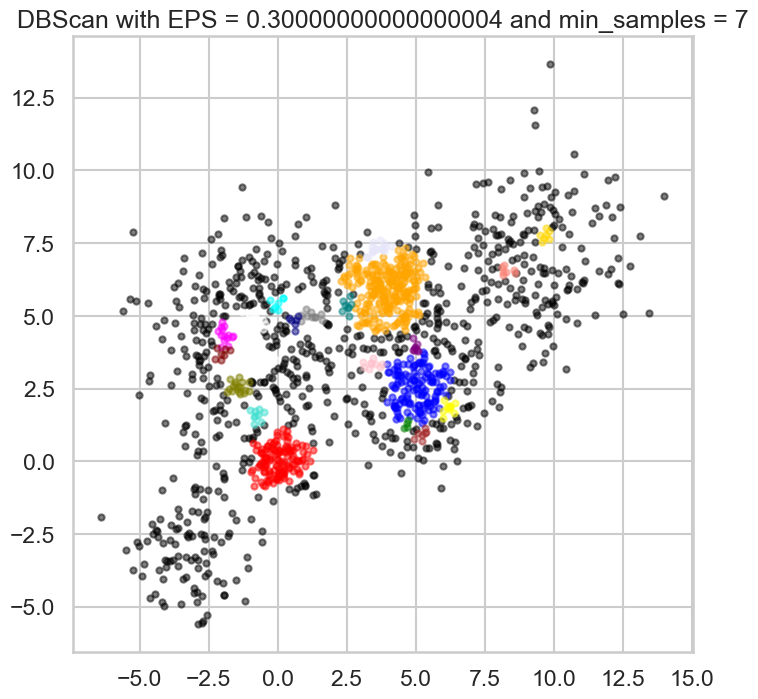

EPS: 0.30000000000000004, Min Samples: 7, Silhouette Score: -0.290
[-1 -1 -1 ... -1 -1 -1]


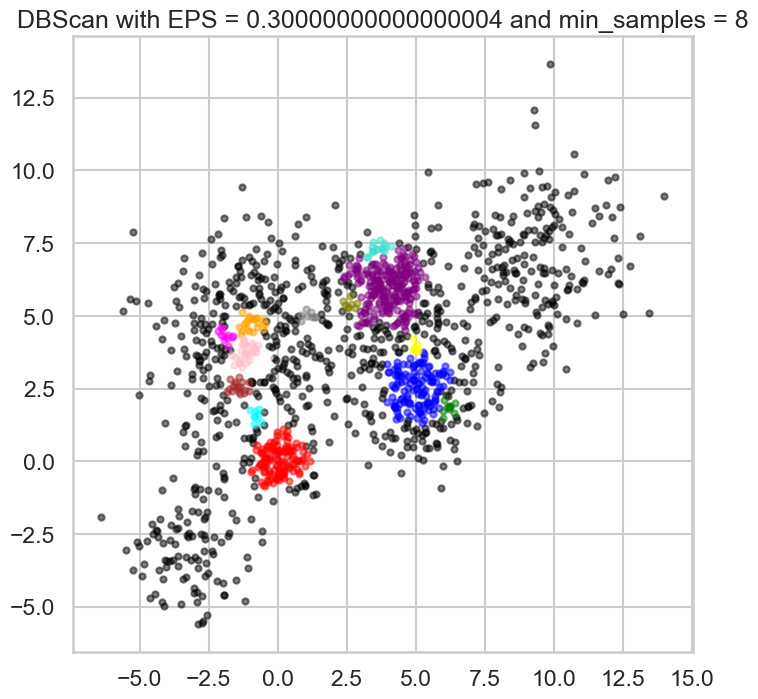

EPS: 0.30000000000000004, Min Samples: 8, Silhouette Score: -0.266
[-1 -1 -1 ... -1 -1 -1]


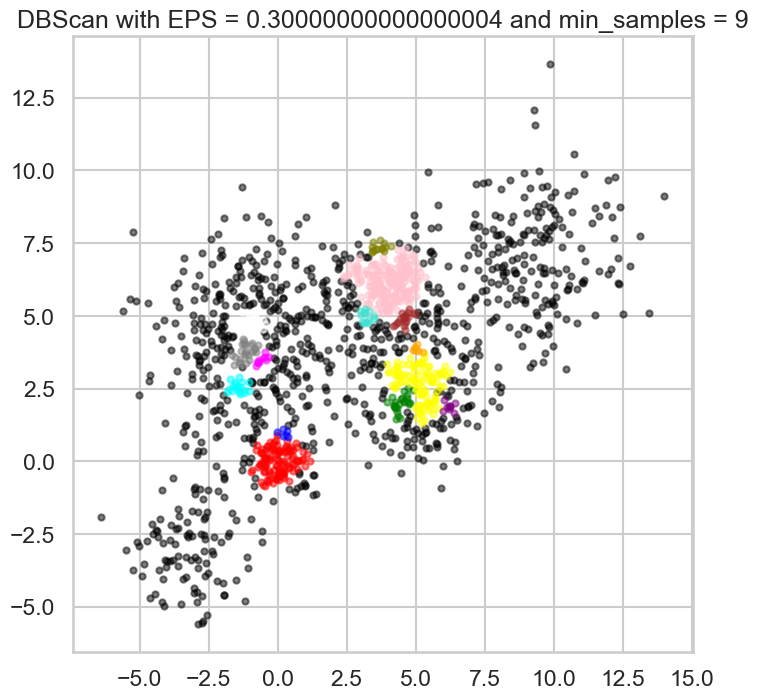

EPS: 0.30000000000000004, Min Samples: 9, Silhouette Score: -0.320
[-1 -1 -1 ... -1 -1 -1]


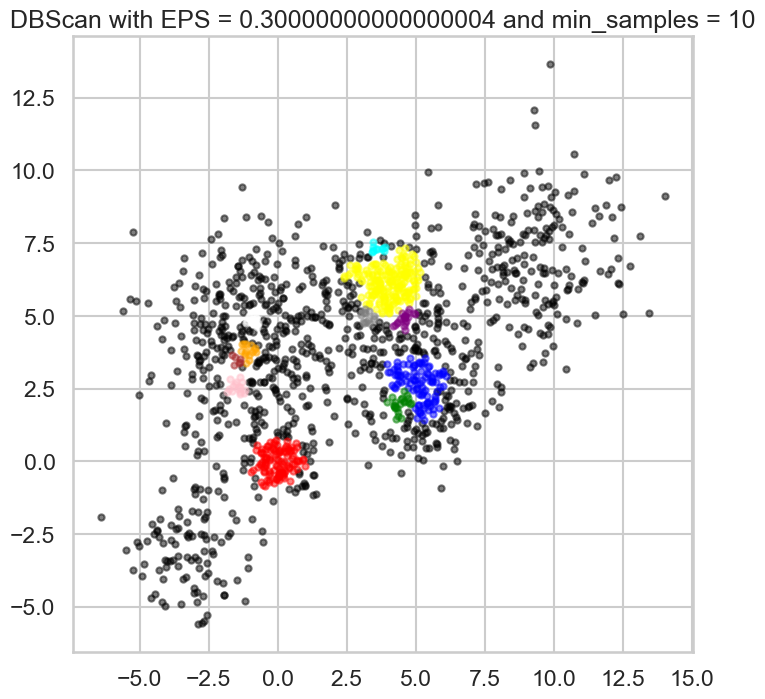

EPS: 0.30000000000000004, Min Samples: 10, Silhouette Score: -0.311
[-1 -1 -1 ... -1 -1 -1]


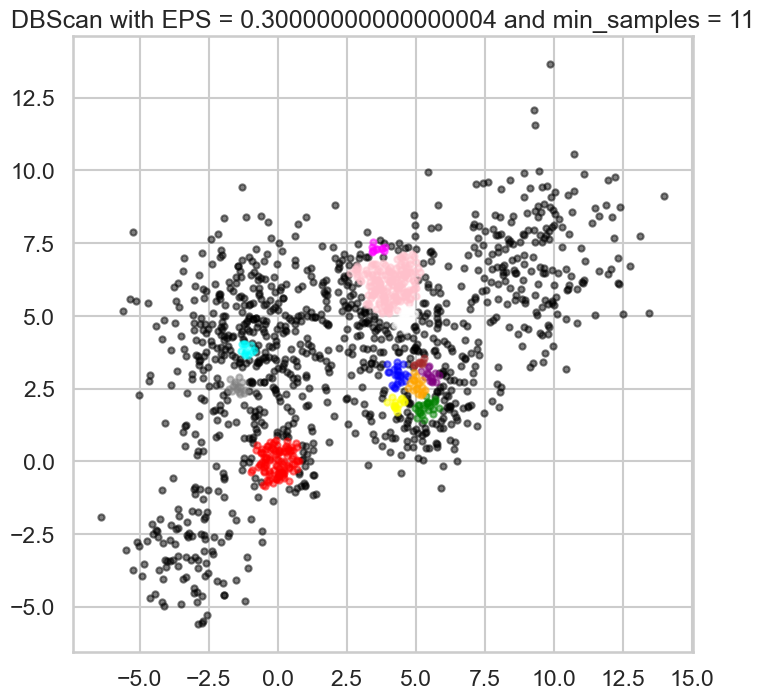

EPS: 0.30000000000000004, Min Samples: 11, Silhouette Score: -0.328
[-1 -1 -1 ... -1 -1 -1]


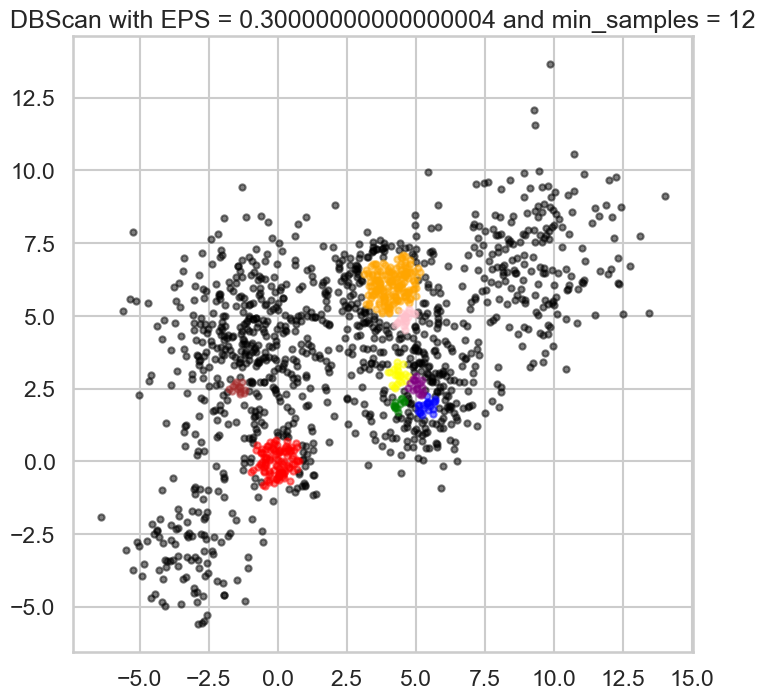

EPS: 0.30000000000000004, Min Samples: 12, Silhouette Score: -0.326
[-1 -1 -1 ... -1 -1 -1]


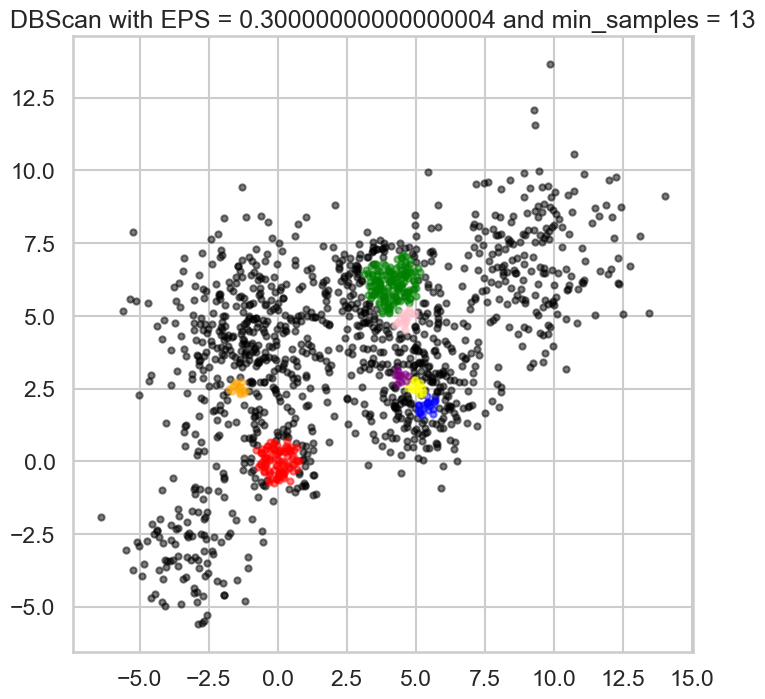

EPS: 0.30000000000000004, Min Samples: 13, Silhouette Score: -0.357
[-1 -1 -1 ... -1 -1 -1]


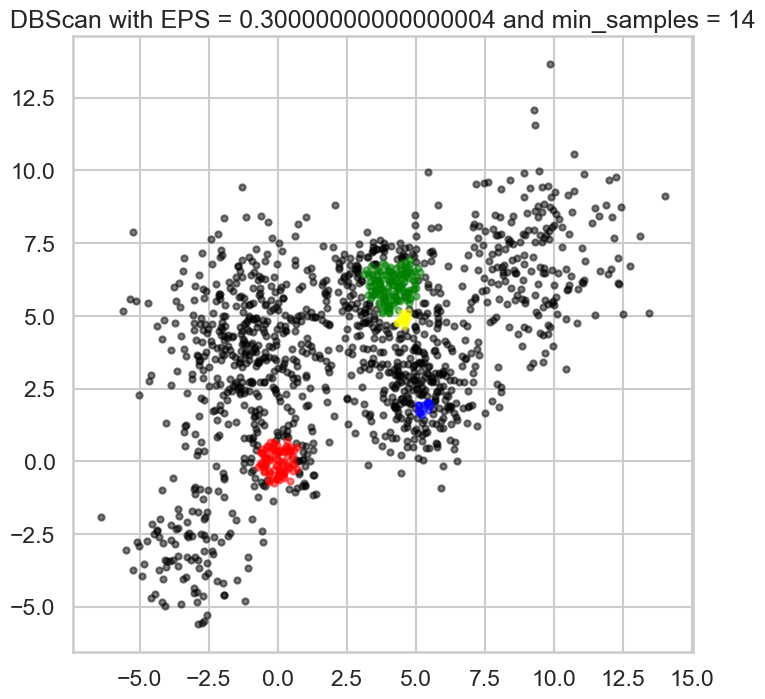

EPS: 0.30000000000000004, Min Samples: 14, Silhouette Score: -0.323
[-1 -1 -1 ... -1 -1 -1]


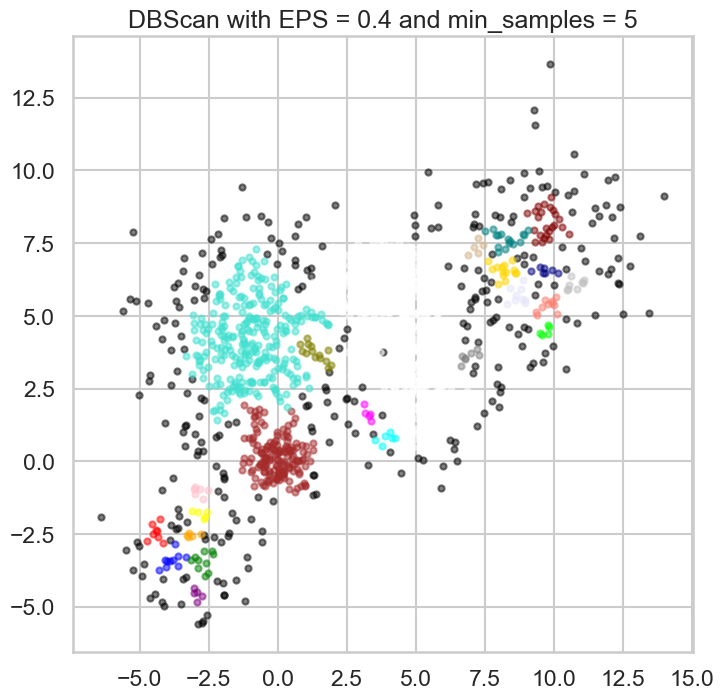

EPS: 0.4, Min Samples: 5, Silhouette Score: -0.036
[ 2 -1  1 ... -1 -1 16]


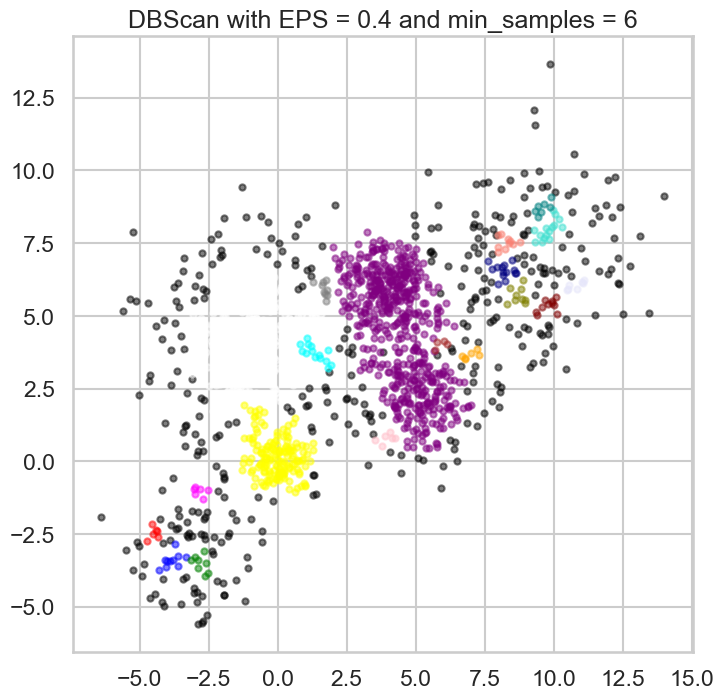

EPS: 0.4, Min Samples: 6, Silhouette Score: -0.153
[-1 -1  1 ... -1 -1 18]


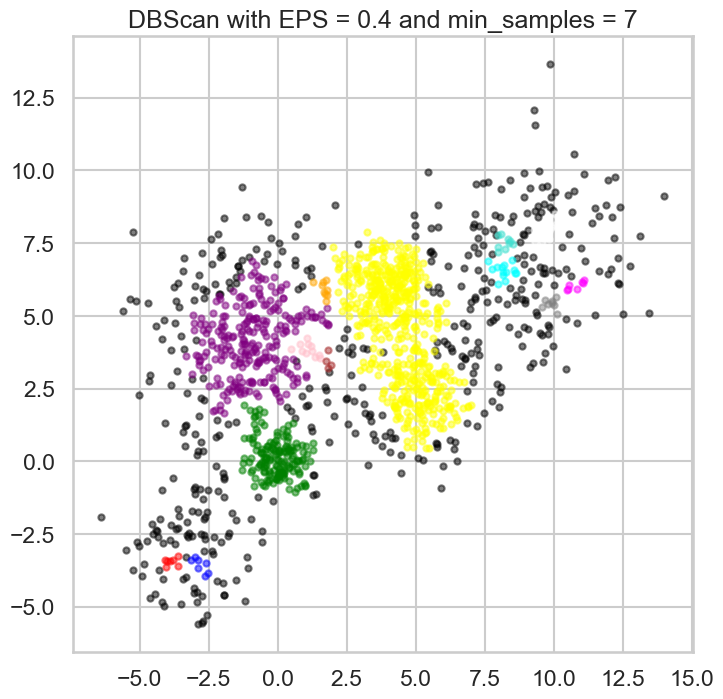

EPS: 0.4, Min Samples: 7, Silhouette Score: -0.080
[-1 -1 -1 ... -1 -1 12]


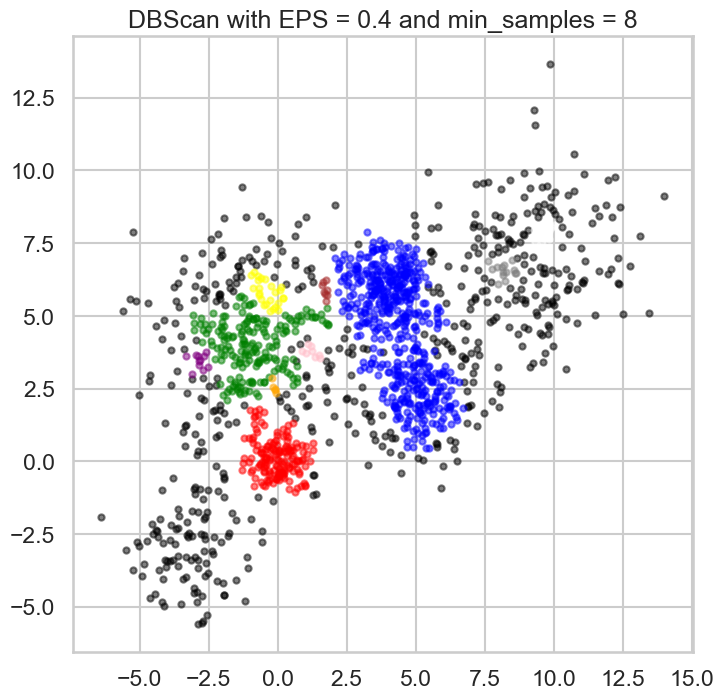

EPS: 0.4, Min Samples: 8, Silhouette Score: -0.150
[-1 -1 -1 ... -1 -1 -1]


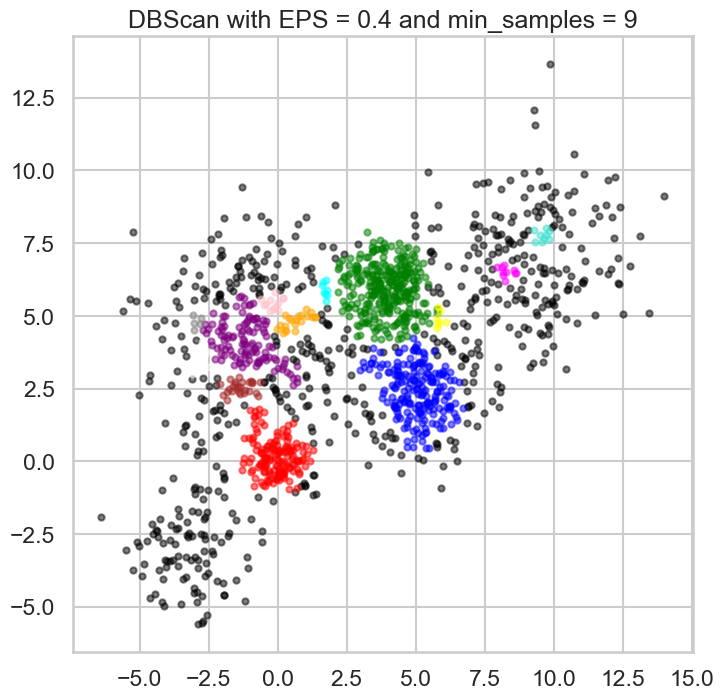

EPS: 0.4, Min Samples: 9, Silhouette Score: -0.093
[-1 -1 -1 ... -1 -1 -1]


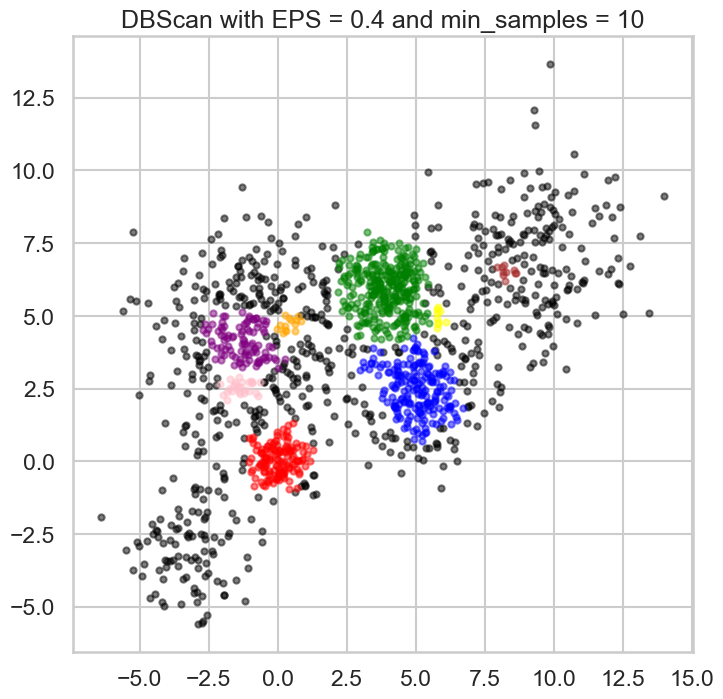

EPS: 0.4, Min Samples: 10, Silhouette Score: -0.090
[-1 -1 -1 ... -1 -1 -1]


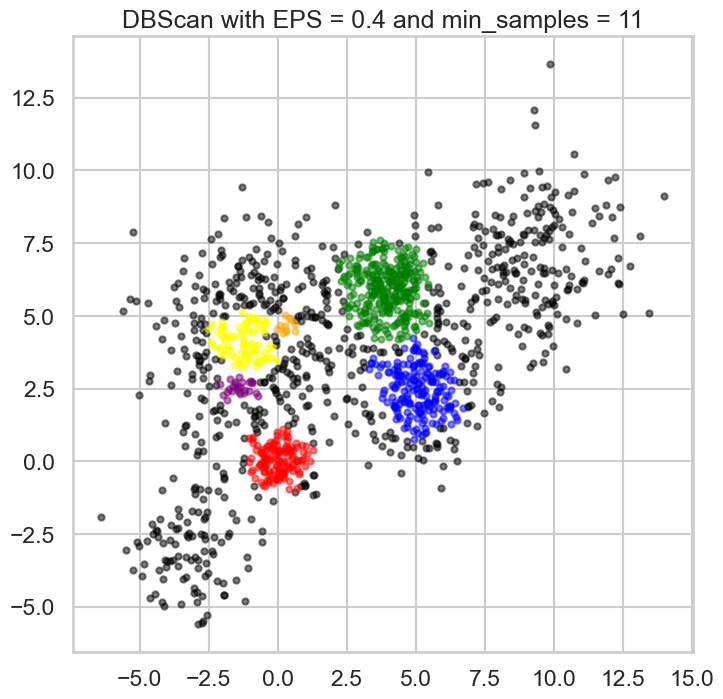

EPS: 0.4, Min Samples: 11, Silhouette Score: -0.001
[-1 -1 -1 ... -1 -1 -1]


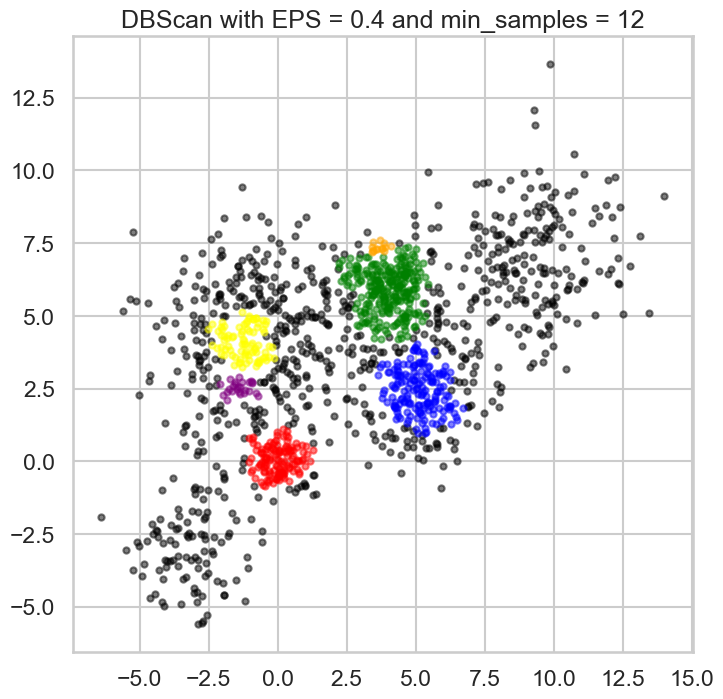

EPS: 0.4, Min Samples: 12, Silhouette Score: -0.092
[-1 -1 -1 ... -1 -1 -1]


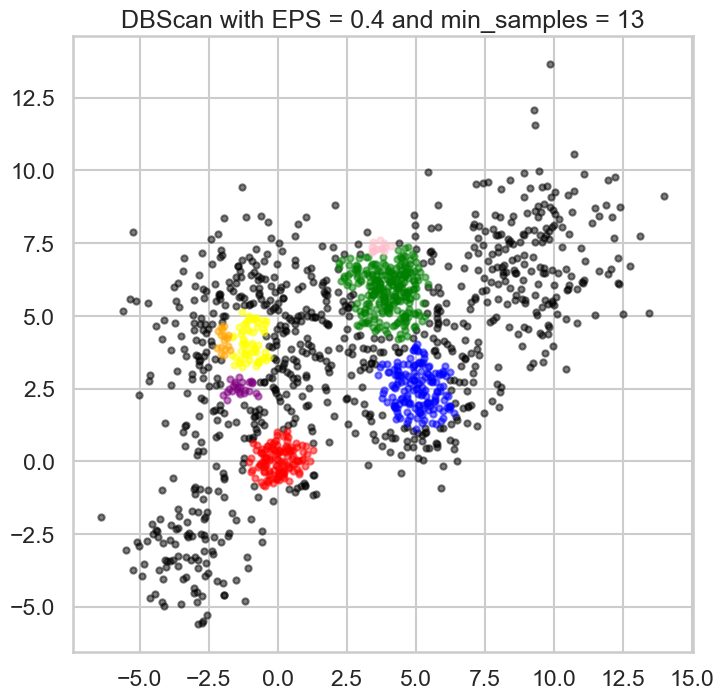

EPS: 0.4, Min Samples: 13, Silhouette Score: -0.122
[-1 -1 -1 ... -1 -1 -1]


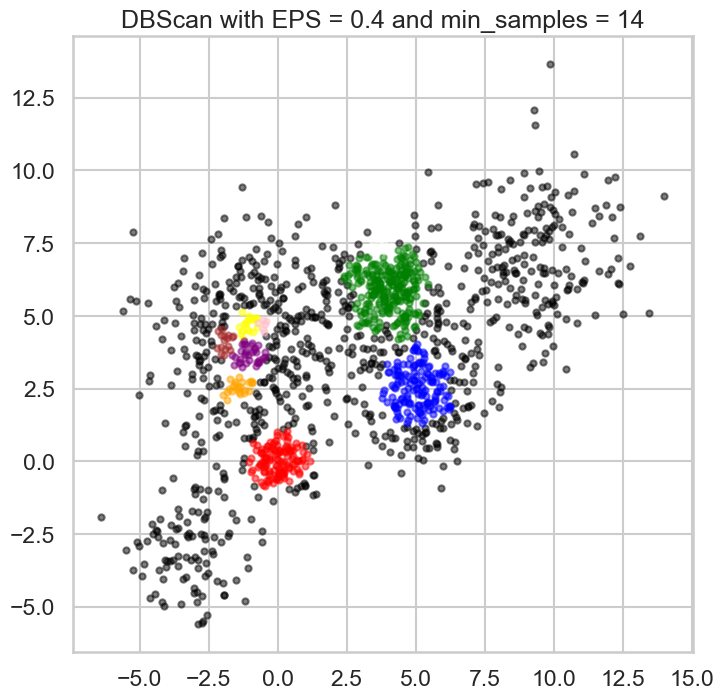

EPS: 0.4, Min Samples: 14, Silhouette Score: -0.143
[-1 -1 -1 ... -1 -1 -1]


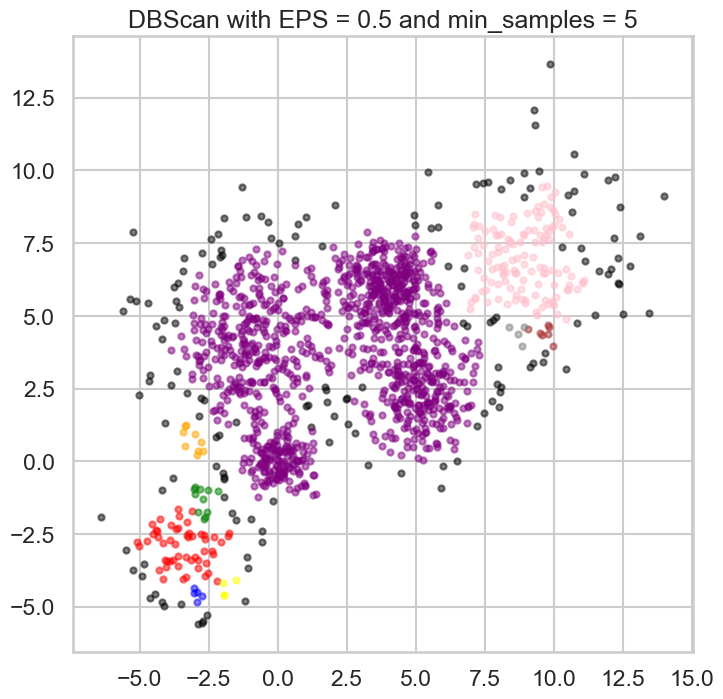

EPS: 0.5, Min Samples: 5, Silhouette Score: -0.073
[ 0  2  0 ... -1 -1  6]


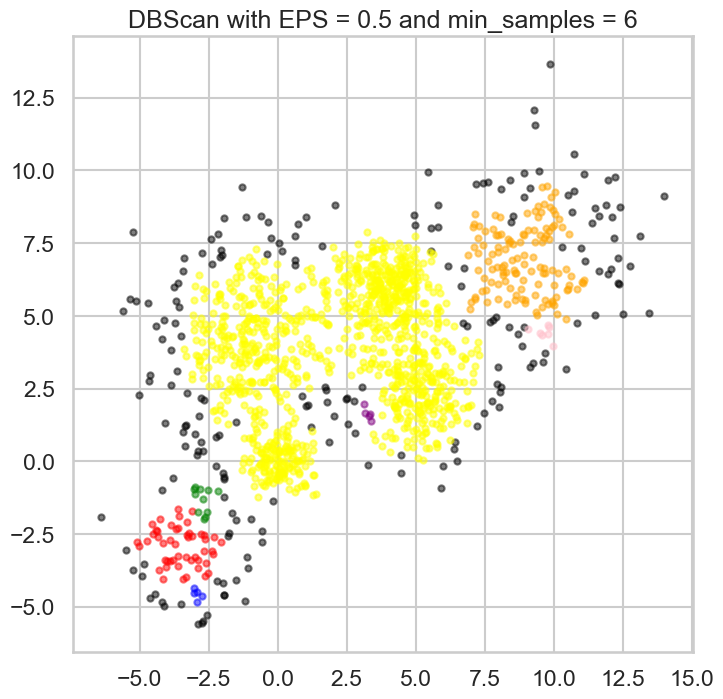

EPS: 0.5, Min Samples: 6, Silhouette Score: -0.173
[ 0  2  0 ... -1 -1  5]


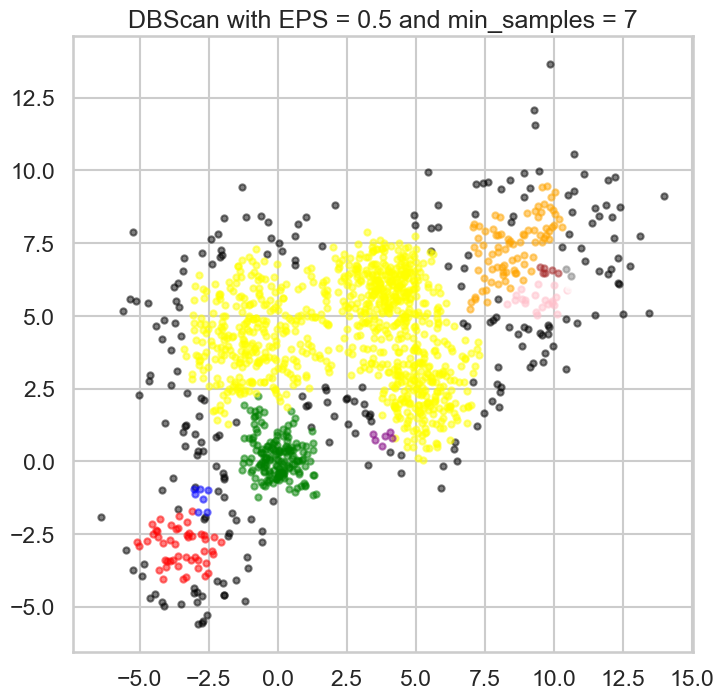

EPS: 0.5, Min Samples: 7, Silhouette Score: -0.037
[ 0 -1  0 ... -1 -1  5]


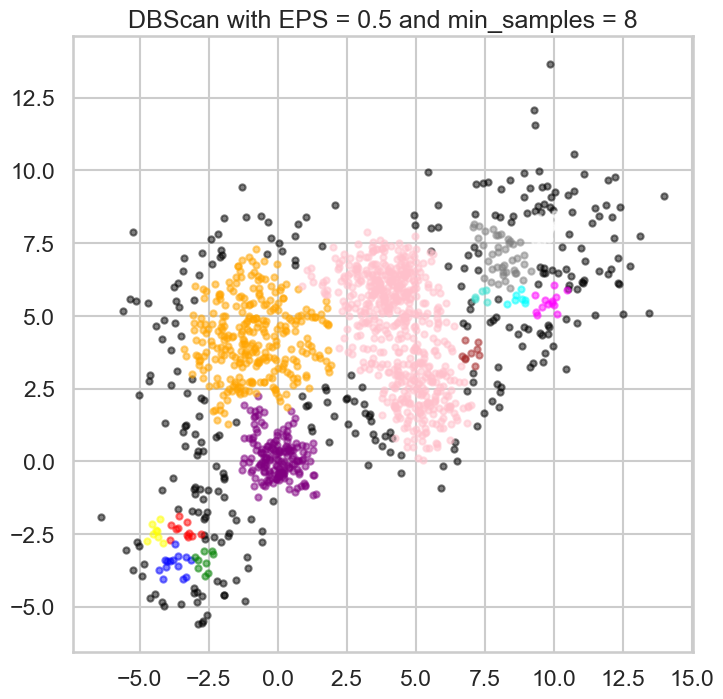

EPS: 0.5, Min Samples: 8, Silhouette Score: 0.084
[ 2 -1  1 ... -1 -1  9]


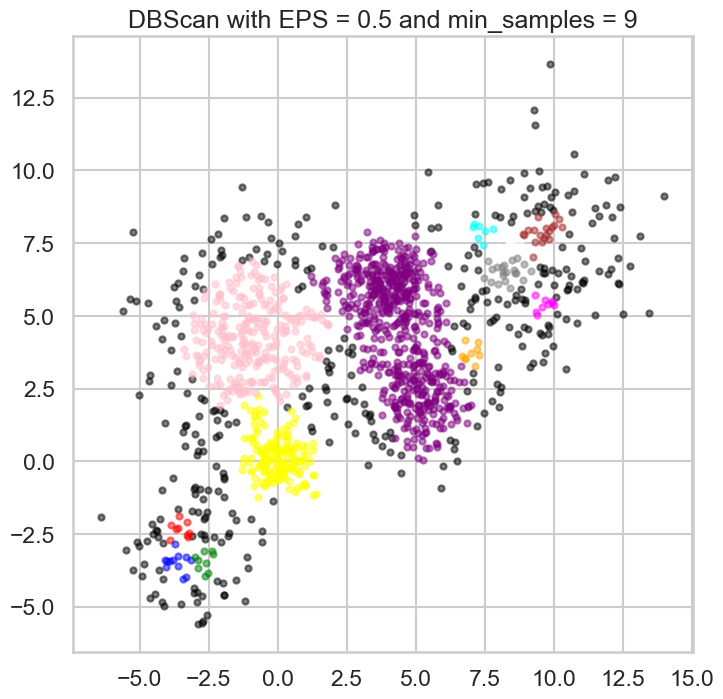

EPS: 0.5, Min Samples: 9, Silhouette Score: 0.060
[ 2 -1  1 ... -1 -1  8]


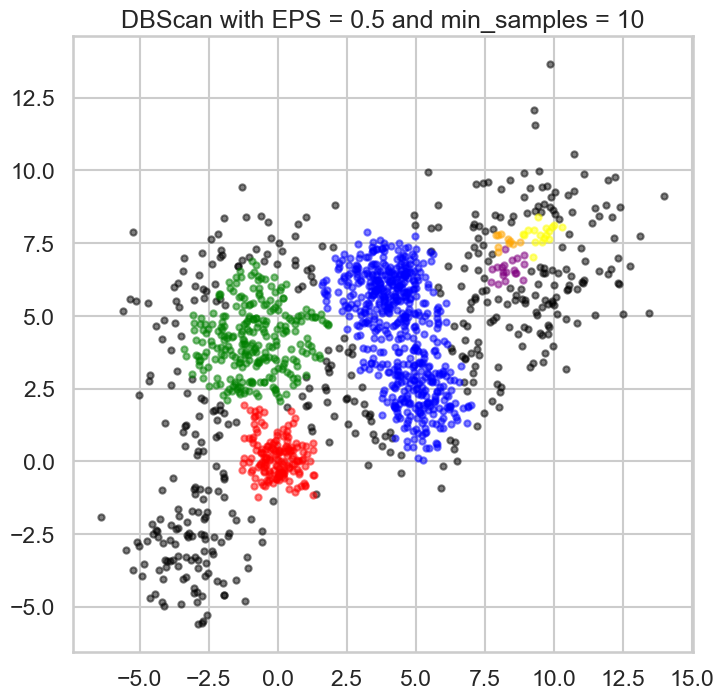

EPS: 0.5, Min Samples: 10, Silhouette Score: 0.142
[-1 -1 -1 ... -1 -1  5]


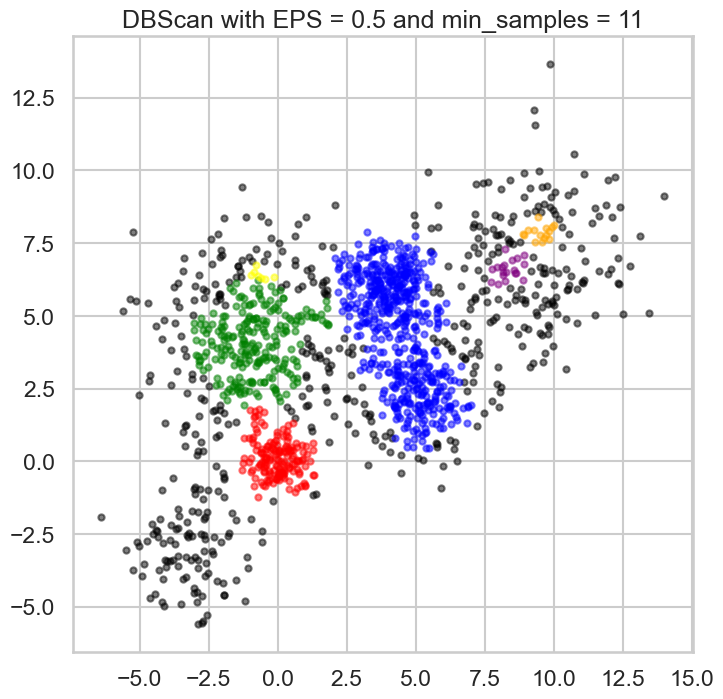

EPS: 0.5, Min Samples: 11, Silhouette Score: 0.044
[-1 -1 -1 ... -1 -1 -1]


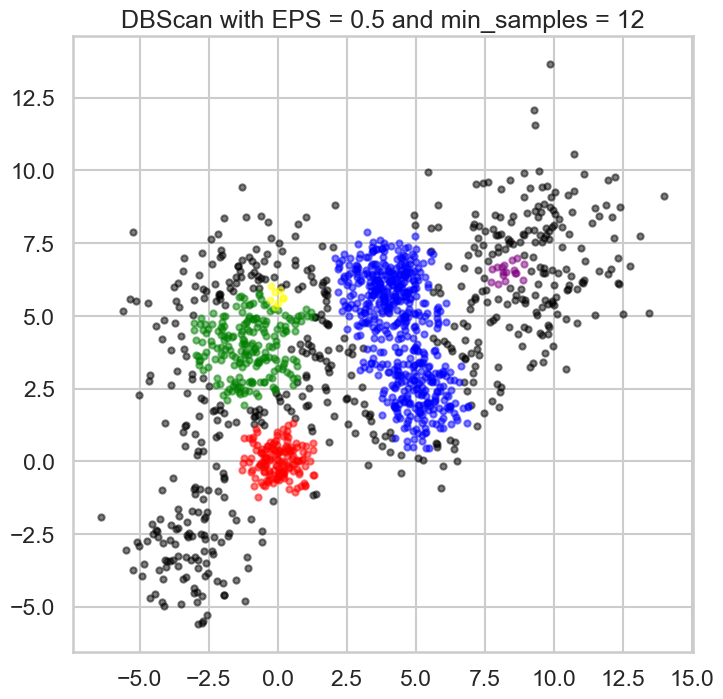

EPS: 0.5, Min Samples: 12, Silhouette Score: -0.006
[-1 -1 -1 ... -1 -1 -1]


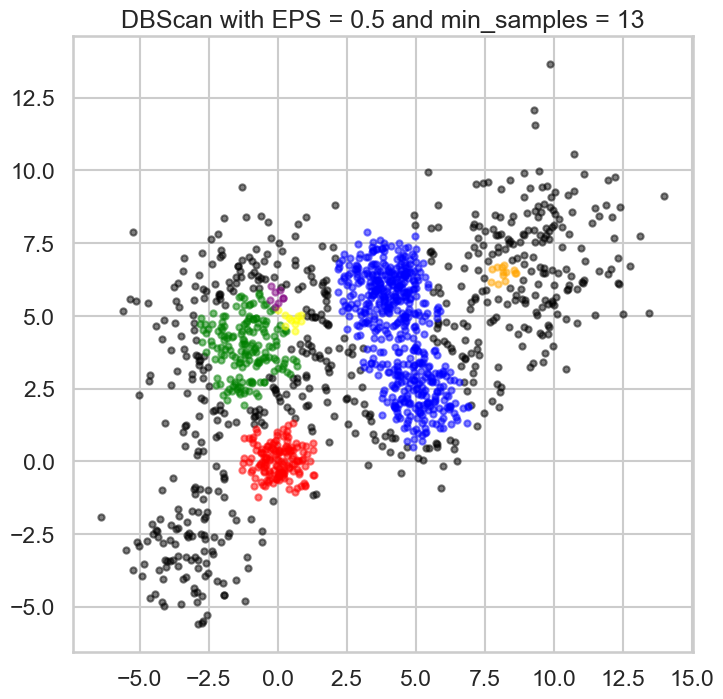

EPS: 0.5, Min Samples: 13, Silhouette Score: -0.045
[-1 -1 -1 ... -1 -1 -1]


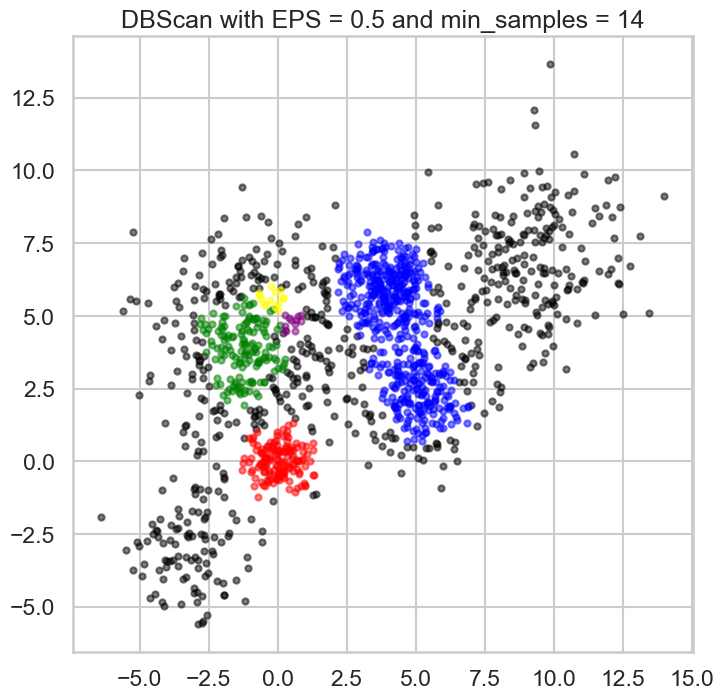

EPS: 0.5, Min Samples: 14, Silhouette Score: 0.012
[-1 -1 -1 ... -1 -1 -1]


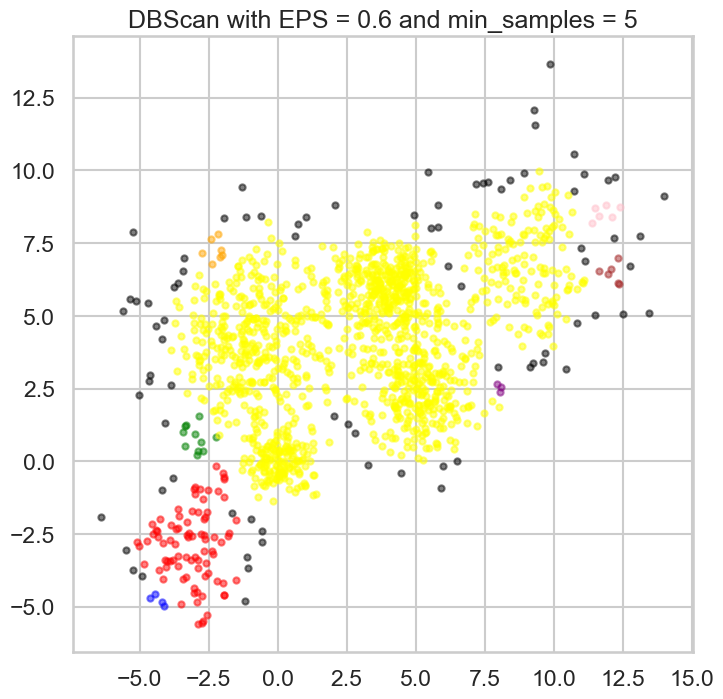

EPS: 0.6, Min Samples: 5, Silhouette Score: -0.240
[ 0  0  0 ... -1 -1  3]


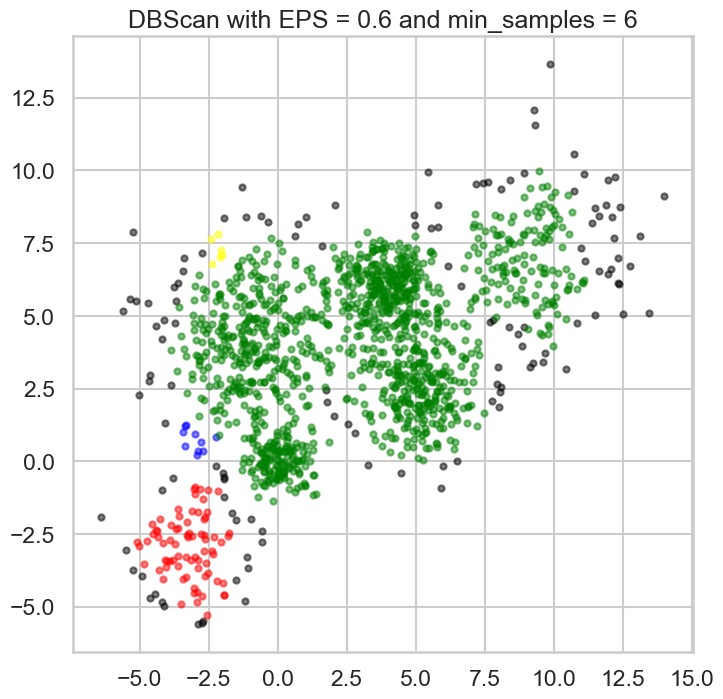

EPS: 0.6, Min Samples: 6, Silhouette Score: 0.016
[ 0  0  0 ... -1 -1  2]


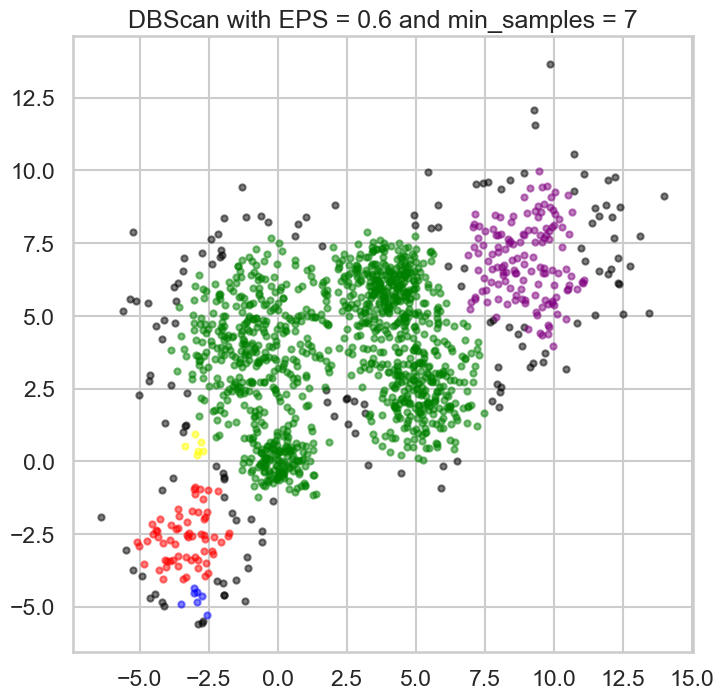

EPS: 0.6, Min Samples: 7, Silhouette Score: 0.059
[ 0  0  0 ... -1 -1  4]


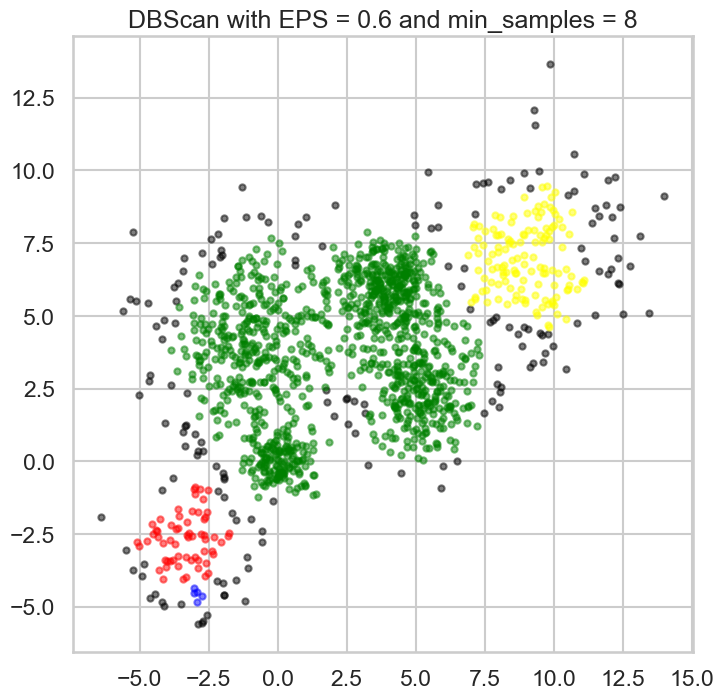

EPS: 0.6, Min Samples: 8, Silhouette Score: 0.163
[ 0 -1  0 ... -1 -1  3]


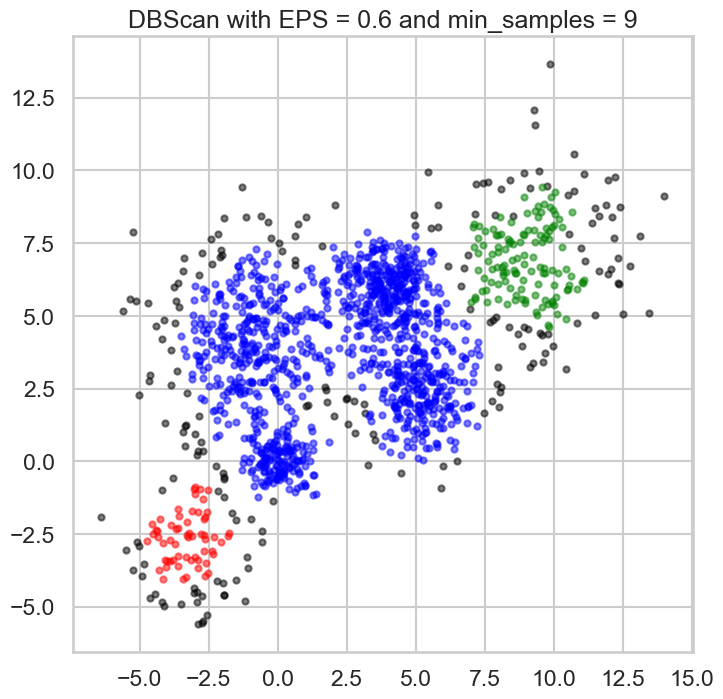

EPS: 0.6, Min Samples: 9, Silhouette Score: 0.169
[ 0 -1  0 ... -1 -1  2]


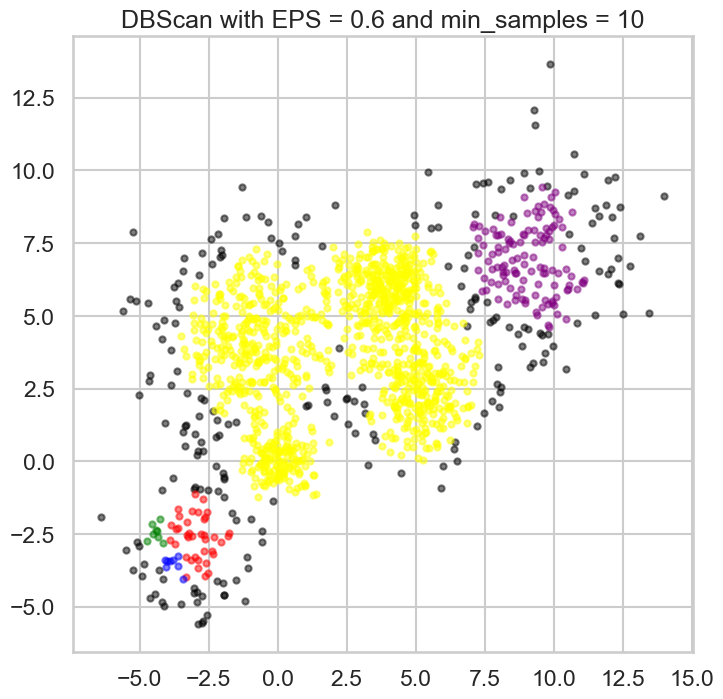

EPS: 0.6, Min Samples: 10, Silhouette Score: 0.128
[ 0 -1  0 ... -1 -1  4]


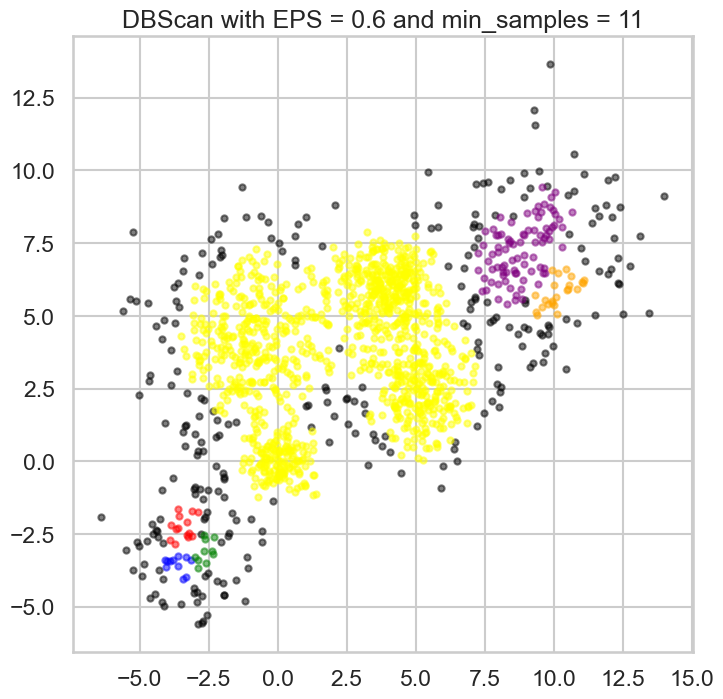

EPS: 0.6, Min Samples: 11, Silhouette Score: 0.058
[ 2 -1  1 ... -1 -1  4]


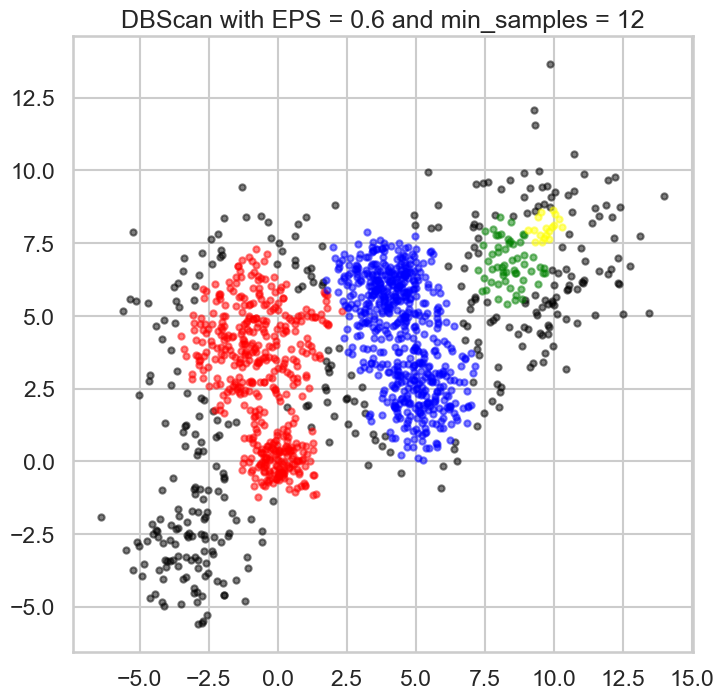

EPS: 0.6, Min Samples: 12, Silhouette Score: 0.208
[-1 -1 -1 ... -1 -1  2]


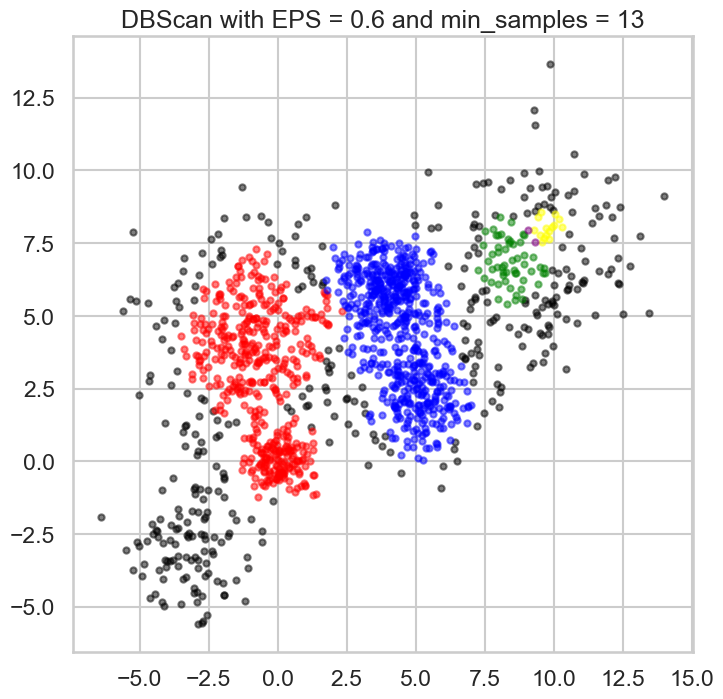

EPS: 0.6, Min Samples: 13, Silhouette Score: 0.187
[-1 -1 -1 ... -1 -1  2]


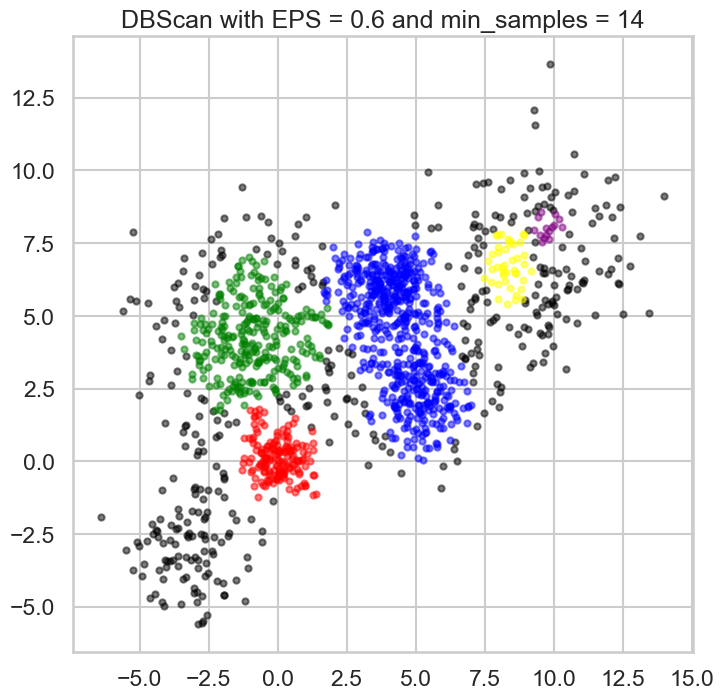

EPS: 0.6, Min Samples: 14, Silhouette Score: 0.172
[-1 -1 -1 ... -1 -1  3]


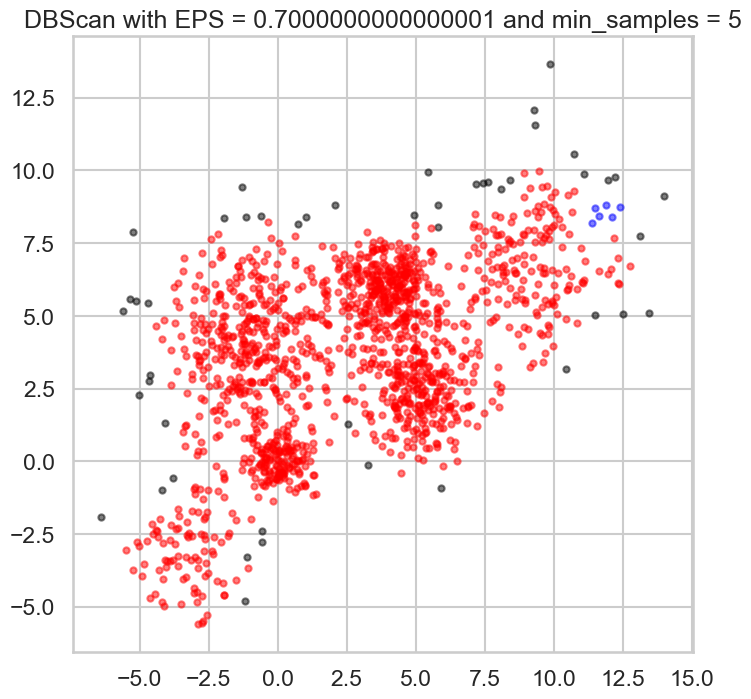

EPS: 0.7000000000000001, Min Samples: 5, Silhouette Score: 0.230
[ 0  0  0 ... -1 -1  0]


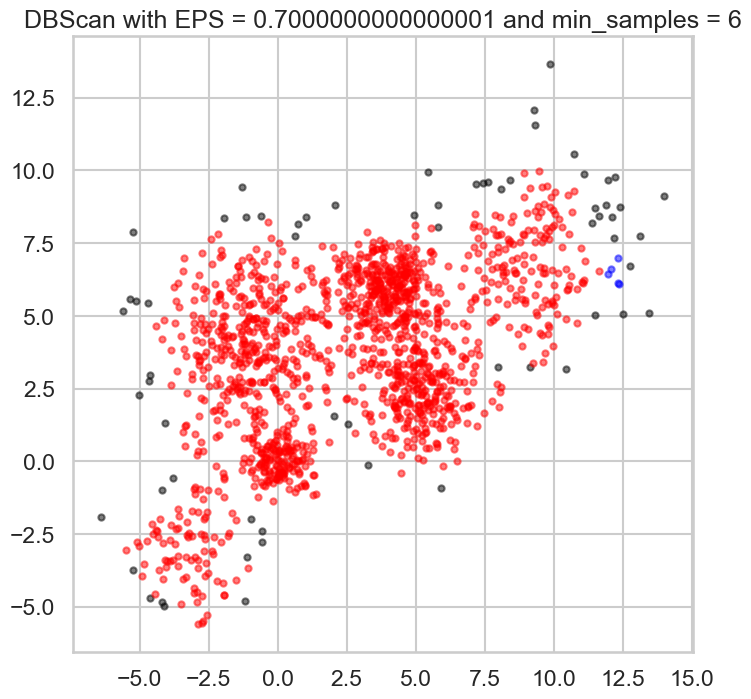

EPS: 0.7000000000000001, Min Samples: 6, Silhouette Score: 0.237
[ 0  0  0 ... -1 -1  0]


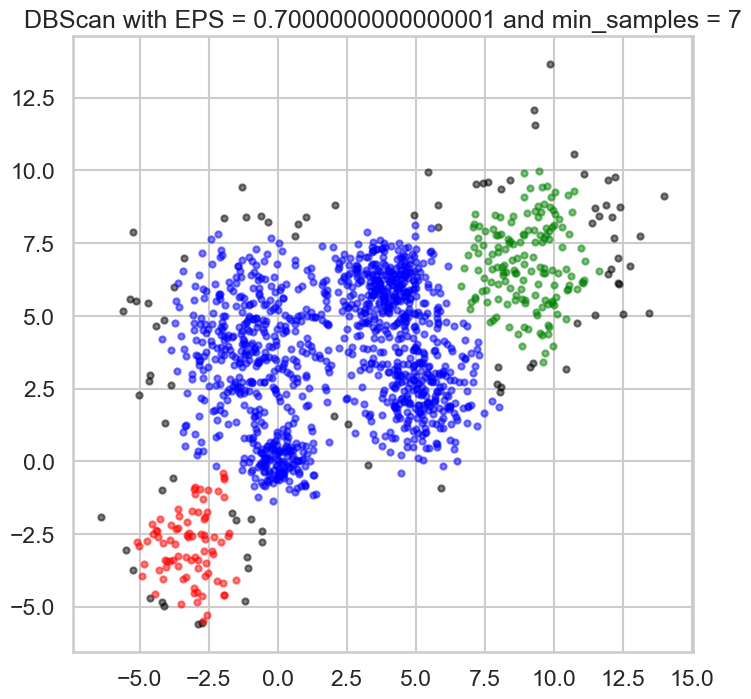

EPS: 0.7000000000000001, Min Samples: 7, Silhouette Score: 0.242
[ 0  0  0 ... -1 -1  2]


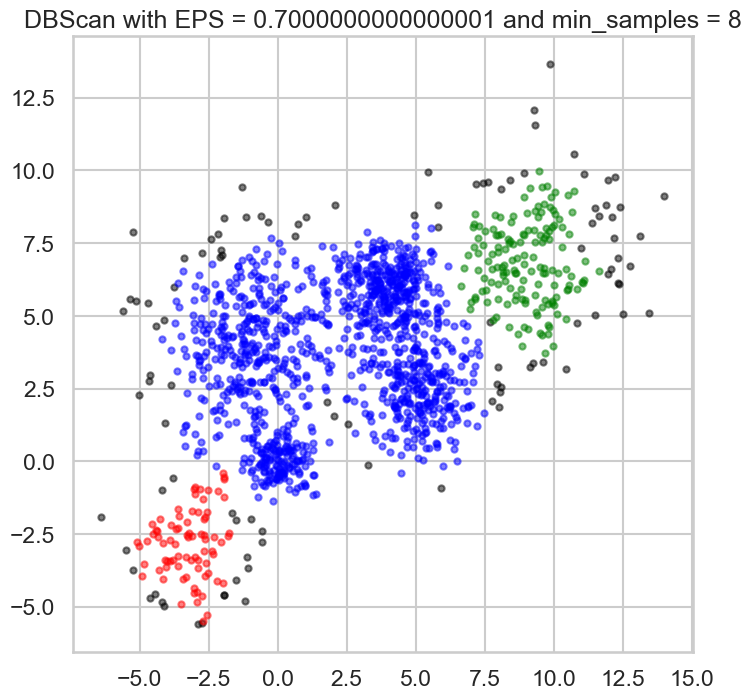

EPS: 0.7000000000000001, Min Samples: 8, Silhouette Score: 0.229
[ 0  0  0 ... -1 -1  2]


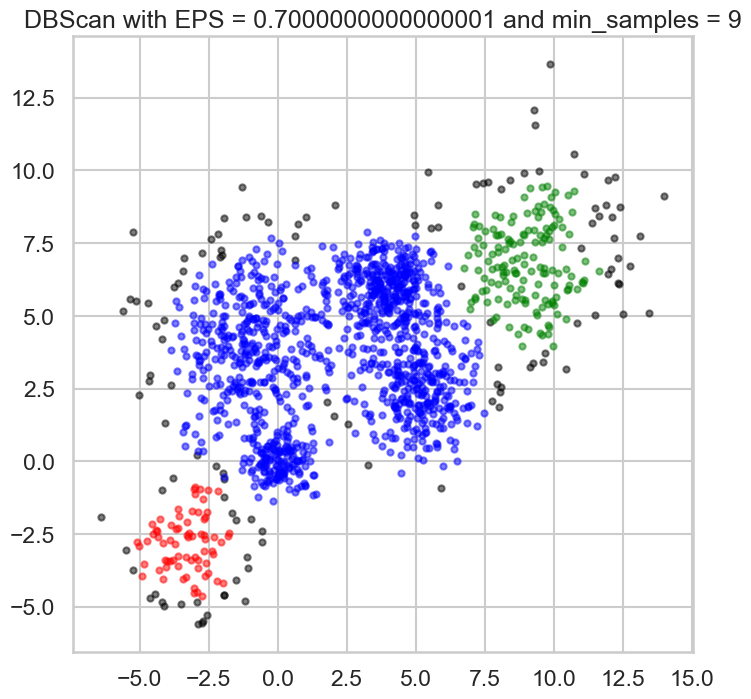

EPS: 0.7000000000000001, Min Samples: 9, Silhouette Score: 0.220
[ 0  0  0 ... -1 -1  2]


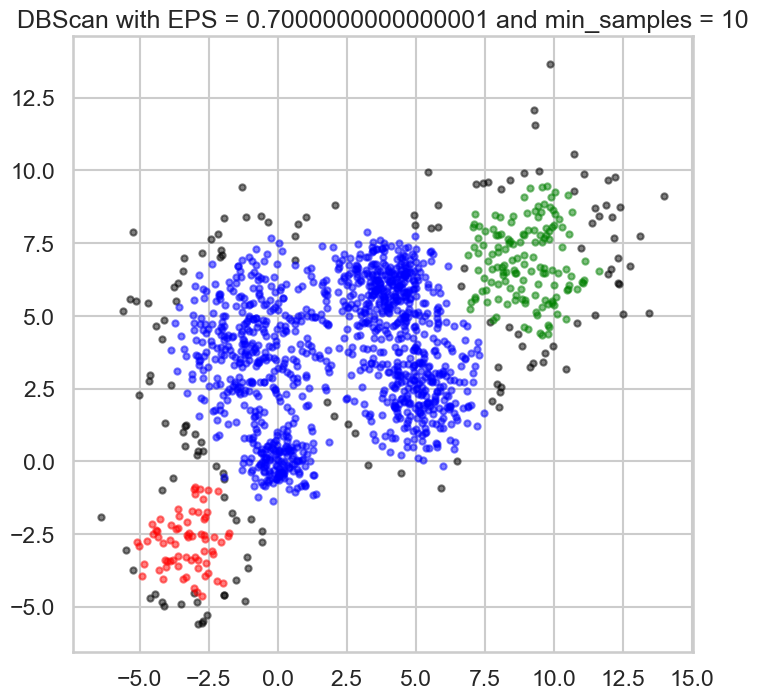

EPS: 0.7000000000000001, Min Samples: 10, Silhouette Score: 0.213
[ 0  0  0 ... -1 -1  2]


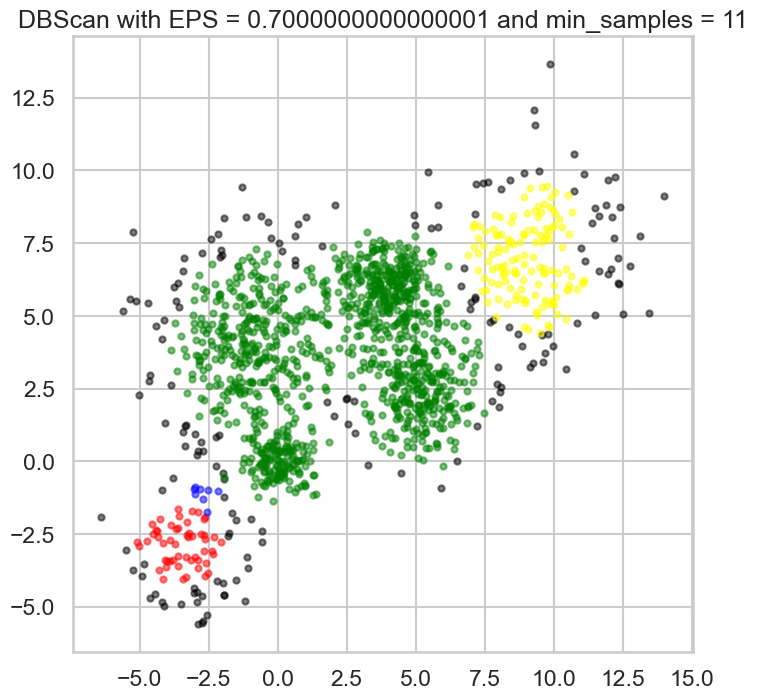

EPS: 0.7000000000000001, Min Samples: 11, Silhouette Score: 0.098
[ 0  1  0 ... -1 -1  3]


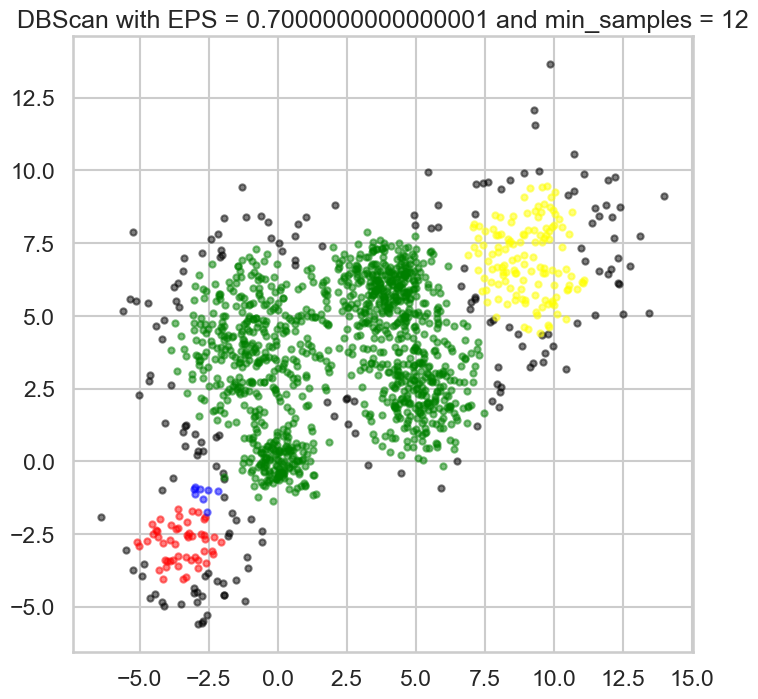

EPS: 0.7000000000000001, Min Samples: 12, Silhouette Score: 0.094
[ 0  1  0 ... -1 -1  3]


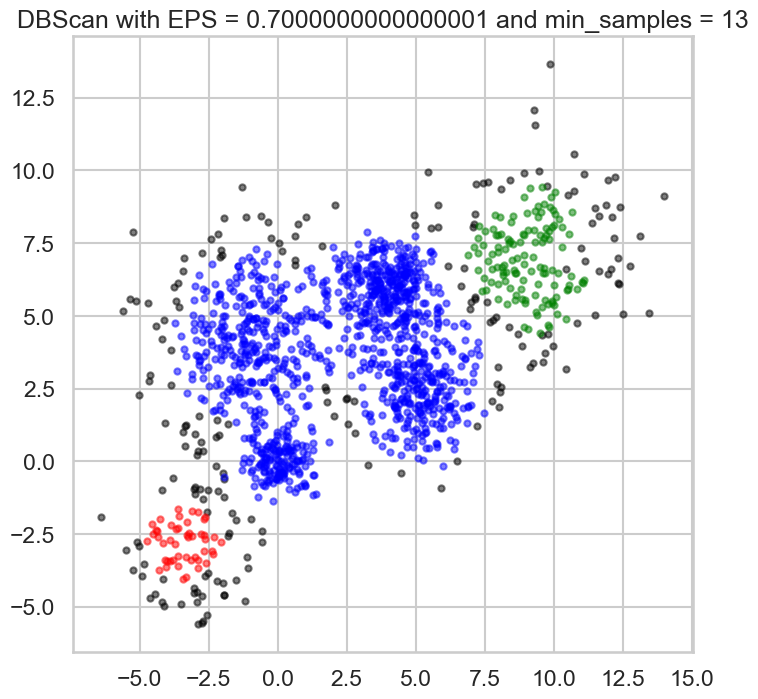

EPS: 0.7000000000000001, Min Samples: 13, Silhouette Score: 0.173
[ 0 -1  0 ... -1 -1  2]


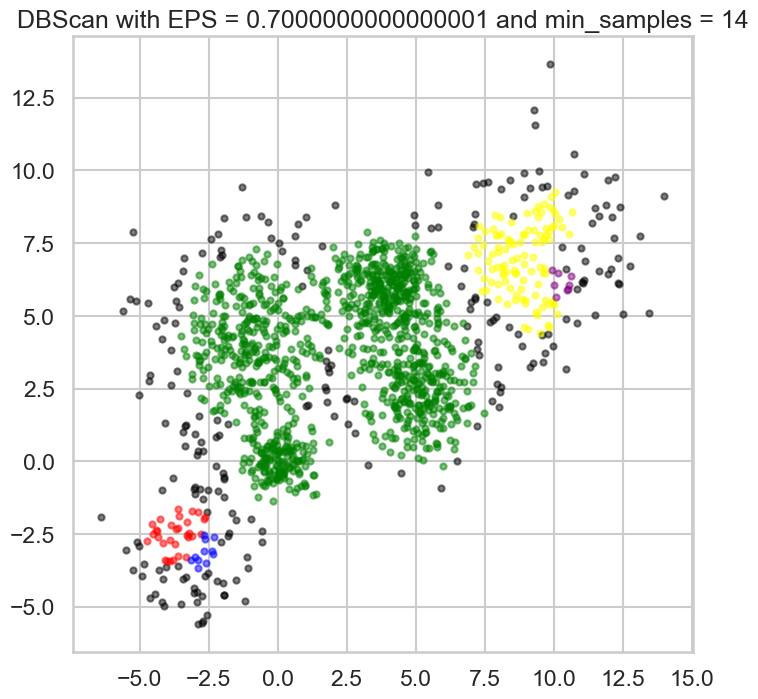

EPS: 0.7000000000000001, Min Samples: 14, Silhouette Score: 0.059
[ 1 -1  0 ... -1 -1  3]


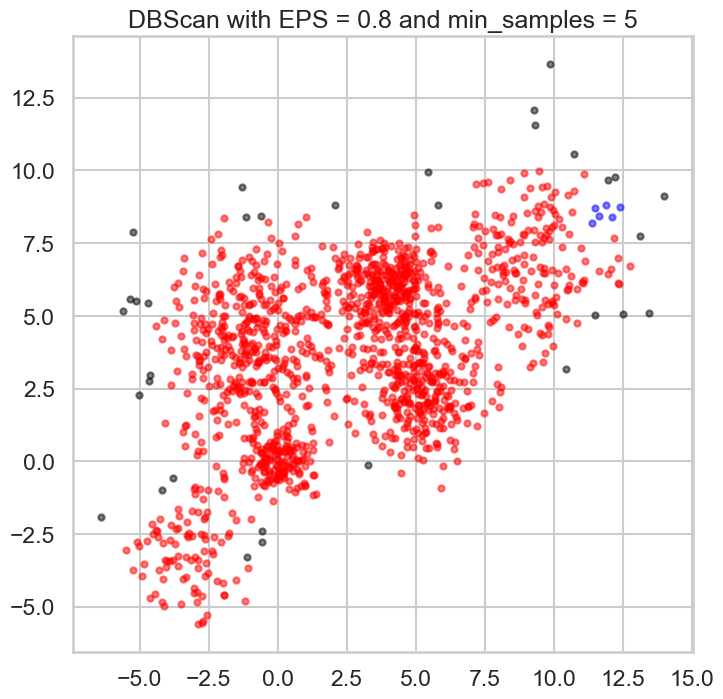

EPS: 0.8, Min Samples: 5, Silhouette Score: 0.245
[ 0  0  0 ... -1 -1  0]


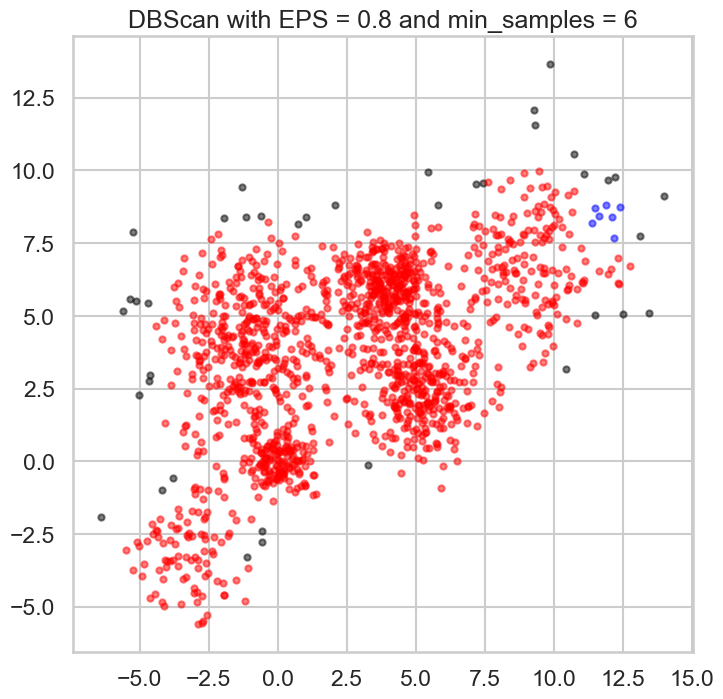

EPS: 0.8, Min Samples: 6, Silhouette Score: 0.242
[ 0  0  0 ... -1 -1  0]


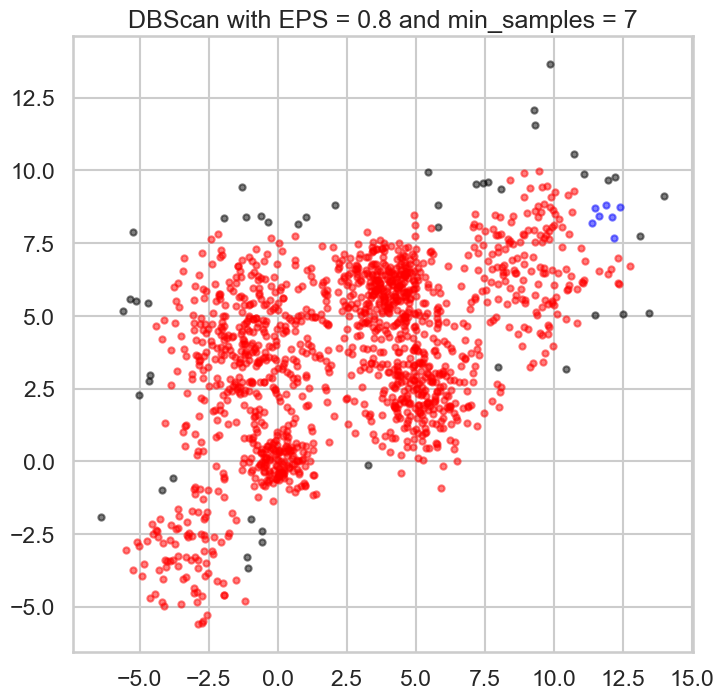

EPS: 0.8, Min Samples: 7, Silhouette Score: 0.233
[ 0  0  0 ... -1 -1  0]


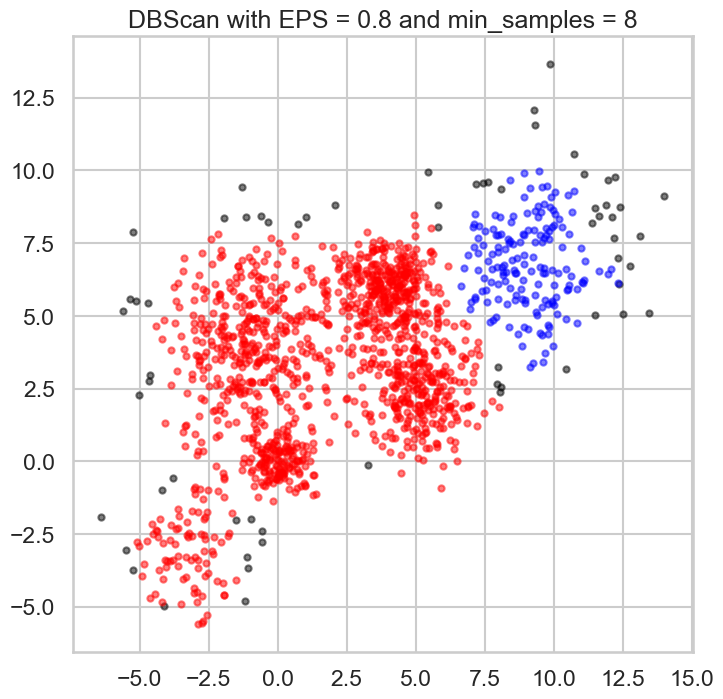

EPS: 0.8, Min Samples: 8, Silhouette Score: 0.305
[ 0  0  0 ... -1 -1  1]


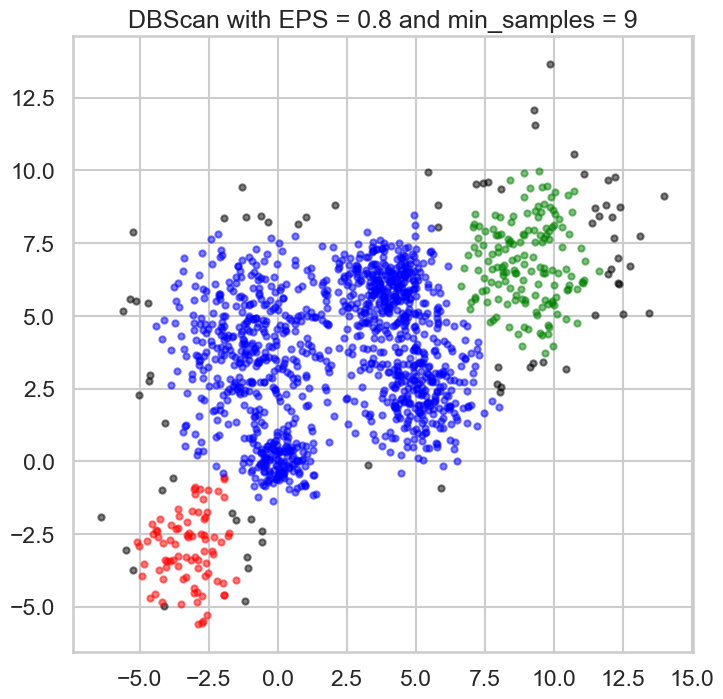

EPS: 0.8, Min Samples: 9, Silhouette Score: 0.255
[ 0  0  0 ... -1 -1  2]


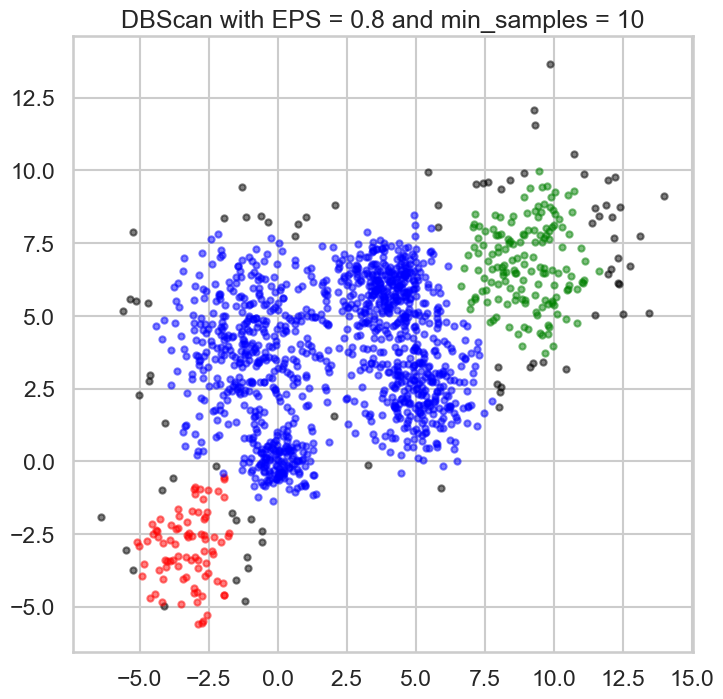

EPS: 0.8, Min Samples: 10, Silhouette Score: 0.250
[ 0  0  0 ... -1 -1  2]


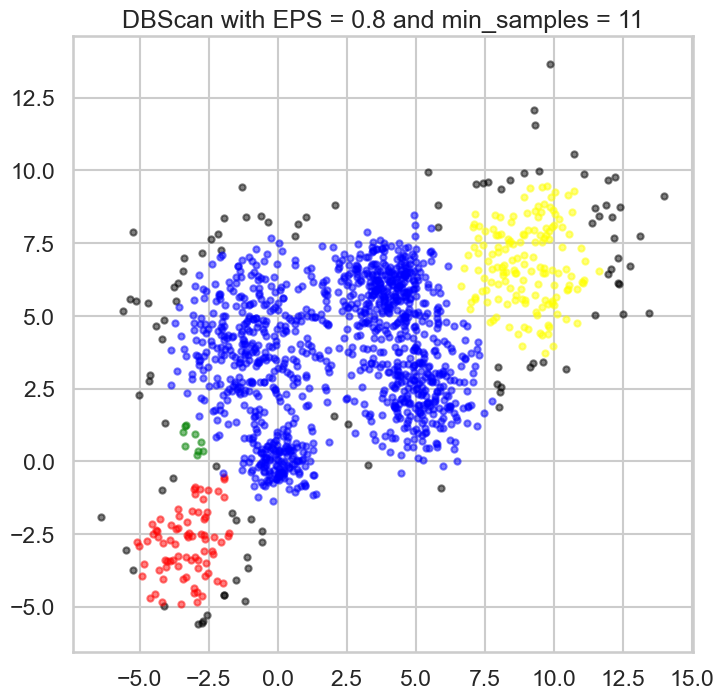

EPS: 0.8, Min Samples: 11, Silhouette Score: 0.096
[ 0  0  0 ... -1 -1  3]


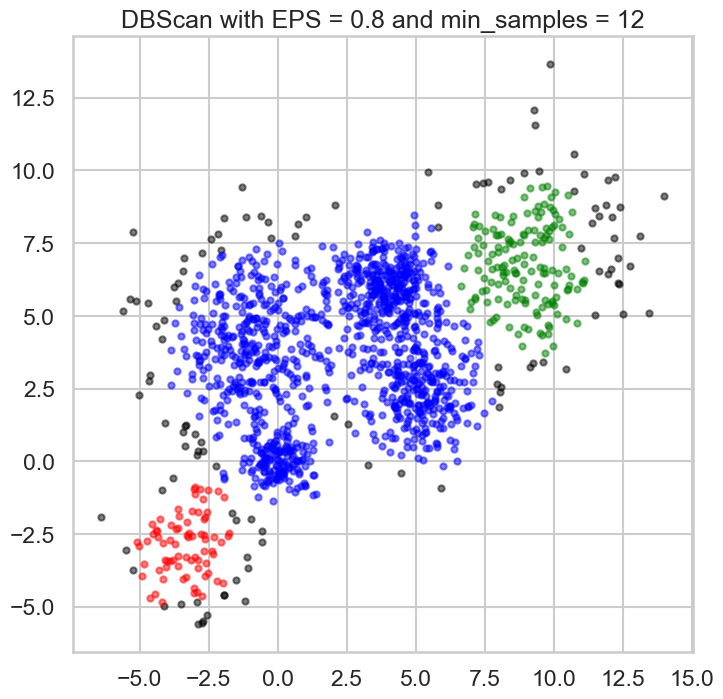

EPS: 0.8, Min Samples: 12, Silhouette Score: 0.226
[ 0  0  0 ... -1 -1  2]


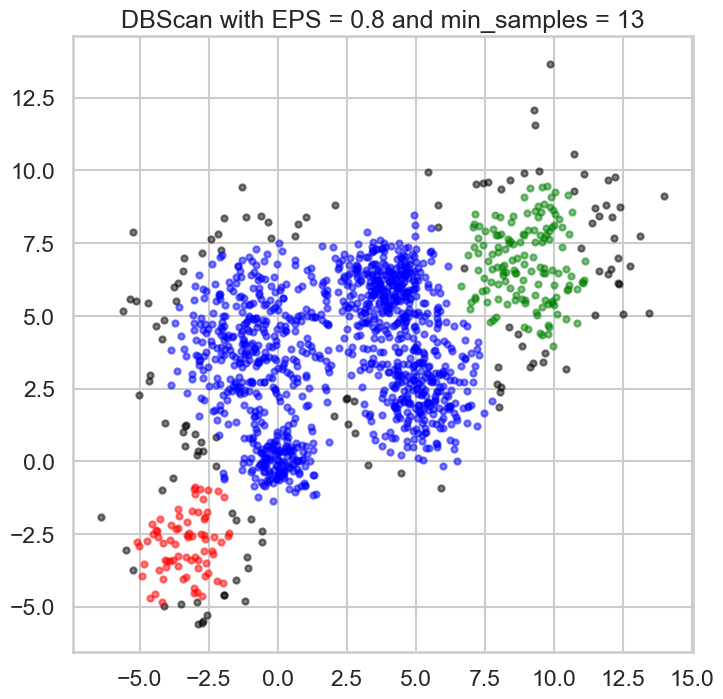

EPS: 0.8, Min Samples: 13, Silhouette Score: 0.220
[ 0  0  0 ... -1 -1  2]


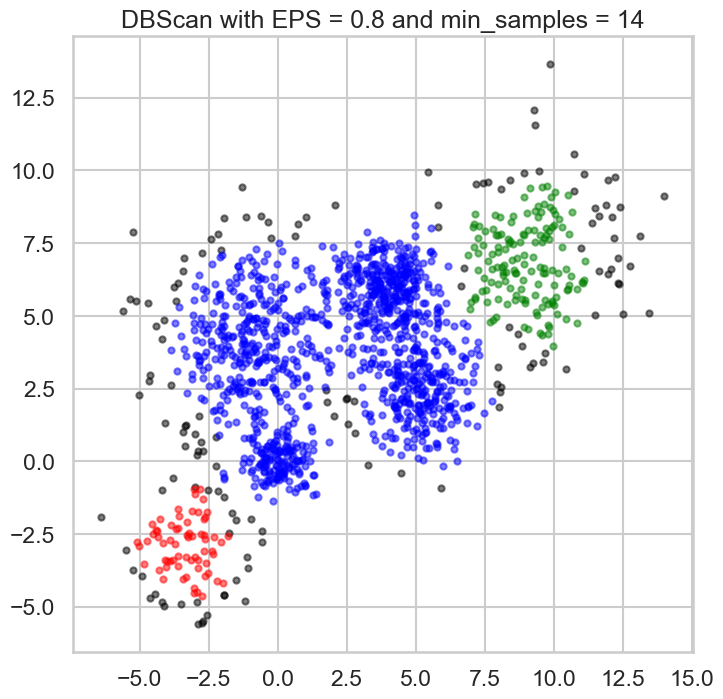

EPS: 0.8, Min Samples: 14, Silhouette Score: 0.210
[ 0 -1  0 ... -1 -1  2]


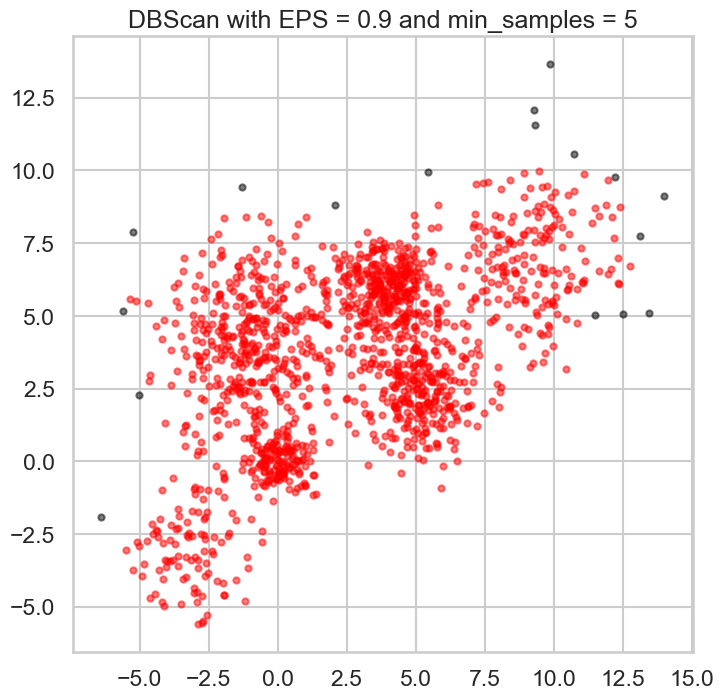

EPS: 0.9, Min Samples: 5, Silhouette Score: 0.391
[ 0  0  0 ... -1 -1  0]


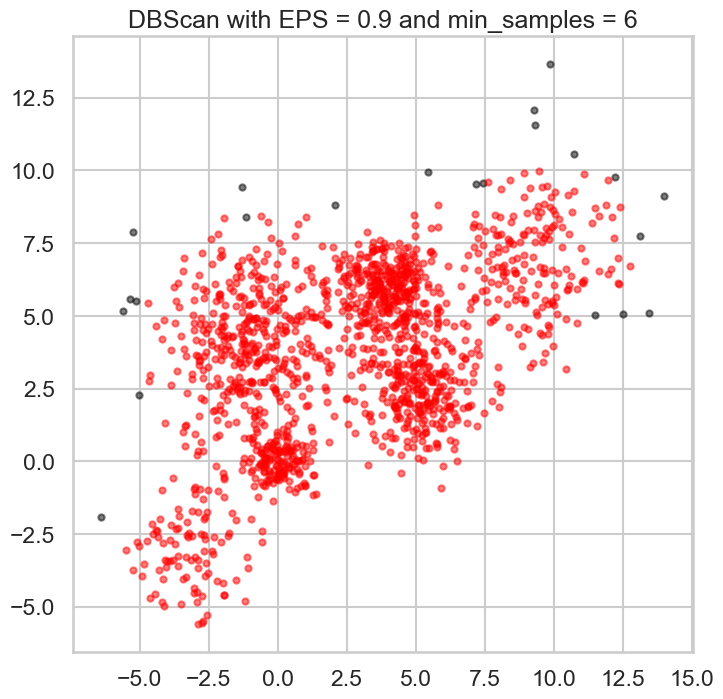

EPS: 0.9, Min Samples: 6, Silhouette Score: 0.370
[ 0  0  0 ... -1 -1  0]


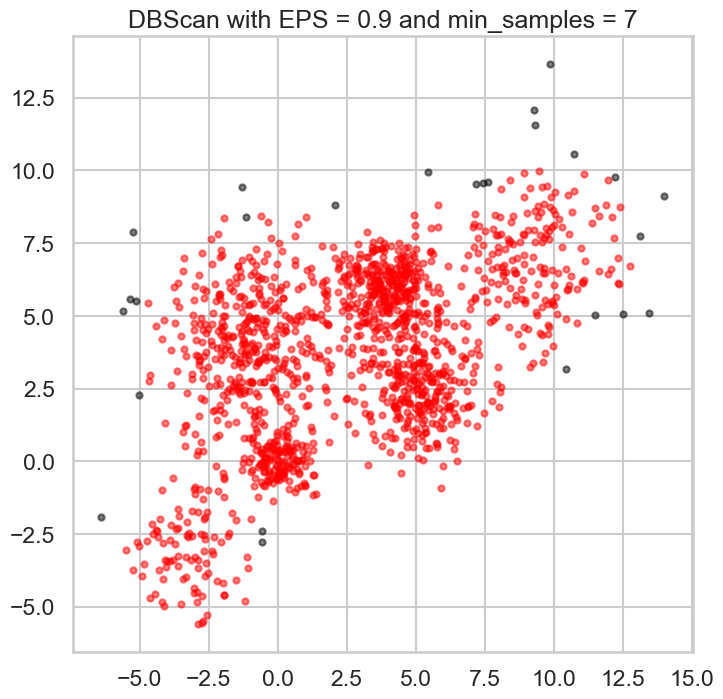

EPS: 0.9, Min Samples: 7, Silhouette Score: 0.357
[ 0  0  0 ... -1 -1  0]


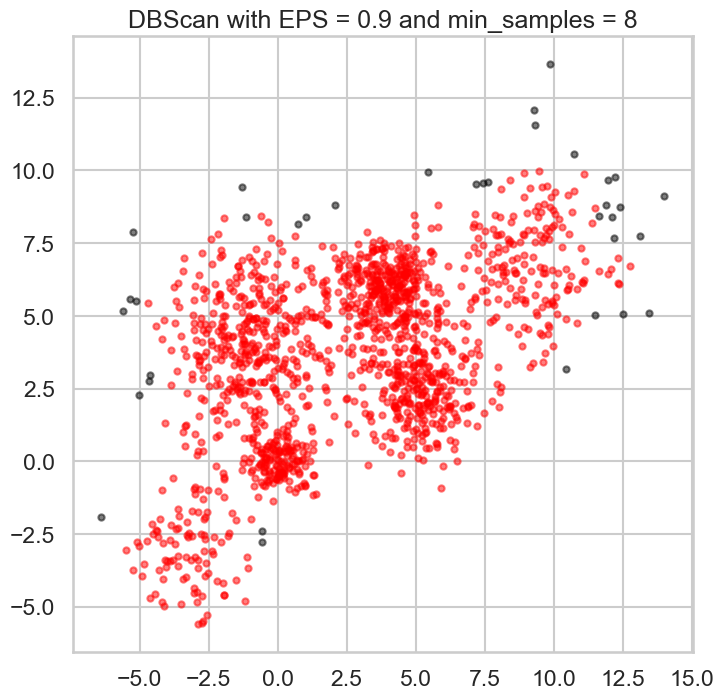

EPS: 0.9, Min Samples: 8, Silhouette Score: 0.356
[ 0  0  0 ... -1 -1  0]


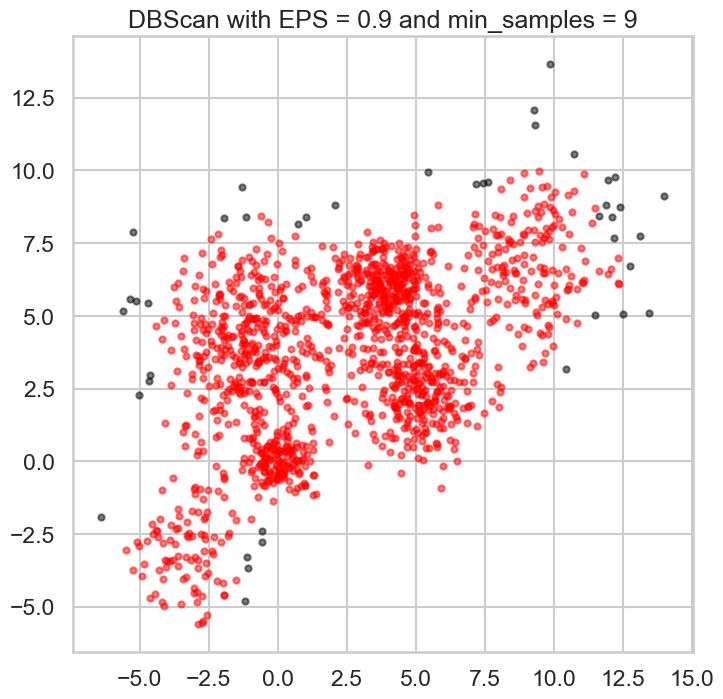

EPS: 0.9, Min Samples: 9, Silhouette Score: 0.357
[ 0  0  0 ... -1 -1  0]


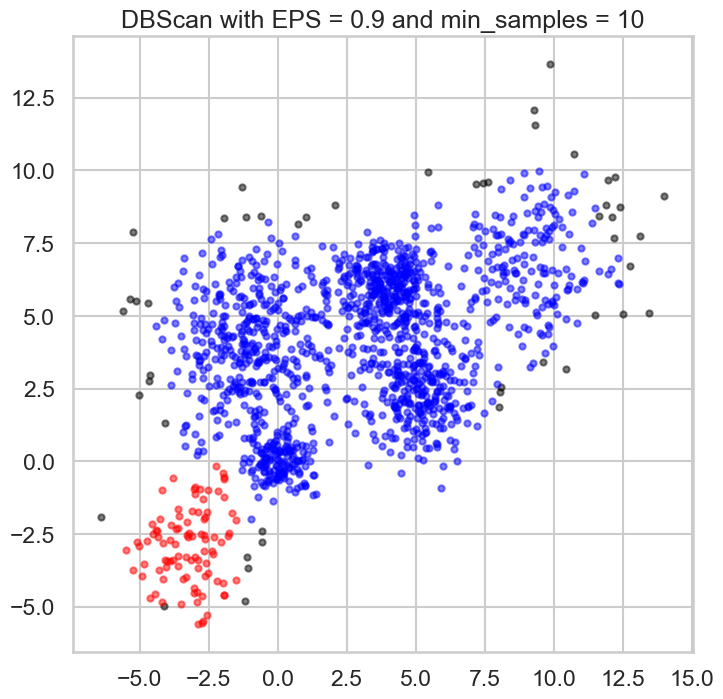

EPS: 0.9, Min Samples: 10, Silhouette Score: 0.284
[ 0  0  0 ... -1 -1  1]


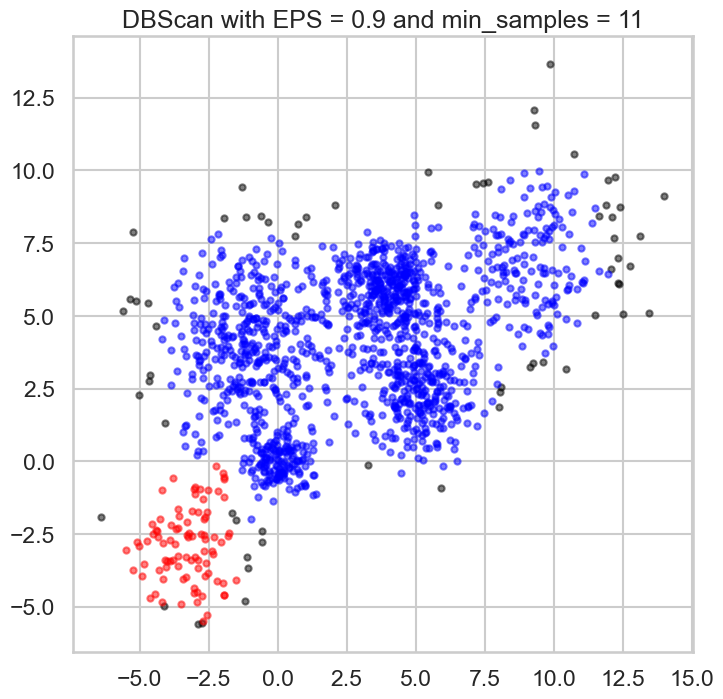

EPS: 0.9, Min Samples: 11, Silhouette Score: 0.275
[ 0  0  0 ... -1 -1  1]


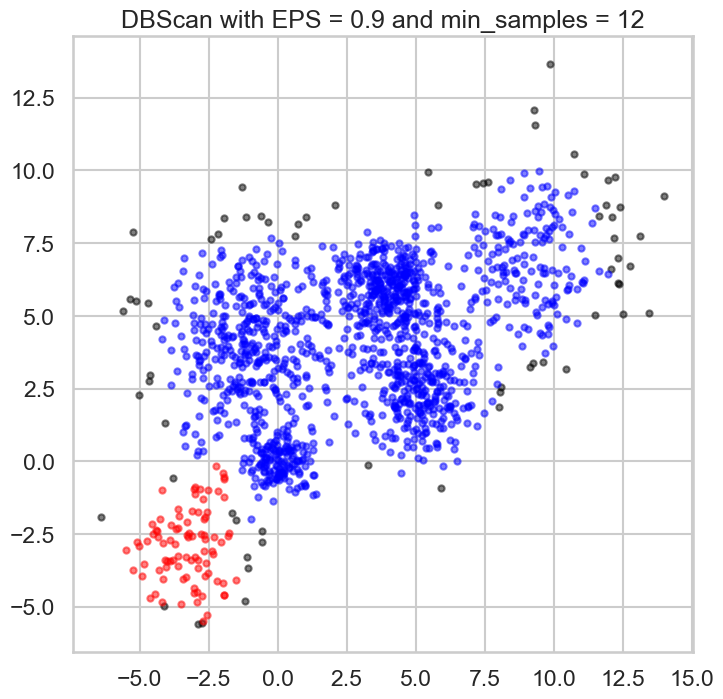

EPS: 0.9, Min Samples: 12, Silhouette Score: 0.276
[ 0  0  0 ... -1 -1  1]


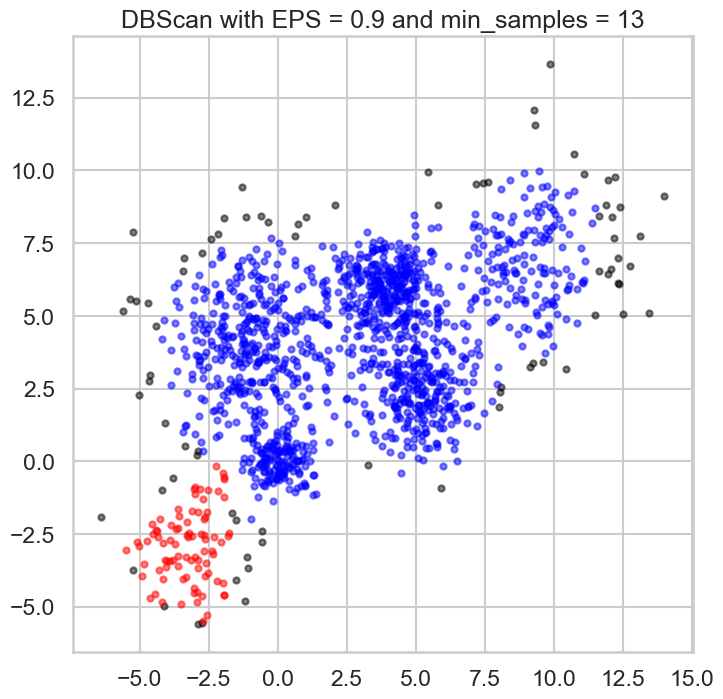

EPS: 0.9, Min Samples: 13, Silhouette Score: 0.280
[ 0  0  0 ... -1 -1  1]


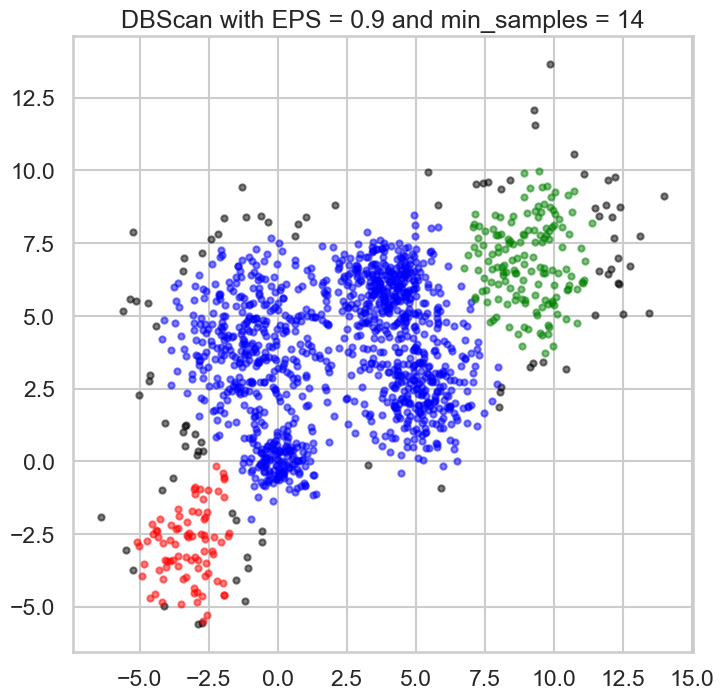

EPS: 0.9, Min Samples: 14, Silhouette Score: 0.246
[ 0  0  0 ... -1 -1  2]


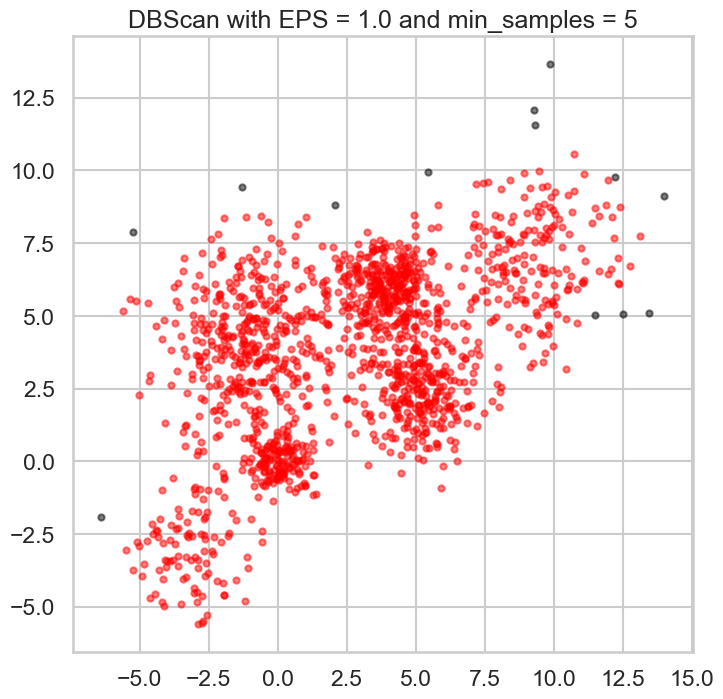

EPS: 1.0, Min Samples: 5, Silhouette Score: 0.386
[ 0  0  0 ... -1 -1  0]


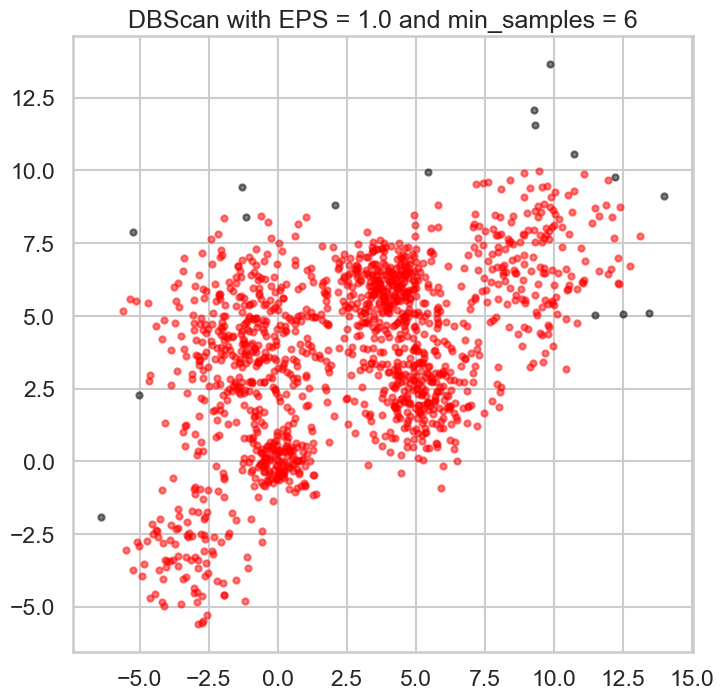

EPS: 1.0, Min Samples: 6, Silhouette Score: 0.378
[ 0  0  0 ... -1 -1  0]


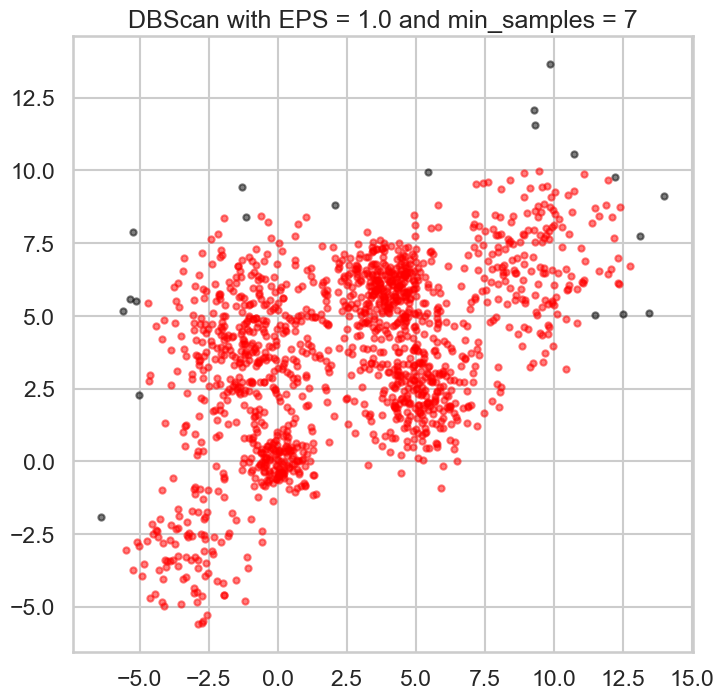

EPS: 1.0, Min Samples: 7, Silhouette Score: 0.382
[ 0  0  0 ... -1 -1  0]


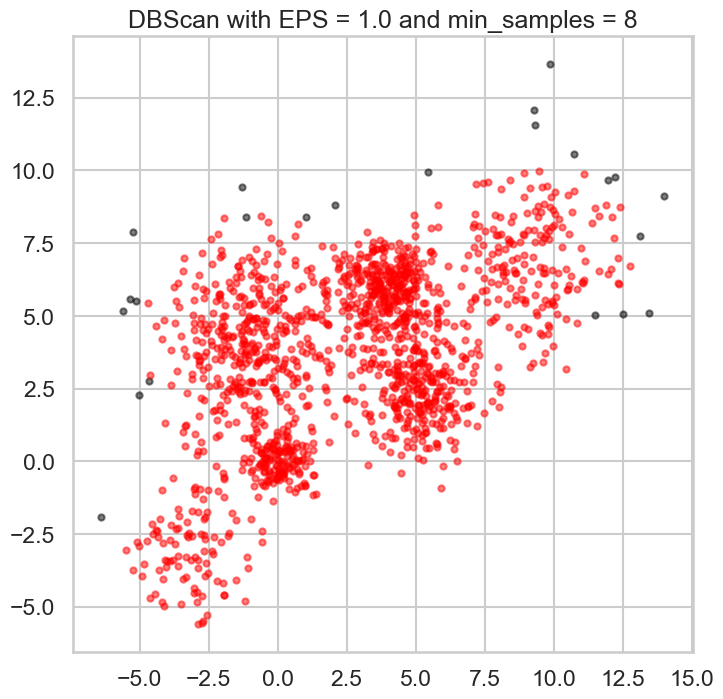

EPS: 1.0, Min Samples: 8, Silhouette Score: 0.373
[ 0  0  0 ... -1 -1  0]


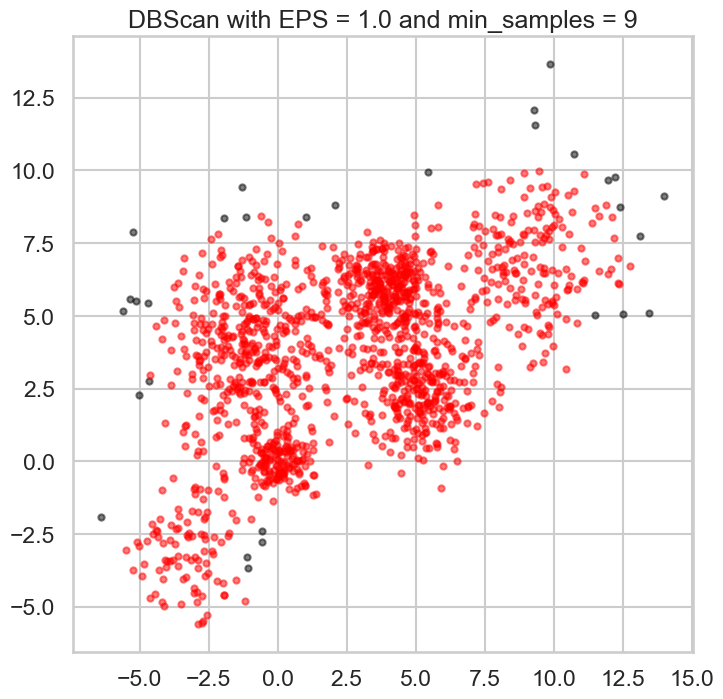

EPS: 1.0, Min Samples: 9, Silhouette Score: 0.363
[ 0  0  0 ... -1 -1  0]


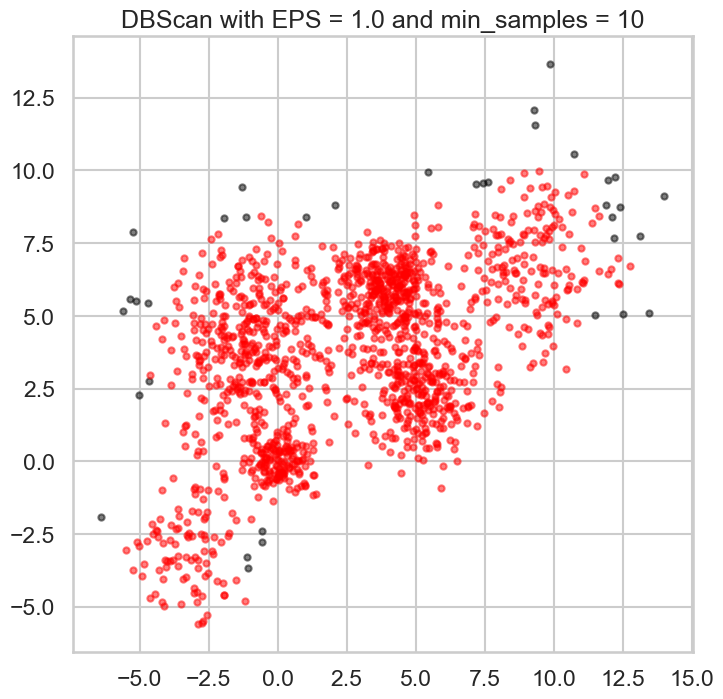

EPS: 1.0, Min Samples: 10, Silhouette Score: 0.360
[ 0  0  0 ... -1 -1  0]


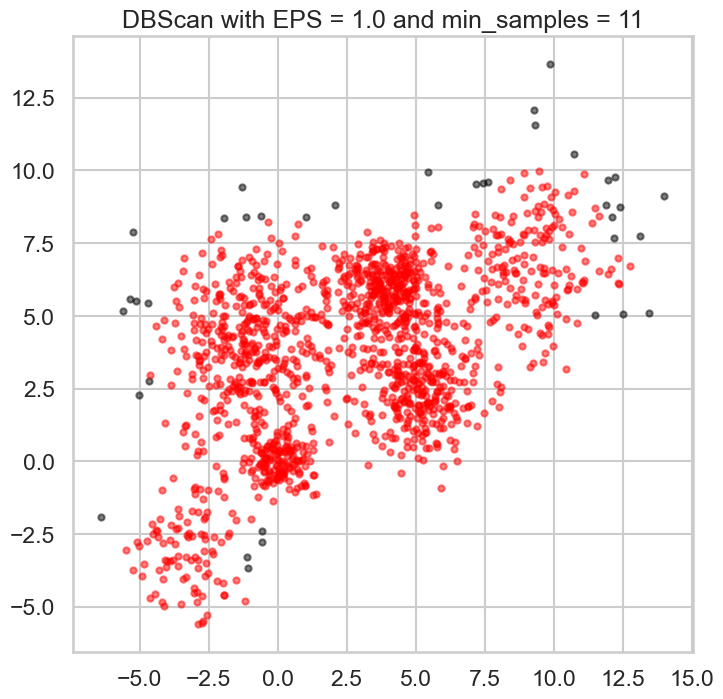

EPS: 1.0, Min Samples: 11, Silhouette Score: 0.351
[ 0  0  0 ... -1 -1  0]


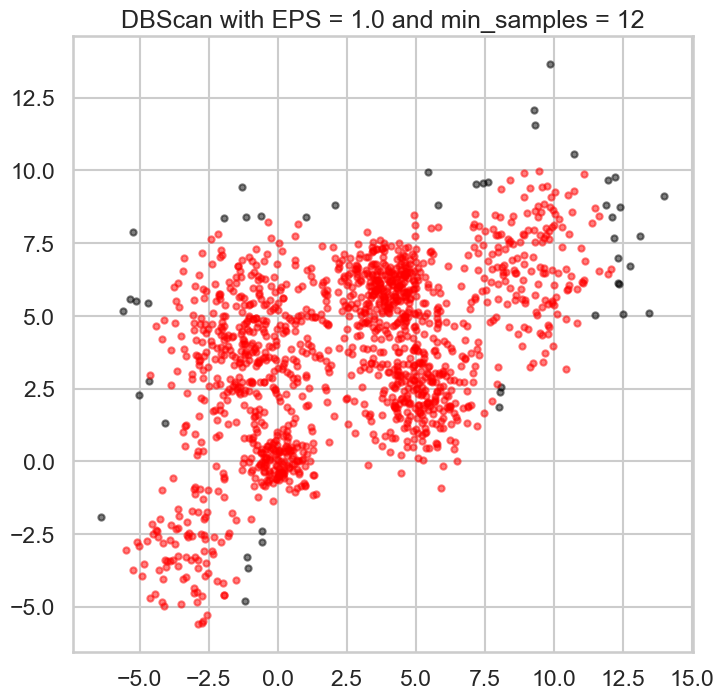

EPS: 1.0, Min Samples: 12, Silhouette Score: 0.345
[ 0  0  0 ... -1 -1  0]


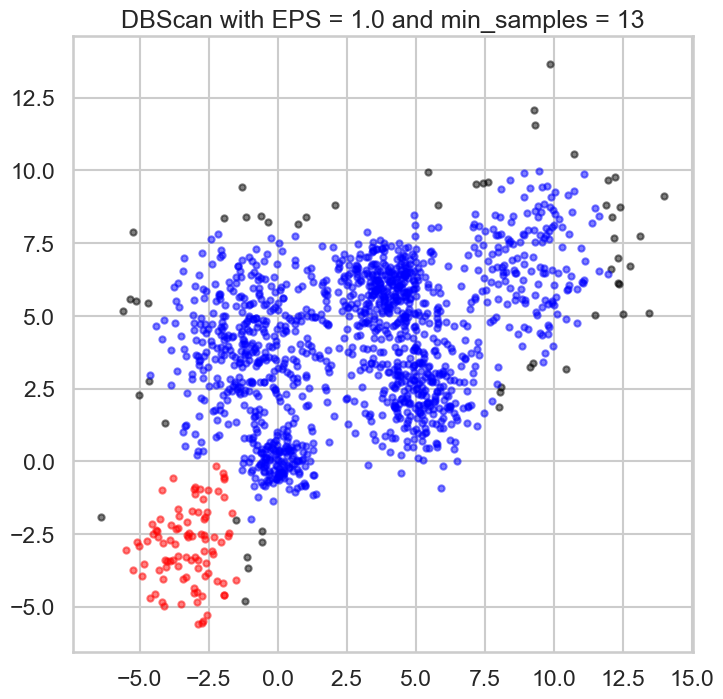

EPS: 1.0, Min Samples: 13, Silhouette Score: 0.273
[ 0  0  0 ... -1 -1  1]


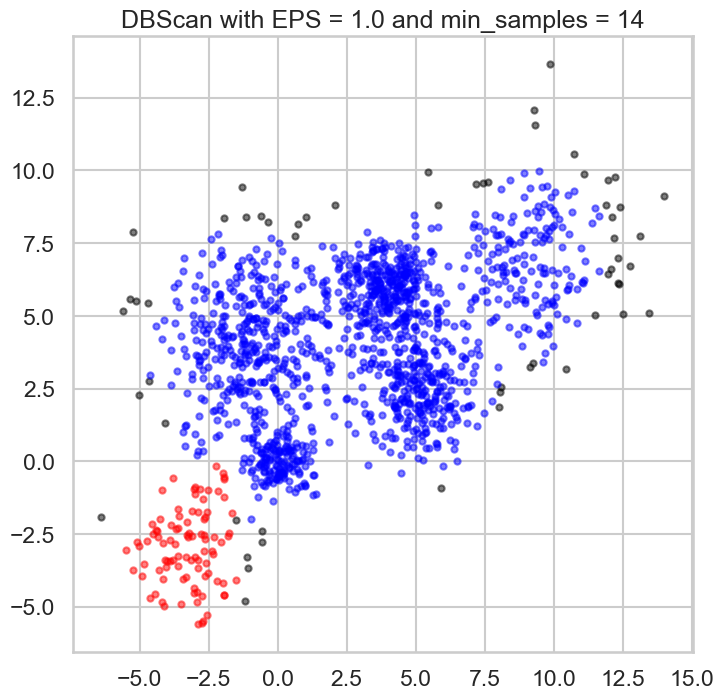

EPS: 1.0, Min Samples: 14, Silhouette Score: 0.269
[ 0  0  0 ... -1 -1  1]
Best Parameters: (0.9, 5), Silhouette Score: 0.391


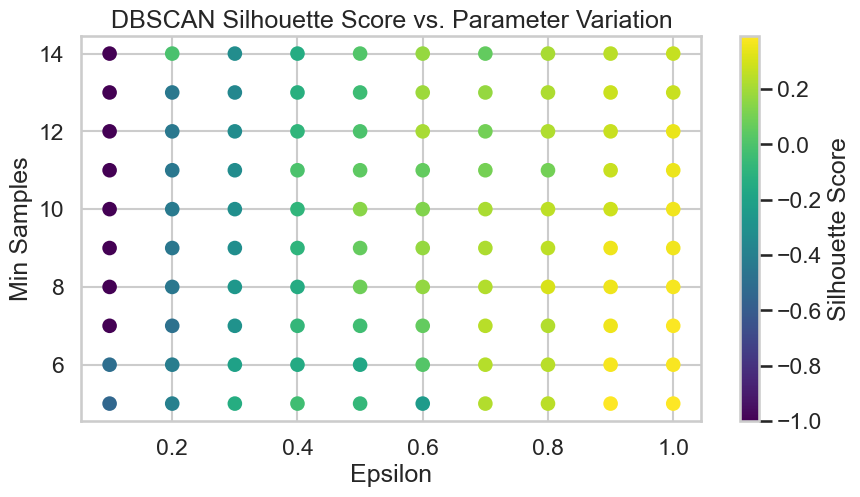

In [9]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

# Define parameters to try
eps_values = np.arange(0.1, 1.1, 0.1)
min_samples_values = range(5, 15,1)


# Store results
best_score = -1
best_params = None
all_scores = {}

# Try different parameters
for eps in eps_values:
    for min_samples in min_samples_values:
        try:
            # Perform DBSCAN clustering
            model = DBSCAN(eps=eps, min_samples=min_samples)
            model.fit(Multi_blob_Data)


            
            # Compute the silhouette score for the current clustering
            labels = model.labels_
            if len(np.unique(labels)) > 1: # Skip if there's only one cluster
                score = silhouette_score(Multi_blob_Data, labels)
            else:
                score = -1
            
            # Store results
            params = (eps, min_samples)
            all_scores[params] = score

            # Plot clusters
            plt.title(f'DBScan with EPS = {eps} and min_samples = {min_samples}')
            display_cluster(Multi_blob_Data, model, len(np.unique(model.labels_)))
            plt.show()

            # Print resulting clusters
            print(f'EPS: {eps}, Min Samples: {min_samples}, Silhouette Score: {score:.3f}')
            print(model.labels_)

            # Update best score
            if score > best_score:
                best_score = score
                best_params = params
        except Exception as e:
            print(f"An error occurred: {e}")
            continue

# Print best parameters and score
print(f'Best Parameters: {best_params}, Silhouette Score: {best_score:.3f}')

# Plot silhouette score versus parameter variation
scores = [score for params, score in all_scores.items()]
params = list(all_scores.keys())
eps_values = [p[0] for p in params]
min_samples_values = [p[1] for p in params]

fig, ax = plt.subplots(figsize=(10, 5))
sc = ax.scatter(eps_values, min_samples_values, c=scores, cmap='viridis')
cbar = plt.colorbar(sc)
ax.set_xlabel('Epsilon')
ax.set_ylabel('Min Samples')
cbar.ax.set_ylabel('Silhouette Score')
plt.title('DBSCAN Silhouette Score vs. Parameter Variation')
plt.show()


### Gaussian Mixture
* Use GaussianMixture function to cluster the above data 
* In GMM change the covariance_type and check the difference in the resulting proabability fit 
* Use a 2D contour plot to plot the resulting distribution (the components of the GMM) as well as the total Gaussian mixture 

Silhouette score for spherical: 0.4746189699249217


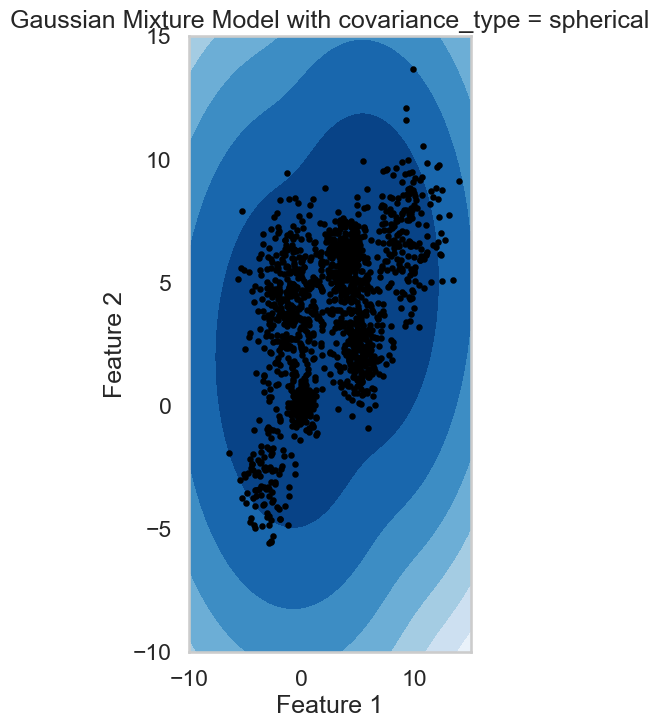

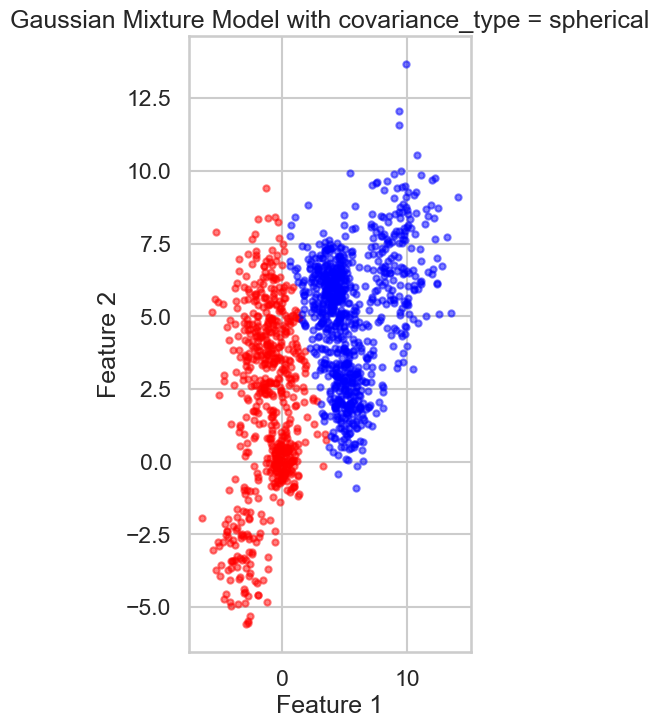

Silhouette score for diag: 0.4702266176559404


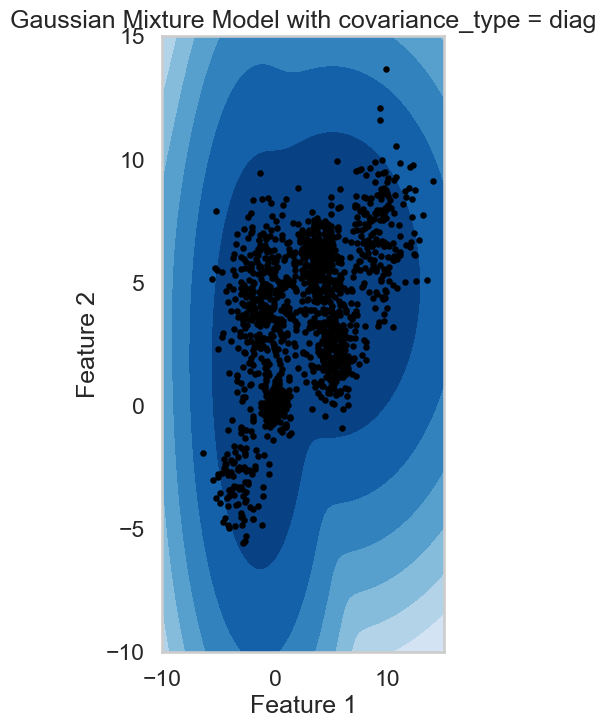

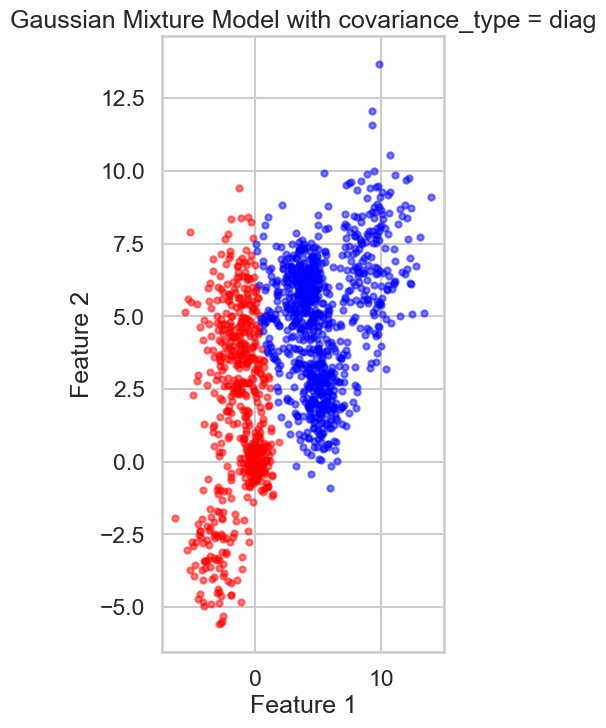

Silhouette score for tied: 0.4616271377644119


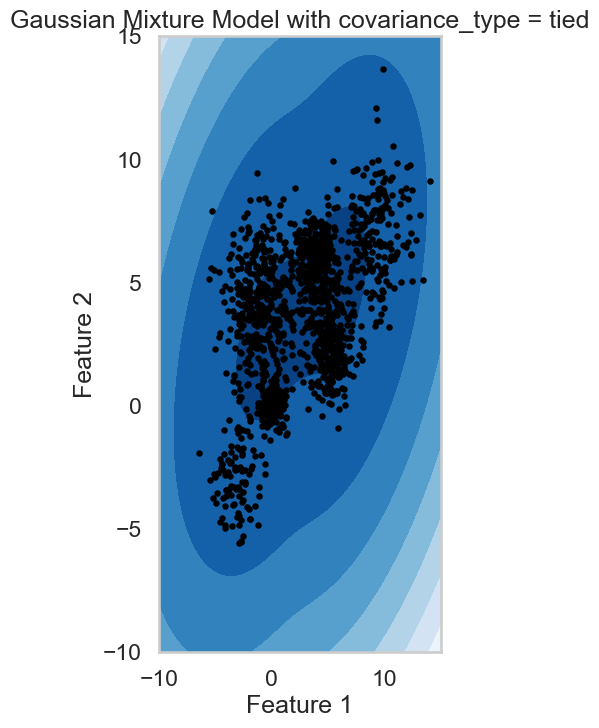

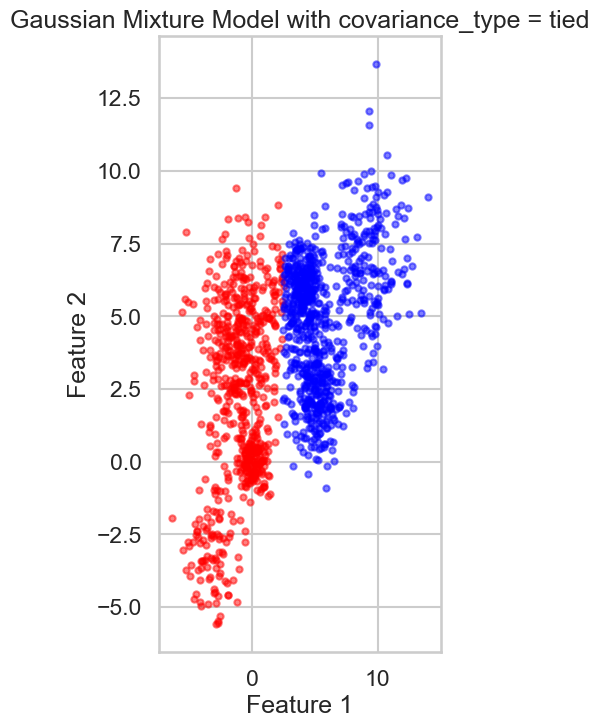

Silhouette score for full: 0.46648996330278436


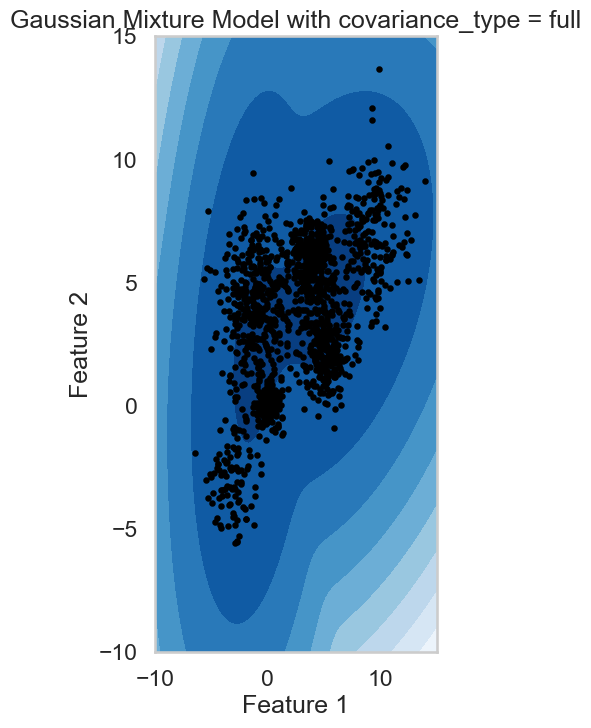

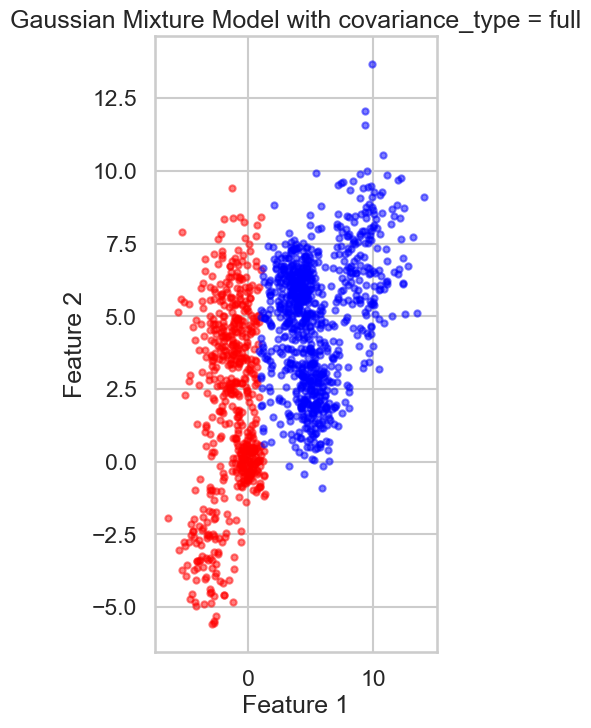

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture


# Define covariance types to try
covariance_types = ['spherical', 'diag', 'tied', 'full']

# Define number of components
n_components = 2

# Loop over covariance types
for type in covariance_types:
    # Create GMM object and fit to data
    gmm = GaussianMixture(n_components=n_components, covariance_type=type, random_state=0)
    gmm.fit(pd.DataFrame(Multi_blob_Data))
    
    # Get silhouette score
    from sklearn.metrics import silhouette_score
    labels = gmm.predict(Multi_blob_Data)
    score = silhouette_score(Multi_blob_Data, labels)
    print(f'Silhouette score for {type}: {score}')

    # Define the grid for the contour plot
    x_min, x_max = -10, 15
    y_min, y_max = -10, 15
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = -gmm.score_samples(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    # Create the contour plot
    plt.subplot(1, 2, 1)
    plt.contourf(xx, yy, Z, cmap=plt.cm.Blues_r)
    plt.scatter(Multi_blob_Data[:, 0], Multi_blob_Data[:, 1], s=10, color='black')
    plt.title(f'Gaussian Mixture Model with covariance_type = {type}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.show()

    # Display the scatter plot with highlighted clusters
    plt.subplot(1, 2, 2)
    display_cluster_gmm(Multi_blob_Data, gmm=gmm, num_clusters=n_components)
    plt.title(f'Gaussian Mixture Model with covariance_type = {type}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    
    plt.show()


## iris data set 
The iris data set is test data set that is part of the Sklearn module 
which contains 150 records each with 4 features. All the features are represented by real numbers 

The data represents three classes 


In [11]:
from sklearn.datasets import load_iris
iris_data = load_iris()
iris_data.target[[10, 25, 50]]
#array([0, 0, 1])
list(iris_data.target_names)
['setosa', 'versicolor', 'virginica']


['setosa', 'versicolor', 'virginica']

* Repeat all the above clustering approaches and steps on the above data 
* Normalize the data then repeat all the above steps 
* Compare between the different clustering approaches 

In [12]:
df_iris = pd.DataFrame(data= np.c_[iris_data['data'], iris_data['target']],columns= iris_data['feature_names'] + ['target'])


KMeans(n_clusters=1)
KMeans(n_clusters=2)
KMeans(n_clusters=3)
KMeans(n_clusters=4)
KMeans(n_clusters=5)
KMeans(n_clusters=6)
KMeans(n_clusters=7)
KMeans()
KMeans(n_clusters=9)
KMeans(n_clusters=10)


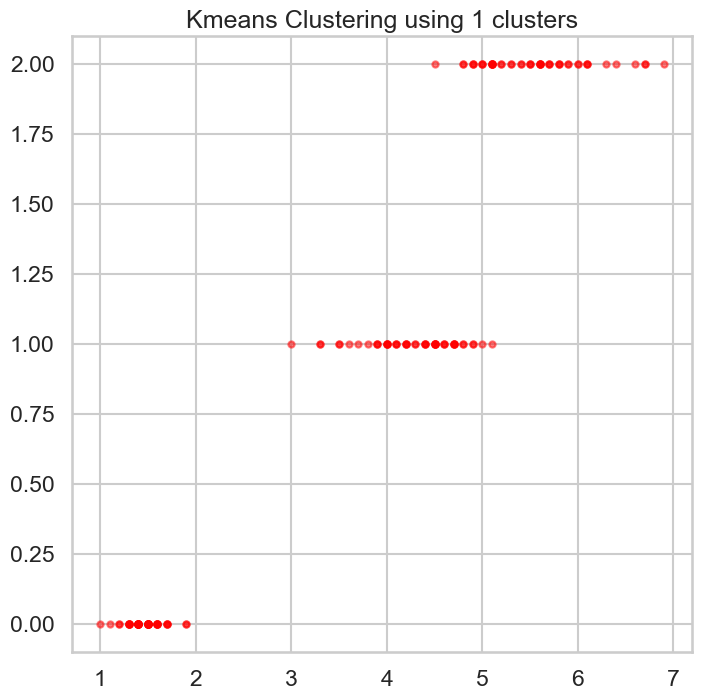

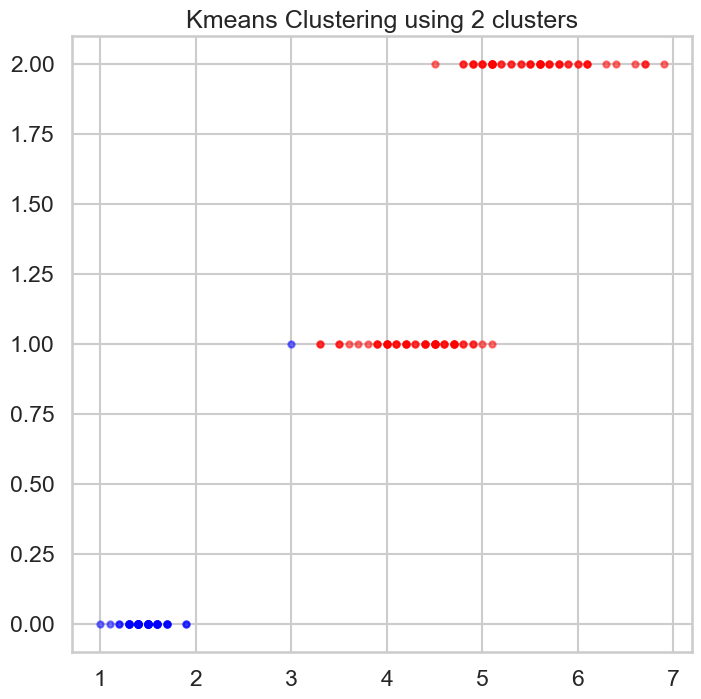

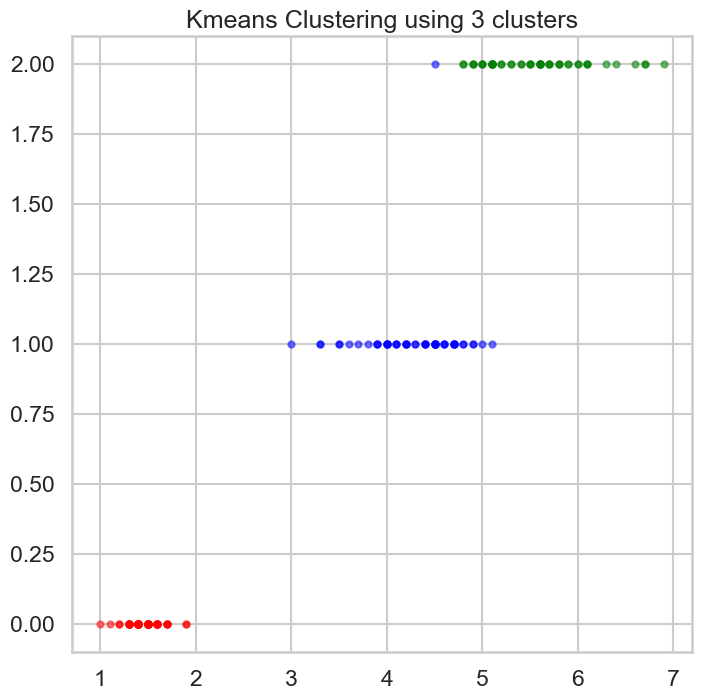

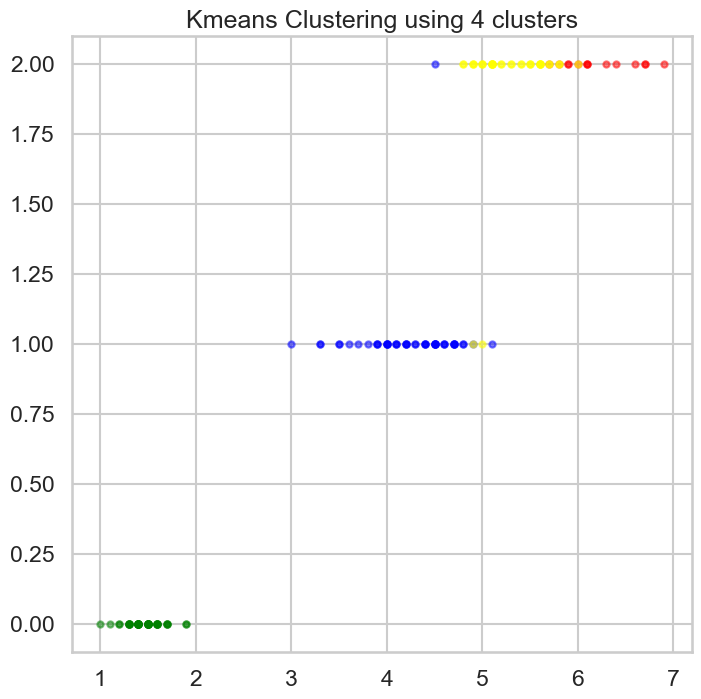

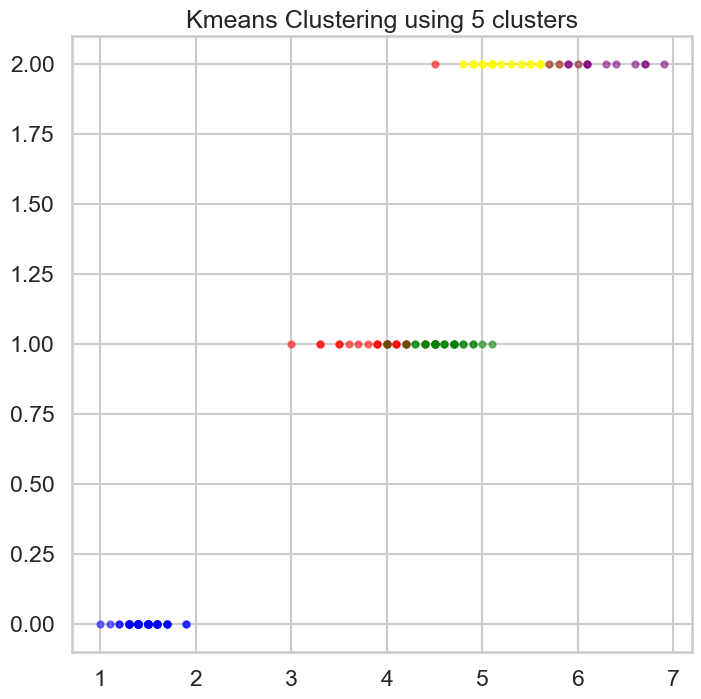

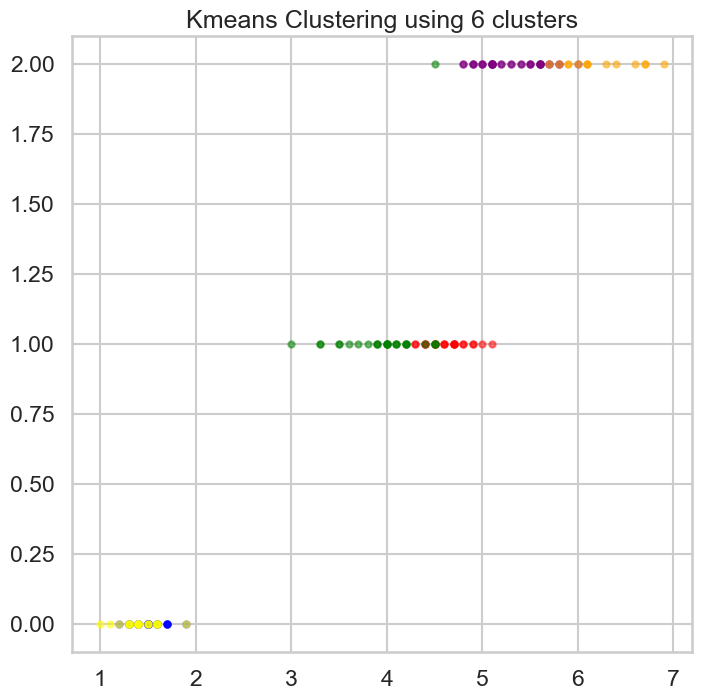

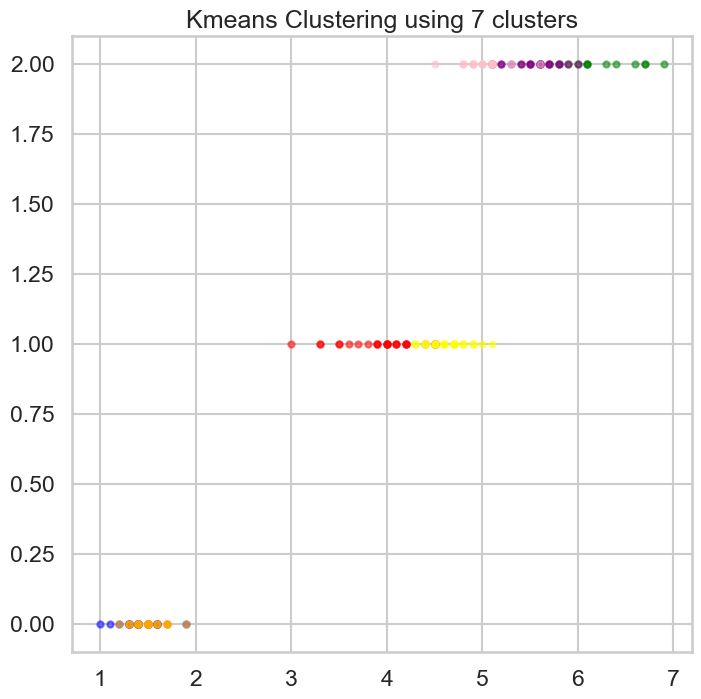

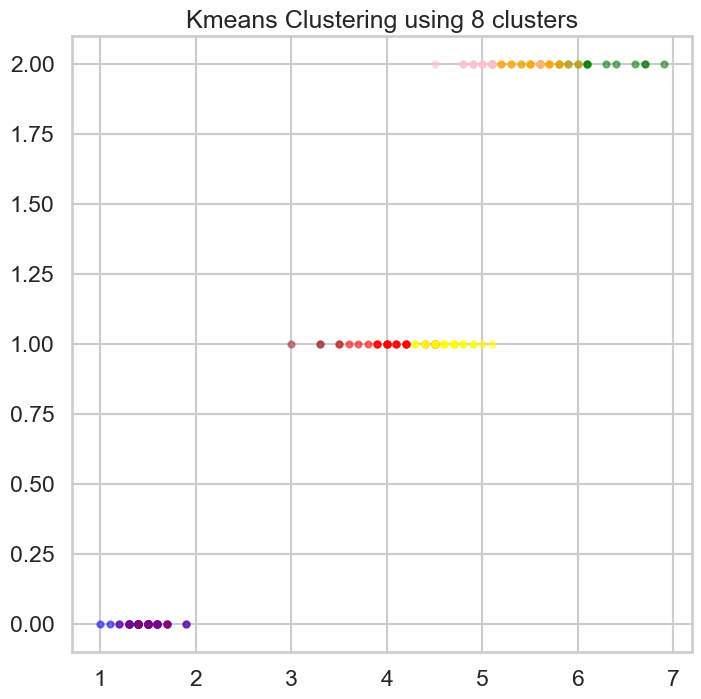

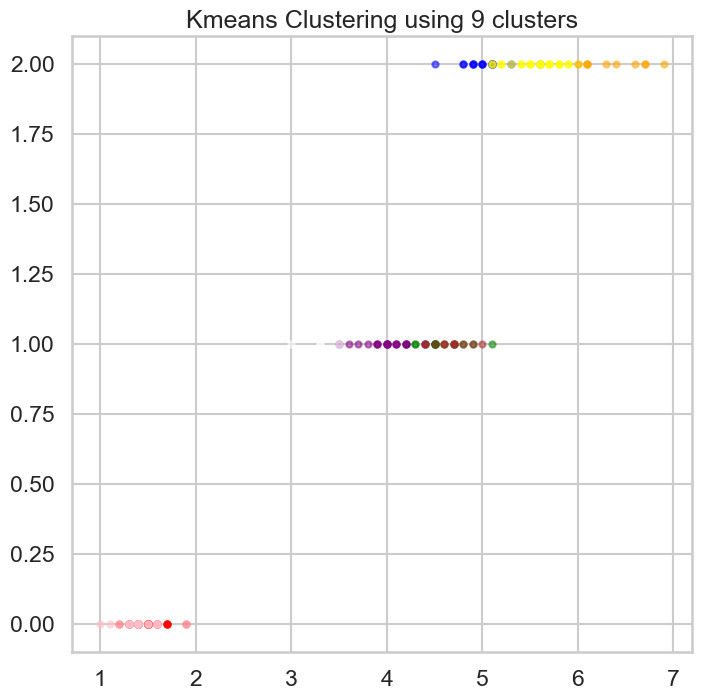

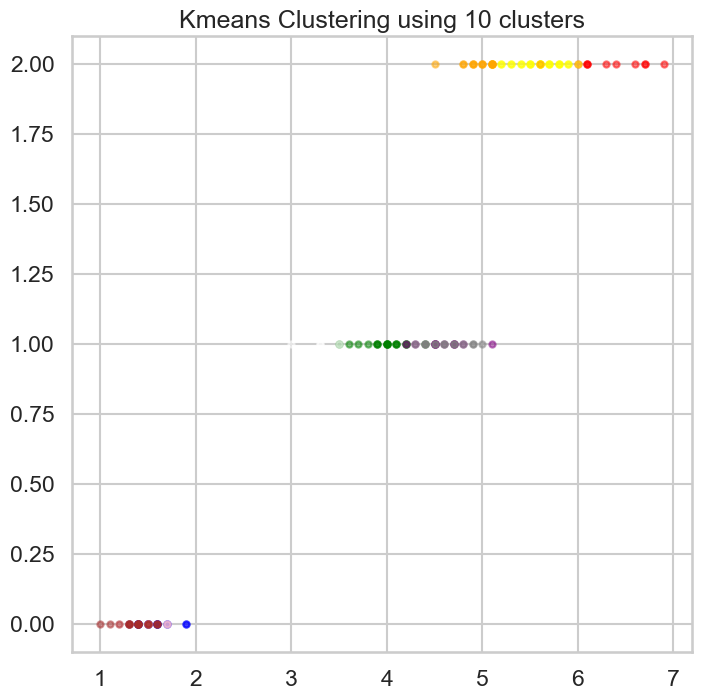

In [13]:
Kmeans_output = []

for i in range(10):
    km = kmeans(df_iris, i+1)
    
    print(km)

    plt.figure()
    plt.title(f'Kmeans Clustering using {i+1} clusters')
    display_cluster(df_iris[['petal length (cm)', 'target']].to_numpy(copy=True), km, i+1)
    
    Kmeans_output.append(km)

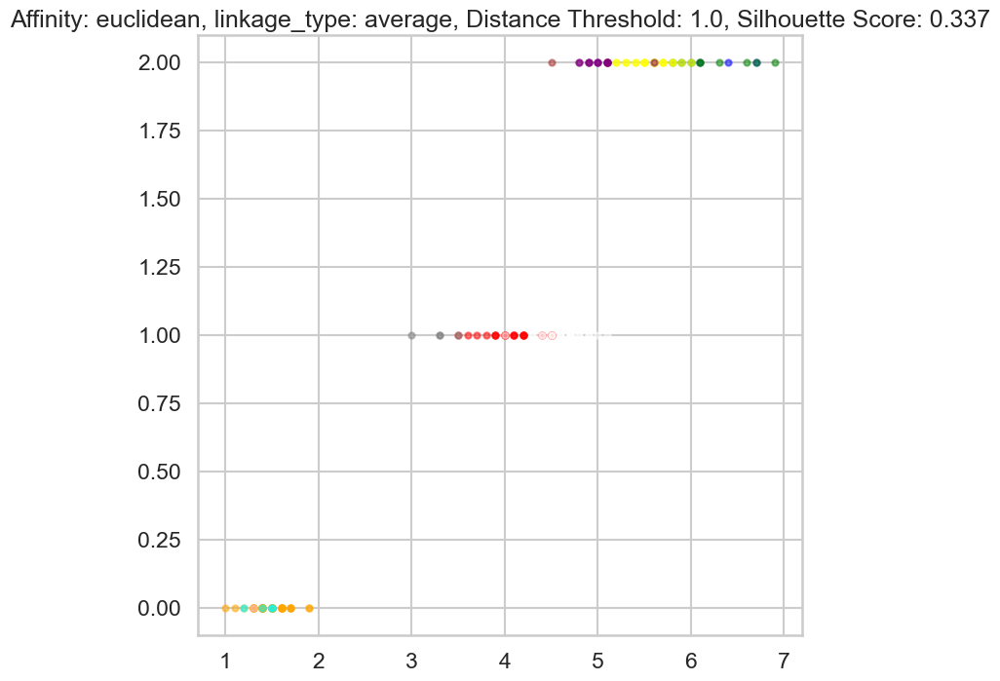

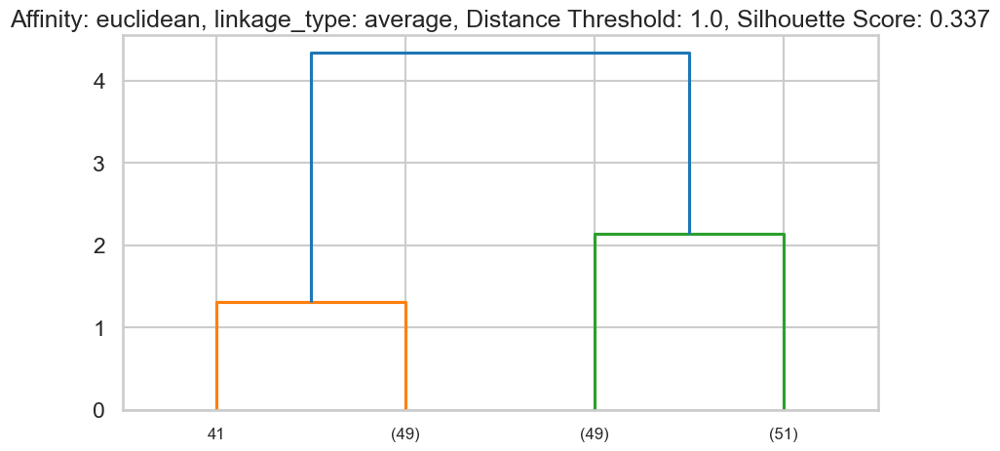

Affinity: euclidean, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.337
[ 5  5  5  5  5  5  5  5  5  5  5  5  5  5 10 10  5  5  5  5  5  5  5  5
  5  5  5  5  5  5  5  5 10 10  5  5  5  5  5  5  5  6  5  5  5  5  5  5
  5  5  8  8  8  0  8  0  8  9  8  0  9  0  0  8  0  8  0  0  0  0  8  8
  8  8  8  8  8  8  8  0  0  0  0  8  0  8  8  0  0  0  0  8  0  9  0  0
  0  8  9  0  3  4  2  3  3  2  7  2  3  1  3  3  3  4  4  3  3  1  2  4
  3  4  2  4  3  2  4  4  3  2  2  1  3  4  4  2  3  3  4  3  3  3  4  3
  3  3  4  3  3  4]


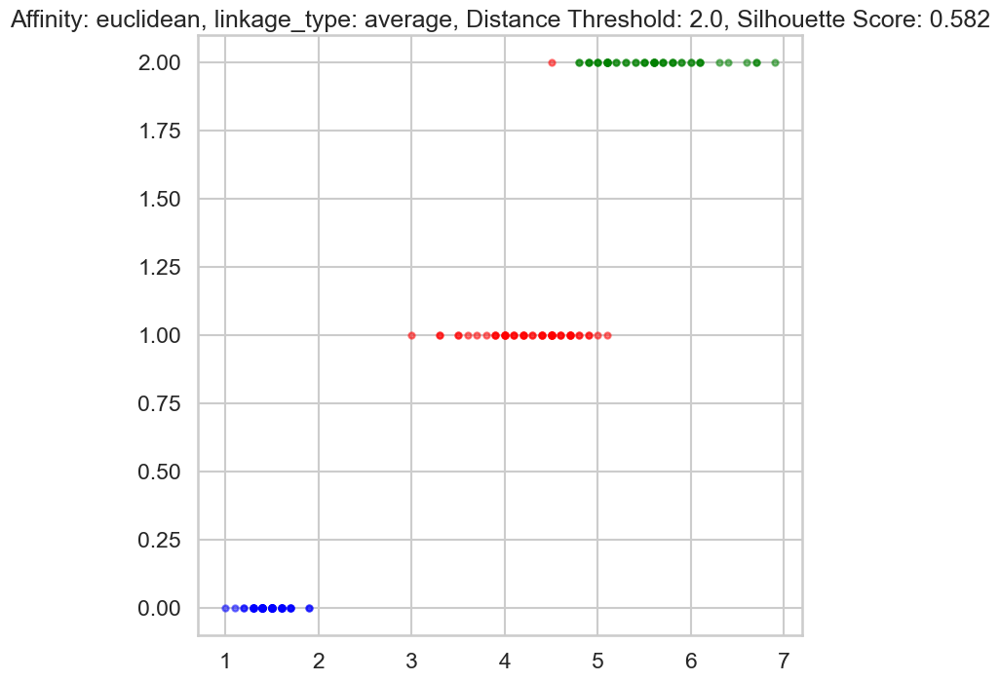

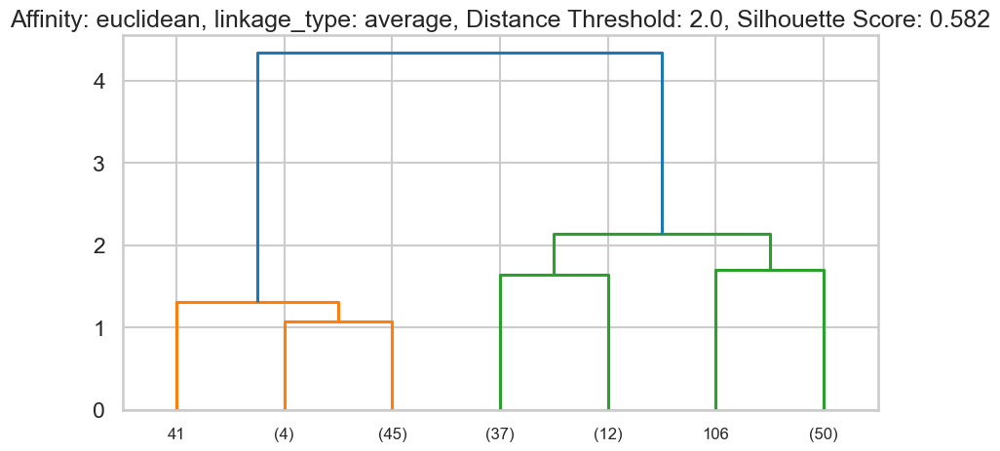

Affinity: euclidean, linkage_type: average, Distance Threshold: 2.0, Silhouette Score: 0.582
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 0 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


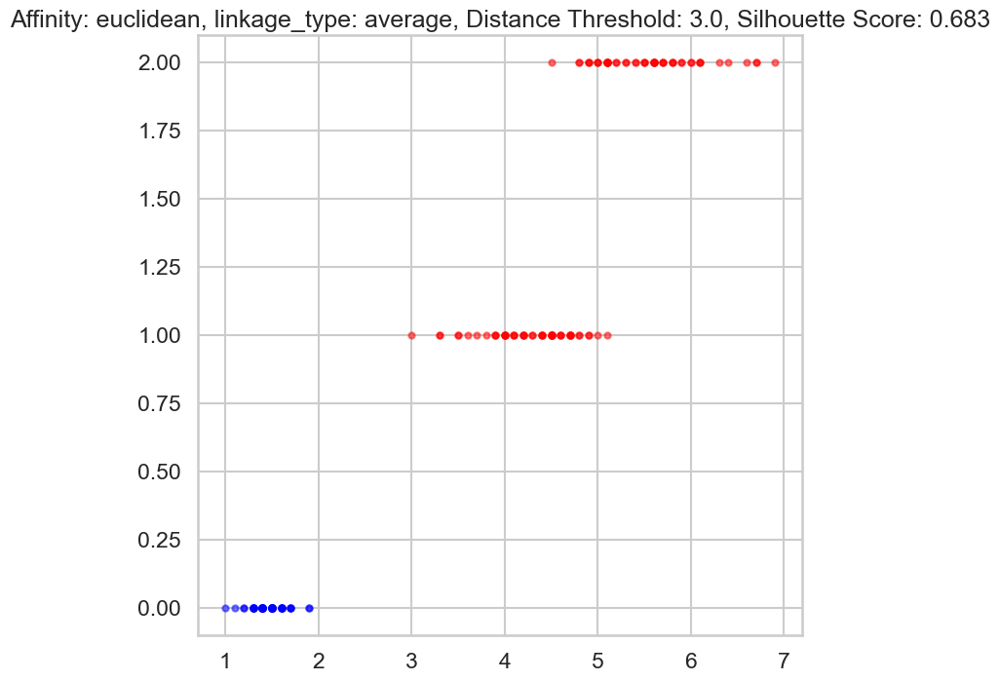

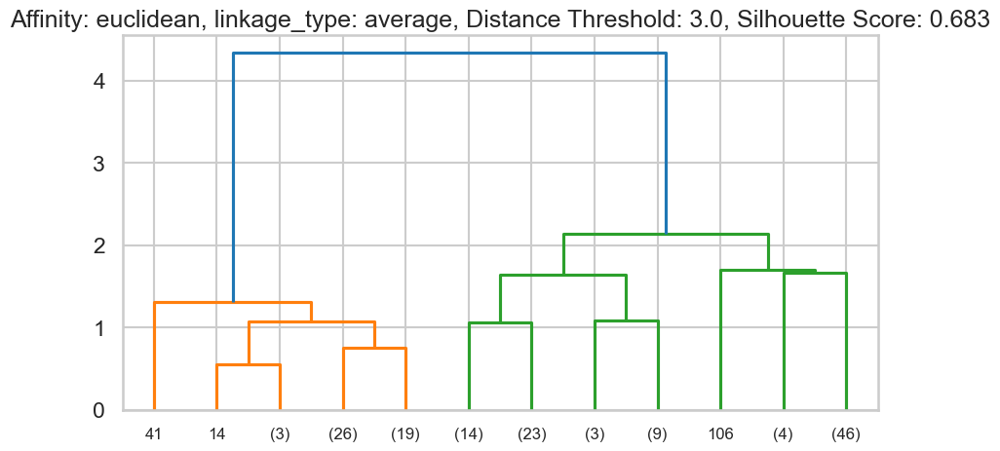

Affinity: euclidean, linkage_type: average, Distance Threshold: 3.0, Silhouette Score: 0.683
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


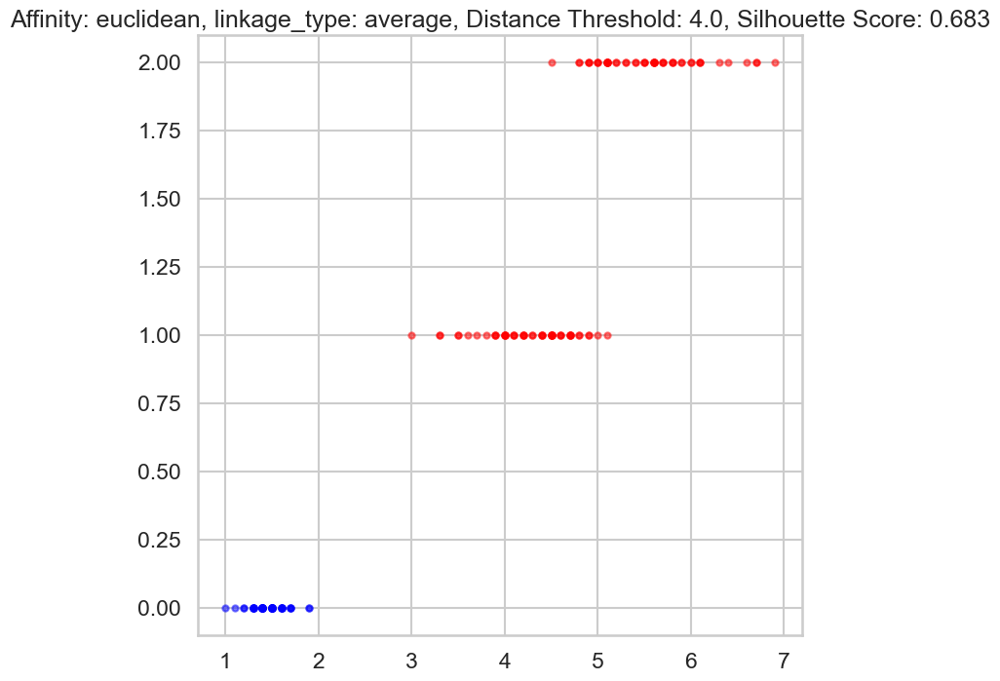

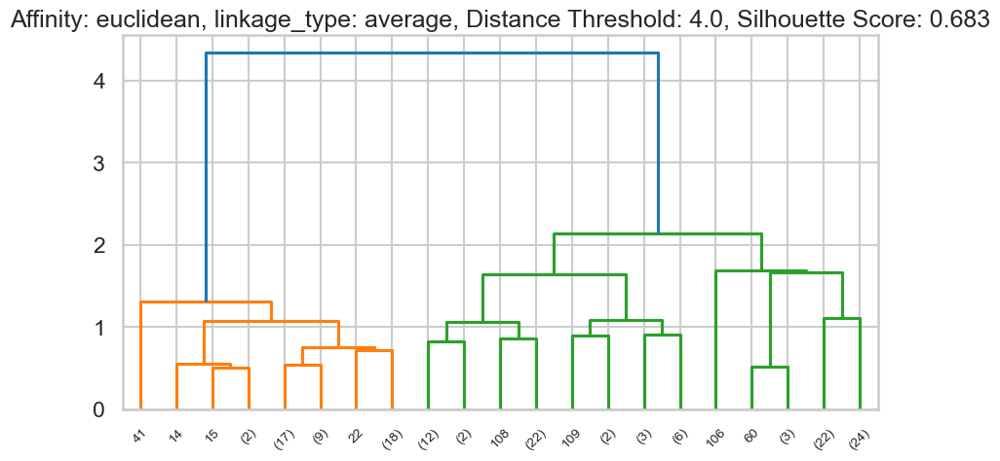

Affinity: euclidean, linkage_type: average, Distance Threshold: 4.0, Silhouette Score: 0.683
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


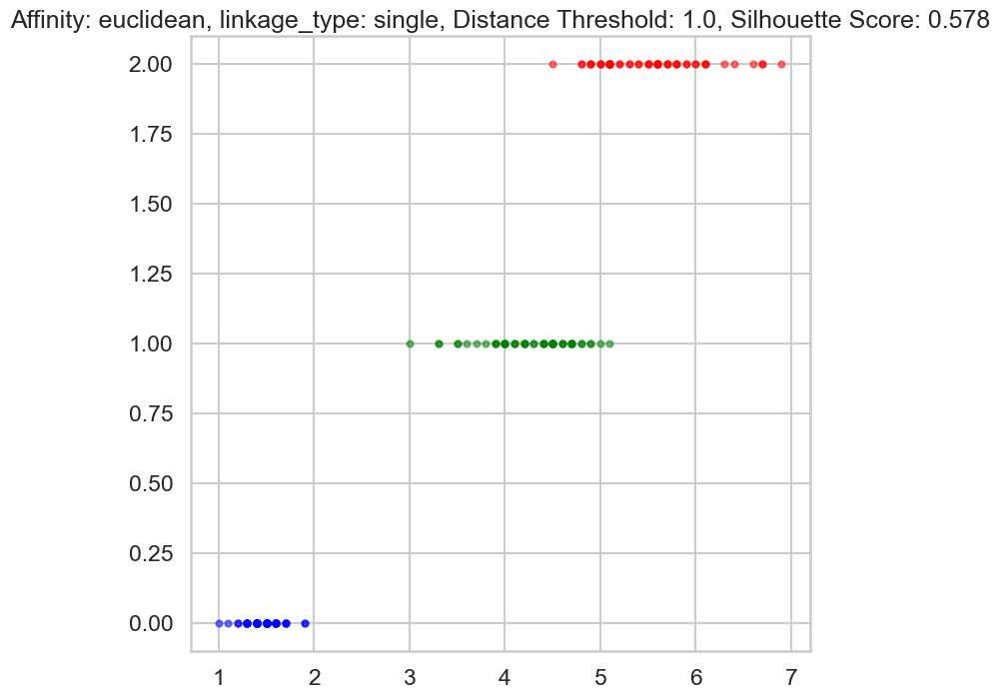

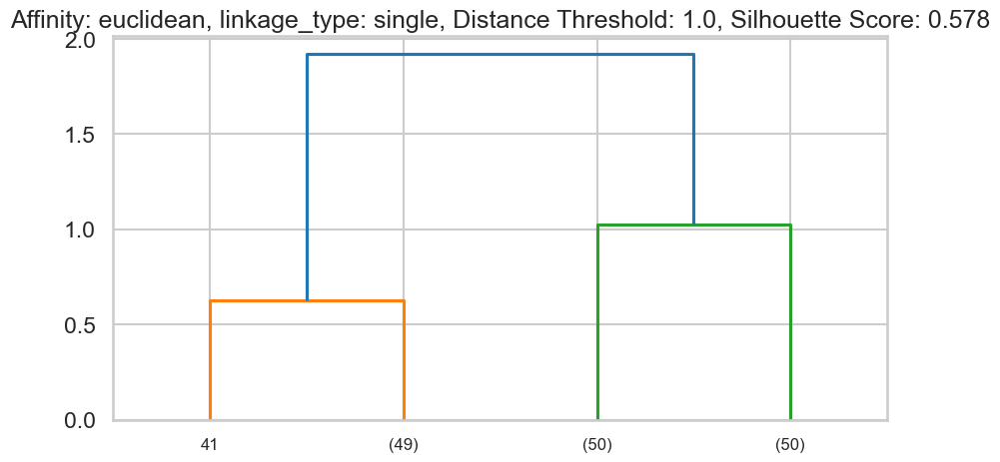

Affinity: euclidean, linkage_type: single, Distance Threshold: 1.0, Silhouette Score: 0.578
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


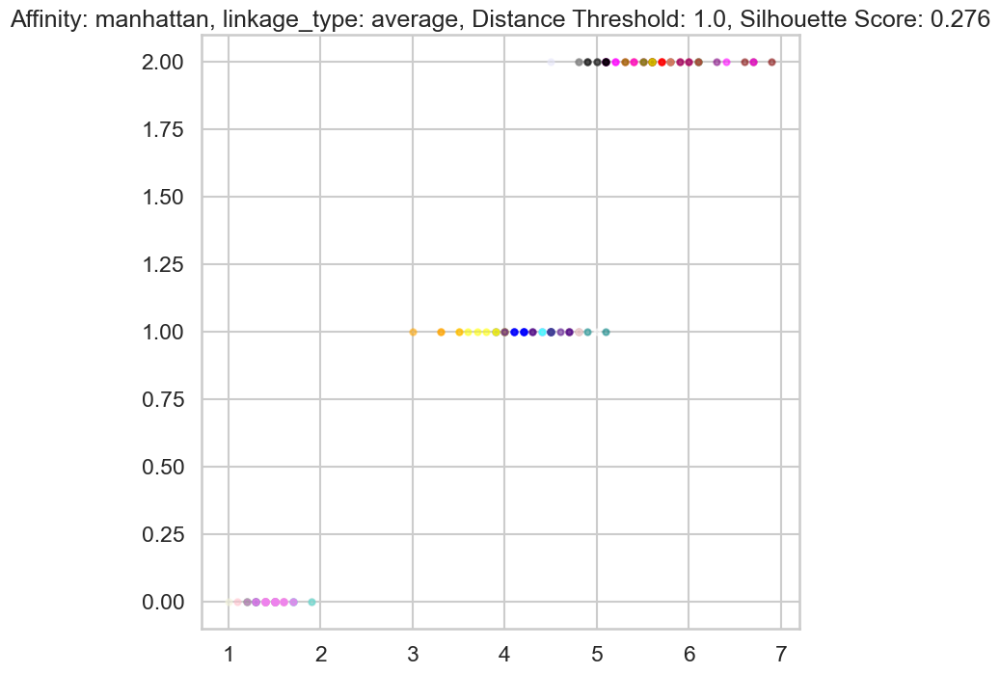

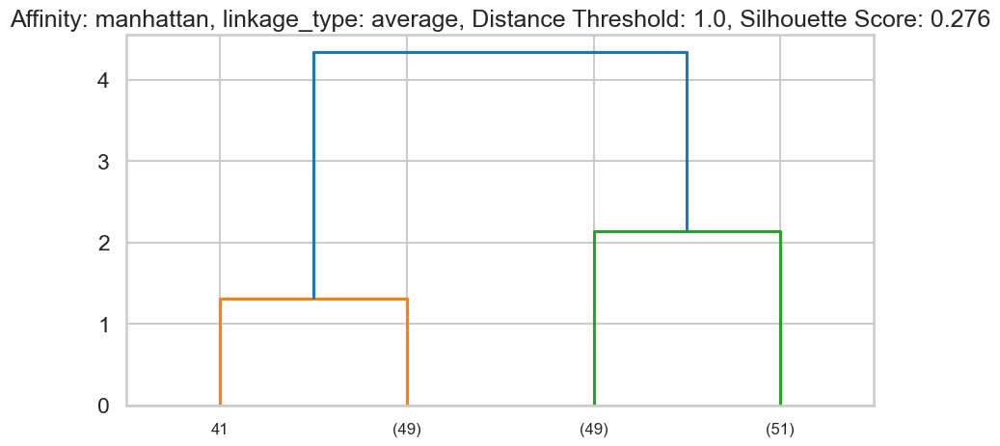

Affinity: manhattan, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.276
[25  6  6  6 25 12  6 25  6  6 25  6  6  6  2  2 12 25 12 25 25 25 23 25
  6  6 25 25 25  6  6 25  2  2  6 25 25 25  6 25 25 15  6 25 12  6 25  6
 25 25  8  7  8  3  8  1  7  5  8  3  5  1 22 24  3  8  1  1 10  3  7 24
 16 24 24  8  8  8 24  3  3  3  1 16  1  7  8 10  1  3  1 24  1  5  1  1
  1 24  5  1  0 28  4 13 13 14 17  4 18 21 11 13 11 28 28  0 13 27 14 20
  0 28 14  9  0  4  9  9 13  4  4 27 13  9 19 26  0 13  9 11  0 11 28  0
  0 11  9 11  0  9]


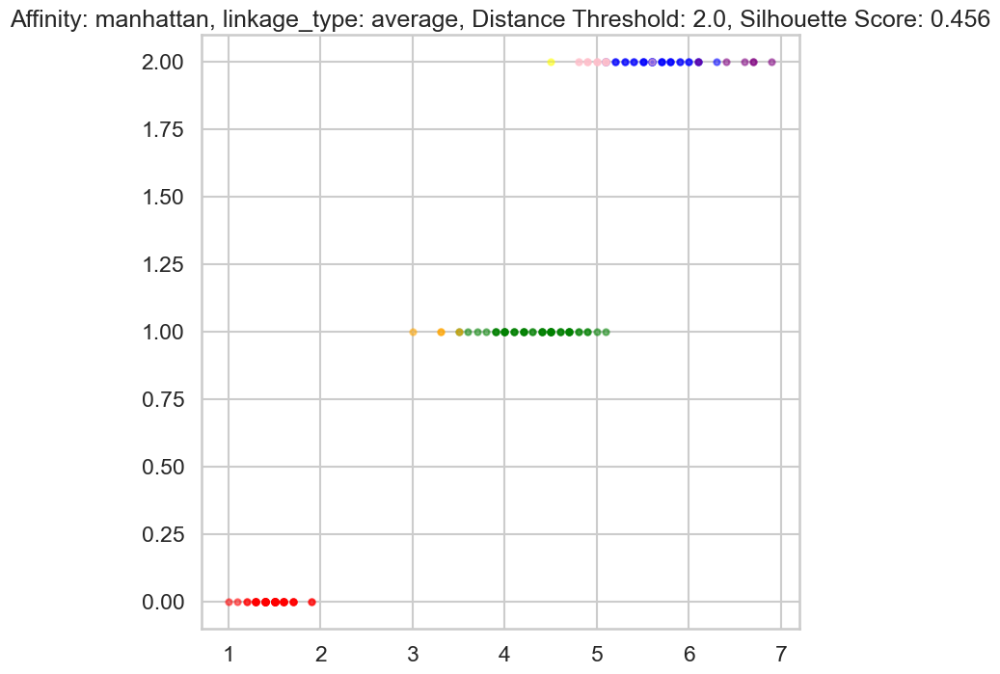

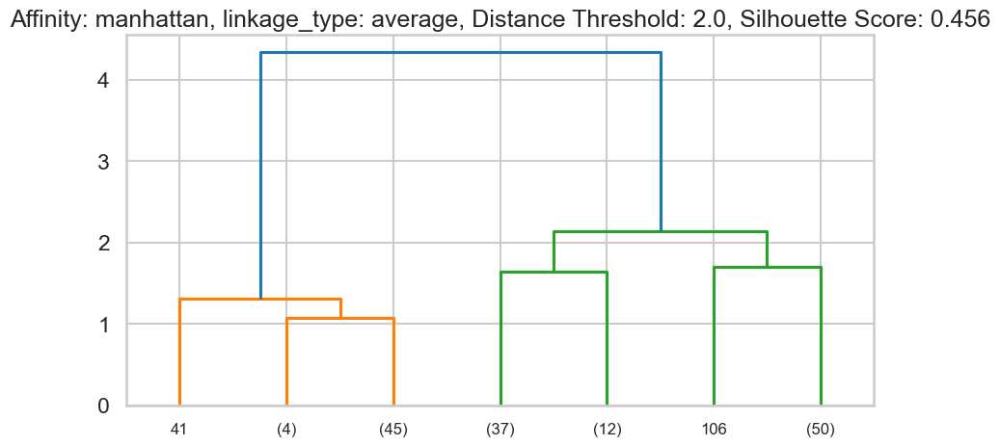

Affinity: manhattan, linkage_type: average, Distance Threshold: 2.0, Silhouette Score: 0.456
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 2 5 2 2 5 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 5 2 2 2 2 5 2 1 6 1 1 1 4 3 1 1 1 1
 1 1 6 6 1 1 4 4 6 1 6 4 6 1 1 6 6 1 1 1 4 1 6 6 4 1 1 6 1 1 1 6 1 1 1 6 1
 1 6]


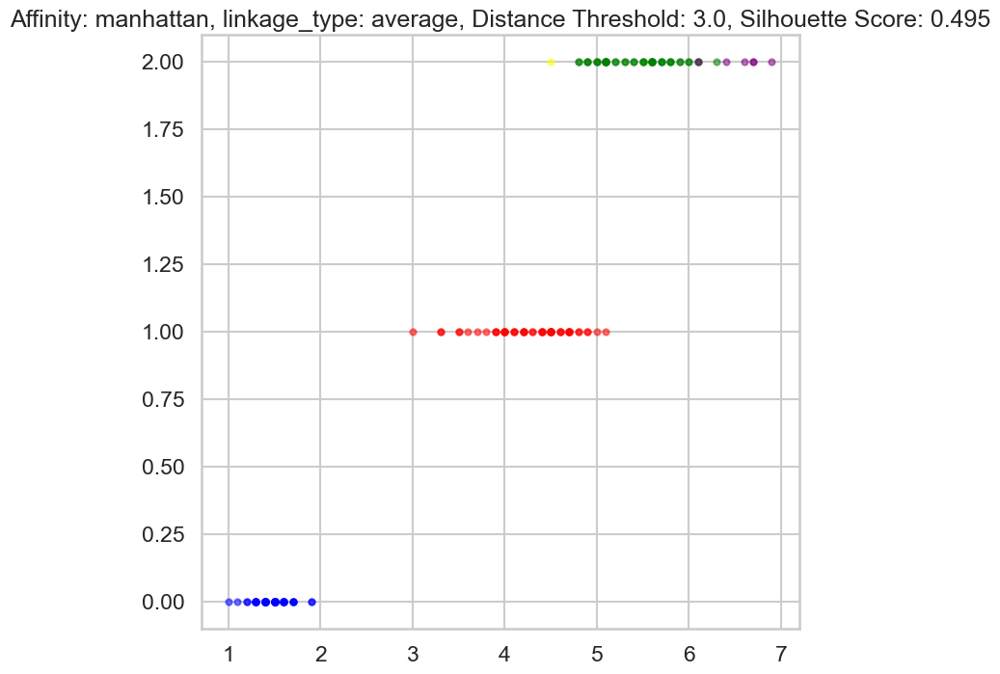

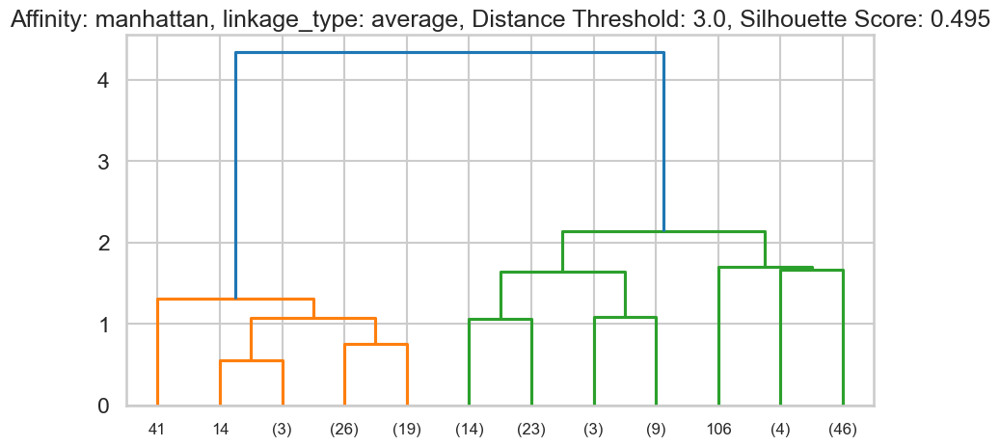

Affinity: manhattan, linkage_type: average, Distance Threshold: 3.0, Silhouette Score: 0.495
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 4 3 2 2 2 2
 2 2 2 2 2 2 4 4 2 2 2 4 2 2 2 2 2 2 2 2 4 2 2 2 4 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


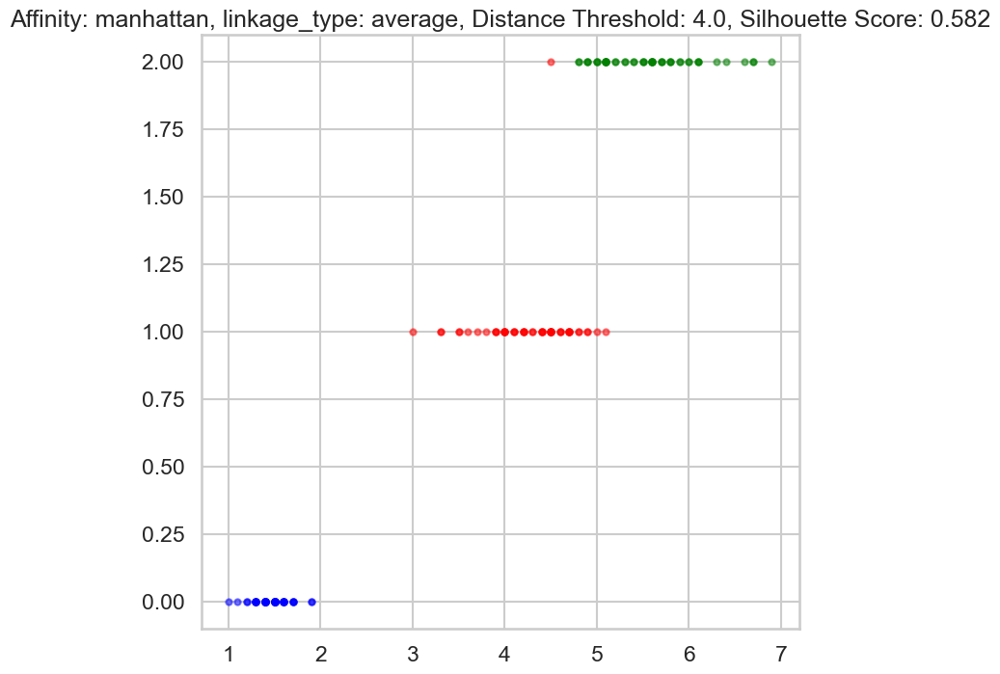

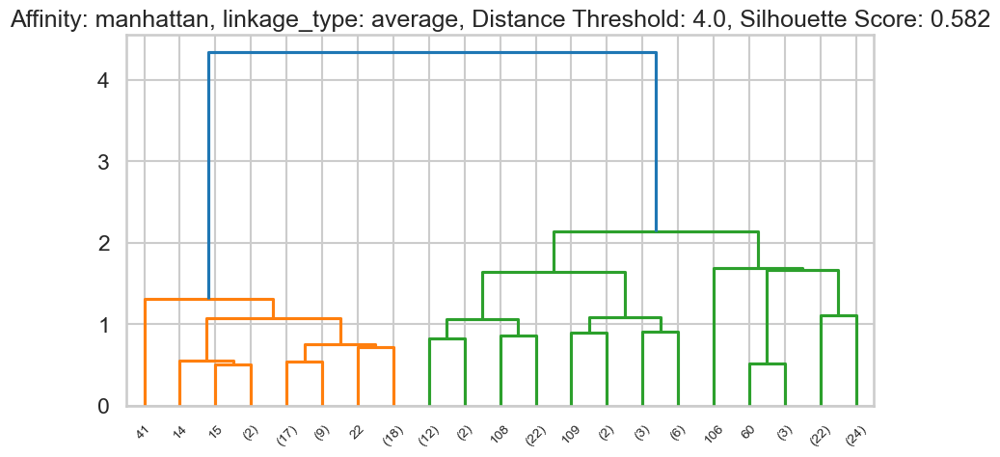

Affinity: manhattan, linkage_type: average, Distance Threshold: 4.0, Silhouette Score: 0.582
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 2 2 2 2 2 0 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


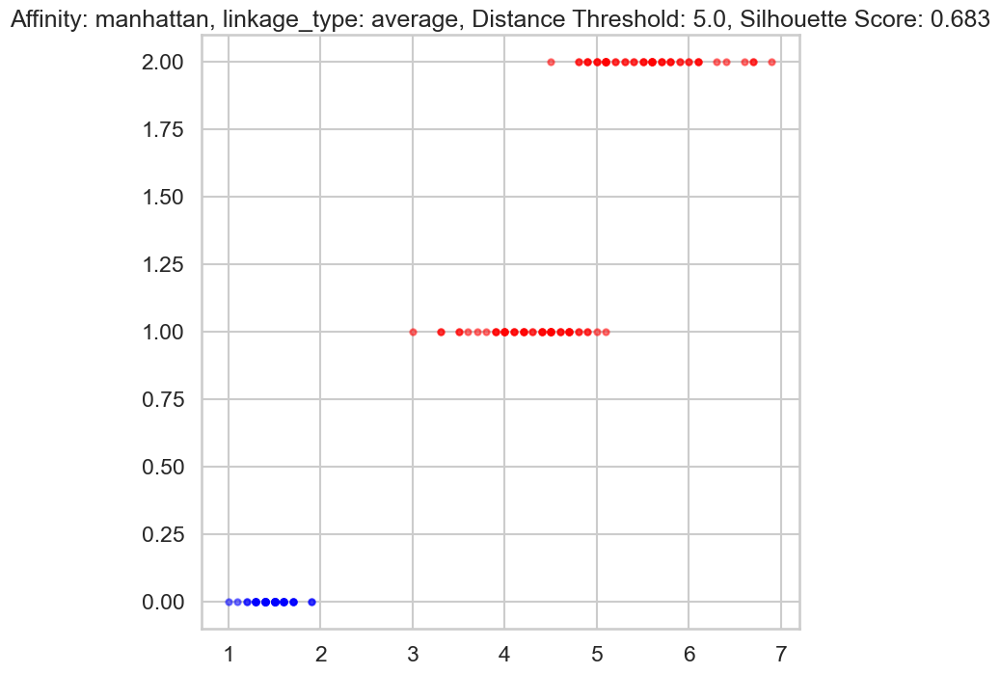

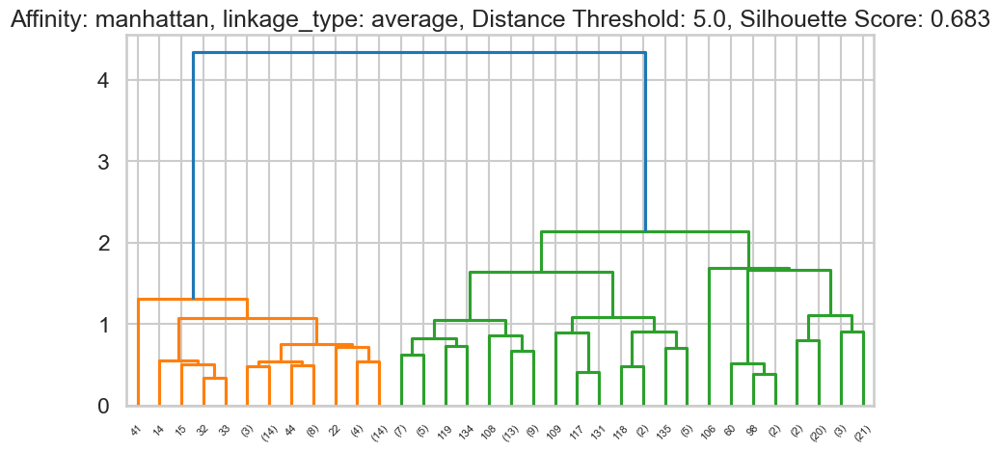

Affinity: manhattan, linkage_type: average, Distance Threshold: 5.0, Silhouette Score: 0.683
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


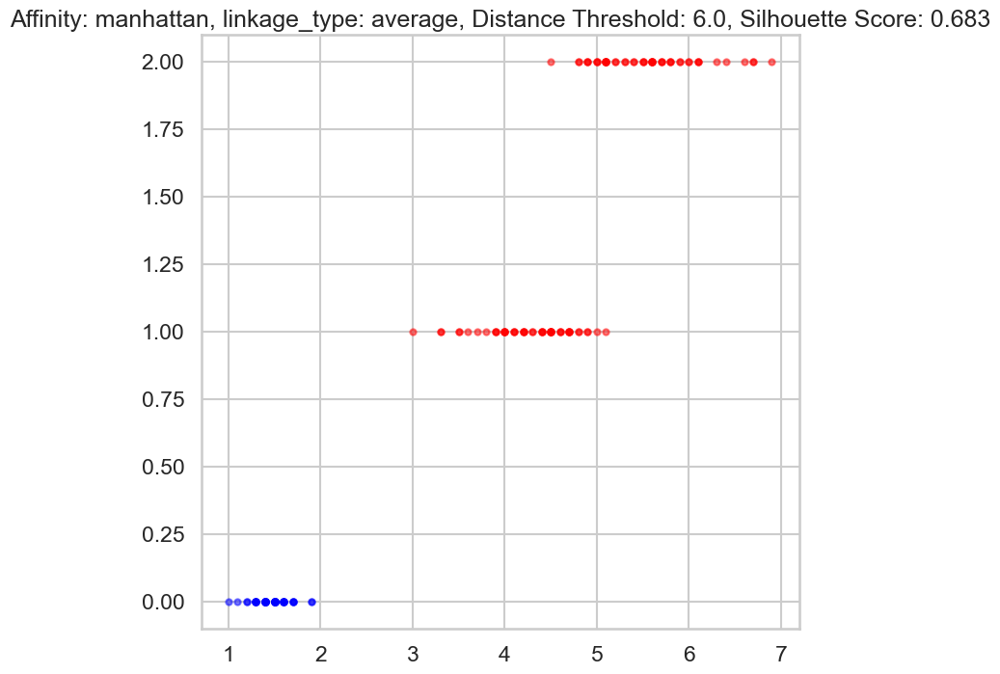

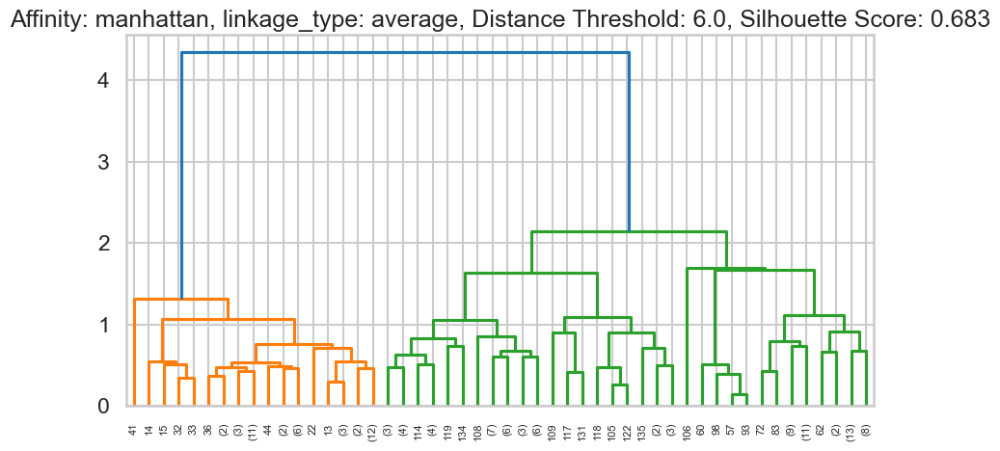

Affinity: manhattan, linkage_type: average, Distance Threshold: 6.0, Silhouette Score: 0.683
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


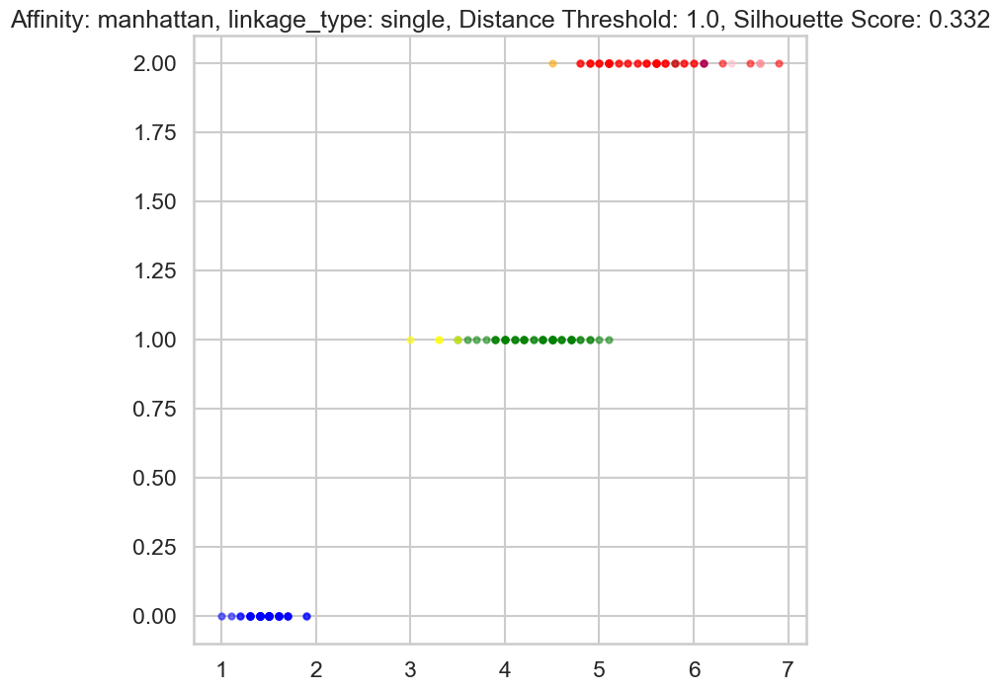

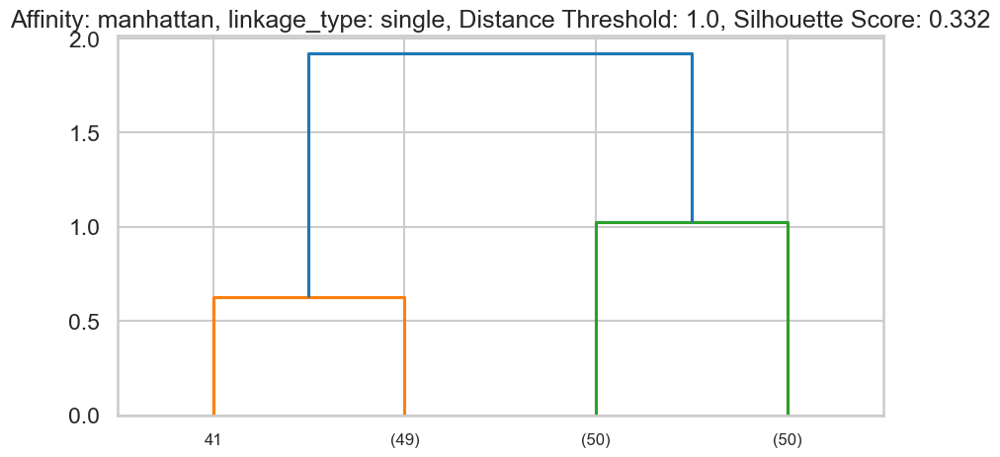

Affinity: manhattan, linkage_type: single, Distance Threshold: 1.0, Silhouette Score: 0.332
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 3 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 3 2 0 0 0 0 0 0 5 0 7 4 0
 0 0 0 0 0 0 6 0 0 0 0 0 0 0 0 0 0 0 0 0 6 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


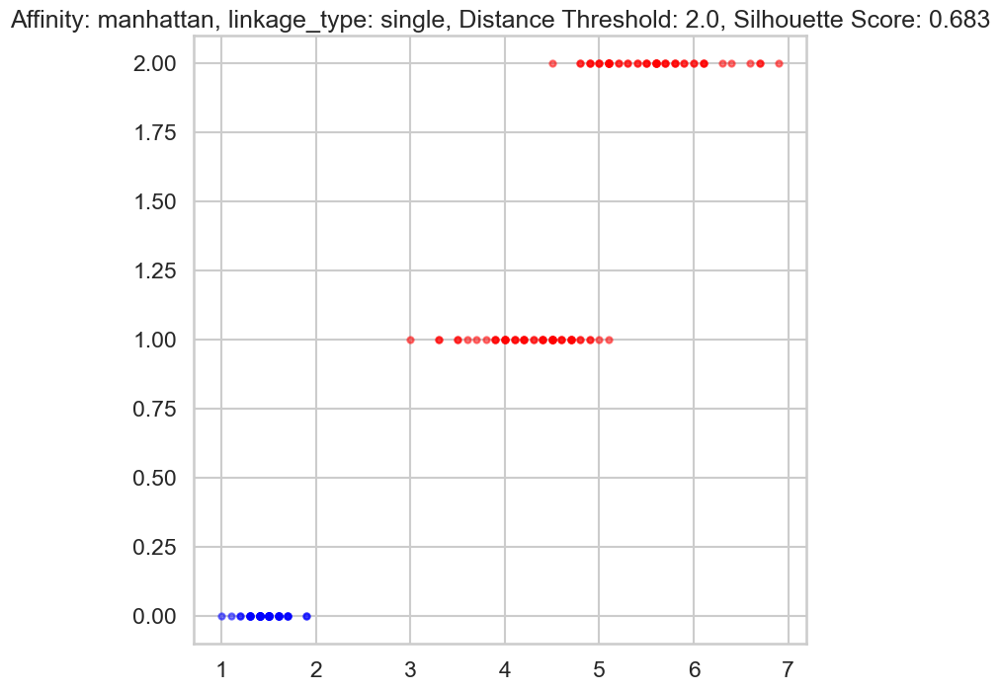

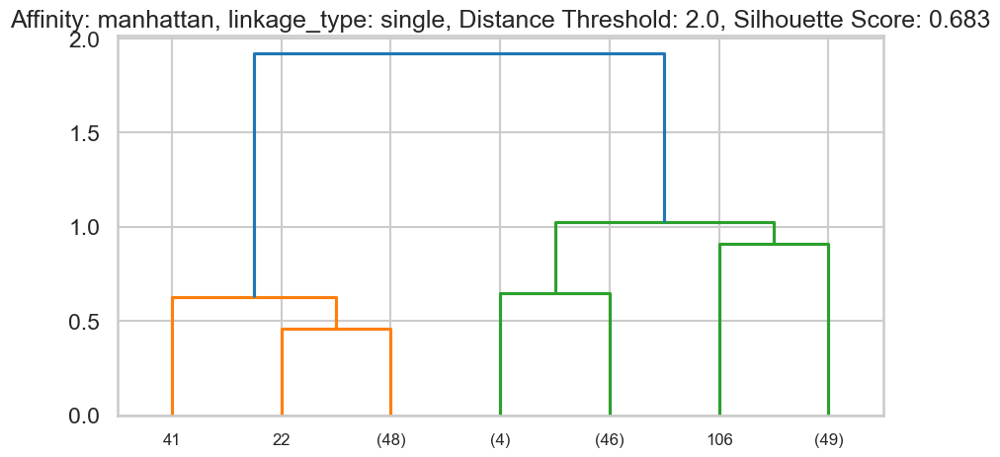

Affinity: manhattan, linkage_type: single, Distance Threshold: 2.0, Silhouette Score: 0.683
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


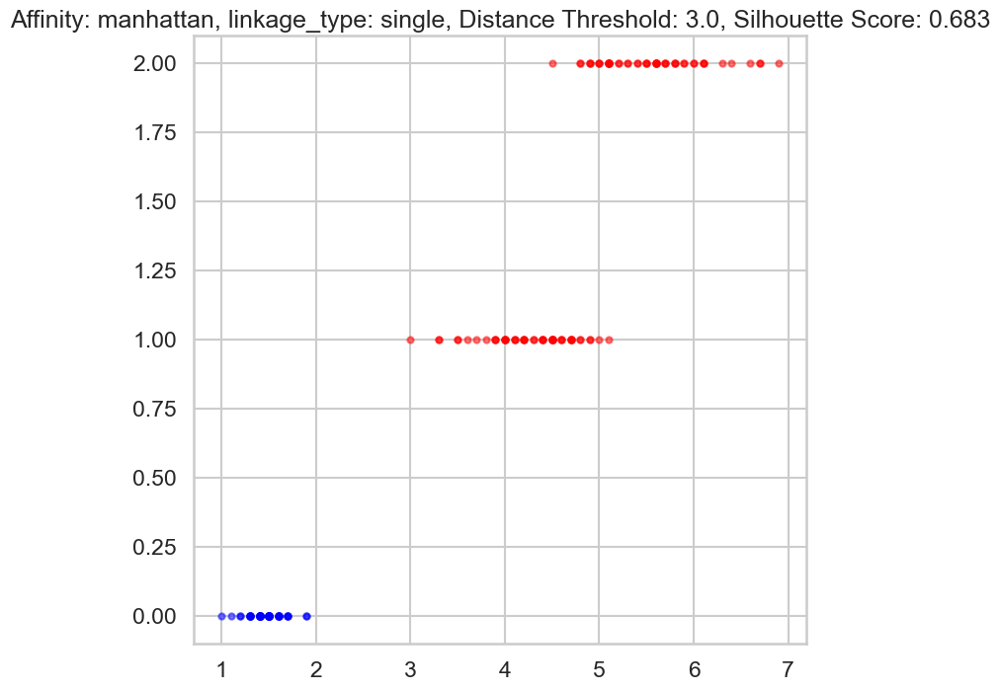

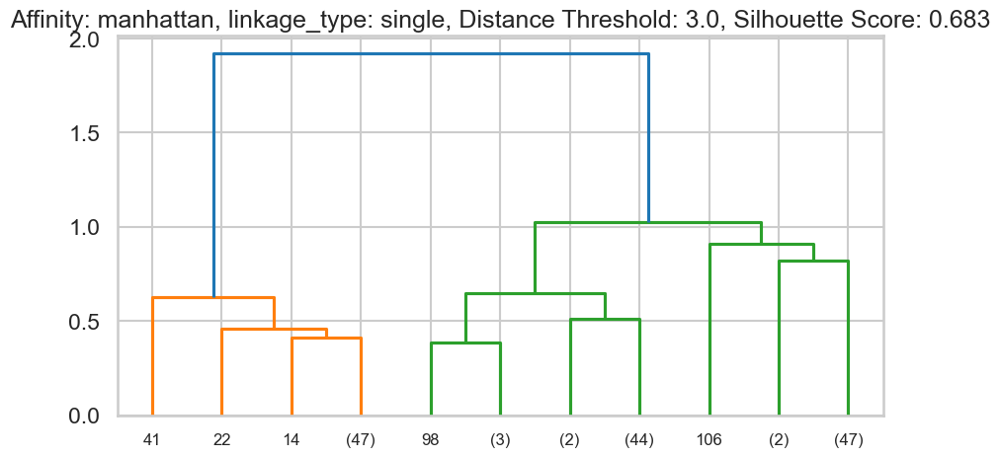

Affinity: manhattan, linkage_type: single, Distance Threshold: 3.0, Silhouette Score: 0.683
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 t

In [14]:
# Define parameters to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkage_types = ['average', 'single']
distance_thresholds = [1.0,2.0,3.0, 4.0,5.0,6.0]

# Store results
best_score = -1
best_params = None
all_scores = {}
        
# Try different parameters
for affinity in affinities:
    for linkage_type in linkage_types:
        for distance_threshold in distance_thresholds:
            try:
                # Perform hierarchical clustering
                X = agg_clus(df_iris, affinity=affinity, linkage_type=linkage_type, distance_threshold=distance_threshold)


                # Compute silhouette score
                score = silhouette_score(df_iris, X.labels_)

                # Store results
                params = (affinity, linkage_type, distance_threshold)
                all_scores[params] = score

                # Plot clusters
                plt.title(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                display_cluster(df_iris[['petal length (cm)', 'target']].to_numpy(copy=True), X, len(np.unique(X.labels_)) )            

                # Plot dendrogram
                fig, ax = plt.subplots(figsize=(10, 5))
                n = linkage(df_iris,method=linkage_type)
                dendrogram(n, truncate_mode='level', p=distance_threshold)
                plt.title(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                plt.show()

                # Print resulting clusters
                print(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                print(X.labels_)

                # Update best score
                if score > best_score:
                    best_score = score
                    best_params = params
            except Exception as e:
                print(f"An error occurred: {e}")
                continue

# Print best parameters and score
print(f'Best Parameters: {best_params}, Silhouette Score: {best_score:.3f}')

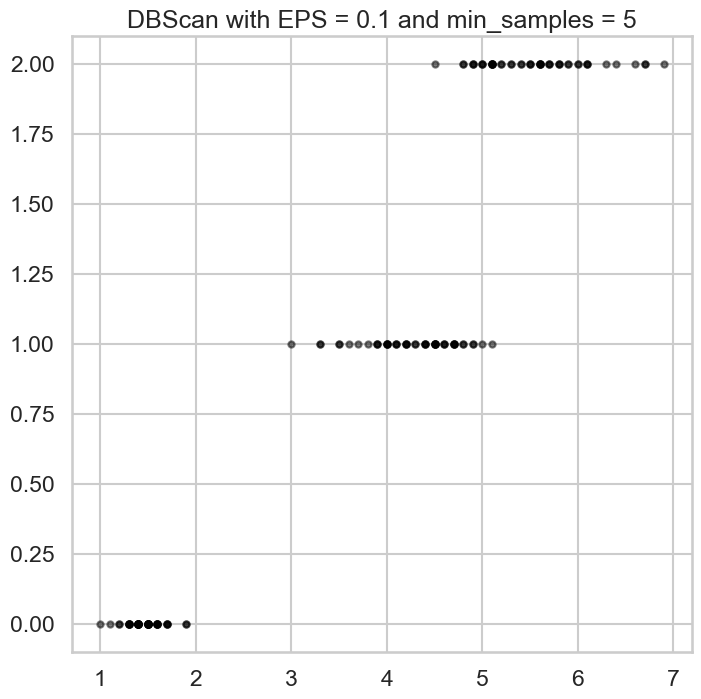

EPS: 0.1, Min Samples: 5, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


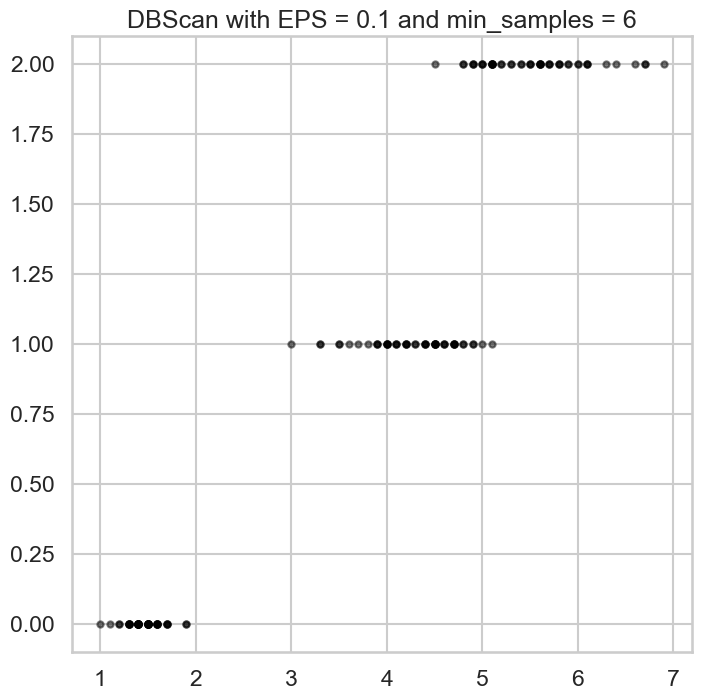

EPS: 0.1, Min Samples: 6, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


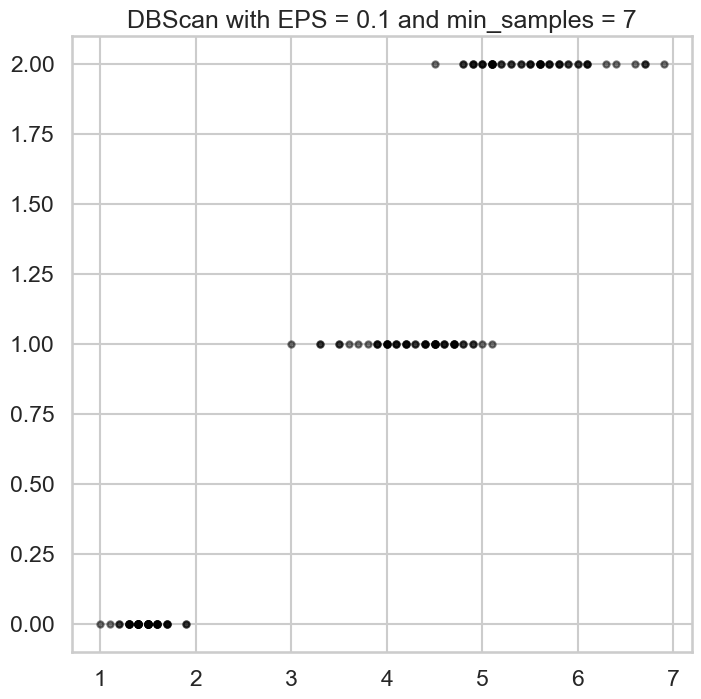

EPS: 0.1, Min Samples: 7, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


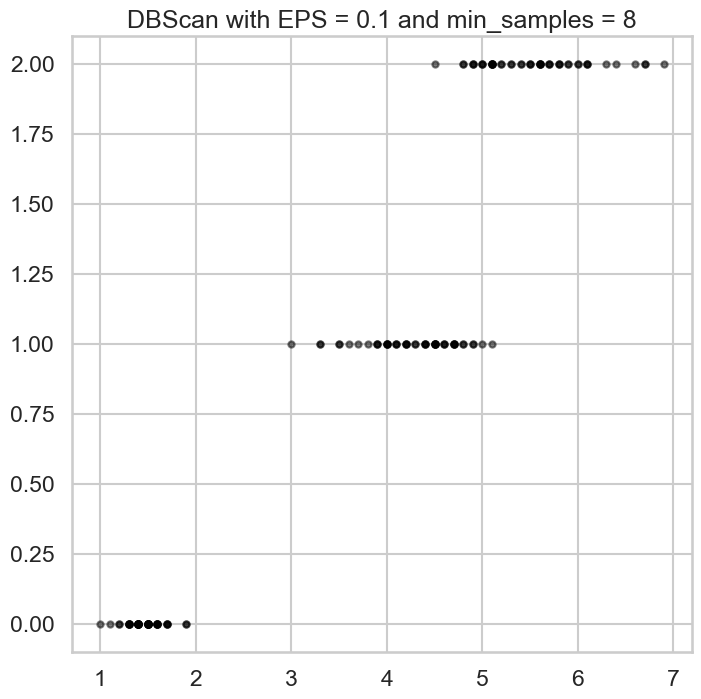

EPS: 0.1, Min Samples: 8, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


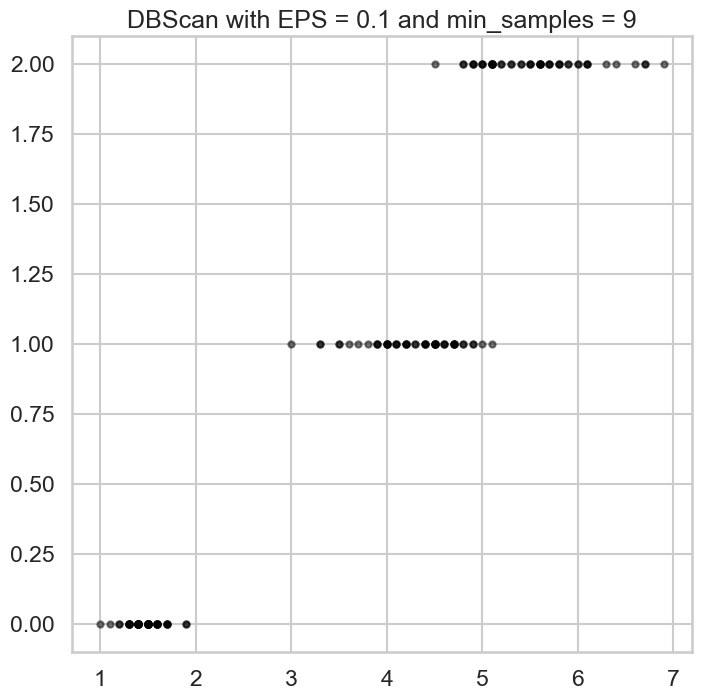

EPS: 0.1, Min Samples: 9, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


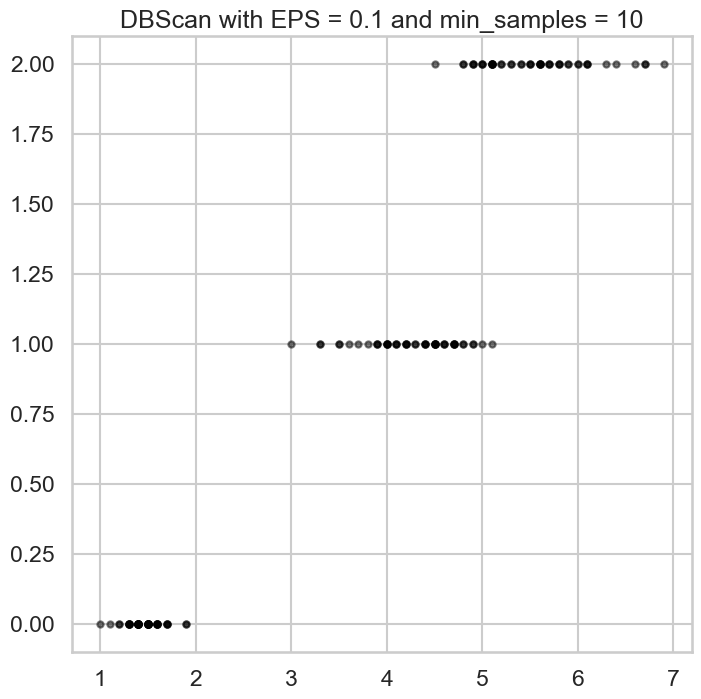

EPS: 0.1, Min Samples: 10, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


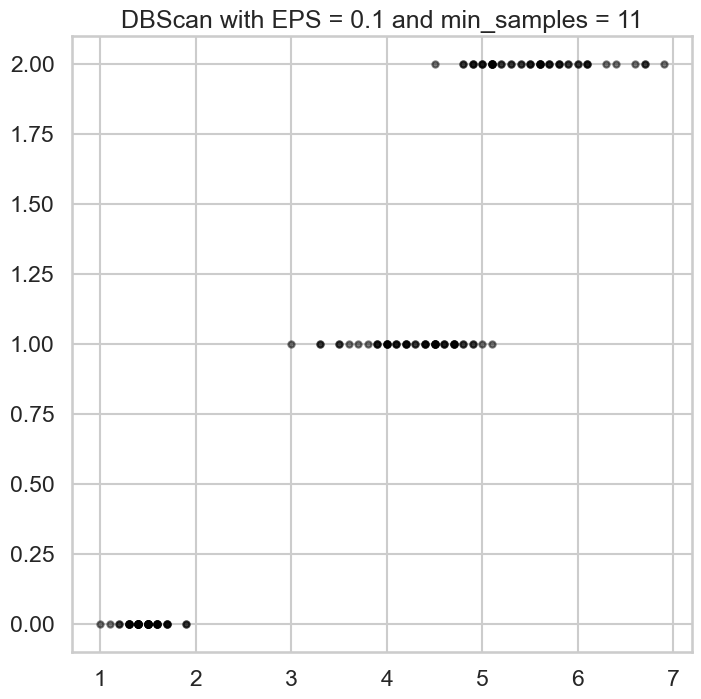

EPS: 0.1, Min Samples: 11, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


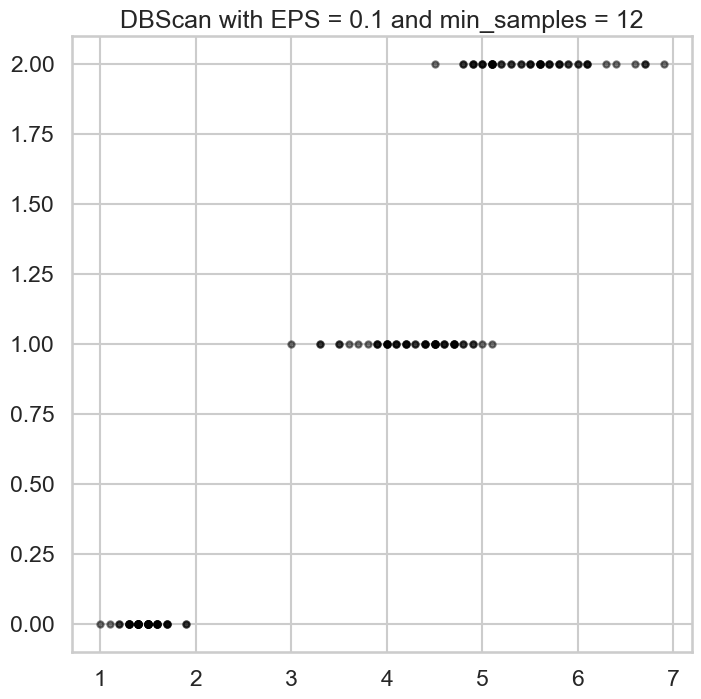

EPS: 0.1, Min Samples: 12, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


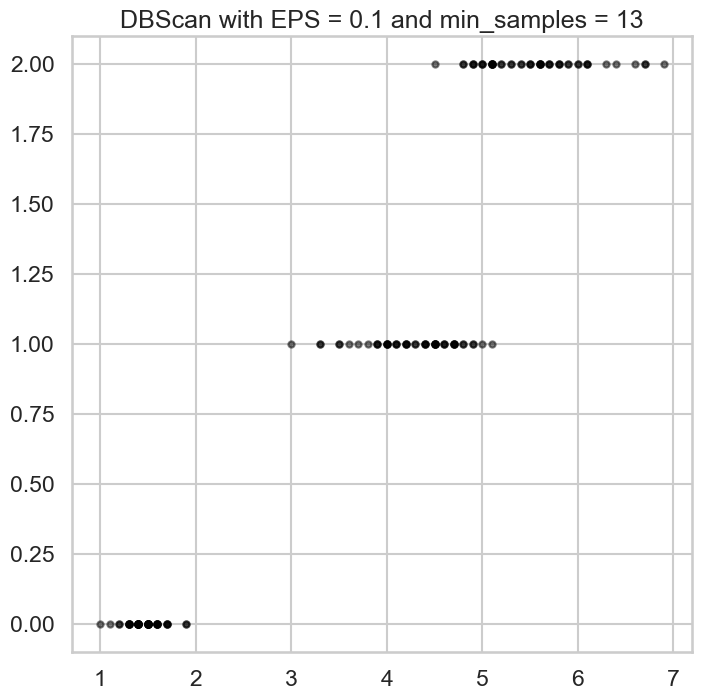

EPS: 0.1, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


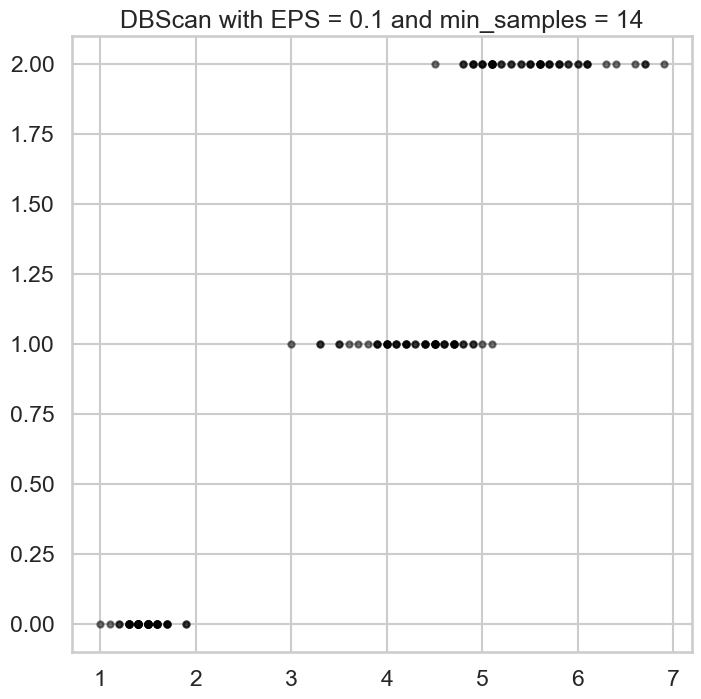

EPS: 0.1, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


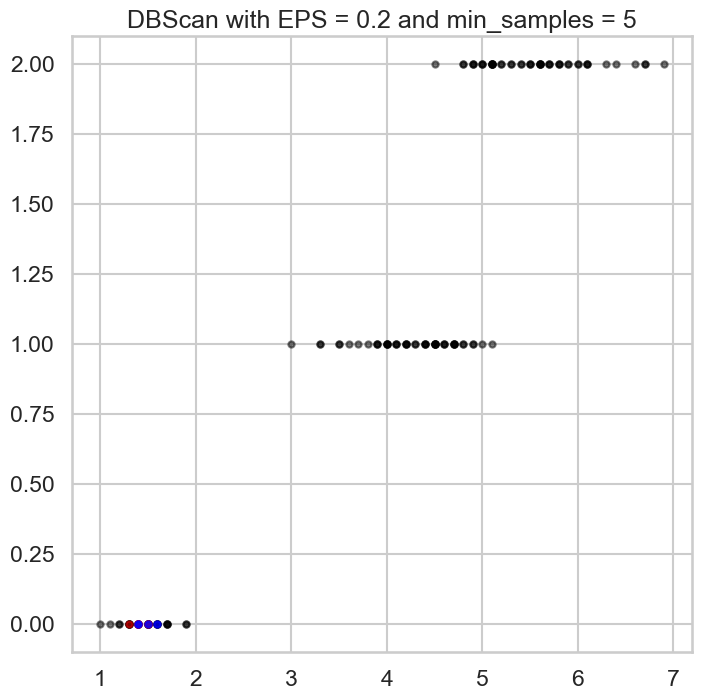

EPS: 0.2, Min Samples: 5, Silhouette Score: 0.175
[ 0  1 -1 -1  0 -1 -1  0 -1  1 -1 -1  1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1
 -1  1 -1  0  0 -1  1 -1 -1 -1  1 -1 -1  0 -1  0  0 -1 -1 -1 -1  1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


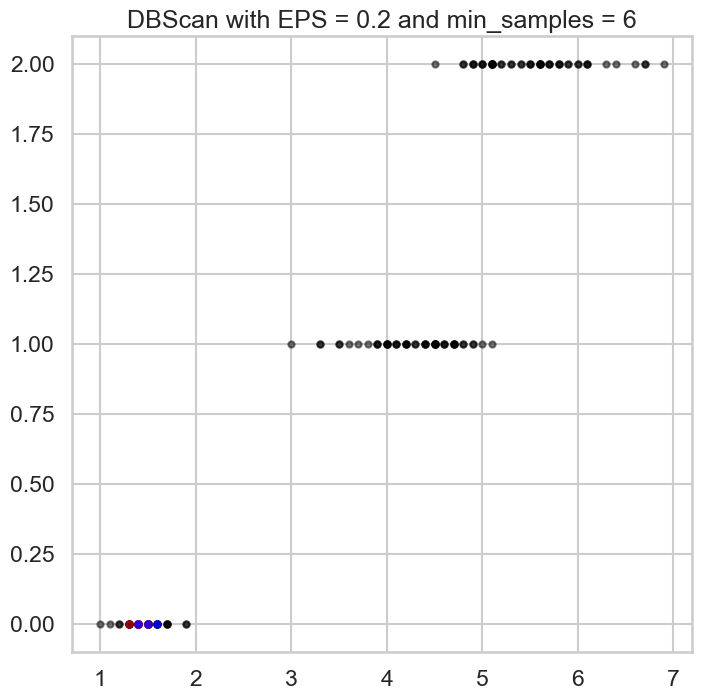

EPS: 0.2, Min Samples: 6, Silhouette Score: 0.151
[ 0  1 -1 -1  0 -1 -1  0 -1  1 -1 -1  1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1
 -1  1 -1  0  0 -1  1 -1 -1 -1  1 -1 -1 -1 -1  0  0 -1 -1 -1 -1 -1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


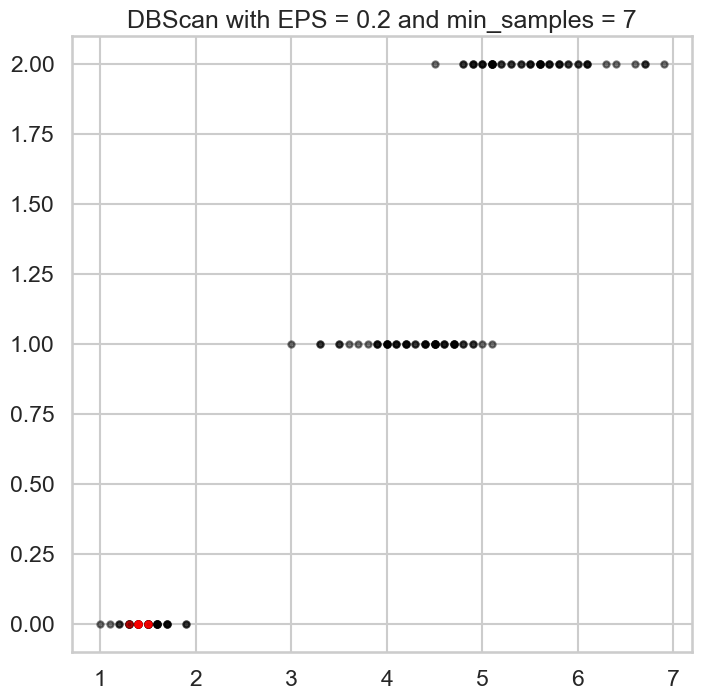

EPS: 0.2, Min Samples: 7, Silhouette Score: 0.114
[ 0 -1 -1 -1  0 -1 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1
 -1 -1 -1  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0 -1 -1 -1 -1 -1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


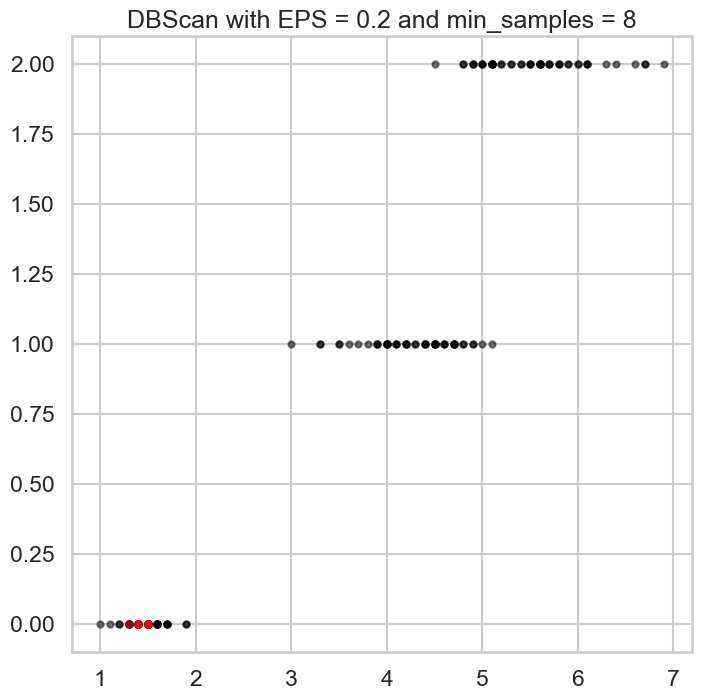

EPS: 0.2, Min Samples: 8, Silhouette Score: 0.100
[ 0 -1 -1 -1  0 -1 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1
 -1 -1 -1  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


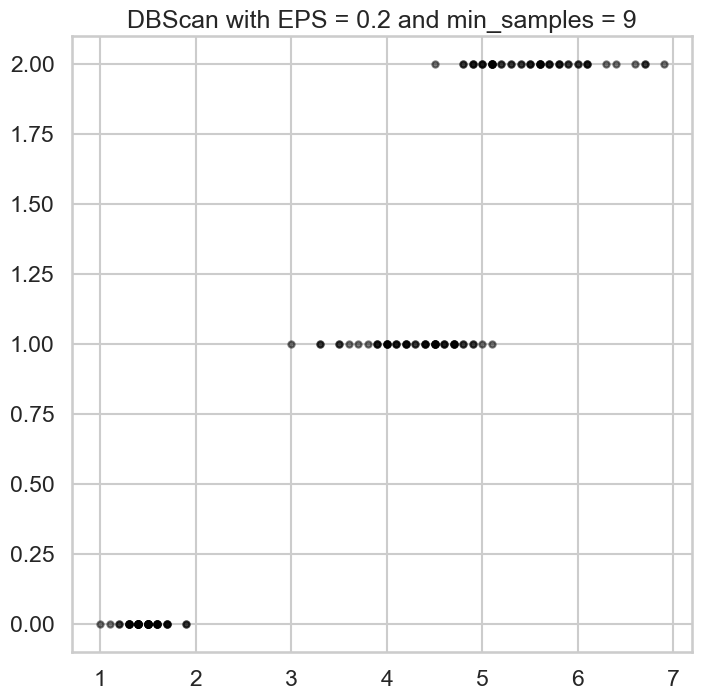

EPS: 0.2, Min Samples: 9, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


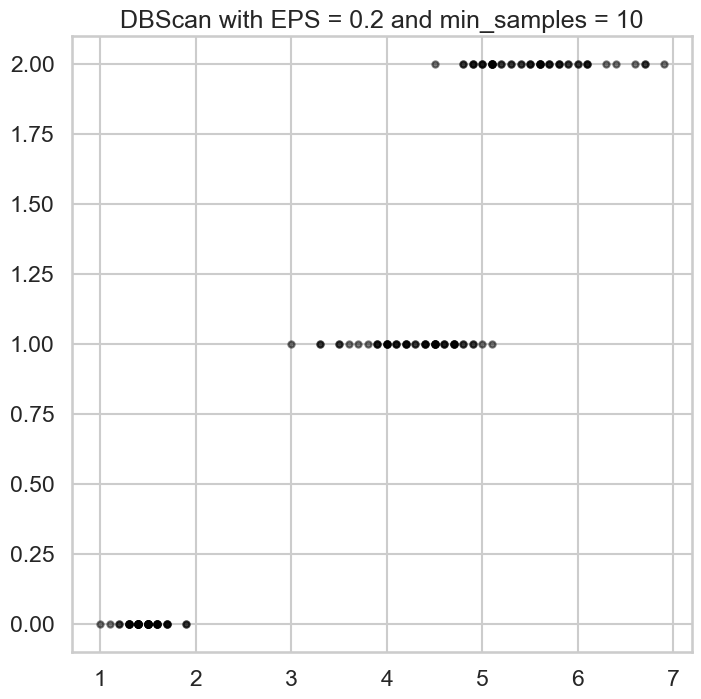

EPS: 0.2, Min Samples: 10, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


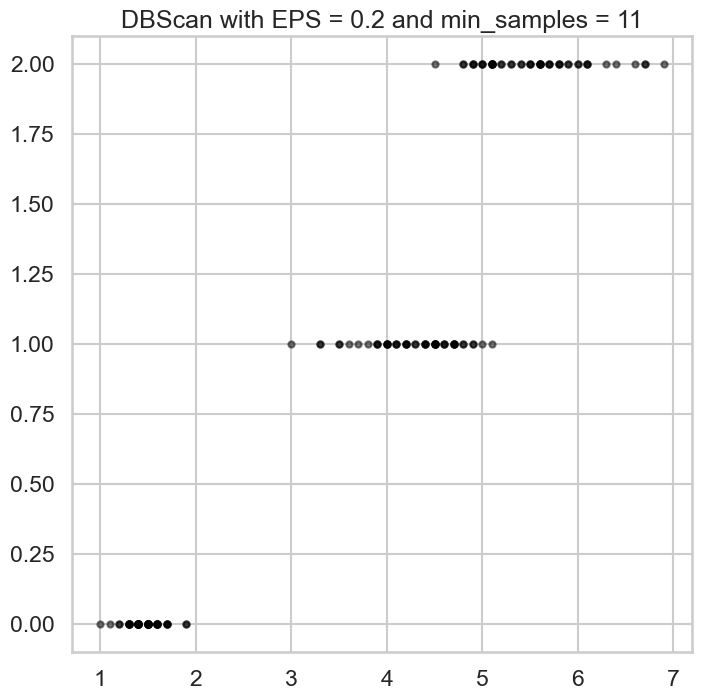

EPS: 0.2, Min Samples: 11, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


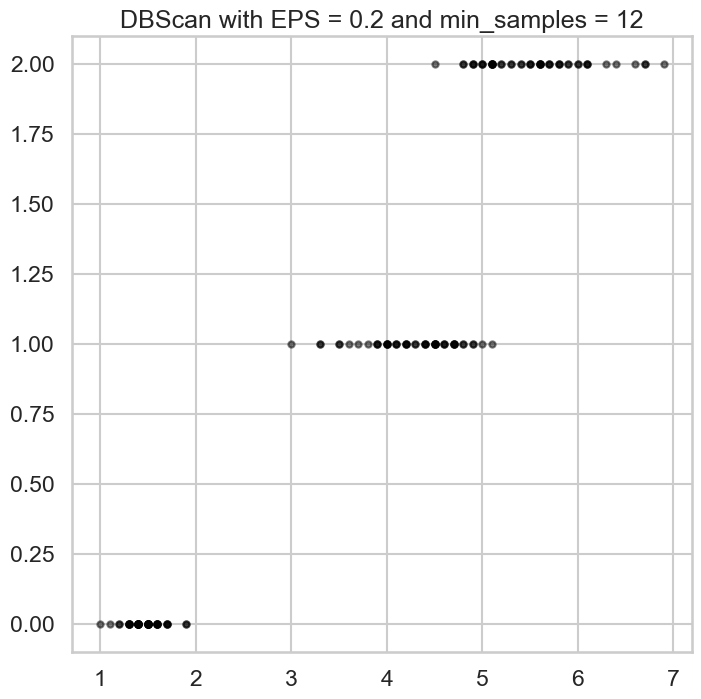

EPS: 0.2, Min Samples: 12, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


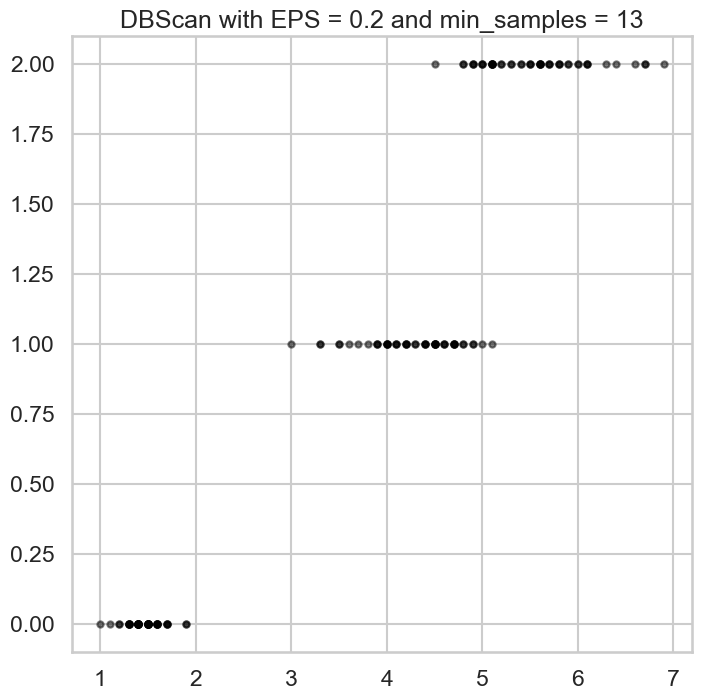

EPS: 0.2, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


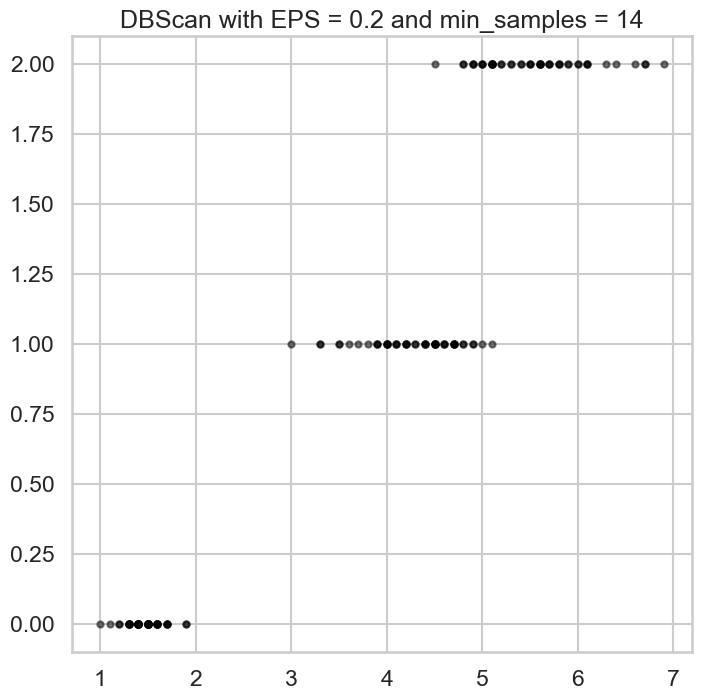

EPS: 0.2, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


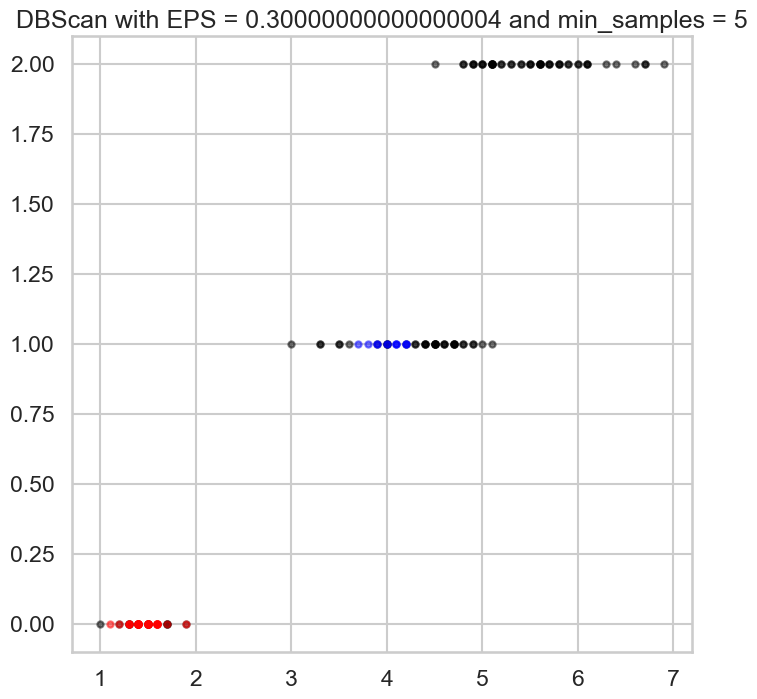

EPS: 0.30000000000000004, Min Samples: 5, Silhouette Score: 0.118
[ 0  0  0  0  0 -1  0  0  0  0  0  0  0  0 -1 -1 -1  0 -1  0 -1  0 -1  0
  0  0  0  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1 -1  1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1  1  1  1 -1 -1 -1 -1 -1  1  1 -1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


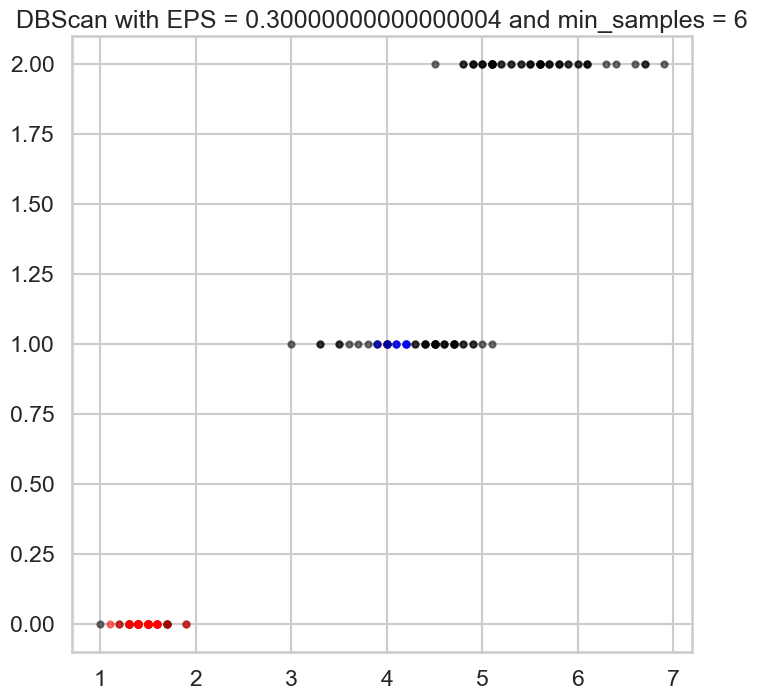

EPS: 0.30000000000000004, Min Samples: 6, Silhouette Score: 0.044
[ 0  0  0  0  0 -1  0  0  0  0  0  0  0  0 -1 -1 -1  0 -1  0 -1  0 -1  0
  0  0  0  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


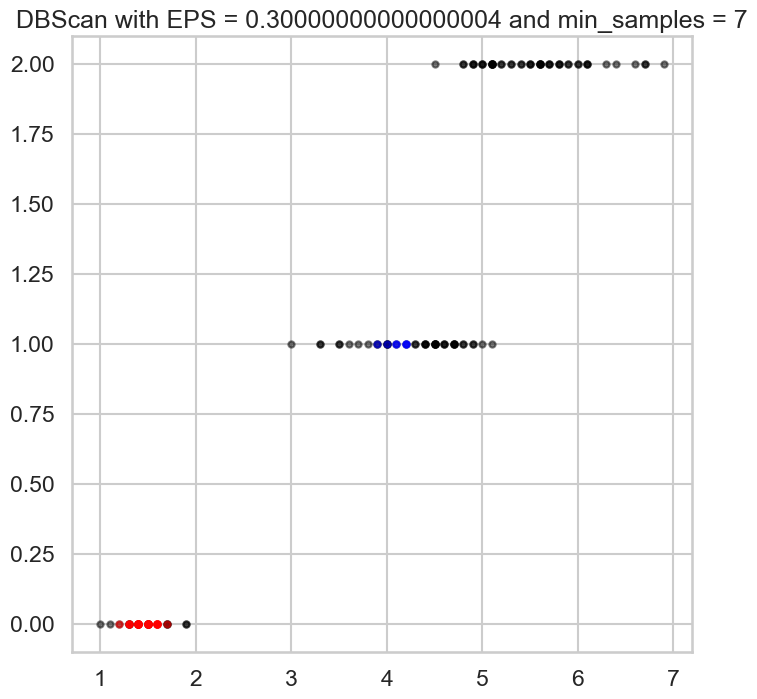

EPS: 0.30000000000000004, Min Samples: 7, Silhouette Score: 0.012
[ 0  0  0  0  0 -1  0  0  0  0  0  0  0 -1 -1 -1 -1  0 -1  0 -1  0 -1  0
 -1  0  0  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


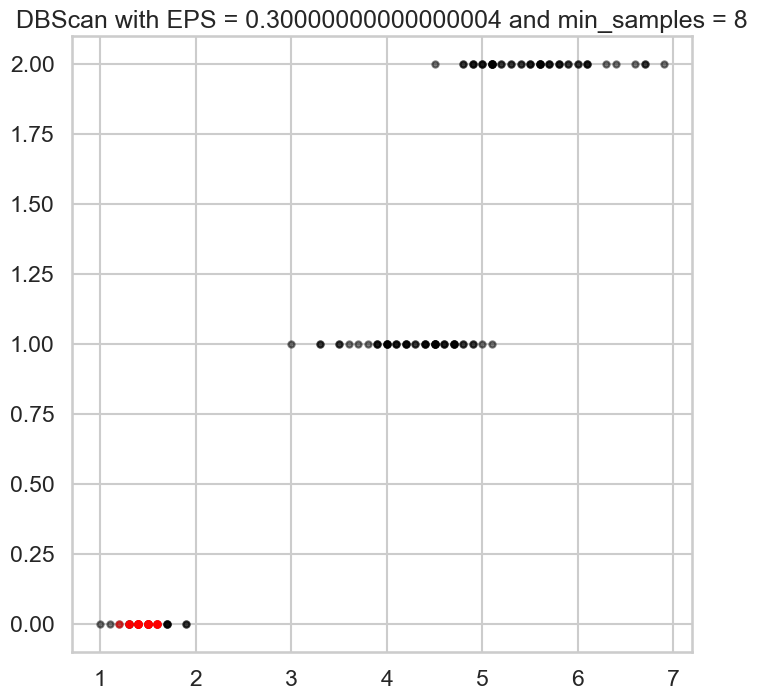

EPS: 0.30000000000000004, Min Samples: 8, Silhouette Score: 0.448
[ 0  0  0  0  0 -1  0  0  0  0  0  0  0 -1 -1 -1 -1  0 -1  0 -1  0 -1 -1
 -1  0  0  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0  0 -1  0 -1 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


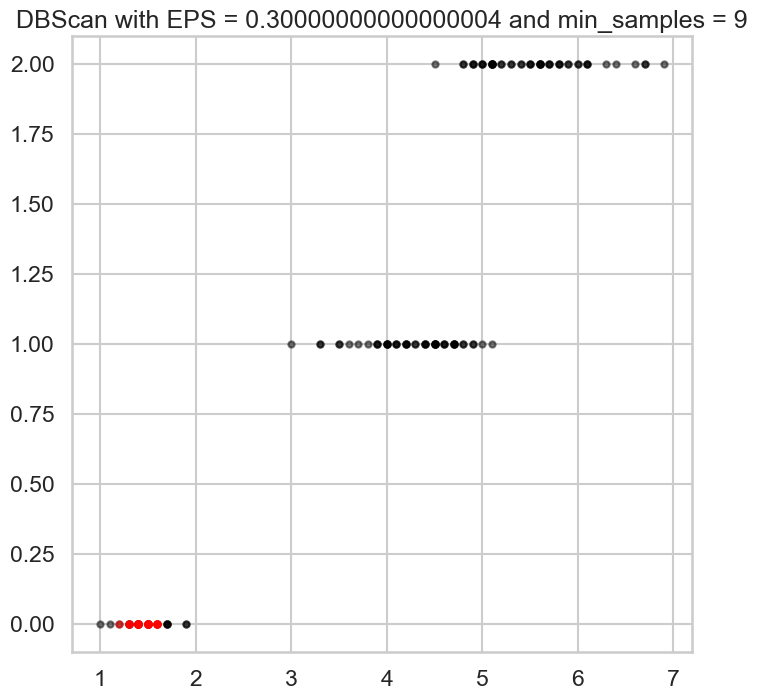

EPS: 0.30000000000000004, Min Samples: 9, Silhouette Score: 0.433
[ 0  0  0  0  0 -1 -1  0  0  0  0  0  0 -1 -1 -1 -1  0 -1  0 -1  0 -1 -1
 -1  0  0  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0  0 -1  0 -1 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


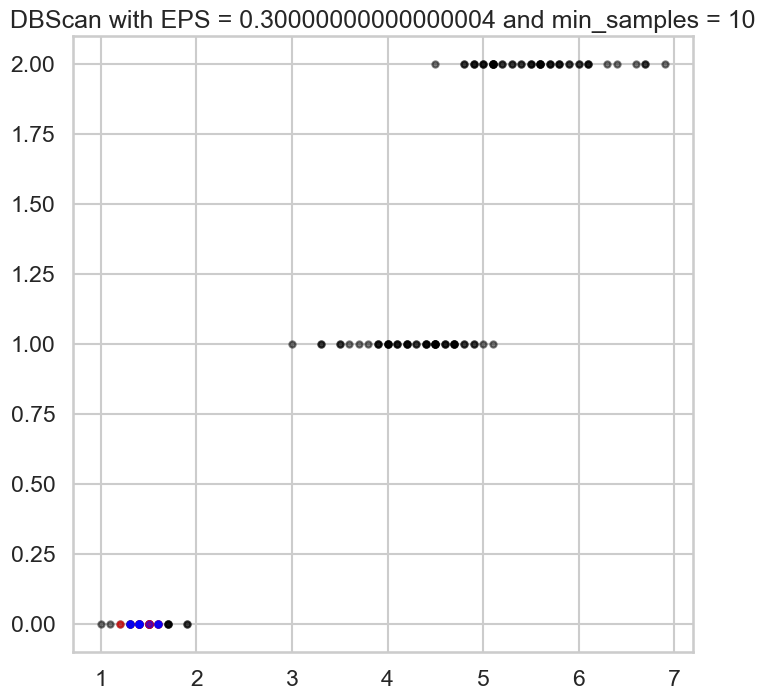

EPS: 0.30000000000000004, Min Samples: 10, Silhouette Score: 0.300
[ 0  1  1  1  0 -1 -1  0  1  0 -1  0  1 -1 -1 -1 -1  0 -1  0 -1  0 -1 -1
 -1  1  0  0  0  1  1 -1 -1 -1  0  0 -1  0  1  0  0 -1  1 -1 -1  1  0  1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


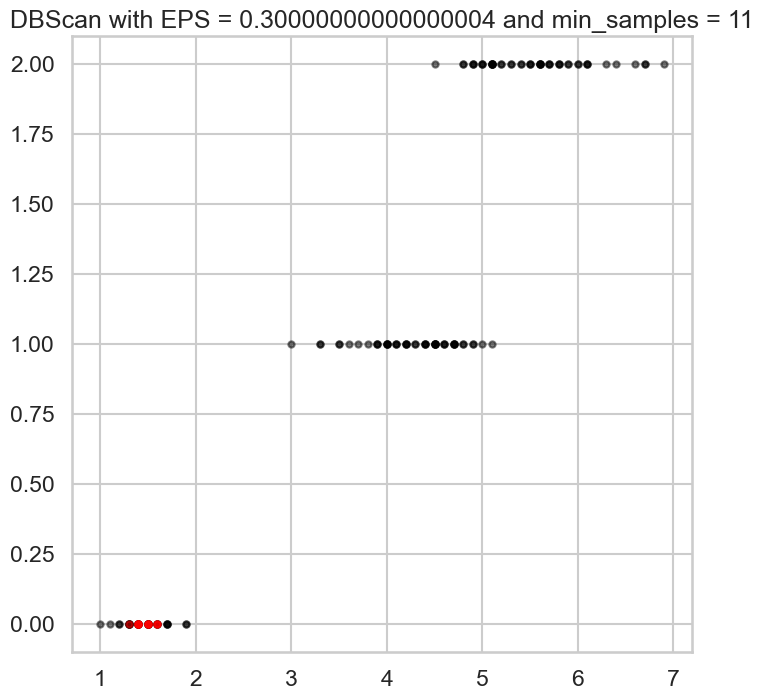

EPS: 0.30000000000000004, Min Samples: 11, Silhouette Score: 0.196
[ 0 -1 -1 -1  0 -1 -1  0 -1 -1 -1  0 -1 -1 -1 -1 -1  0 -1  0 -1  0 -1 -1
 -1 -1  0  0  0 -1 -1 -1 -1 -1 -1 -1 -1  0 -1  0  0 -1 -1 -1 -1 -1  0 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


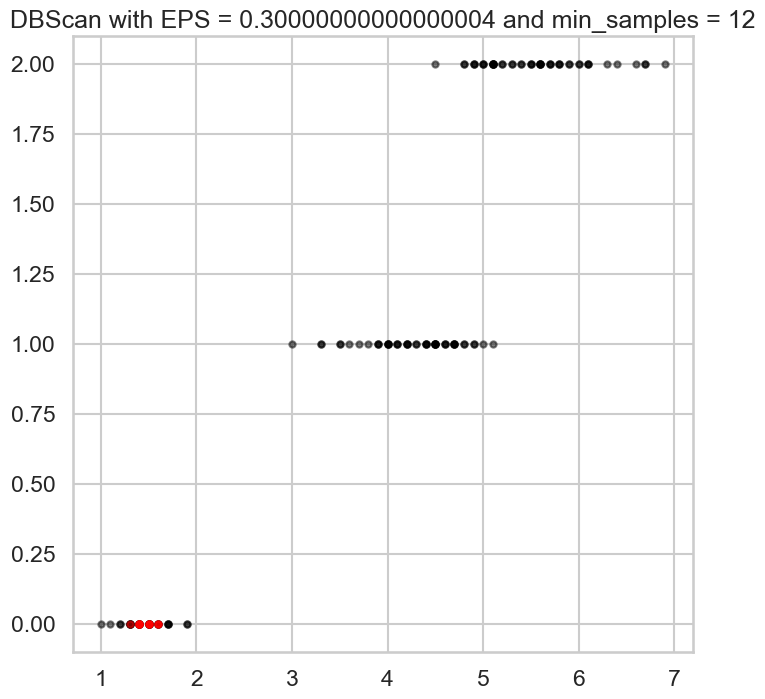

EPS: 0.30000000000000004, Min Samples: 12, Silhouette Score: 0.196
[ 0 -1 -1 -1  0 -1 -1  0 -1 -1 -1  0 -1 -1 -1 -1 -1  0 -1  0 -1  0 -1 -1
 -1 -1  0  0  0 -1 -1 -1 -1 -1 -1 -1 -1  0 -1  0  0 -1 -1 -1 -1 -1  0 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


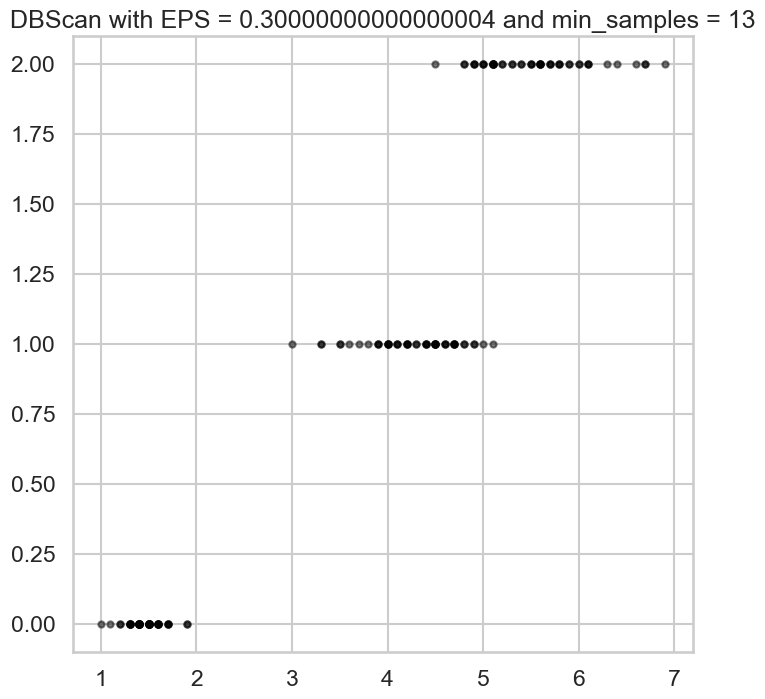

EPS: 0.30000000000000004, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


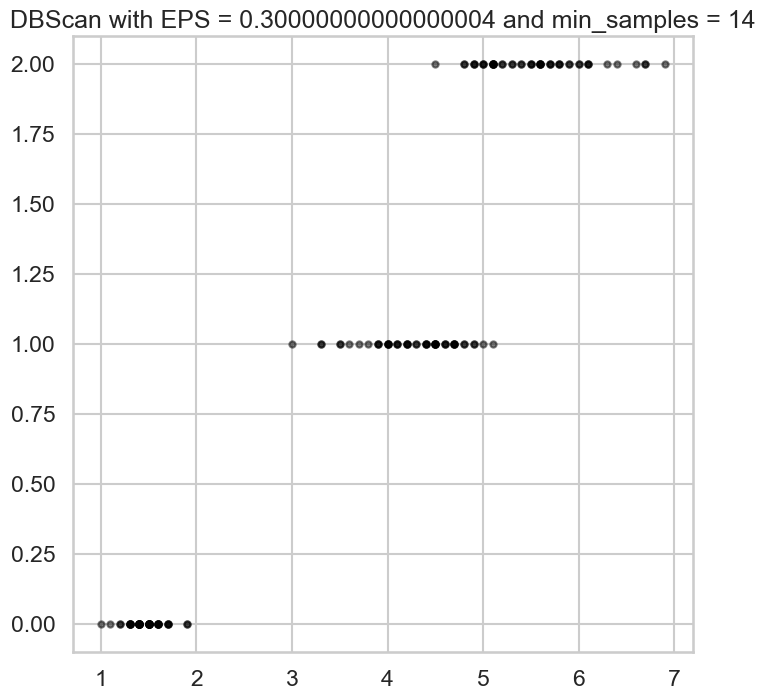

EPS: 0.30000000000000004, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


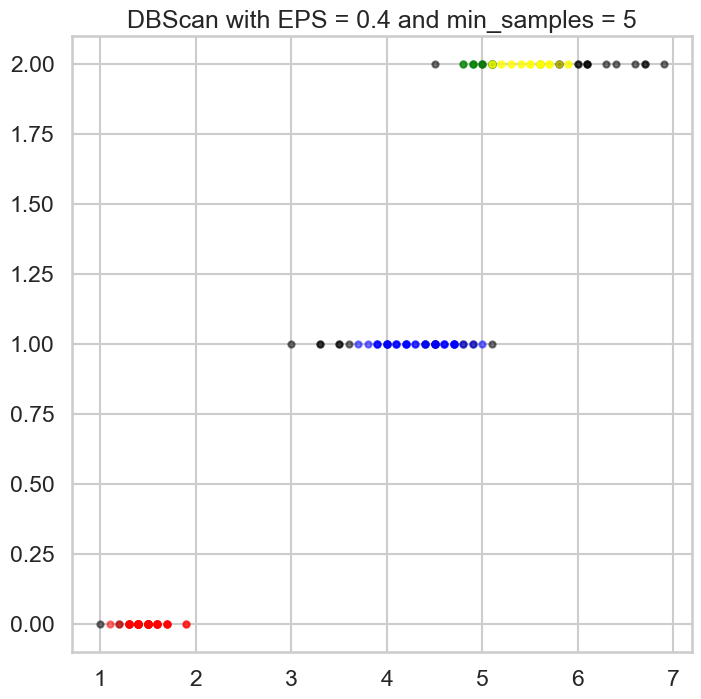

EPS: 0.4, Min Samples: 5, Silhouette Score: 0.322
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1 -1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1 -1  1  1  1 -1 -1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1  2  3  3  3 -1 -1 -1 -1 -1  3  3  3  2 -1  3  3 -1 -1 -1
  3  2 -1  2  3 -1  2  2  3 -1 -1 -1  3  2 -1 -1  3  3  2  3  3  3  2  3
  3  3  2  3  3  2]


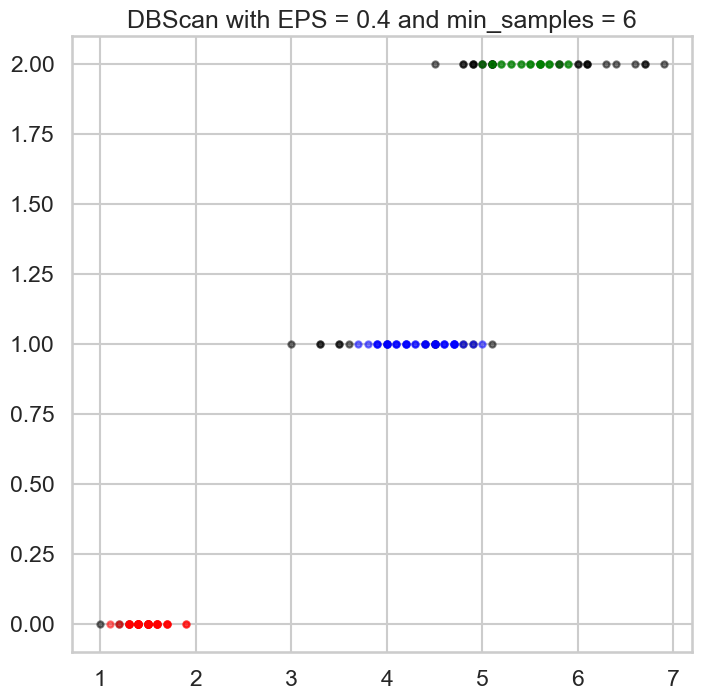

EPS: 0.4, Min Samples: 6, Silhouette Score: 0.338
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1 -1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1 -1  1  1  1 -1 -1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1  2  2 -1  2  2  2 -1  2
  2  2  2  2  2 -1]


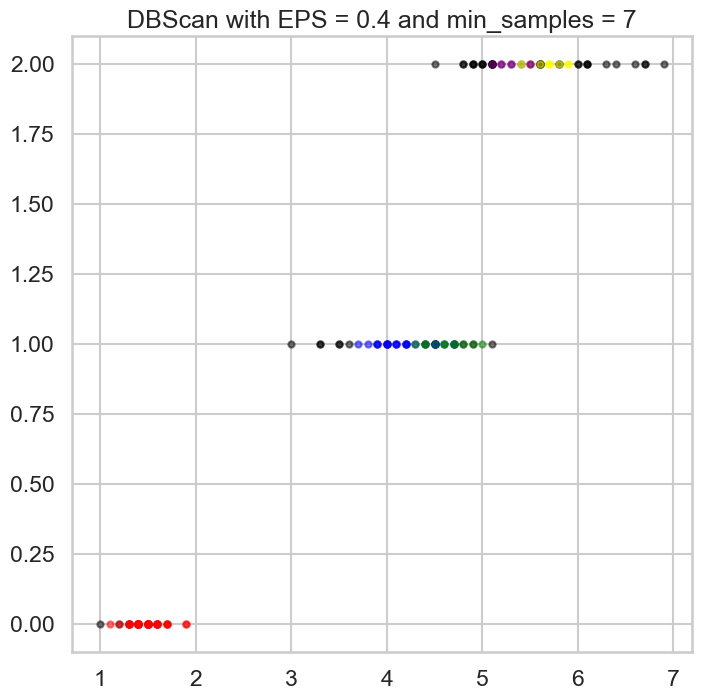

EPS: 0.4, Min Samples: 7, Silhouette Score: 0.180
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  2  2  2  1  2  1 -1 -1  2  1 -1  1 -1  1 -1  2  1  1 -1  1 -1  1
 -1  1  2  2  2  2  1 -1  1  1  1 -1 -1 -1  2 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  3 -1  3 -1 -1 -1 -1 -1  4  4  3 -1 -1  4  4 -1 -1 -1
  3 -1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  4 -1  3  3 -1 -1  3
  3  4 -1  4 -1 -1]


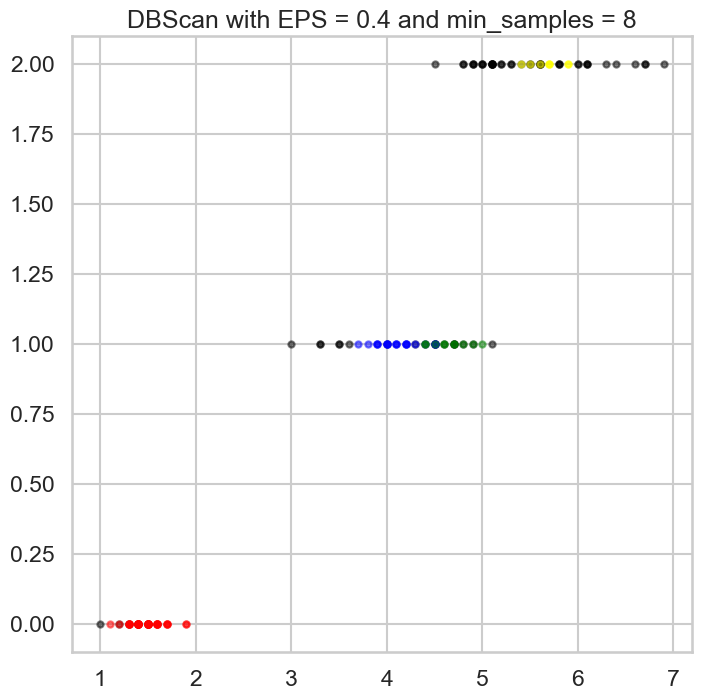

EPS: 0.4, Min Samples: 8, Silhouette Score: 0.180
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  2  2  2  1  2  1 -1 -1  2  1 -1  1 -1 -1 -1  2  1  1 -1  1 -1  1
 -1 -1 -1  2  2  2  1 -1  1  1  1 -1 -1 -1  2 -1  1  1  1 -1  1 -1  1  1
  1  1 -1  1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1
  3 -1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  3  3 -1 -1  3
  3 -1 -1 -1 -1 -1]


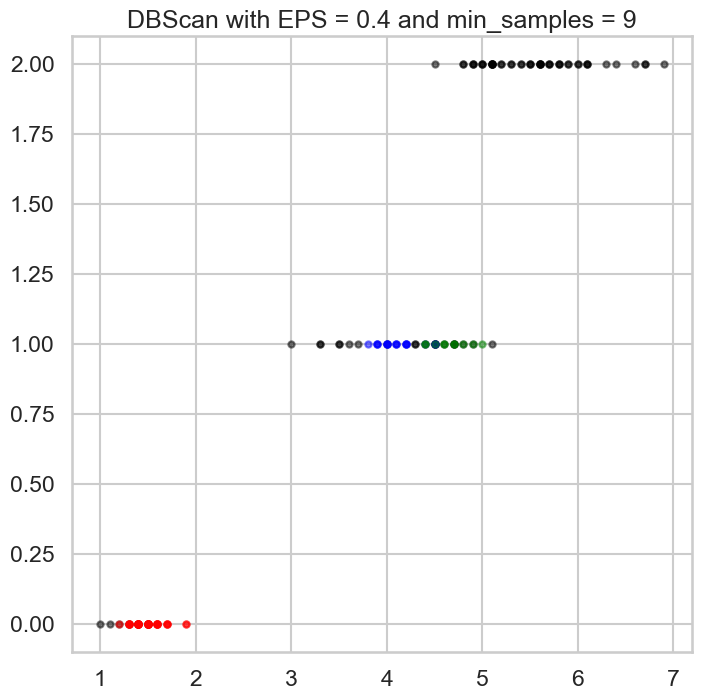

EPS: 0.4, Min Samples: 9, Silhouette Score: 0.214
[ 0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  2  2  2  1  2  1 -1 -1  2  1 -1  1 -1 -1 -1  2  1  1 -1  1 -1  1
 -1 -1 -1  2  2  2 -1 -1  1 -1  1 -1 -1 -1  2 -1  1  1  1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


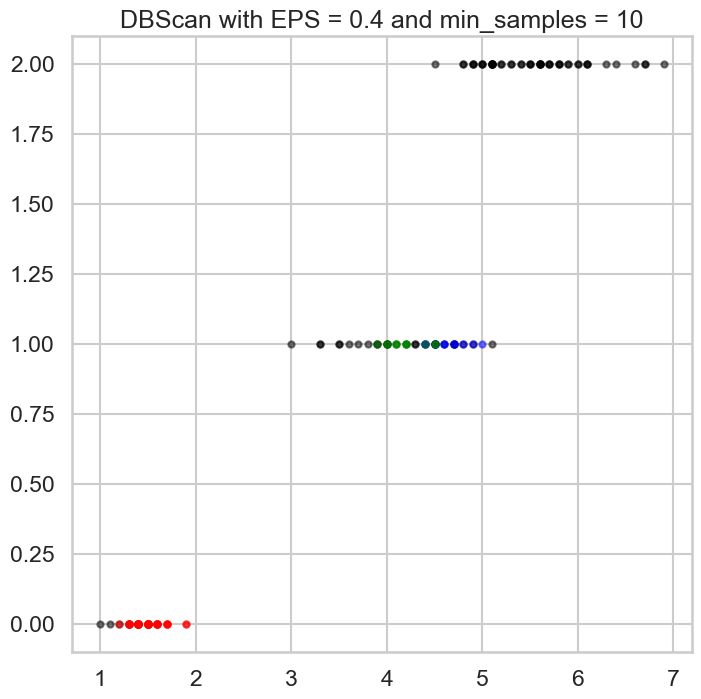

EPS: 0.4, Min Samples: 10, Silhouette Score: 0.168
[ 0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1 -1  1  2 -1 -1  1 -1 -1  2 -1 -1 -1  1  2  2 -1 -1 -1 -1
 -1 -1 -1  1  1  1 -1 -1 -1 -1  2 -1 -1 -1  1 -1  2  2  2 -1  2 -1  2  2
  2 -1 -1  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


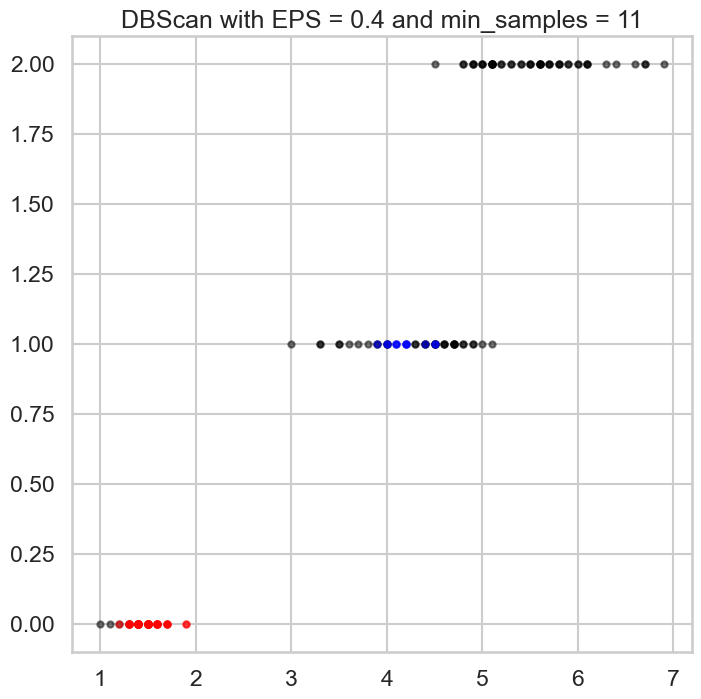

EPS: 0.4, Min Samples: 11, Silhouette Score: 0.204
[ 0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1 -1 -1  1  1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1  1  1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


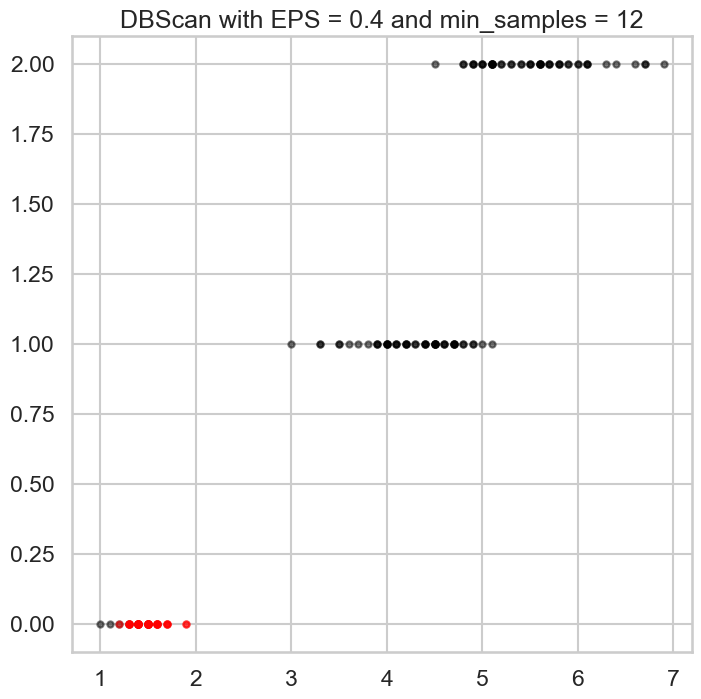

EPS: 0.4, Min Samples: 12, Silhouette Score: 0.595
[ 0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


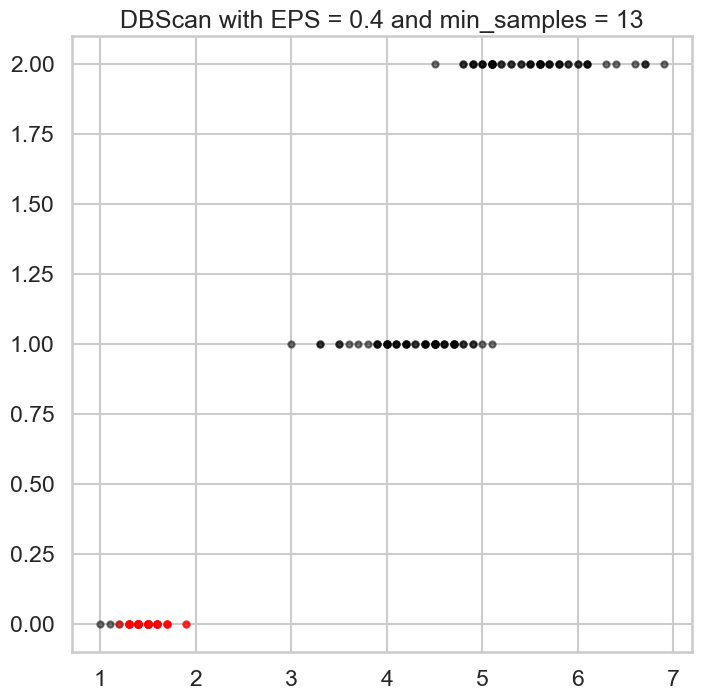

EPS: 0.4, Min Samples: 13, Silhouette Score: 0.595
[ 0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


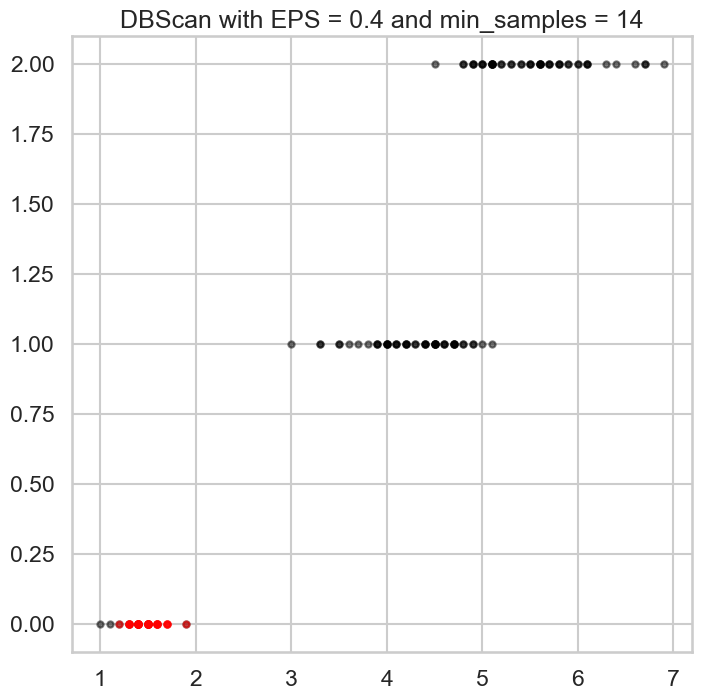

EPS: 0.4, Min Samples: 14, Silhouette Score: 0.582
[ 0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1 -1  0  0  0  0  0  0 -1  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


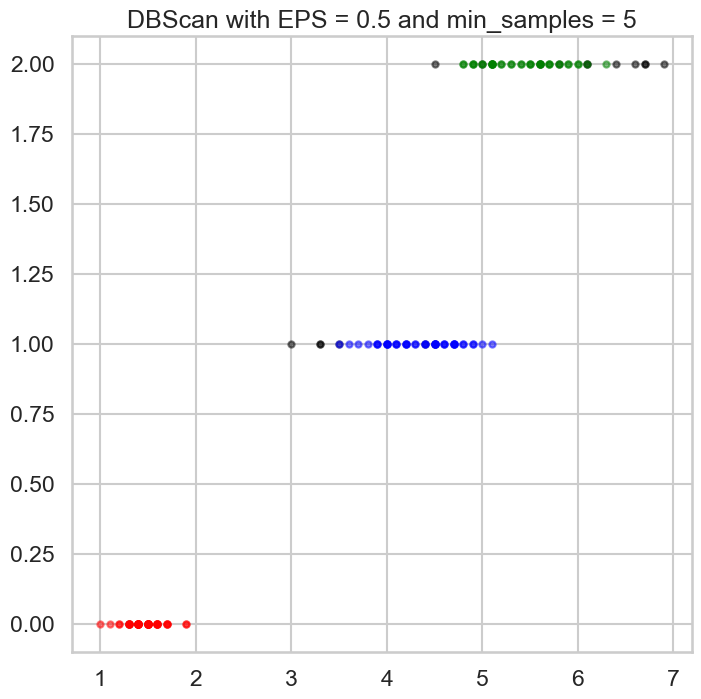

EPS: 0.5, Min Samples: 5, Silhouette Score: 0.494
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2 -1 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


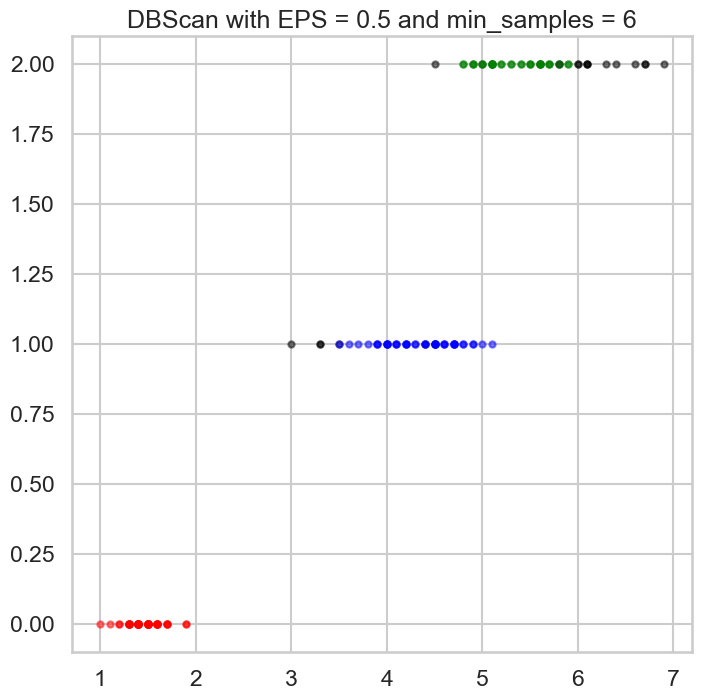

EPS: 0.5, Min Samples: 6, Silhouette Score: 0.471
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1  2  2  2  2 -1 -1 -1 -1 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


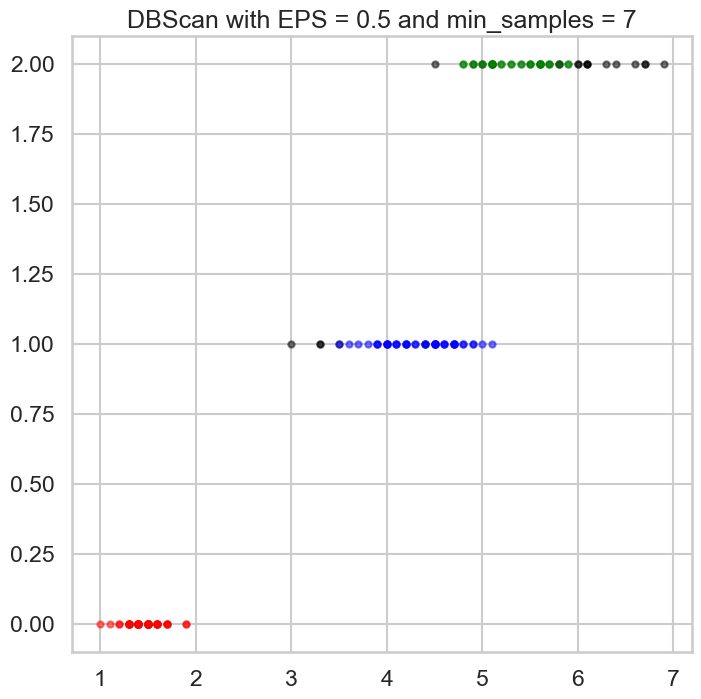

EPS: 0.5, Min Samples: 7, Silhouette Score: 0.453
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1  2  2  2  2 -1 -1 -1 -1 -1  2  2  2  2 -1  2  2 -1 -1 -1
  2  2 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


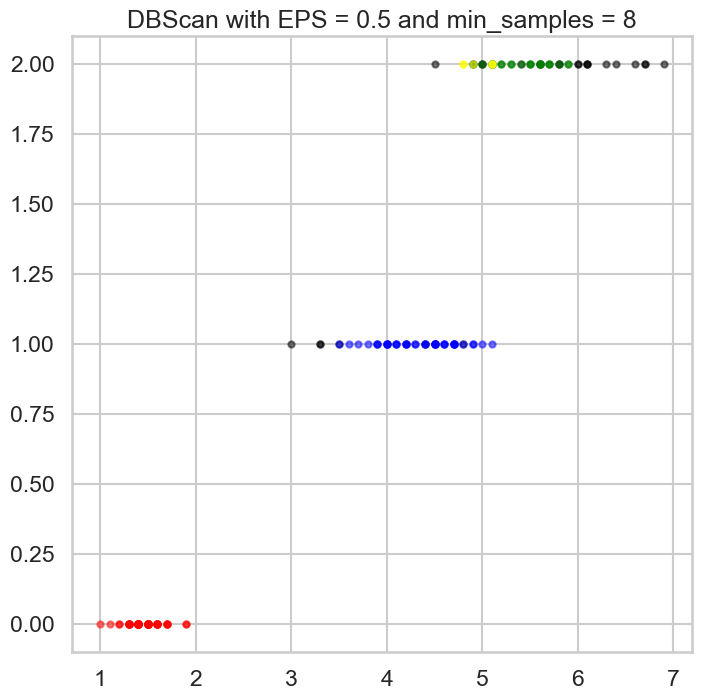

EPS: 0.5, Min Samples: 8, Silhouette Score: 0.333
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1  3  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1  3  3  2 -1 -1 -1  2  2 -1 -1 -1  2  3  2  2  2  3  2
  2  2  2  2 -1  3]


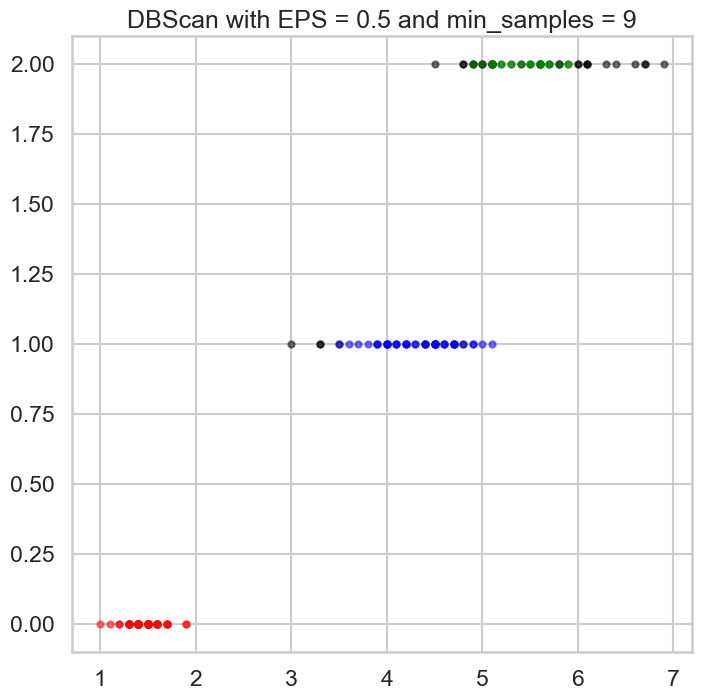

EPS: 0.5, Min Samples: 9, Silhouette Score: 0.397
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1 -1 -1  2 -1 -1 -1  2  2 -1 -1 -1  2 -1  2  2  2 -1  2
  2  2  2  2 -1 -1]


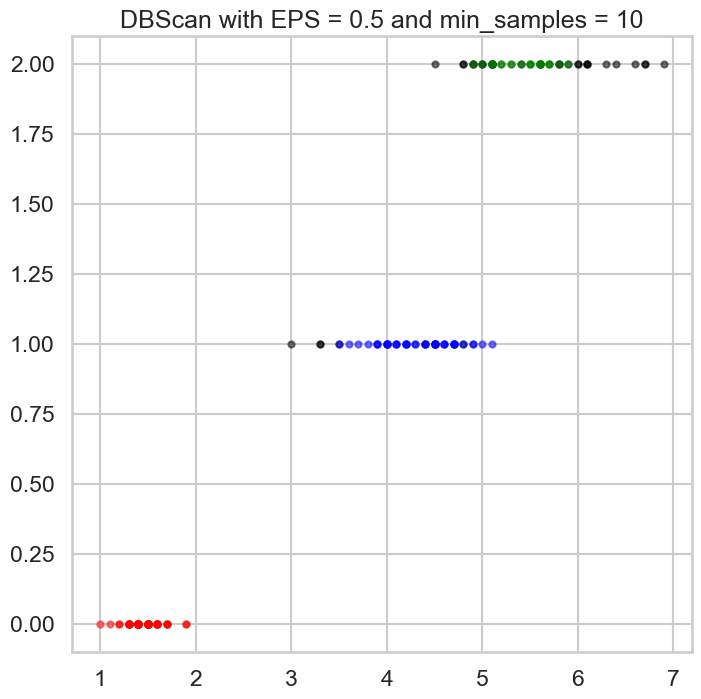

EPS: 0.5, Min Samples: 10, Silhouette Score: 0.389
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1 -1  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1 -1 -1  2 -1 -1 -1  2  2 -1 -1 -1  2 -1  2  2  2 -1  2
  2  2  2  2 -1 -1]


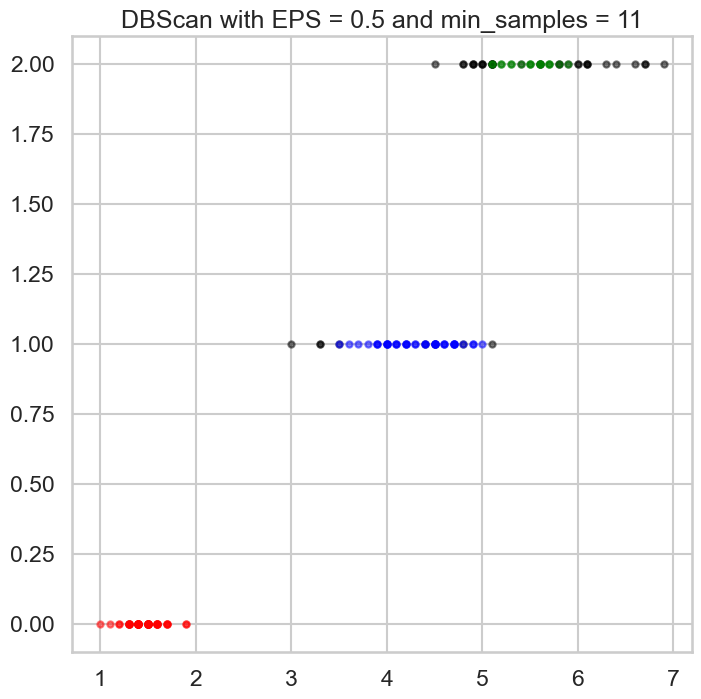

EPS: 0.5, Min Samples: 11, Silhouette Score: 0.375
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1 -1  1
  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1 -1  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1 -1  2 -1  2  2  2 -1  2
  2  2 -1  2 -1 -1]


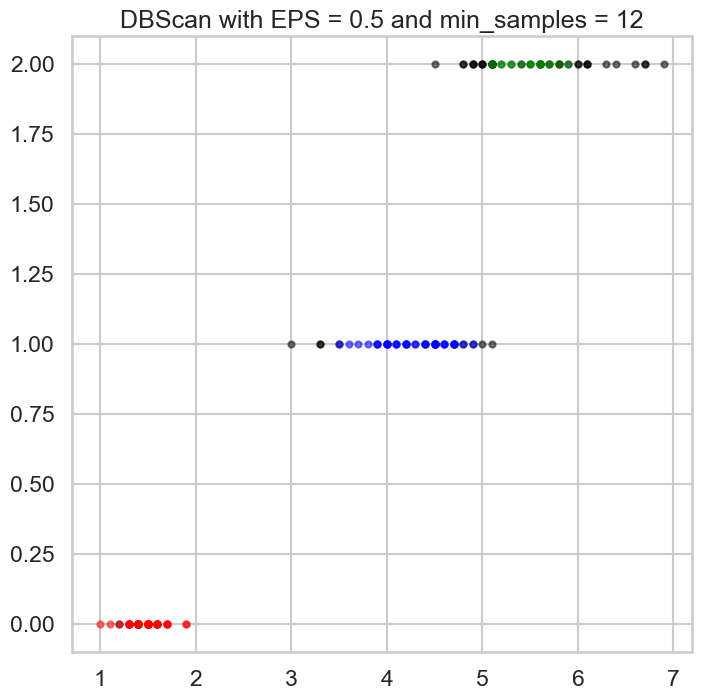

EPS: 0.5, Min Samples: 12, Silhouette Score: 0.333
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1  1 -1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1 -1  1
  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1 -1  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1 -1  2 -1  2  2  2 -1  2
 -1  2 -1  2 -1 -1]


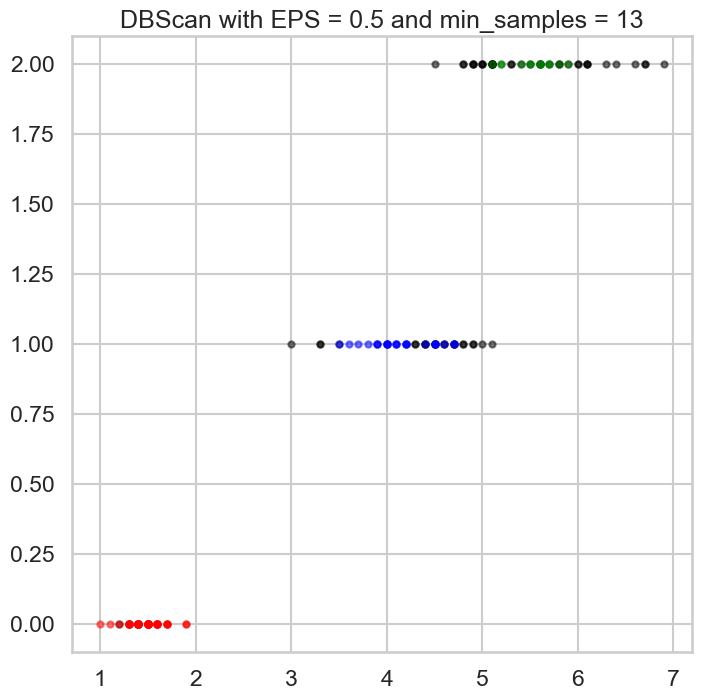

EPS: 0.5, Min Samples: 13, Silhouette Score: 0.243
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1  1 -1  1 -1 -1 -1  1 -1  1  1  1  1 -1  1  1 -1  1 -1  1
 -1  1 -1 -1 -1 -1  1  1  1  1  1 -1  1 -1 -1 -1  1  1  1  1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1  2 -1 -1 -1 -1 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1
  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1  2 -1 -1 -1 -1 -1 -1  2  2  2 -1  2
 -1  2 -1  2 -1 -1]


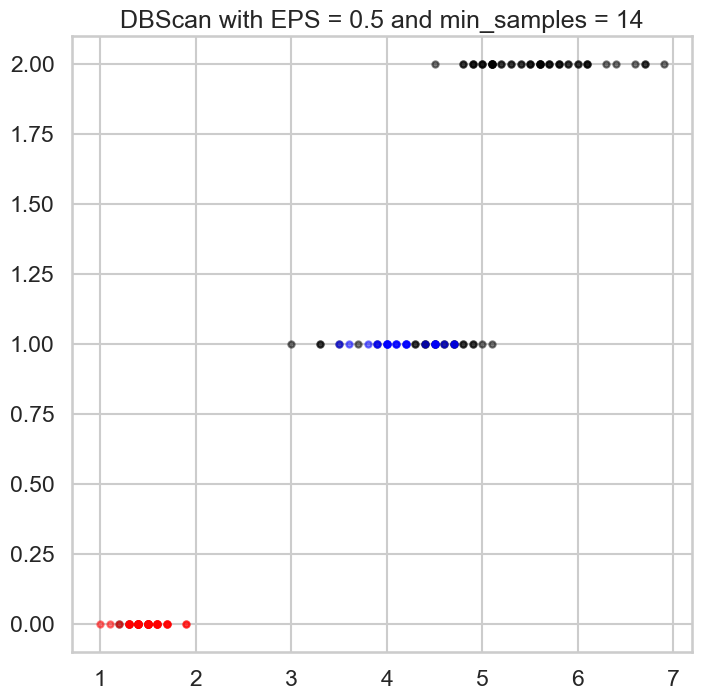

EPS: 0.5, Min Samples: 14, Silhouette Score: 0.347
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1  1 -1  1 -1 -1 -1 -1 -1  1  1  1  1 -1  1  1 -1  1 -1  1
 -1  1 -1 -1 -1 -1  1  1  1 -1  1 -1  1 -1 -1 -1  1  1  1  1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


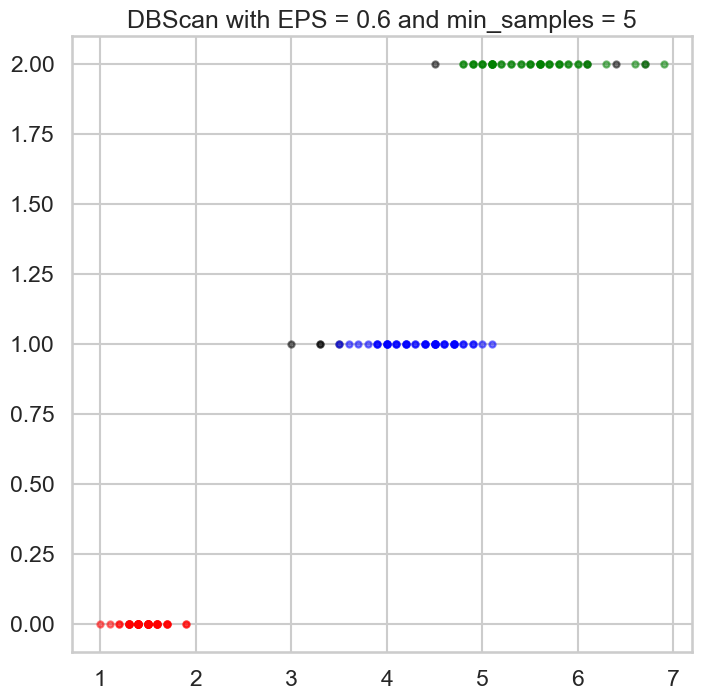

EPS: 0.6, Min Samples: 5, Silhouette Score: 0.538
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


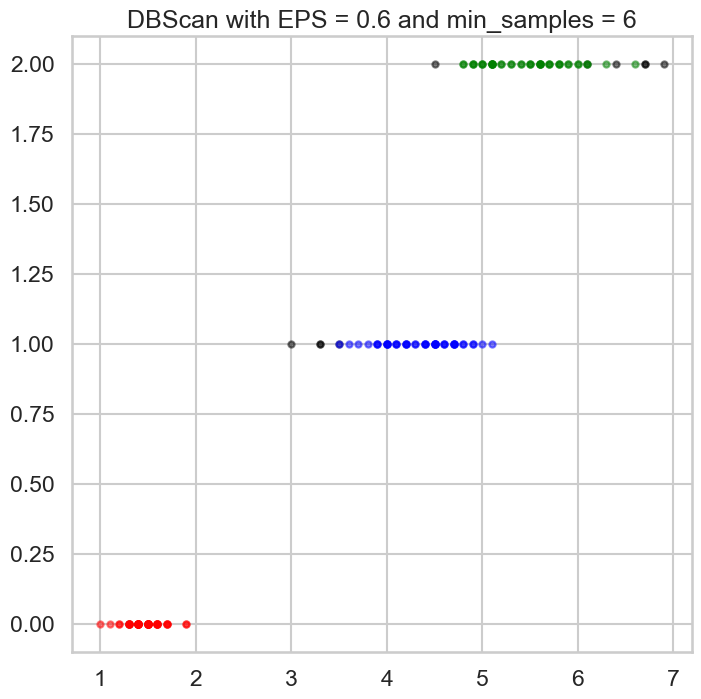

EPS: 0.6, Min Samples: 6, Silhouette Score: 0.531
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


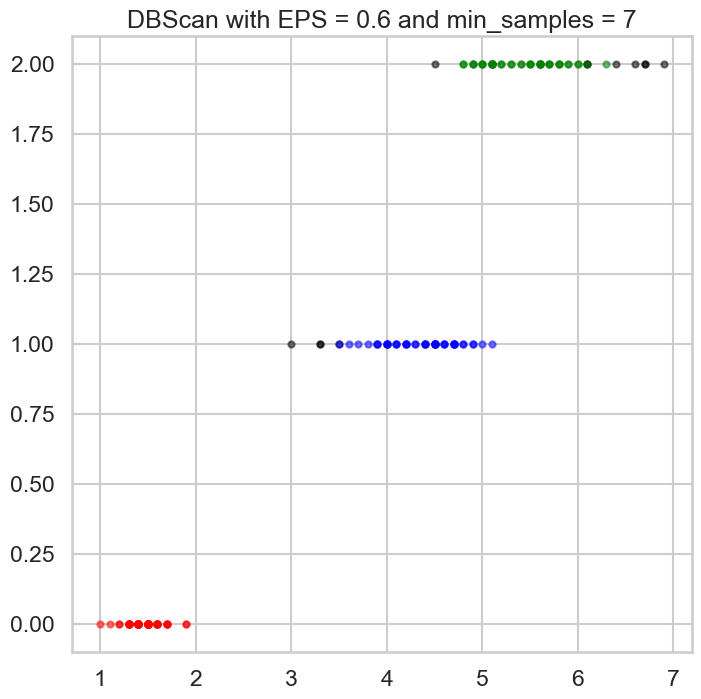

EPS: 0.6, Min Samples: 7, Silhouette Score: 0.523
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


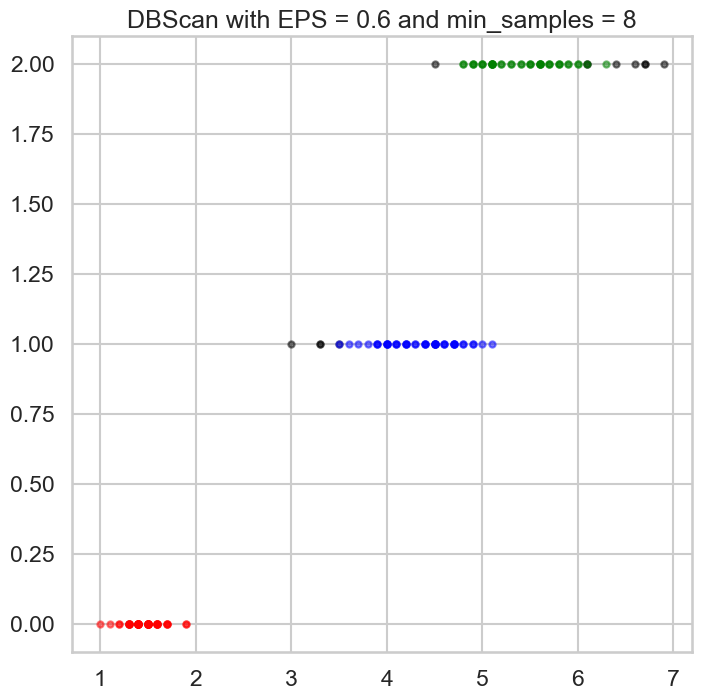

EPS: 0.6, Min Samples: 8, Silhouette Score: 0.516
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


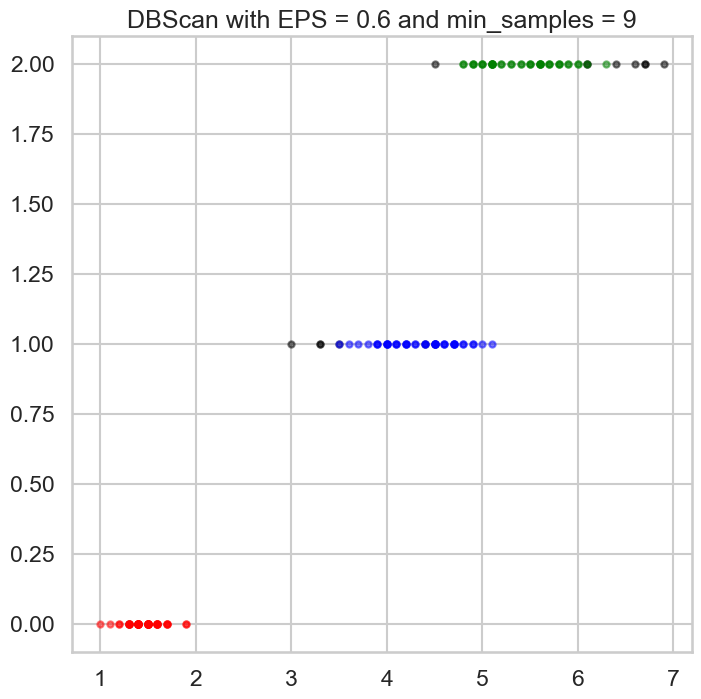

EPS: 0.6, Min Samples: 9, Silhouette Score: 0.509
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


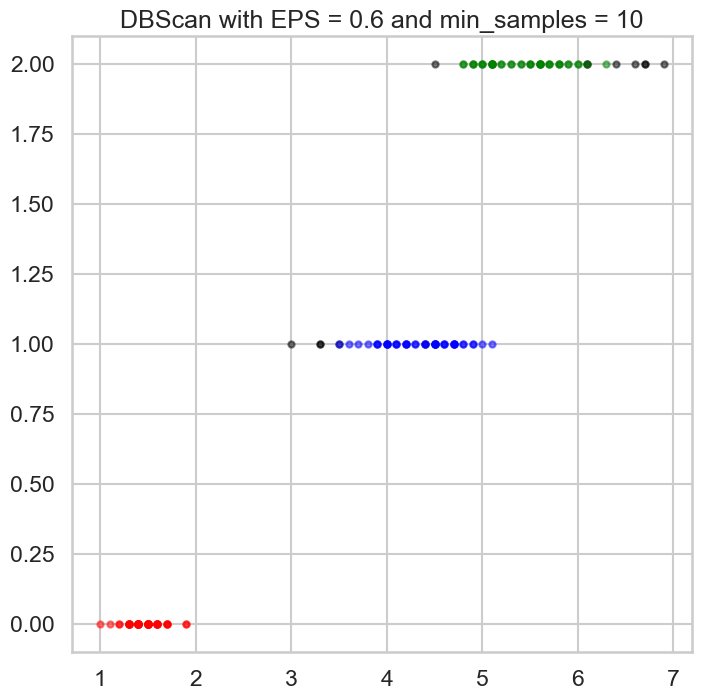

EPS: 0.6, Min Samples: 10, Silhouette Score: 0.509
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


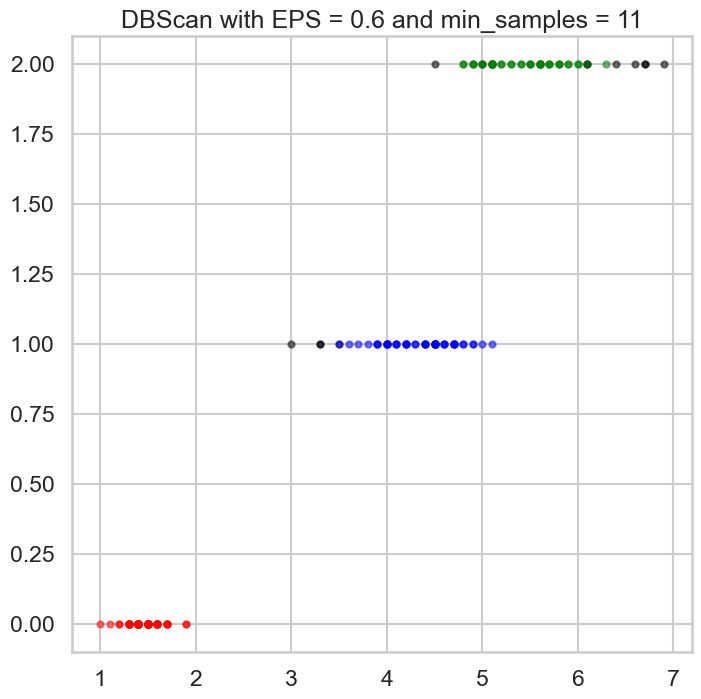

EPS: 0.6, Min Samples: 11, Silhouette Score: 0.496
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


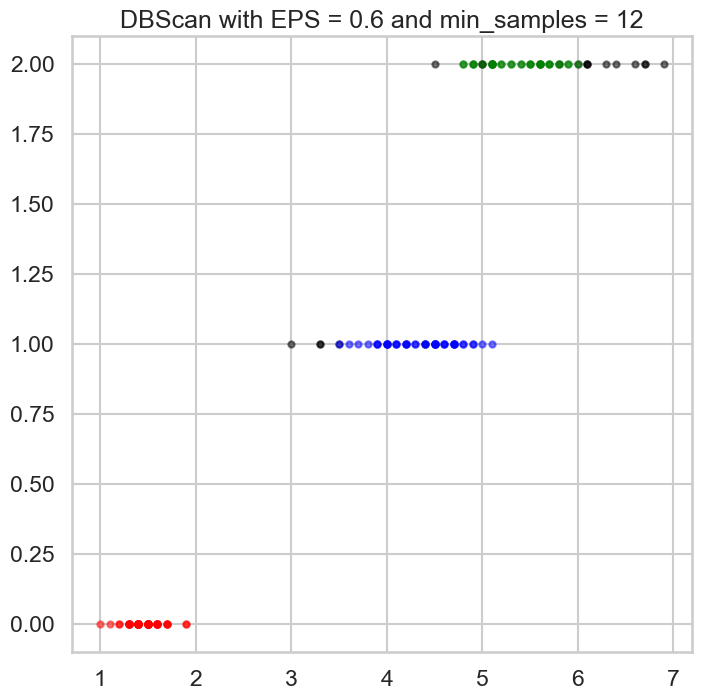

EPS: 0.6, Min Samples: 12, Silhouette Score: 0.467
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1 -1  2 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2  2 -1  2  2 -1  2  2  2 -1 -1 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


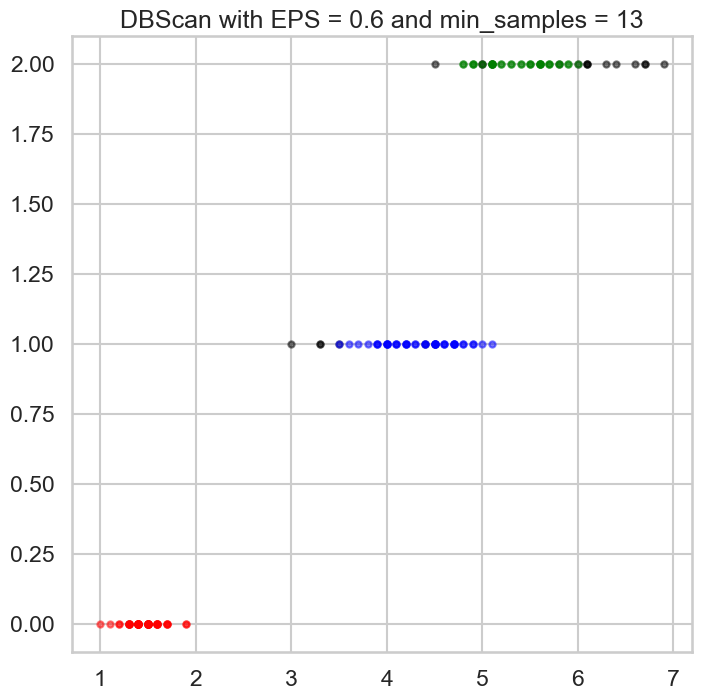

EPS: 0.6, Min Samples: 13, Silhouette Score: 0.467
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1 -1  2 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2  2 -1  2  2 -1  2  2  2 -1 -1 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


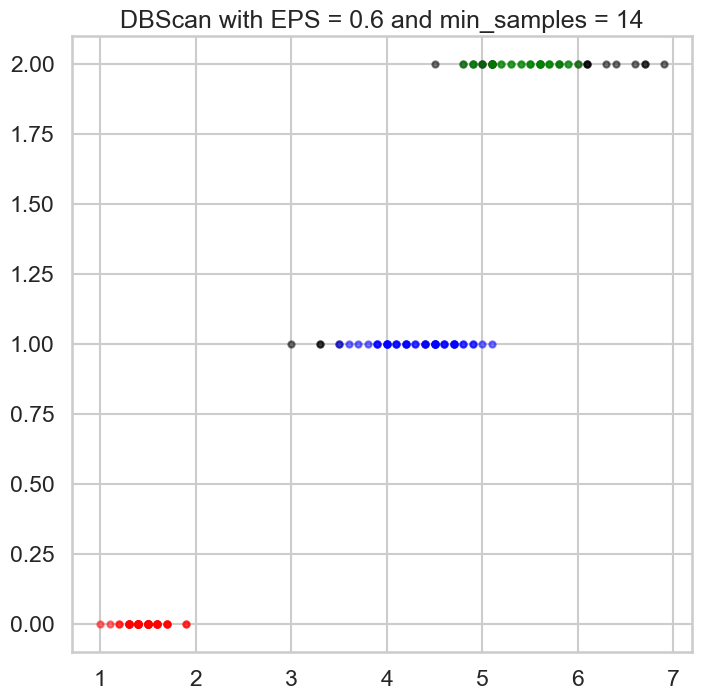

EPS: 0.6, Min Samples: 14, Silhouette Score: 0.441
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2 -1  2  2  2 -1 -1 -1  2 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2 -1  2  2  2 -1  2
  2  2  2  2  2 -1]


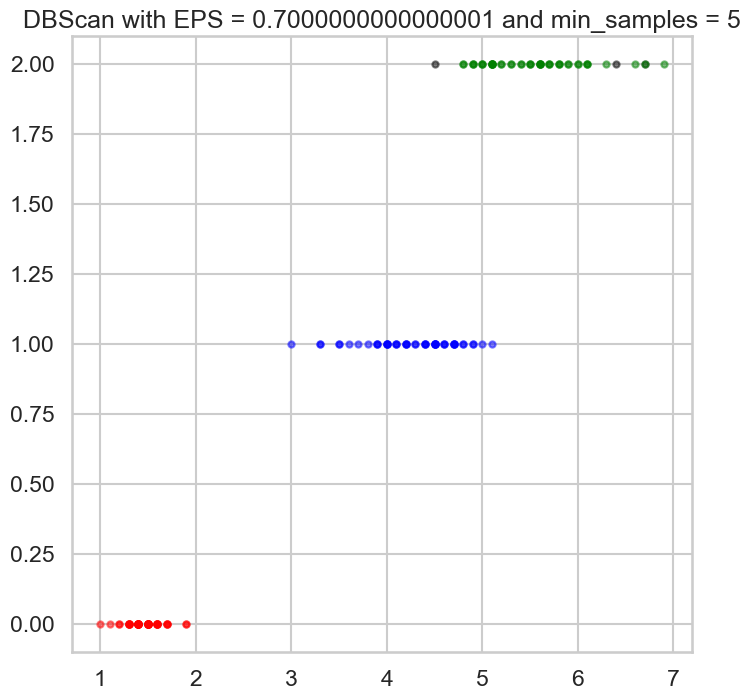

EPS: 0.7000000000000001, Min Samples: 5, Silhouette Score: 0.549
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


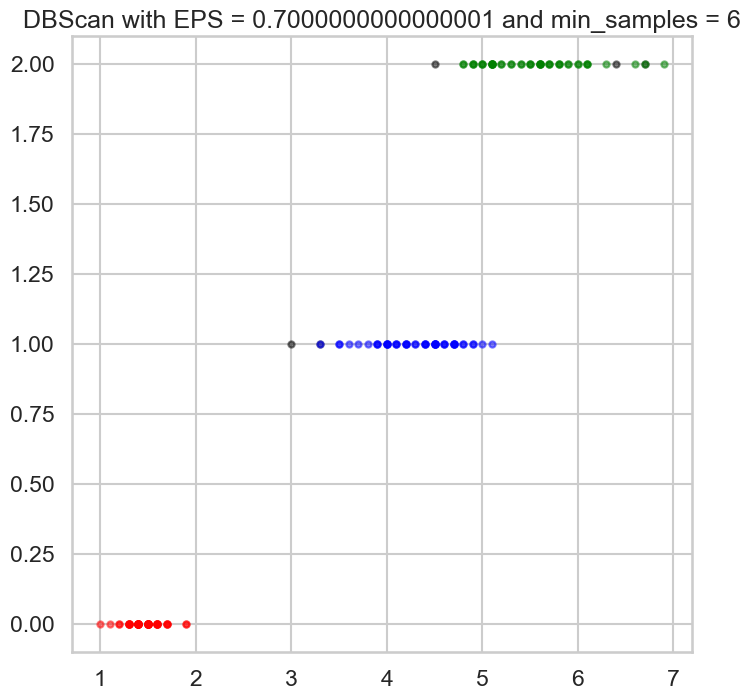

EPS: 0.7000000000000001, Min Samples: 6, Silhouette Score: 0.558
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


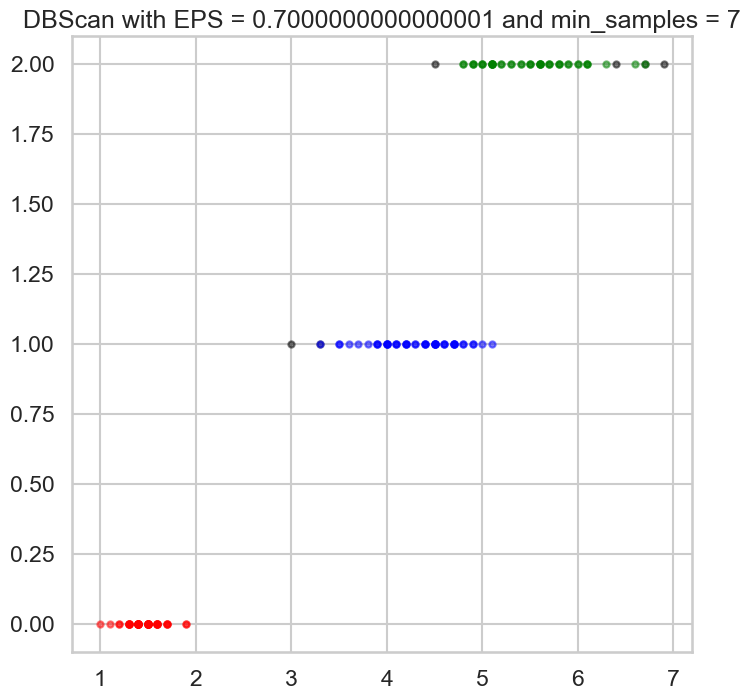

EPS: 0.7000000000000001, Min Samples: 7, Silhouette Score: 0.555
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


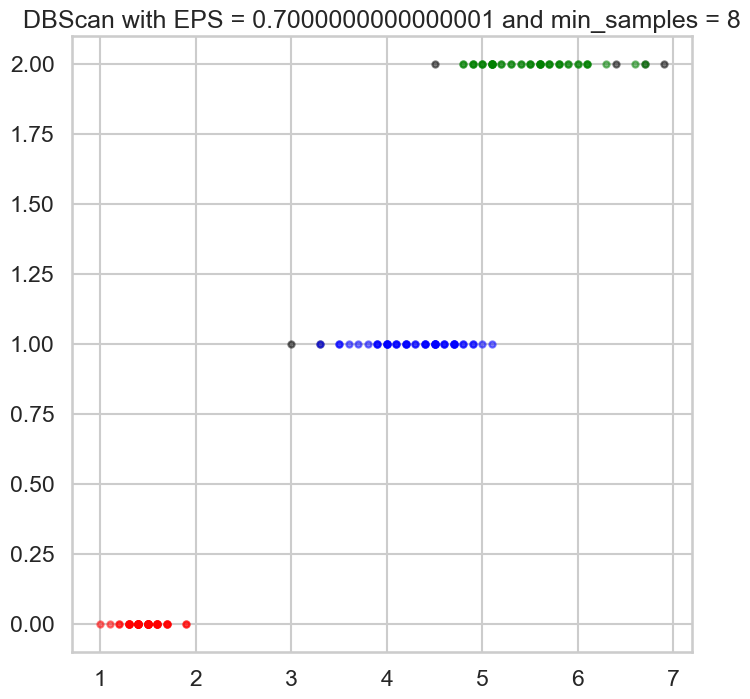

EPS: 0.7000000000000001, Min Samples: 8, Silhouette Score: 0.555
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


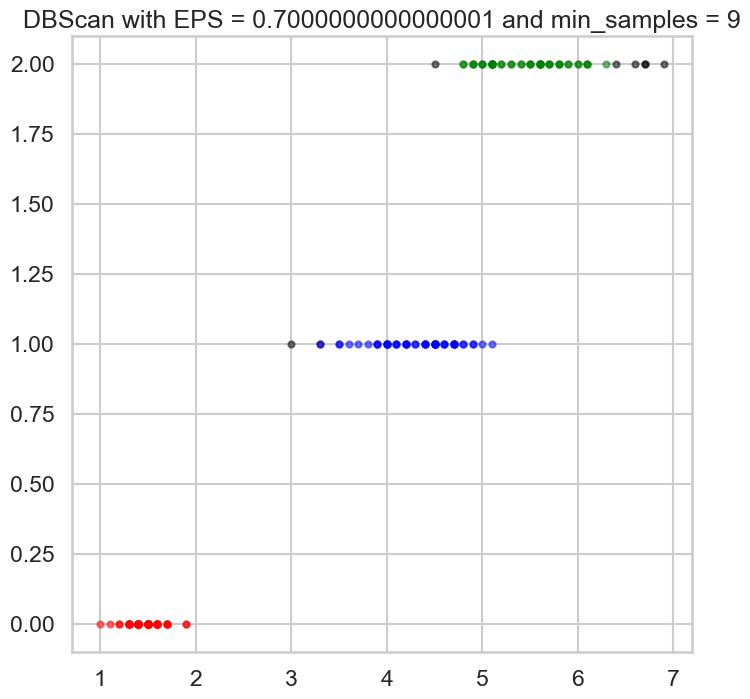

EPS: 0.7000000000000001, Min Samples: 9, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


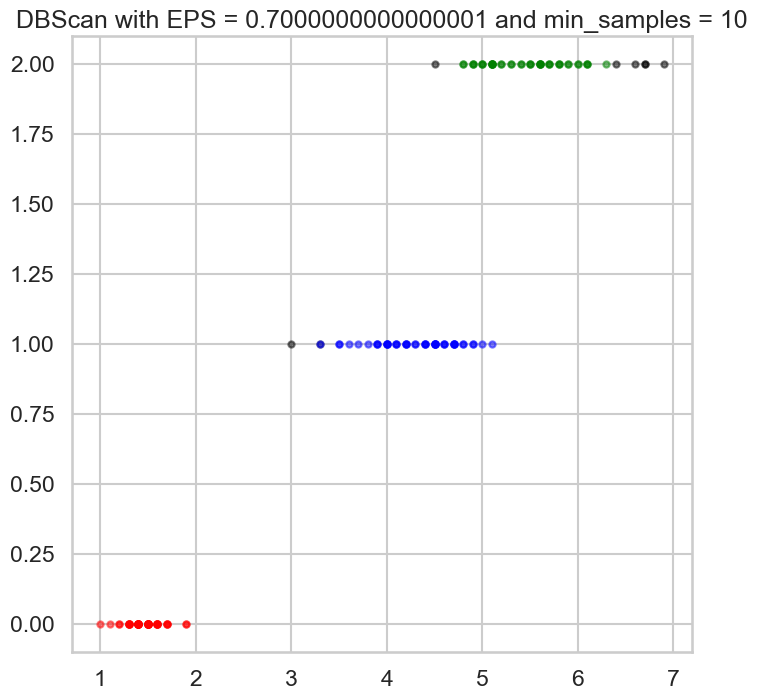

EPS: 0.7000000000000001, Min Samples: 10, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


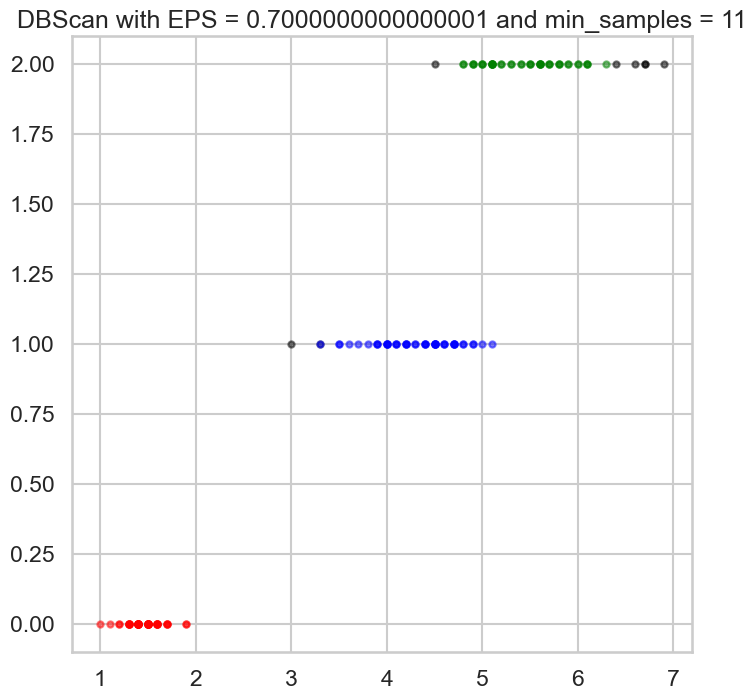

EPS: 0.7000000000000001, Min Samples: 11, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


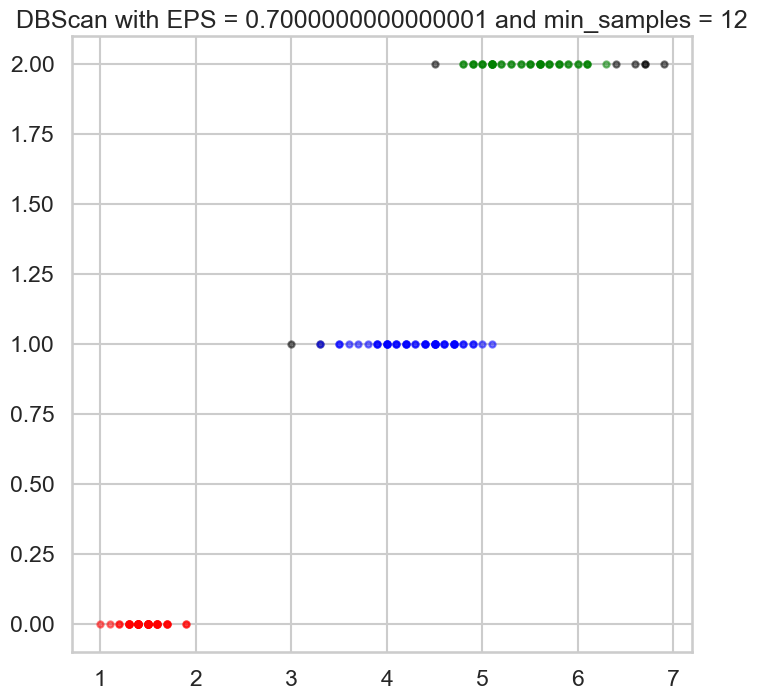

EPS: 0.7000000000000001, Min Samples: 12, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


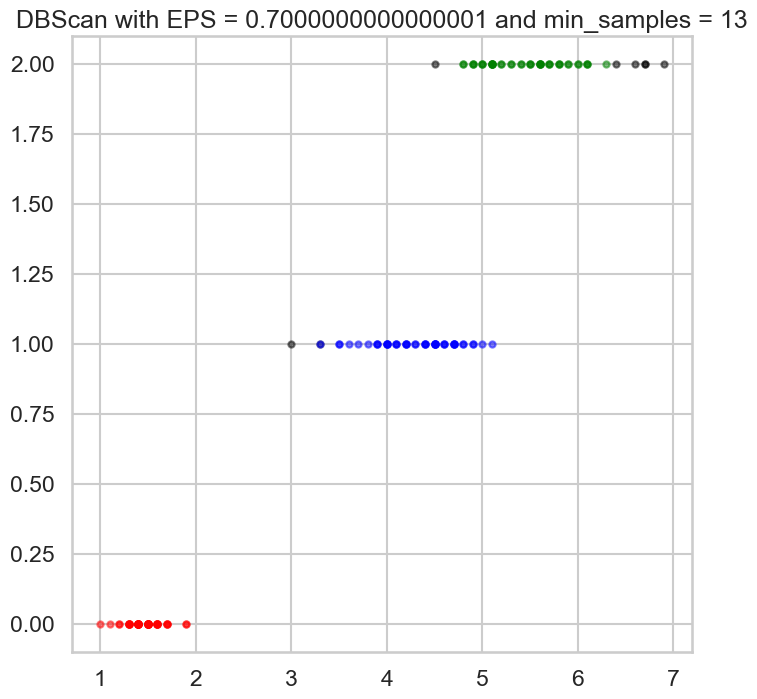

EPS: 0.7000000000000001, Min Samples: 13, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


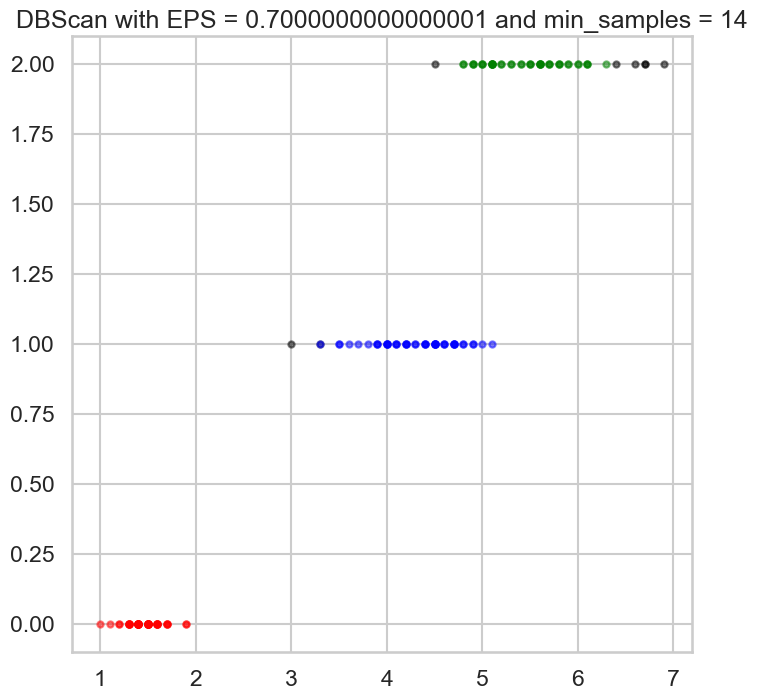

EPS: 0.7000000000000001, Min Samples: 14, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


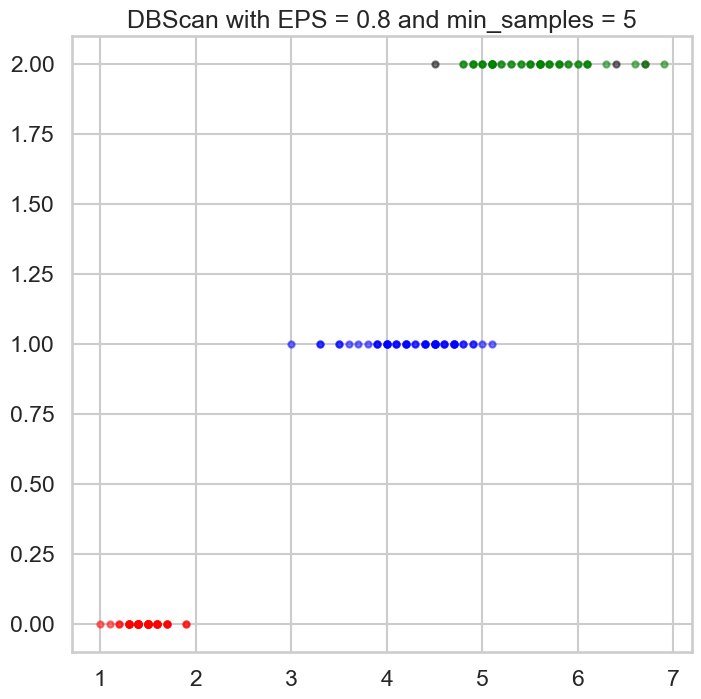

EPS: 0.8, Min Samples: 5, Silhouette Score: 0.549
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


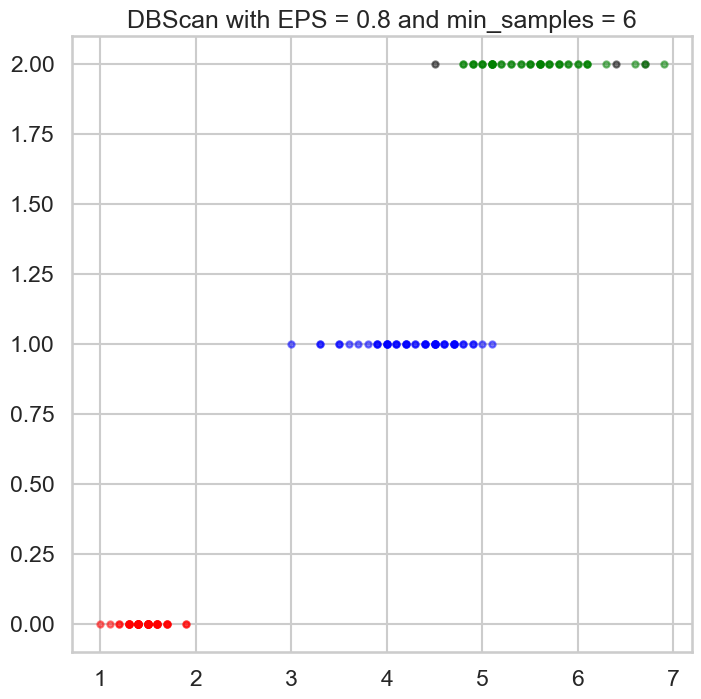

EPS: 0.8, Min Samples: 6, Silhouette Score: 0.549
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


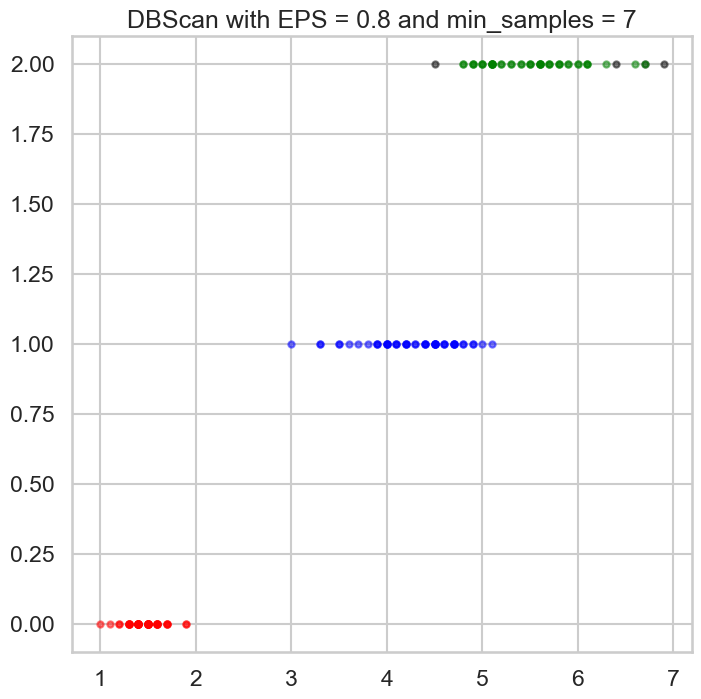

EPS: 0.8, Min Samples: 7, Silhouette Score: 0.544
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


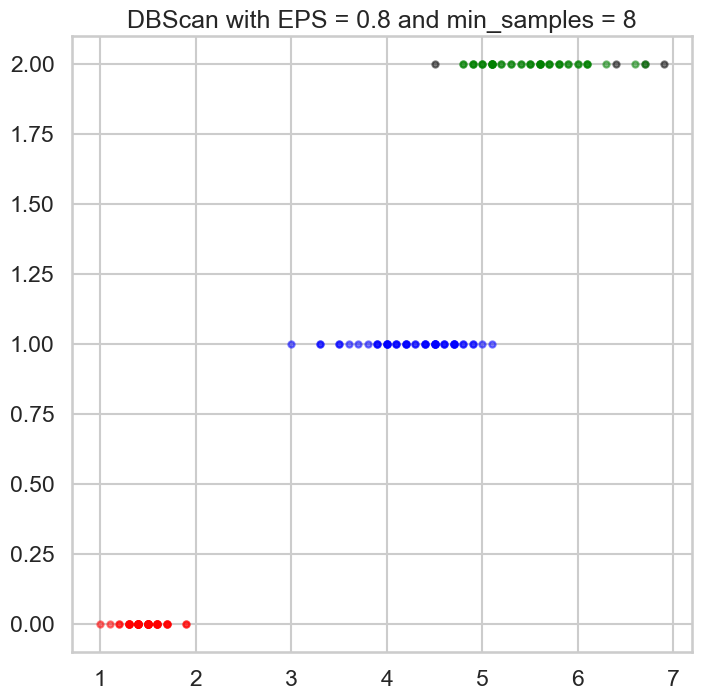

EPS: 0.8, Min Samples: 8, Silhouette Score: 0.544
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


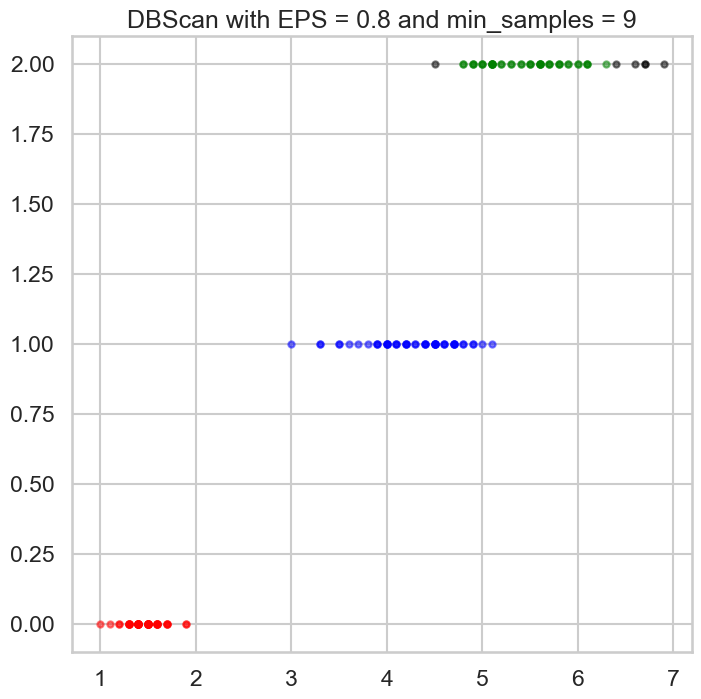

EPS: 0.8, Min Samples: 9, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


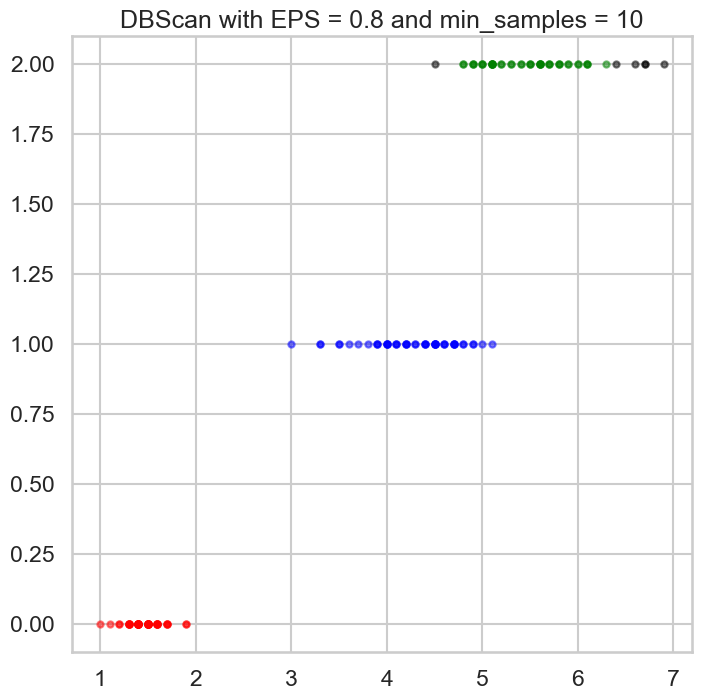

EPS: 0.8, Min Samples: 10, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


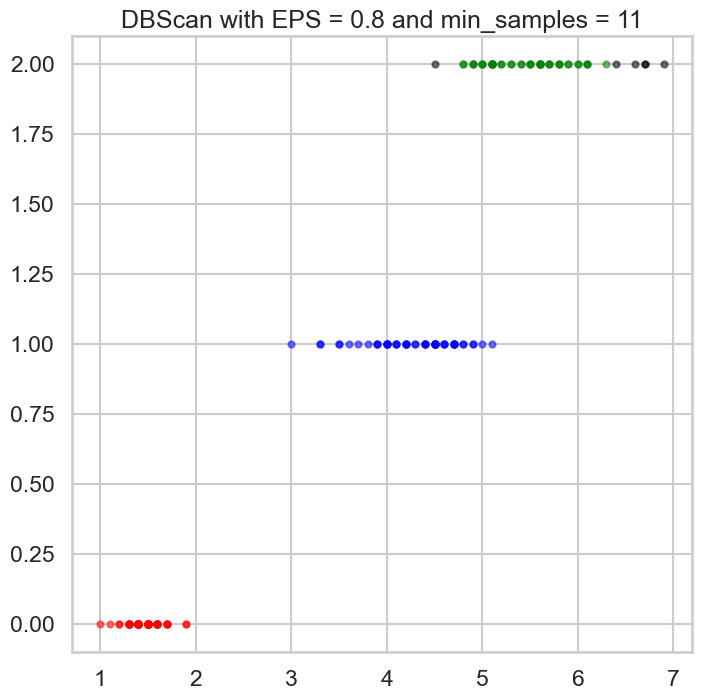

EPS: 0.8, Min Samples: 11, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


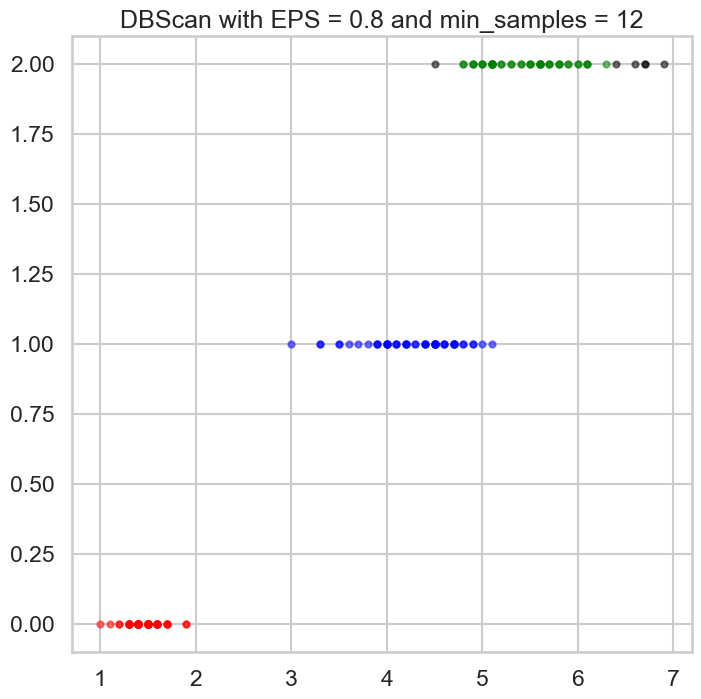

EPS: 0.8, Min Samples: 12, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


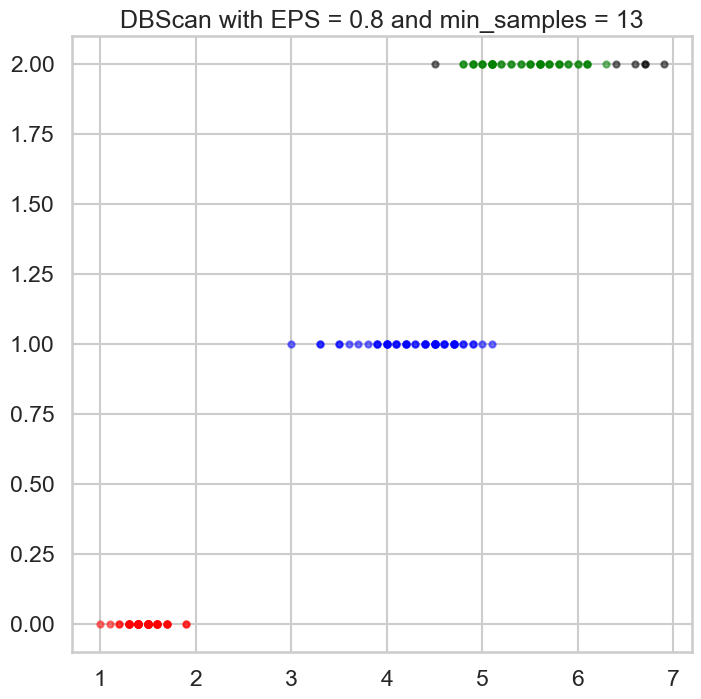

EPS: 0.8, Min Samples: 13, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


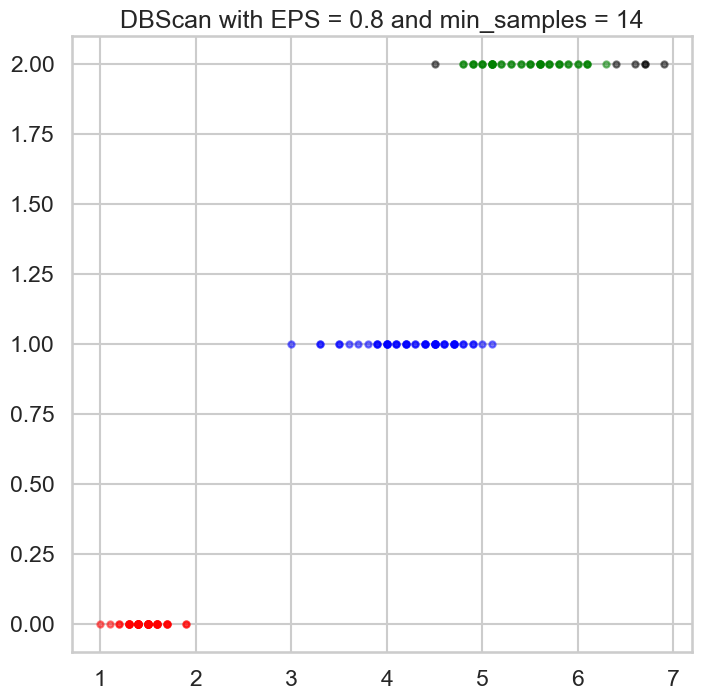

EPS: 0.8, Min Samples: 14, Silhouette Score: 0.547
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


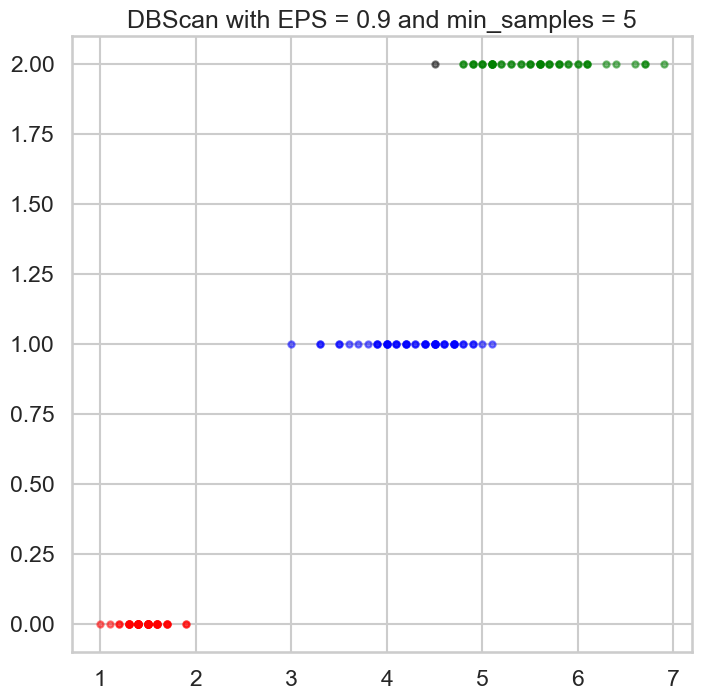

EPS: 0.9, Min Samples: 5, Silhouette Score: 0.520
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


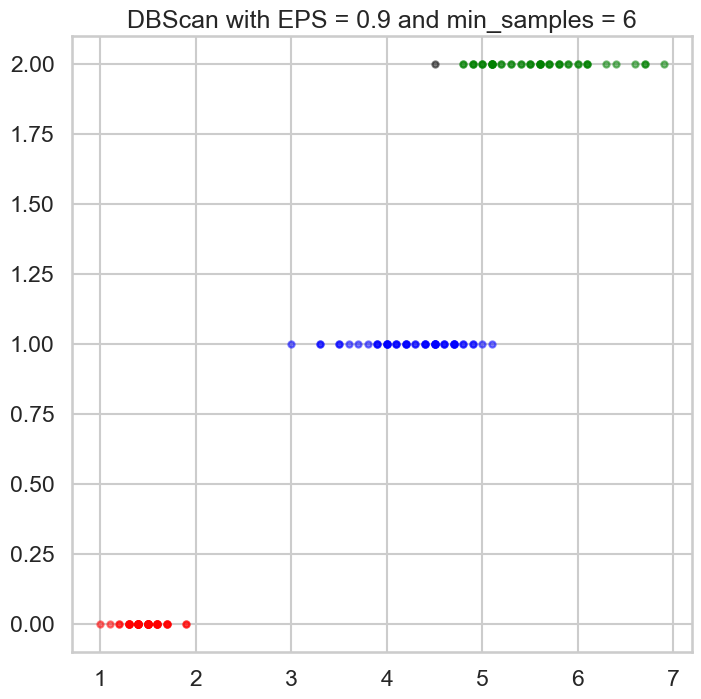

EPS: 0.9, Min Samples: 6, Silhouette Score: 0.520
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


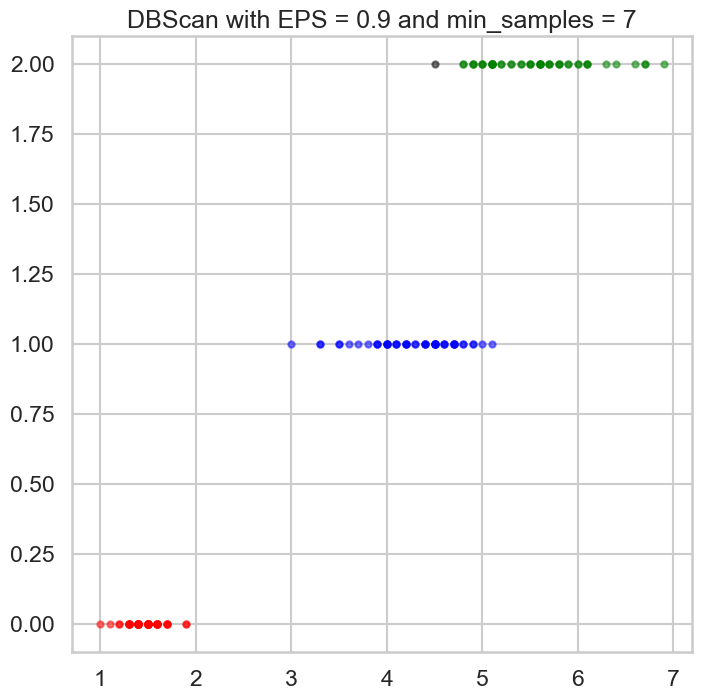

EPS: 0.9, Min Samples: 7, Silhouette Score: 0.520
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


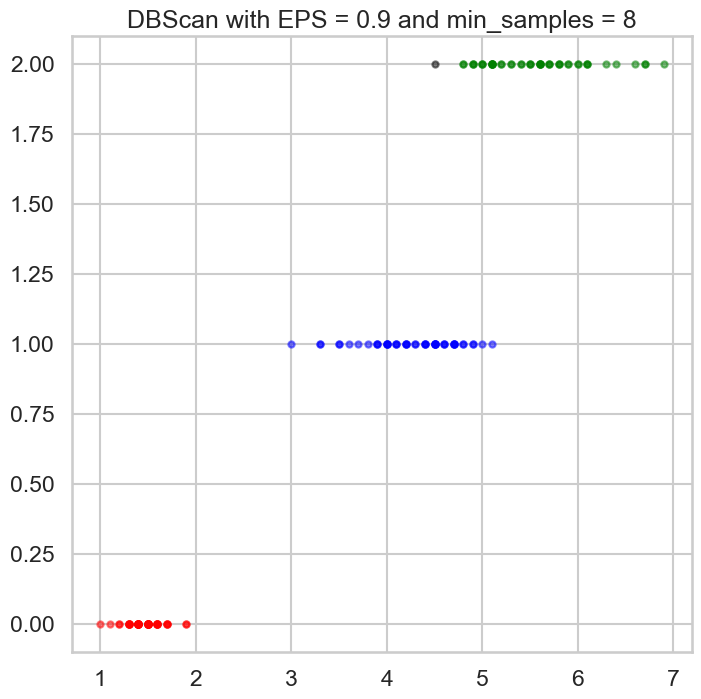

EPS: 0.9, Min Samples: 8, Silhouette Score: 0.520
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


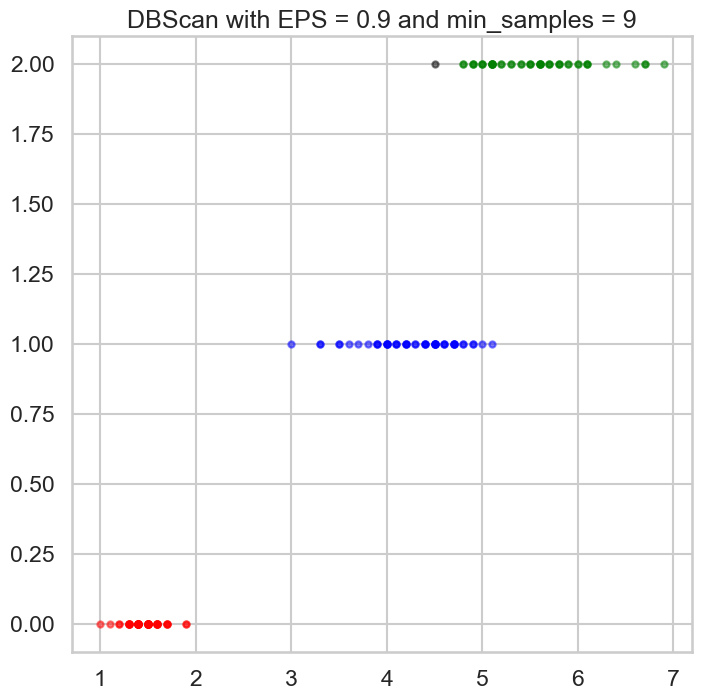

EPS: 0.9, Min Samples: 9, Silhouette Score: 0.520
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


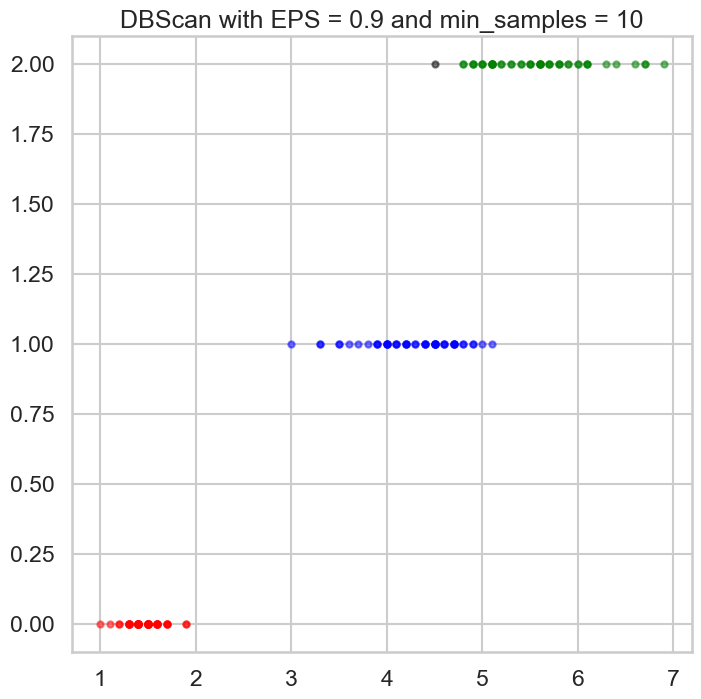

EPS: 0.9, Min Samples: 10, Silhouette Score: 0.520
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


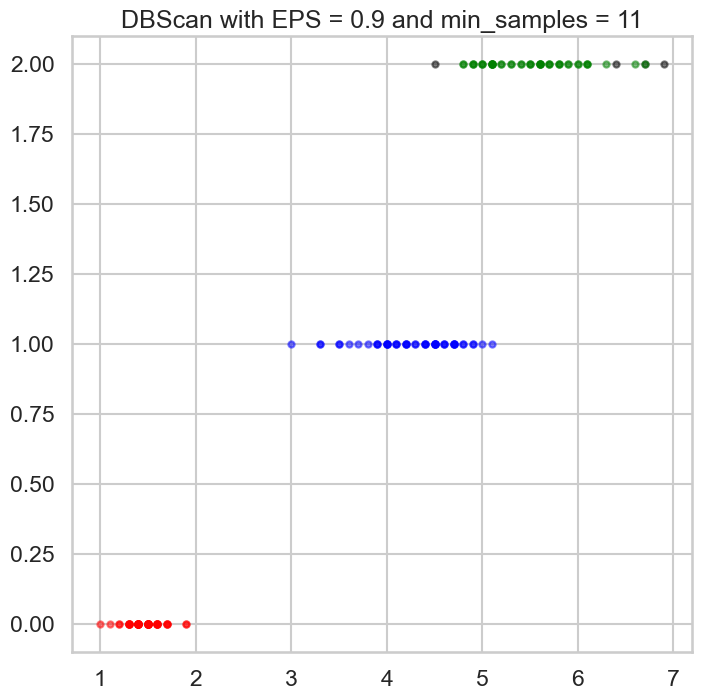

EPS: 0.9, Min Samples: 11, Silhouette Score: 0.544
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


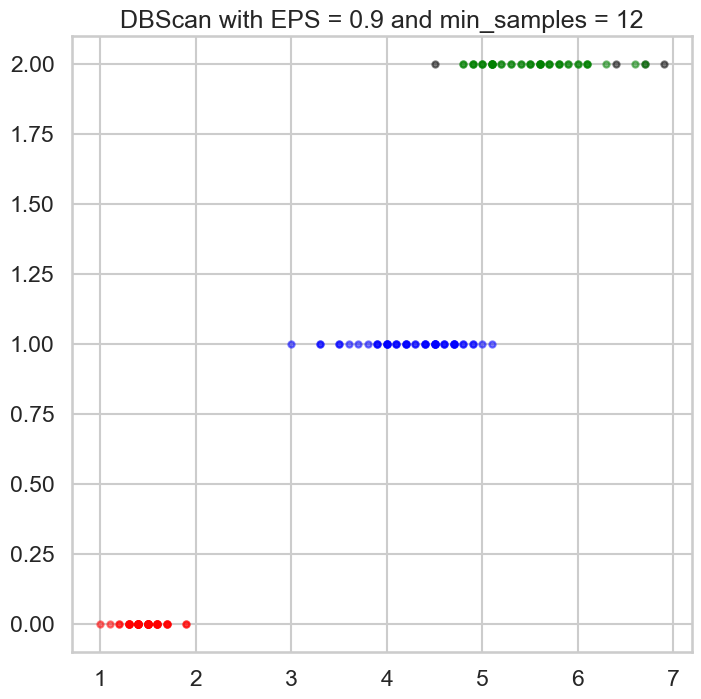

EPS: 0.9, Min Samples: 12, Silhouette Score: 0.544
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


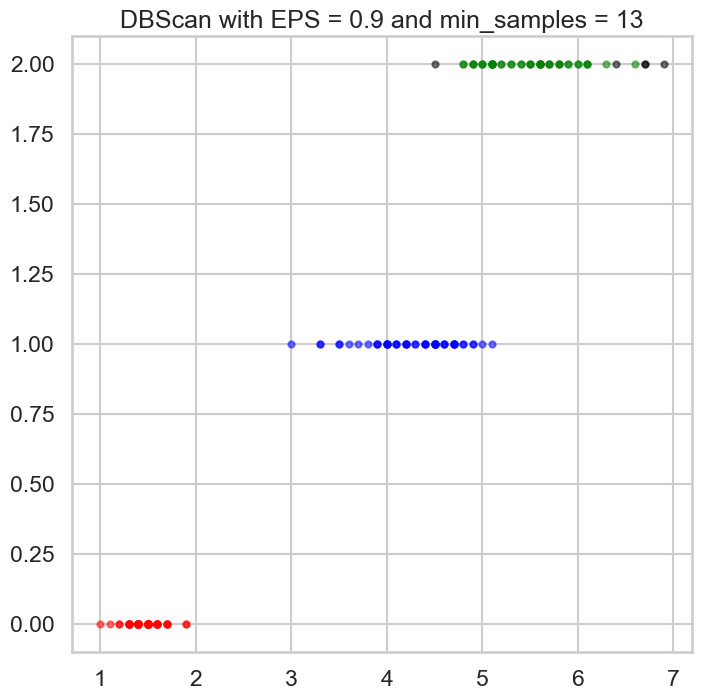

EPS: 0.9, Min Samples: 13, Silhouette Score: 0.544
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


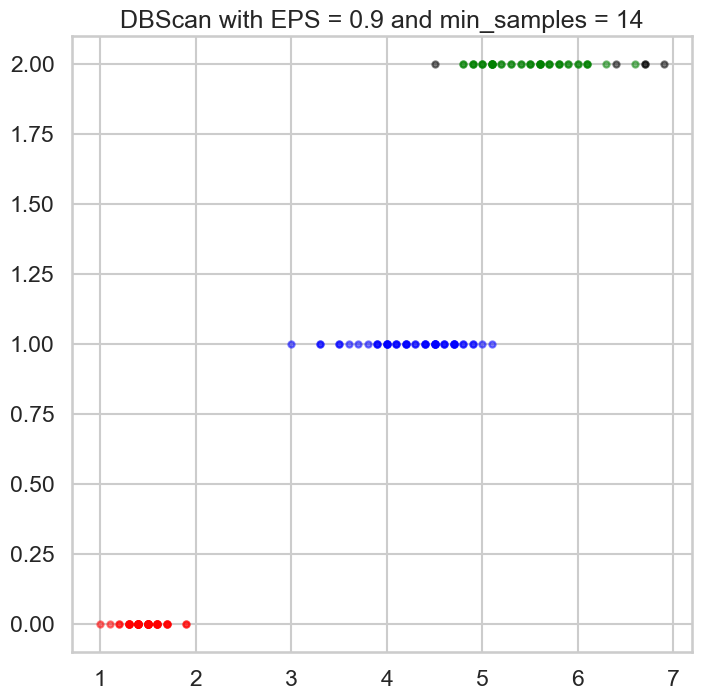

EPS: 0.9, Min Samples: 14, Silhouette Score: 0.544
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


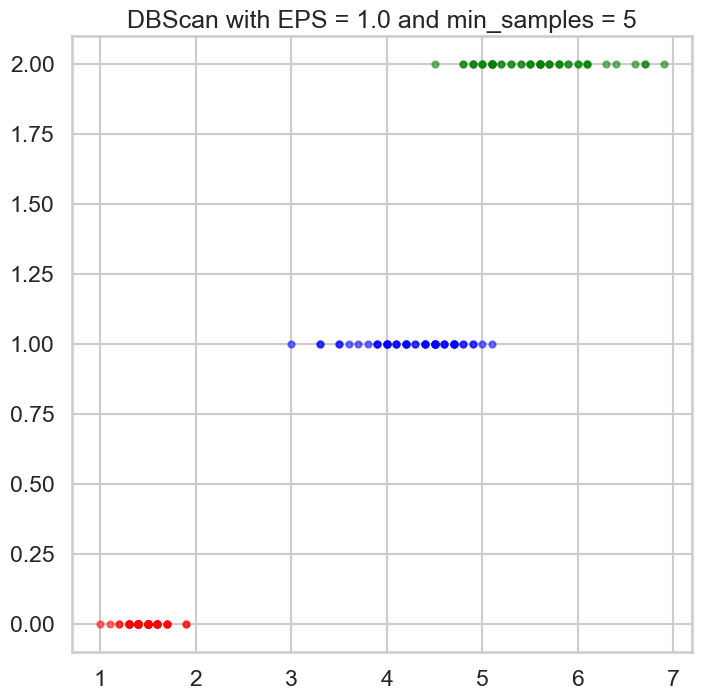

EPS: 1.0, Min Samples: 5, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


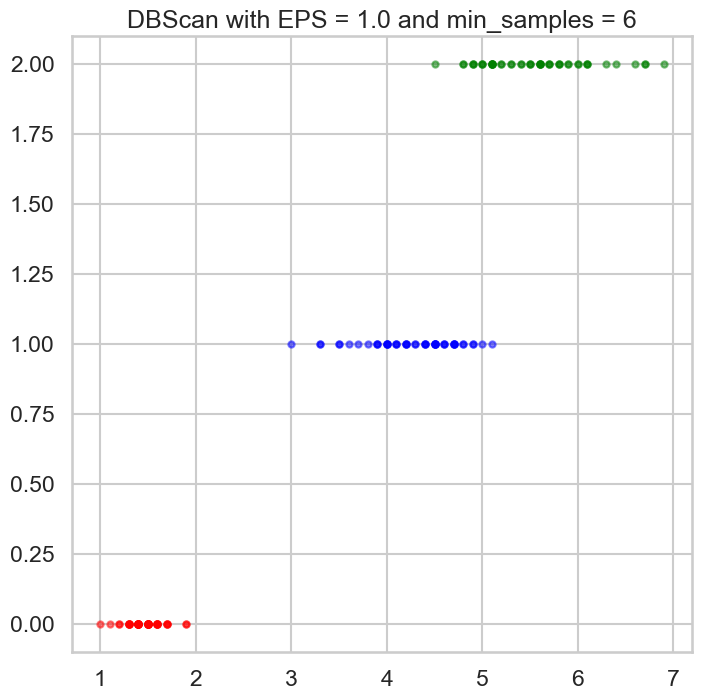

EPS: 1.0, Min Samples: 6, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


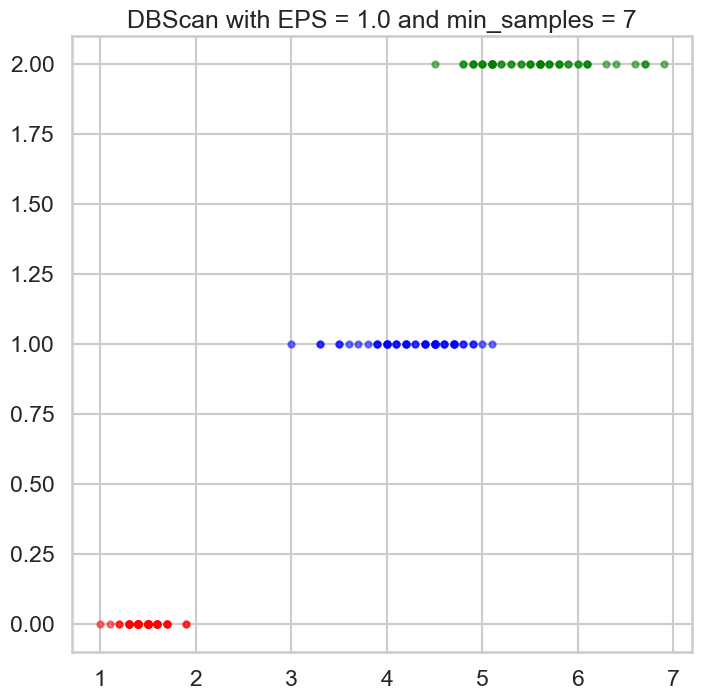

EPS: 1.0, Min Samples: 7, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


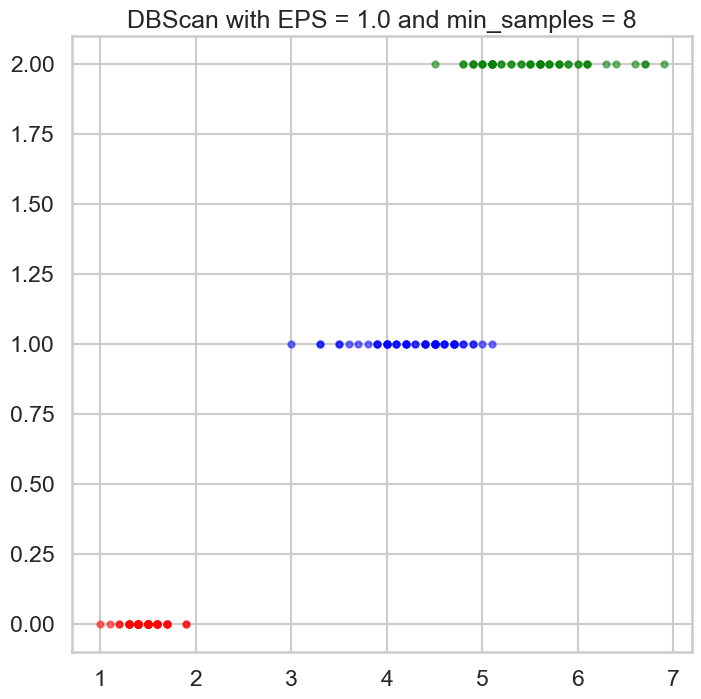

EPS: 1.0, Min Samples: 8, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


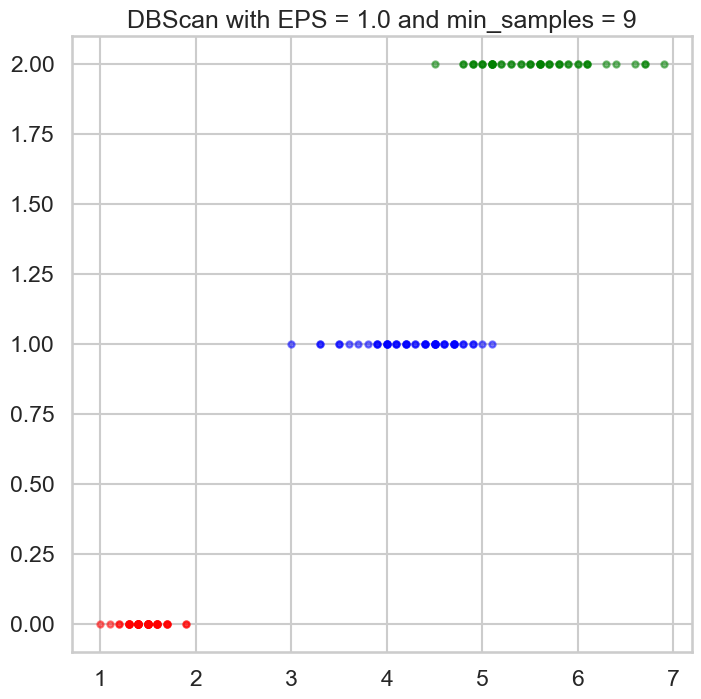

EPS: 1.0, Min Samples: 9, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


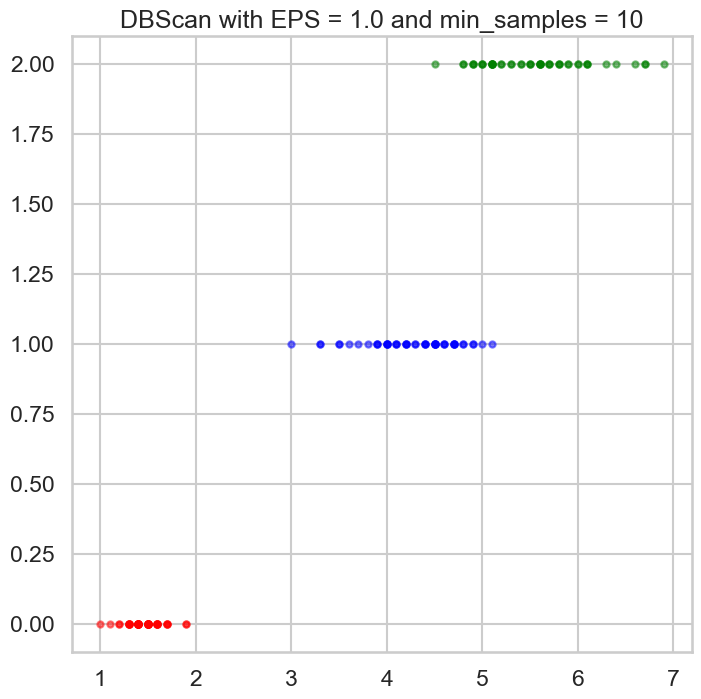

EPS: 1.0, Min Samples: 10, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


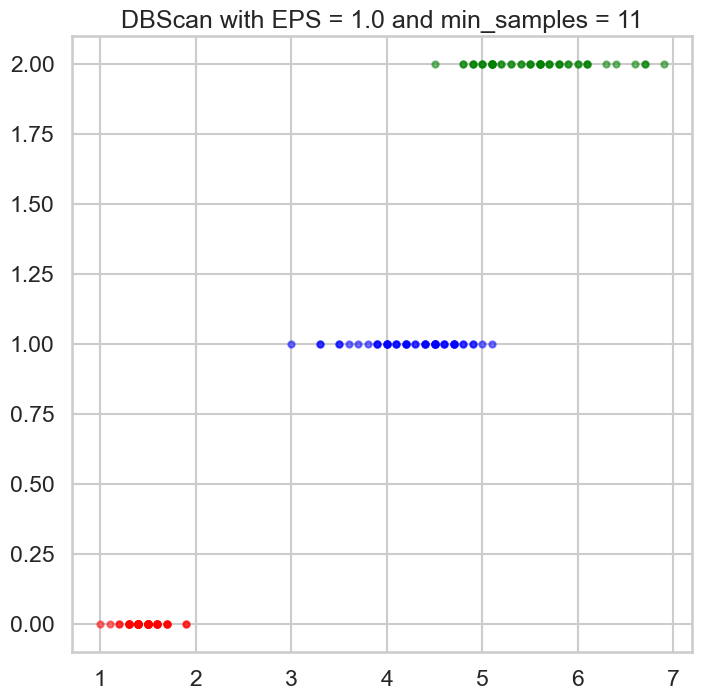

EPS: 1.0, Min Samples: 11, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


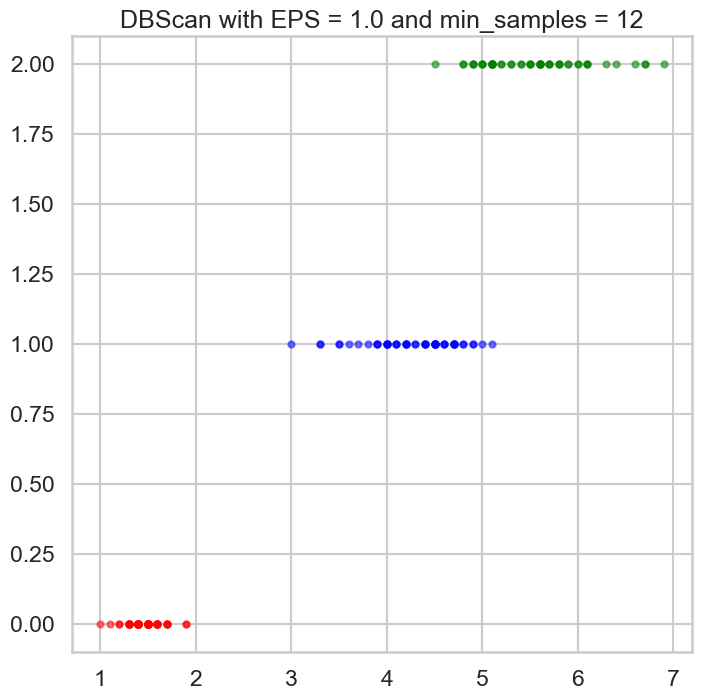

EPS: 1.0, Min Samples: 12, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


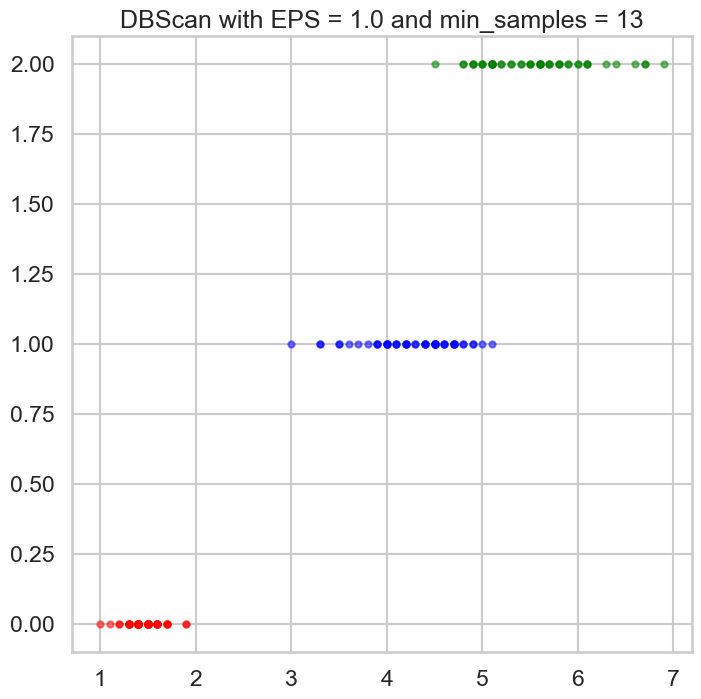

EPS: 1.0, Min Samples: 13, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


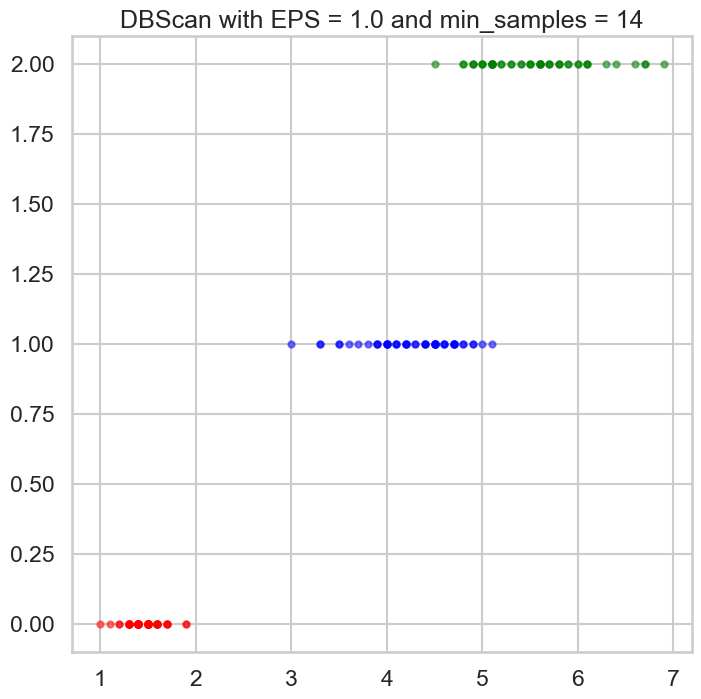

EPS: 1.0, Min Samples: 14, Silhouette Score: 0.578
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]
Best Parameters: (0.4, 12), Silhouette Score: 0.595


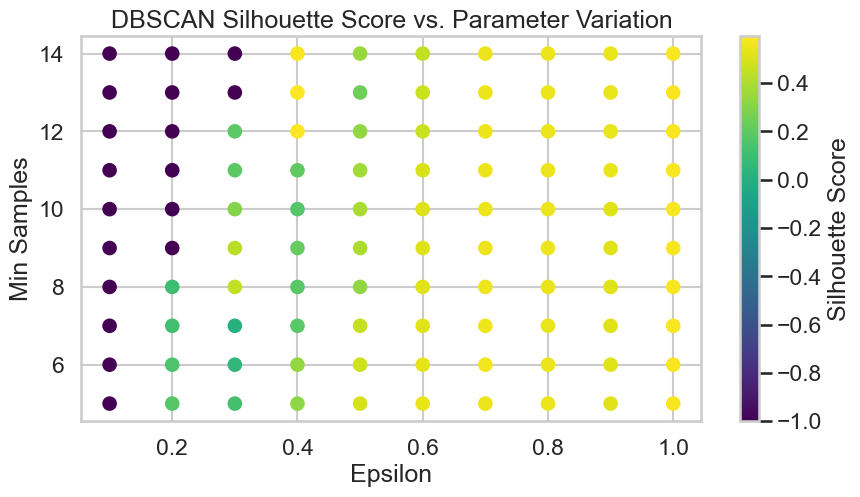

In [15]:
# Define parameters to try
eps_values = np.arange(0.1, 1.1, 0.1)
min_samples_values = range(5, 15,1)


# Store results
best_score = -1
best_params = None
all_scores = {}

# Try different parameters
for eps in eps_values:
    for min_samples in min_samples_values:
        try:
            # Perform DBSCAN clustering
            model = DBSCAN(eps=eps, min_samples=min_samples)
            model.fit(df_iris)


            
            # Compute the silhouette score for the current clustering
            labels = model.labels_
            if len(np.unique(labels)) > 1: # Skip if there's only one cluster
                score = silhouette_score(df_iris, labels)
            else:
                score = -1
            
            # Store results
            params = (eps, min_samples)
            all_scores[params] = score

            # Plot clusters
            plt.title(f'DBScan with EPS = {eps} and min_samples = {min_samples}')
            display_cluster(df_iris[['petal length (cm)', 'target']].to_numpy(copy=True), model, len(np.unique(model.labels_)))
            plt.show()

            # Print resulting clusters
            print(f'EPS: {eps}, Min Samples: {min_samples}, Silhouette Score: {score:.3f}')
            print(model.labels_)

            # Update best score
            if score > best_score:
                best_score = score
                best_params = params
        except Exception as e:
            print(f"An error occurred: {e}")
            continue

# Print best parameters and score
print(f'Best Parameters: {best_params}, Silhouette Score: {best_score:.3f}')

# Plot silhouette score versus parameter variation
scores = [score for params, score in all_scores.items()]
params = list(all_scores.keys())
eps_values = [p[0] for p in params]
min_samples_values = [p[1] for p in params]

fig, ax = plt.subplots(figsize=(10, 5))
sc = ax.scatter(eps_values, min_samples_values, c=scores, cmap='viridis')
cbar = plt.colorbar(sc)
ax.set_xlabel('Epsilon')
ax.set_ylabel('Min Samples')
cbar.ax.set_ylabel('Silhouette Score')
plt.title('DBSCAN Silhouette Score vs. Parameter Variation')
plt.show()

Silhouette score for spherical: 0.5248172494203053


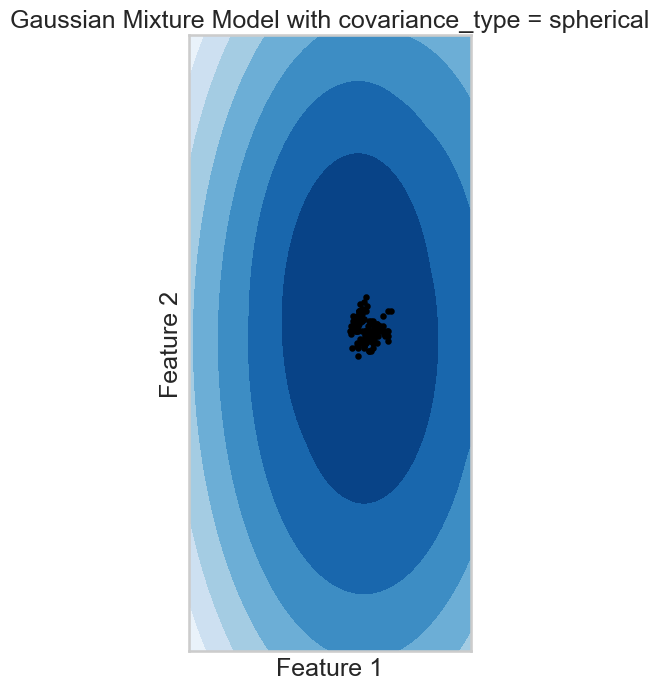

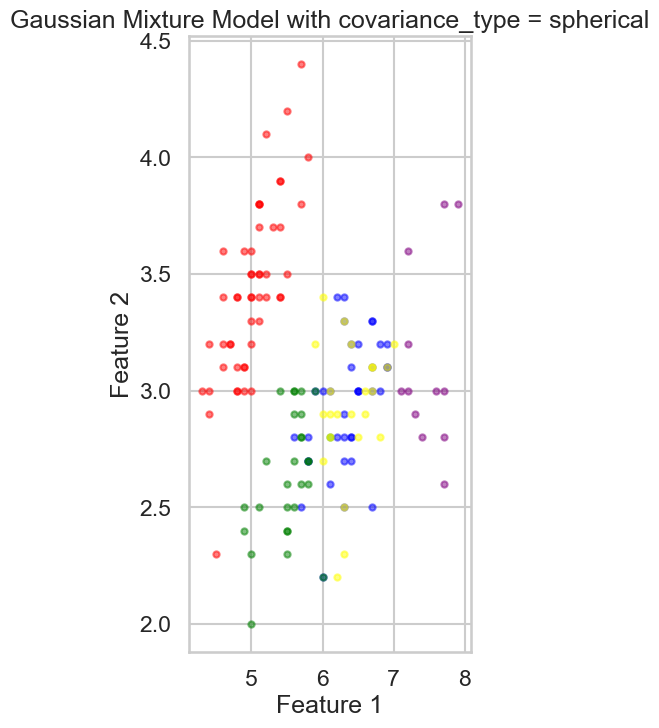

Silhouette score for diag: 0.5108701129126226


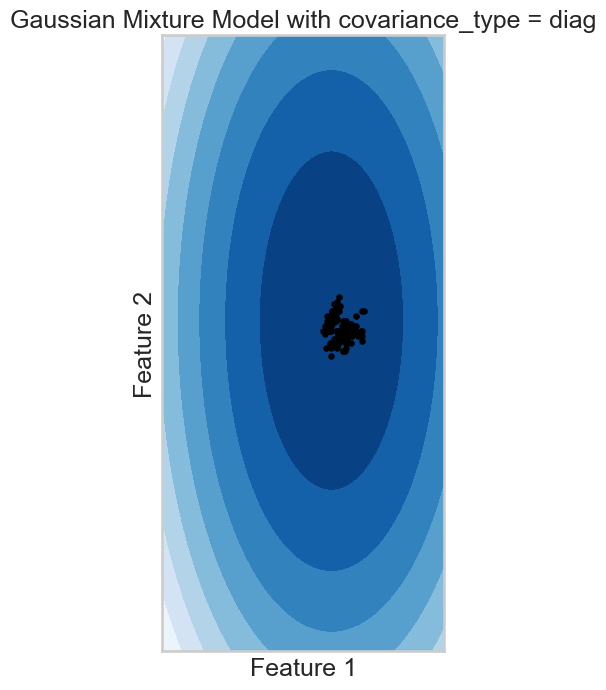

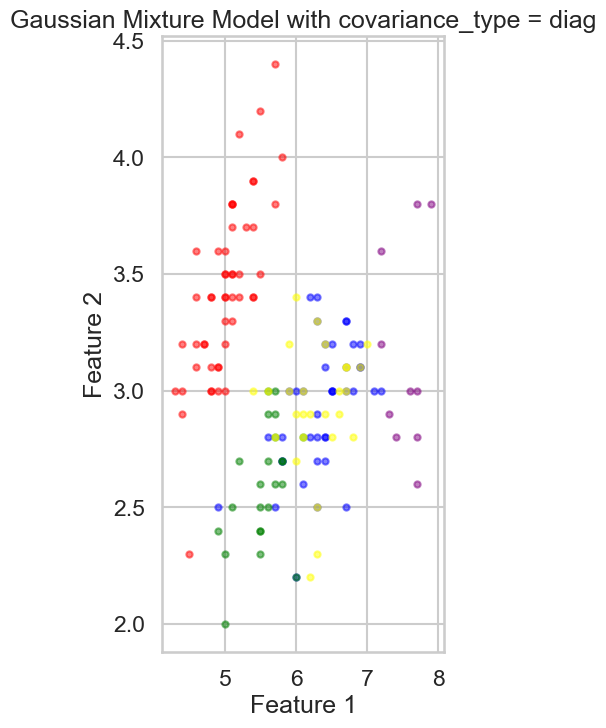

Silhouette score for tied: 0.48579970917143034


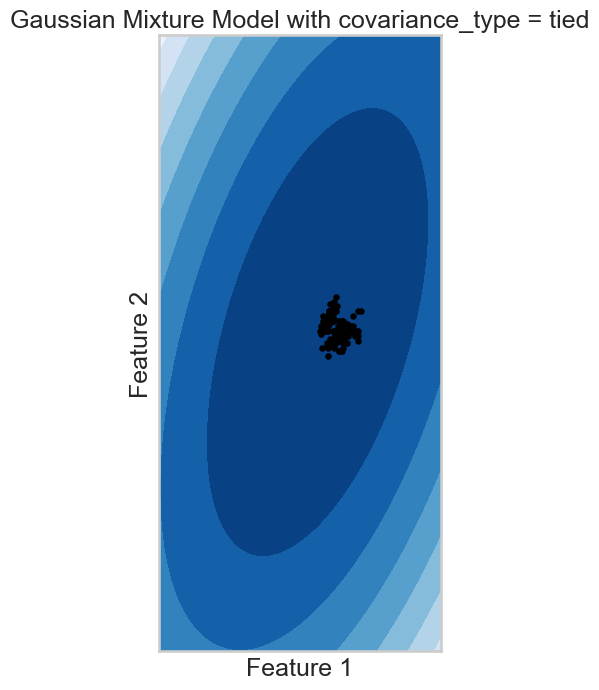

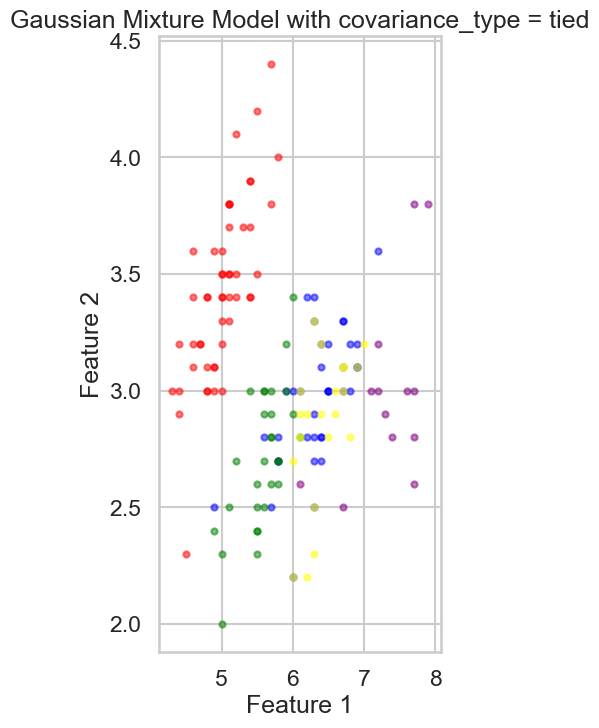

Silhouette score for full: 0.4586977350042921


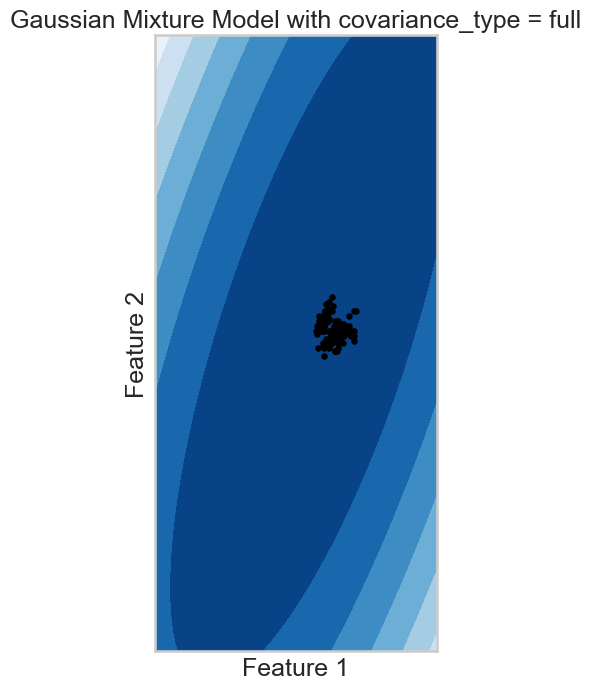

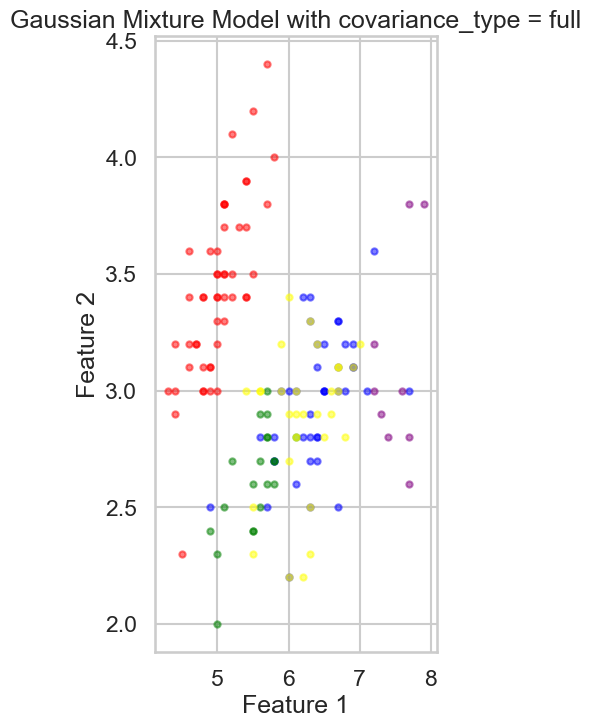

In [16]:
# Define covariance types to try
covariance_types = ['spherical', 'diag', 'tied', 'full']

# Define number of components
n_components = 5

# Loop over covariance types
for type in covariance_types:
    # Create GMM object and fit to data
    gmm = GaussianMixture(n_components=n_components, covariance_type=type, random_state=0)
    gmm.fit(df_iris)
    
    # Get silhouette score
    labels = gmm.predict(df_iris)
    score = silhouette_score(df_iris, labels)
    print(f'Silhouette score for {type}: {score}')

    # Define the grid for the contour plot
    x_min, x_max = -10, 15
    y_min, y_max = -10, 15
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = -gmm.score_samples(np.c_[xx.ravel(), yy.ravel(), np.zeros_like(xx.ravel()), np.zeros_like(xx.ravel()), np.zeros_like(xx.ravel())])
    Z = Z.reshape(xx.shape)

    # Create the contour plot
    plt.subplot(1, 2, 1)
    plt.contourf(xx, yy, Z, cmap=plt.cm.Blues_r)
    plt.scatter(df_iris.iloc[:, 0], df_iris.iloc[:, 1], s=10, color='black')
    plt.title(f'Gaussian Mixture Model with covariance_type = {type}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xticks(())
    plt.yticks(())
    plt.show()


    # Display the scatter plot with highlighted clusters
    plt.subplot(1, 2, 2)
    display_cluster_gmm(df_iris.iloc[:, :5].to_numpy(copy=True), gmm=gmm, num_clusters=n_components)
    plt.title(f'Gaussian Mixture Model with covariance_type = {type}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    
    plt.show()


# Normalized data


In [17]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df_iris_norm = pd.DataFrame(scaler.fit_transform(df_iris))
df_iris_norm.columns = ['sepal length (cm)', 'sepal width (cm)', 'petal length (cm)','petal width (cm)', 'target']

KMeans(n_clusters=1)
KMeans(n_clusters=2)
KMeans(n_clusters=3)
KMeans(n_clusters=4)
KMeans(n_clusters=5)
KMeans(n_clusters=6)
KMeans(n_clusters=7)
KMeans()
KMeans(n_clusters=9)
KMeans(n_clusters=10)


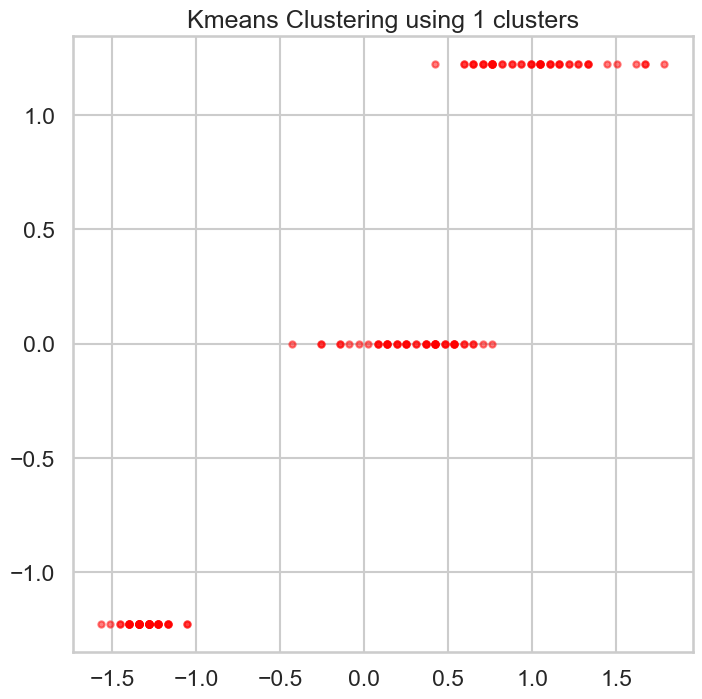

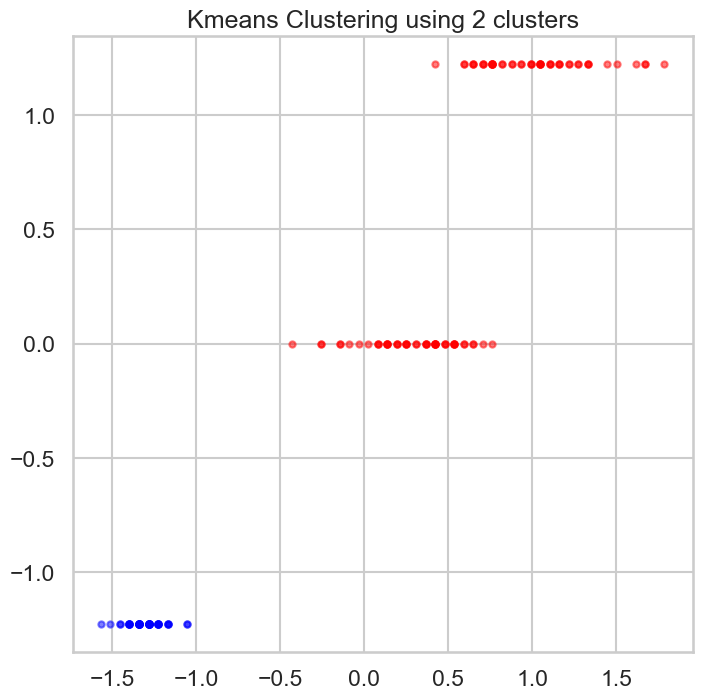

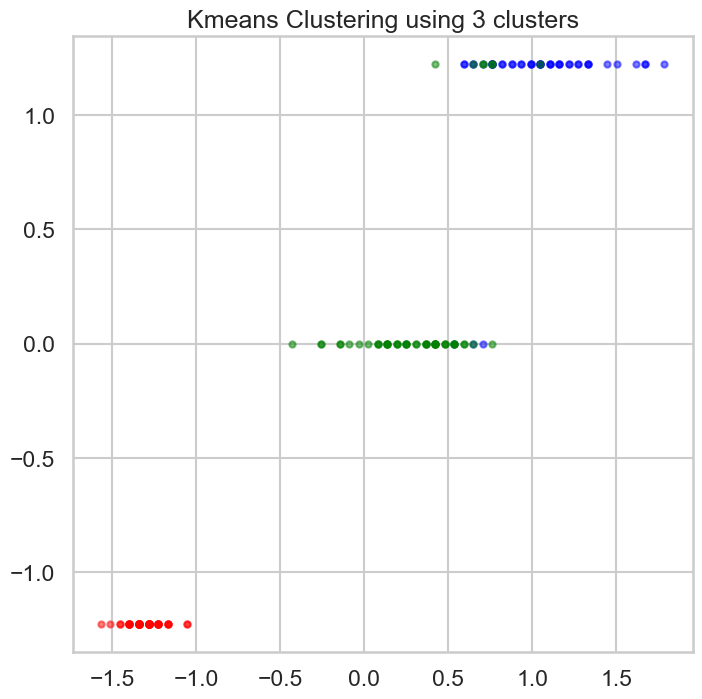

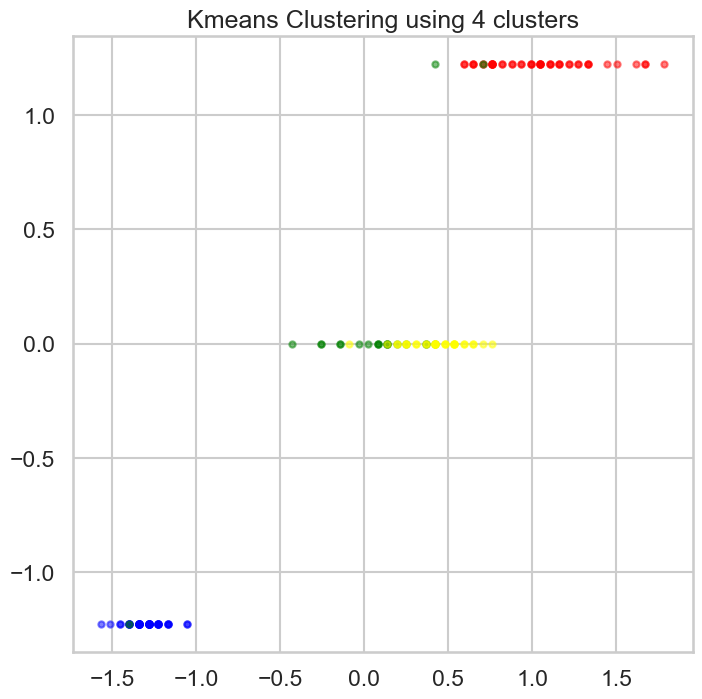

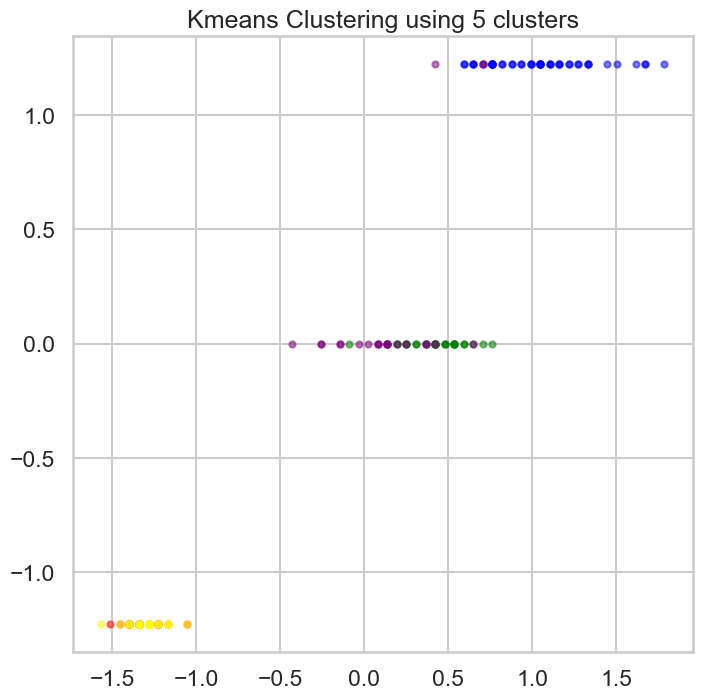

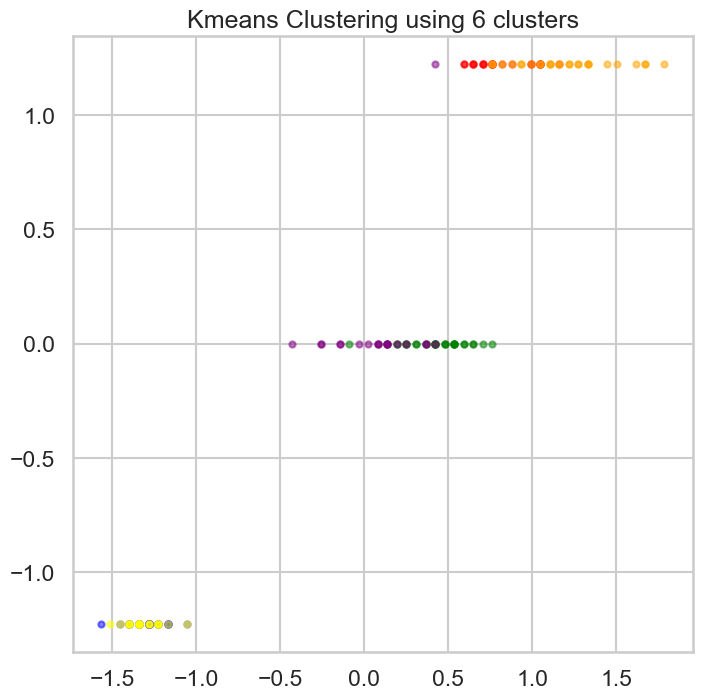

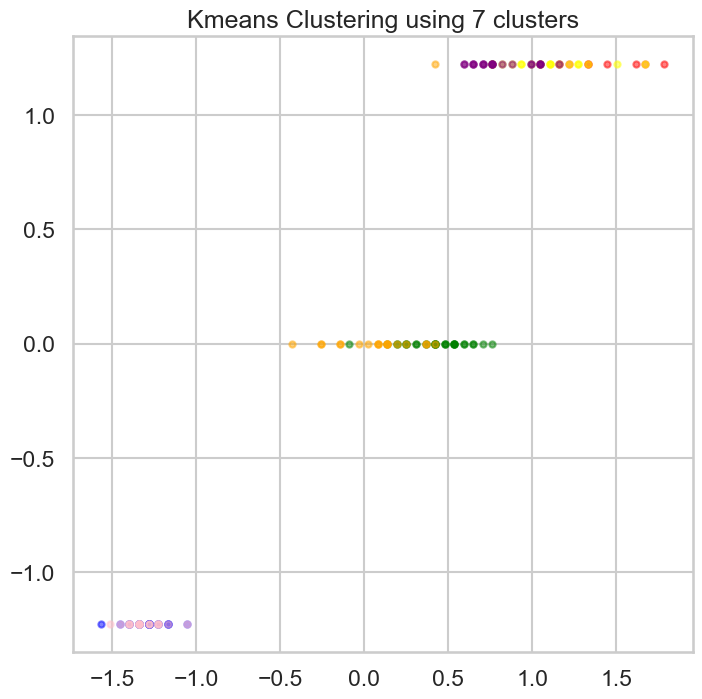

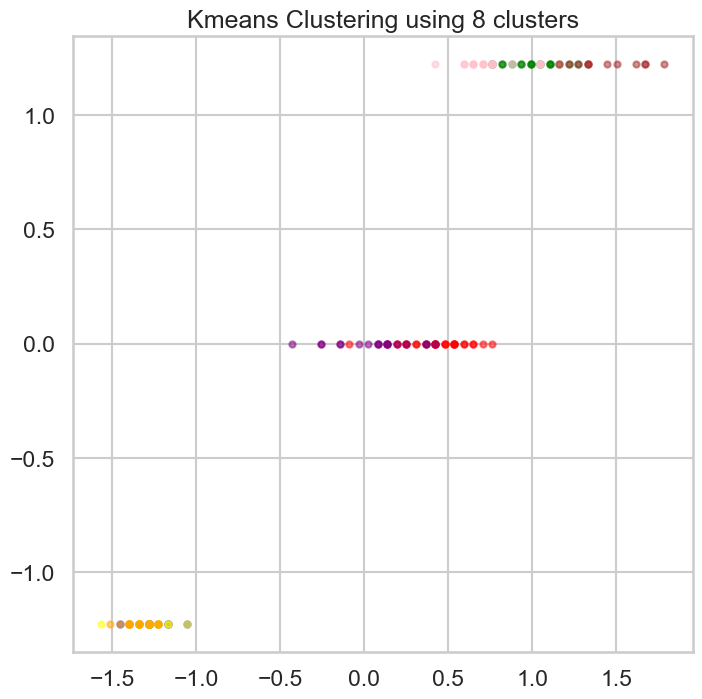

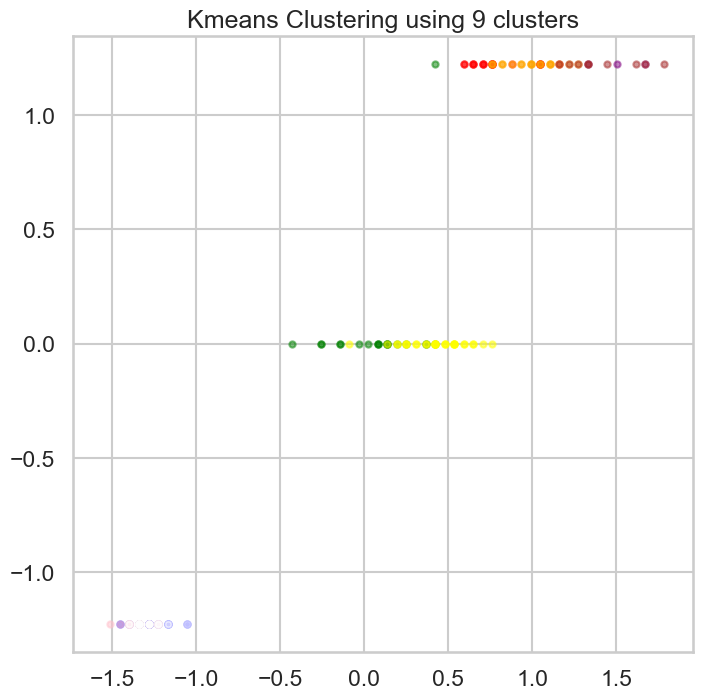

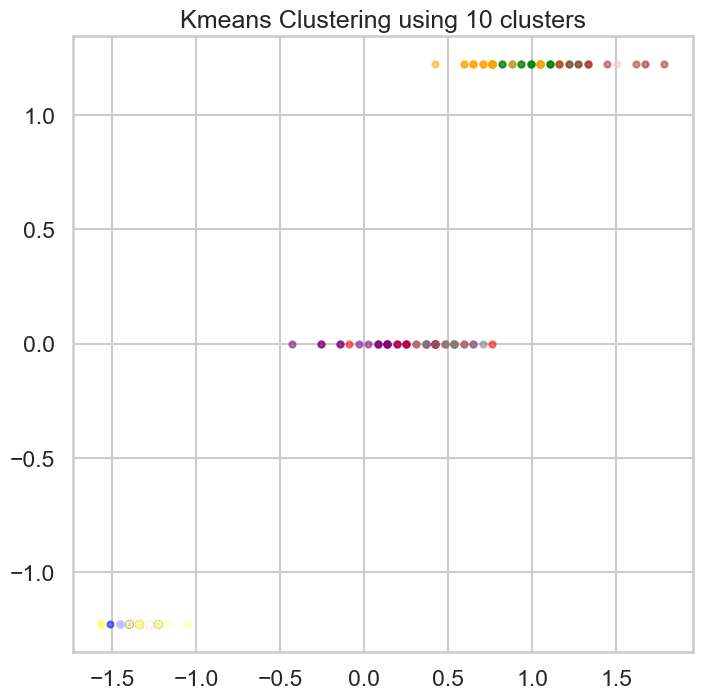

In [18]:
Kmeans_output = []

for i in range(10):
    km = kmeans(df_iris_norm, i+1)
    
    print(km)

    plt.figure()
    plt.title(f'Kmeans Clustering using {i+1} clusters')
    display_cluster(df_iris_norm[['petal length (cm)', 'target']].to_numpy(copy=True), km, i+1)
    
    Kmeans_output.append(km)

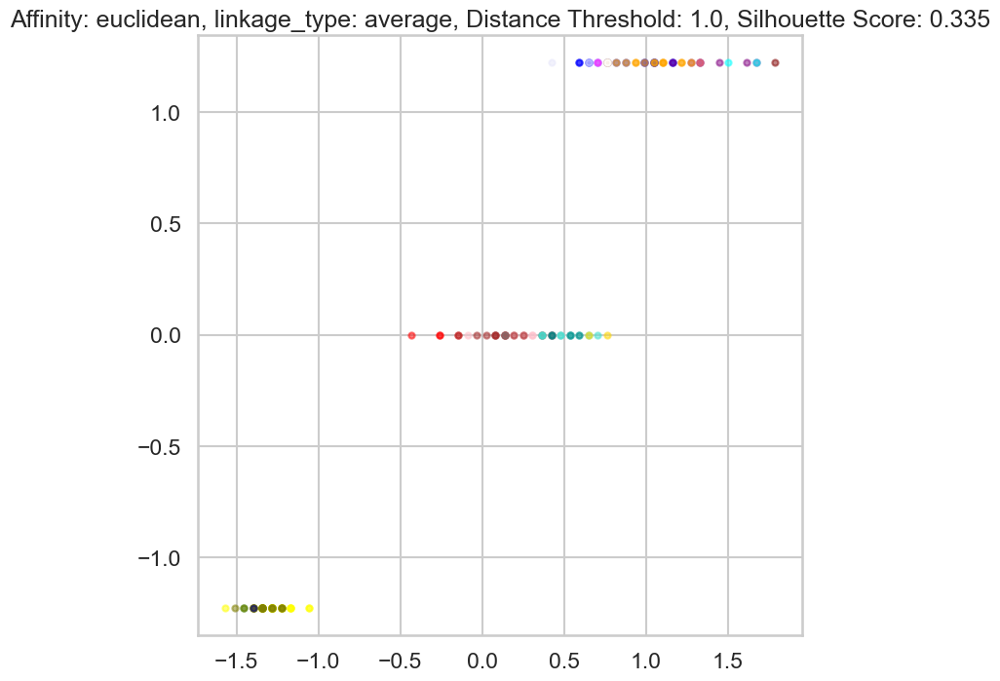

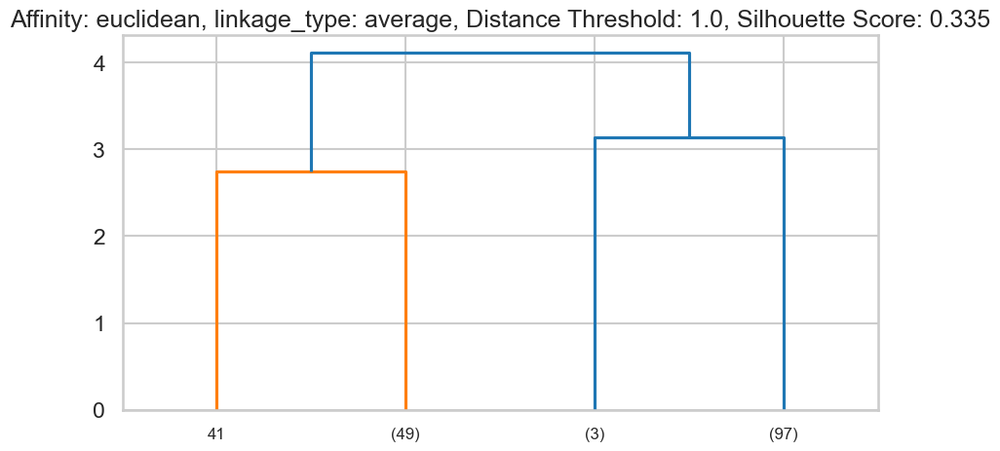

Affinity: euclidean, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.335
[ 3 13 13 13  3  3  3  3 13 13  3  3 13 13  2  2  3  3  3  3  3  3  3  3
  3 13  3  3  3 13 13  3  2  2 13 13  3  3 13  3  3 15 13  3  3 13  3 13
  3 13 12 16 12  7 12  6 16  0 12  7  0  6  9  6  6 12  6  7  9  7 16  6
 19  6  6 12 12 12  6  7  7  7  7 19  6 16 12  9  6  7  7  6  7  0  7  6
  6  6  0  6  5  8  5  1  1  4 17  4  1 18  5  1  5  8  8  5  1 10 14 11
  5  8  4  1  5  4  1  1  1  4  4 10  1  1  1  4  5  1  1  5  5  5  8  5
  5  5  1  1  5  1]


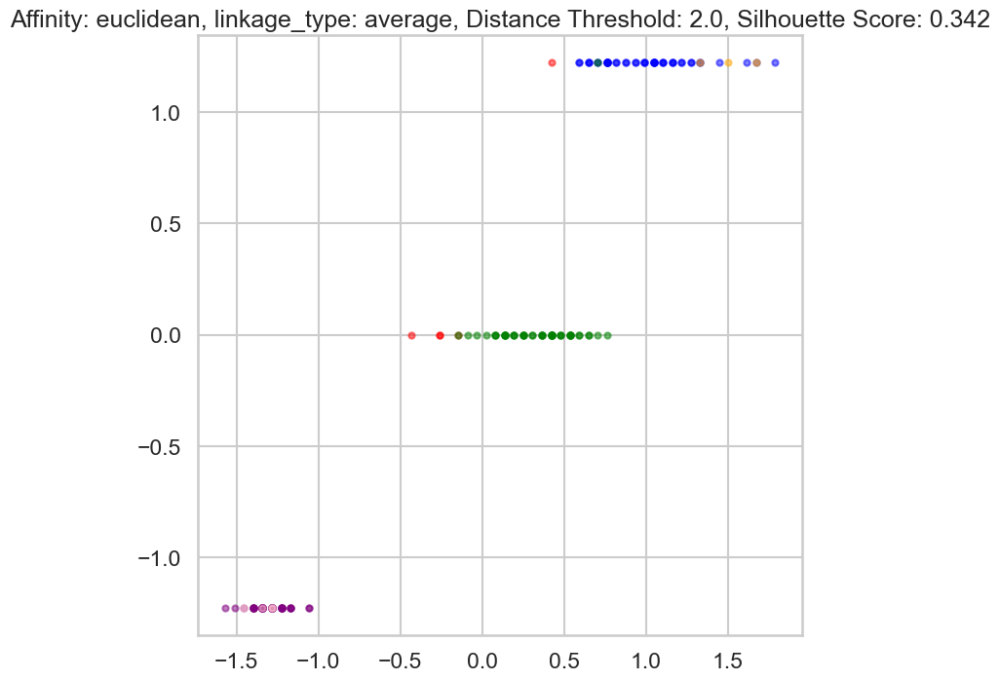

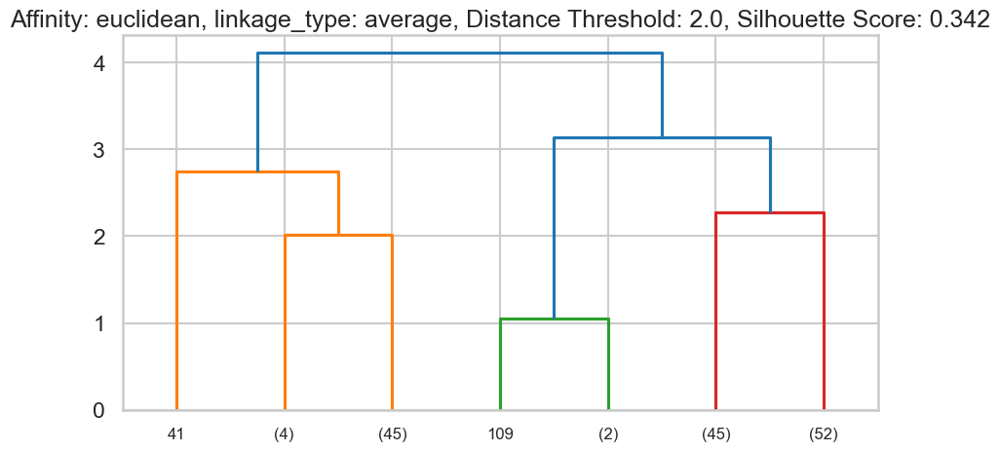

Affinity: euclidean, linkage_type: average, Distance Threshold: 2.0, Silhouette Score: 0.342
[4 4 4 4 4 4 4 4 4 4 4 4 4 4 6 6 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 6 6 4 4 4
 4 4 4 4 3 4 4 4 4 4 4 4 4 2 2 2 2 2 2 2 0 2 2 0 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 2 2 2 2 0 2 1 1 1 1 1 1 0 1 1 5 1
 1 1 1 1 1 1 5 1 2 1 1 1 1 1 1 1 1 1 1 1 5 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]


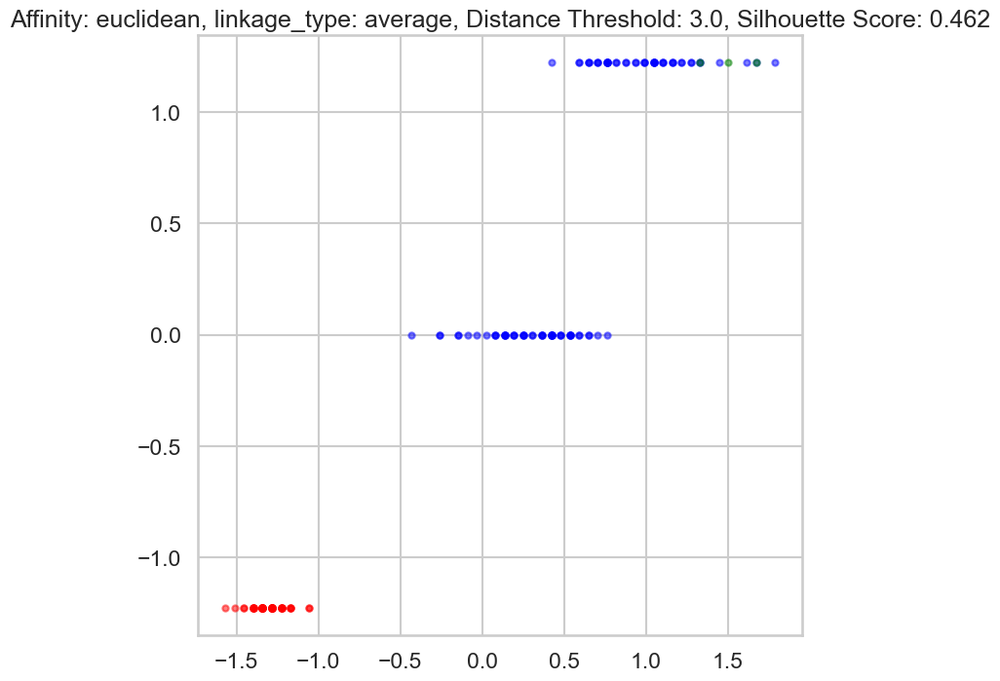

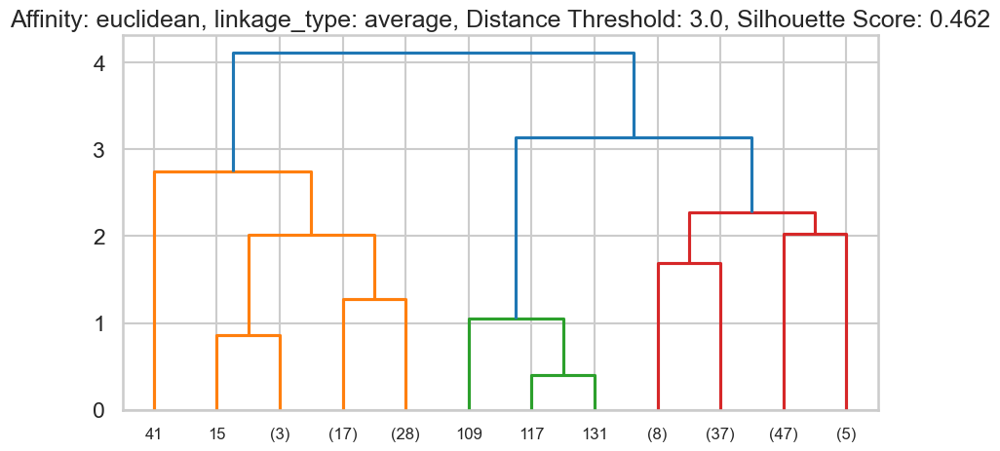

Affinity: euclidean, linkage_type: average, Distance Threshold: 3.0, Silhouette Score: 0.462
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1
 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1]


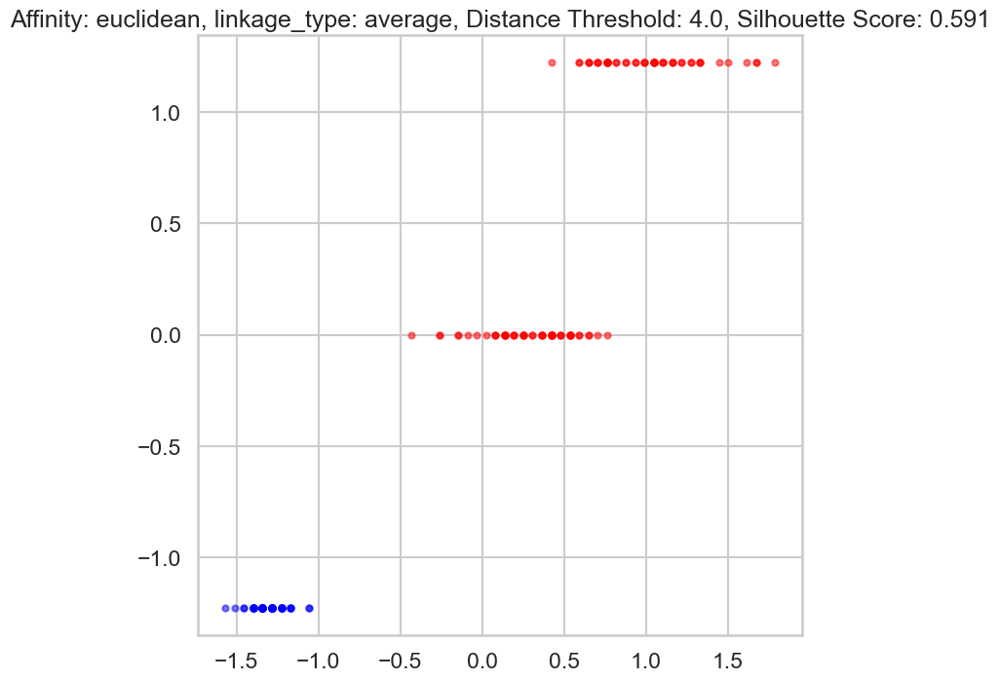

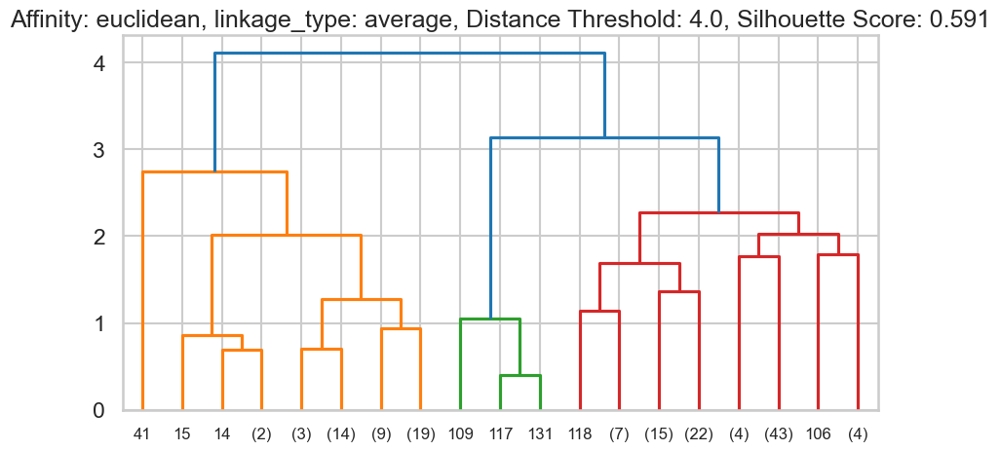

Affinity: euclidean, linkage_type: average, Distance Threshold: 4.0, Silhouette Score: 0.591
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


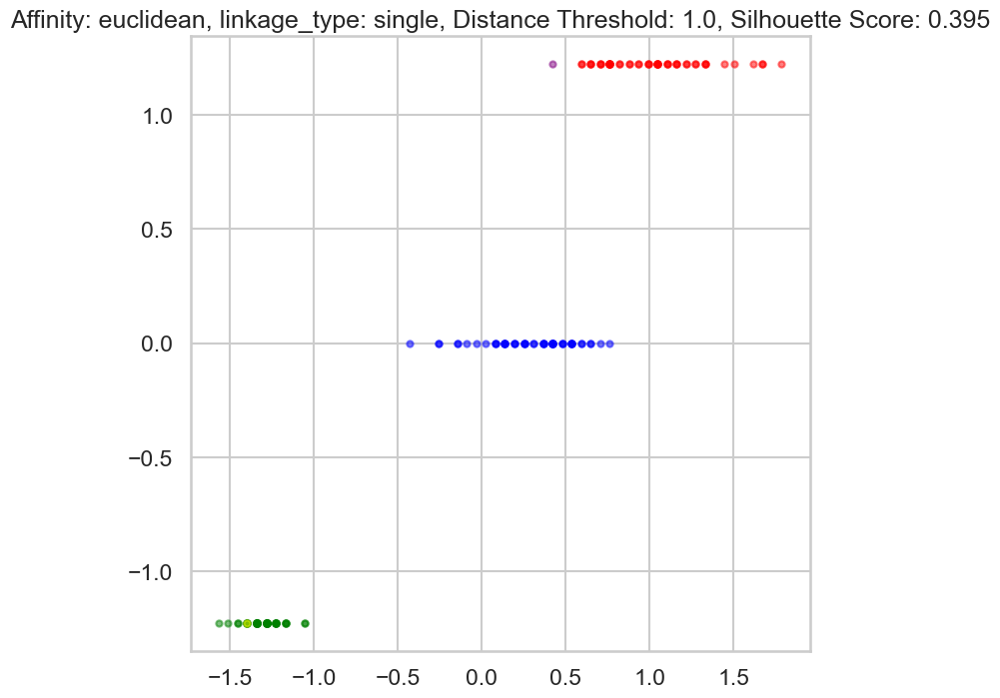

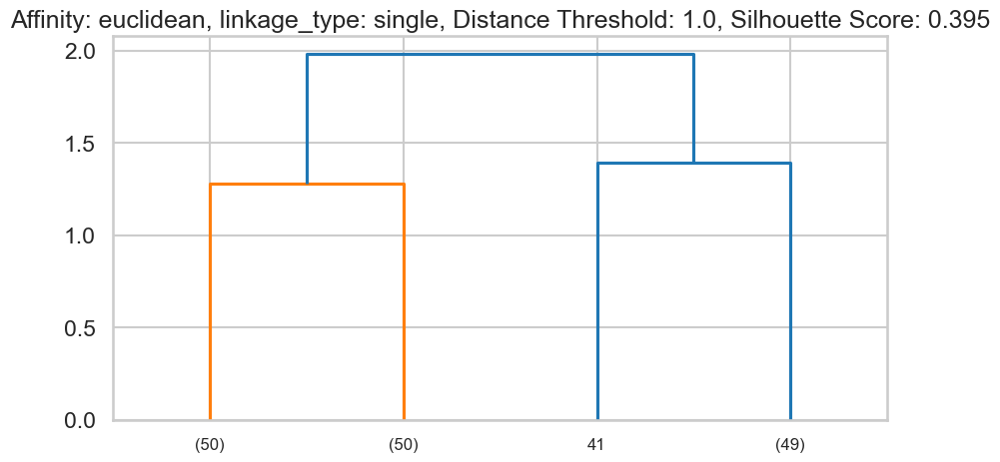

Affinity: euclidean, linkage_type: single, Distance Threshold: 1.0, Silhouette Score: 0.395
[2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 3 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 4 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


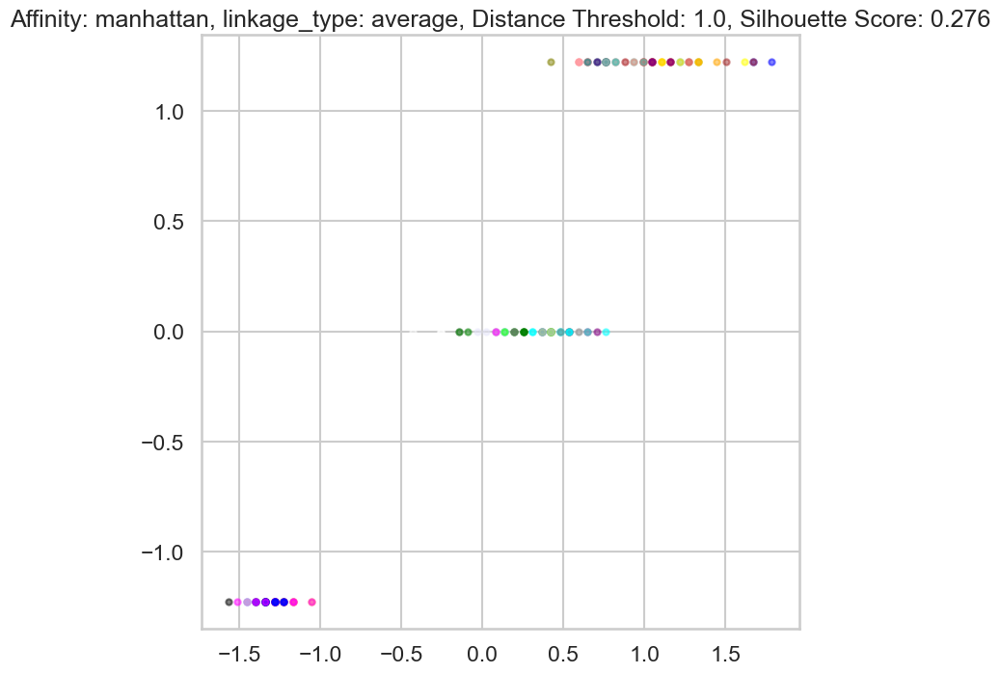

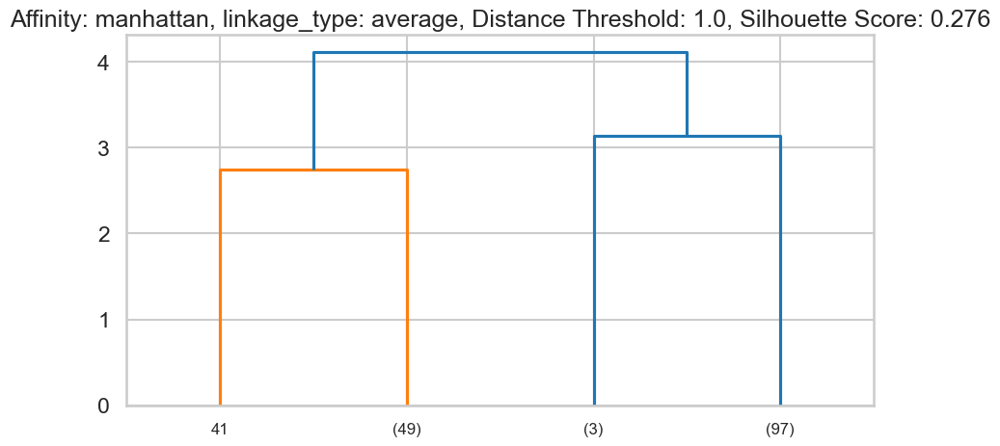

Affinity: manhattan, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.276
[ 5 30 30 30  5 11  5  5 40 30 11  5 30 40 35 25 11  5 11 11  5 11 28  5
  5 30  5  5  5 30 30  5 15 15 30 30  5  5 40  5  5 23 30  5 11 30 11 30
 11 30  4  3  4 17 38  2  3  8 10 27 31  2 21 10  2  4  2  9 22 17 37 10
 41 10 10 10 38  4 10  9 17 17  9 39  2  3  4 22  2 17  9 10  9  8  2  2
  2 10  8  2 18 16 12  0 33 32 42 34 26 13  7  6 12 16 20  7  0 36  1 24
 19 16  1  6 19 14  6  0 33 14 34 36 33  6 29 32 18  0  0 12 12 12 16 19
 19 12  6  7 18  0]


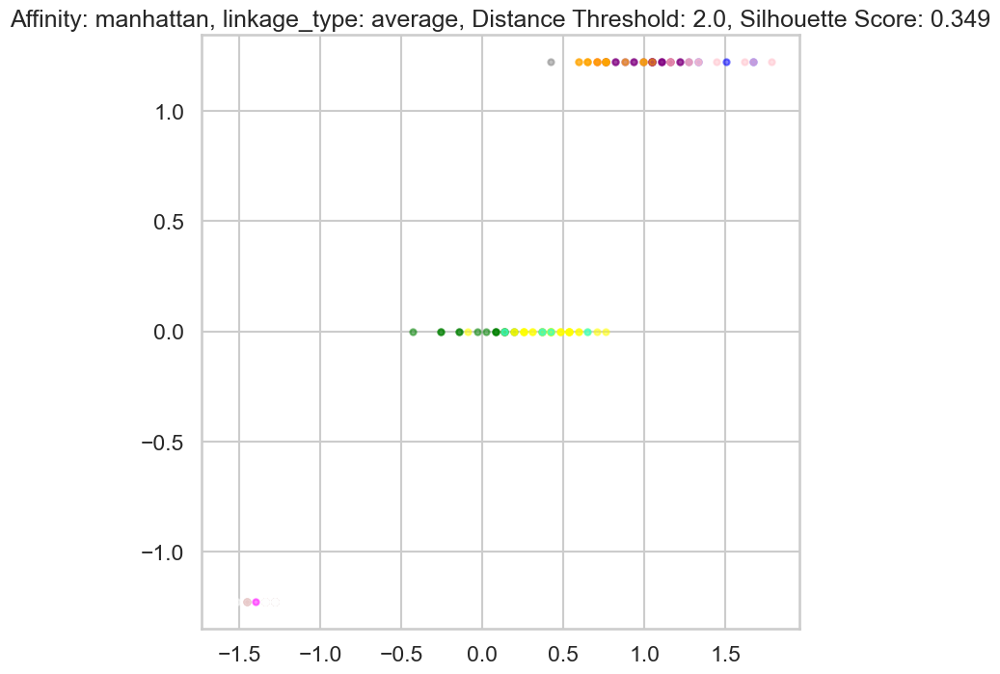

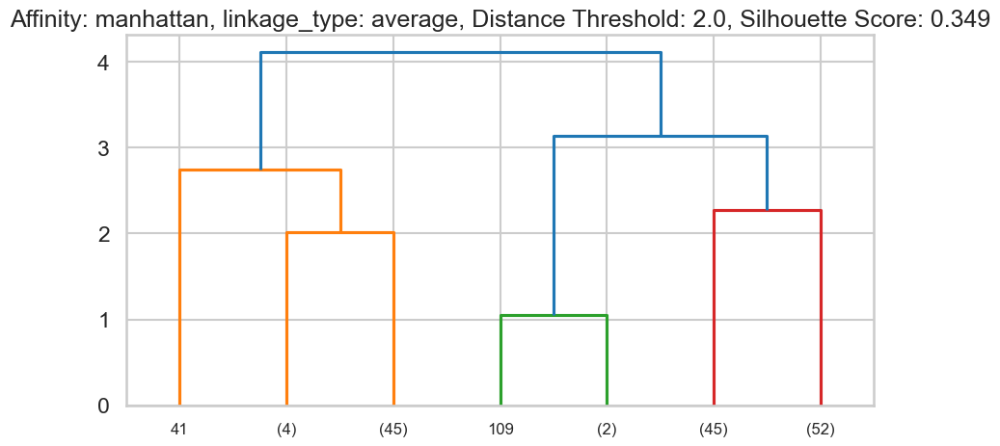

Affinity: manhattan, linkage_type: average, Distance Threshold: 2.0, Silhouette Score: 0.349
[ 8  8  8  8  8  8  8  8  8  8  8  8  8  8  7  7  8  8  8  8  8  8  8  8
  8  8  8  8  8  8  8  8  7  7  8  8  8  8  8  8  8 11  8  8  8  8  8  8
  8  8  3  3  3  2  3  3  3  2  3  2  2  3 10  3  3  3  3  2 10  2  3  3
 10  3  3  3  3  3  3  2  2  2  2  3  3  3  3 10  3  2  2  3  2  2  3  3
  3  3  2  3  4  5  4  5  4  6  9  6  0  1  4  5  4  5  5  4  5  1  6  0
  4  5  6  5  4  6  5  5  4  6  6  1  4  5  0  6  4  5  5  4  4  4  5  4
  4  4  5  4  4  5]


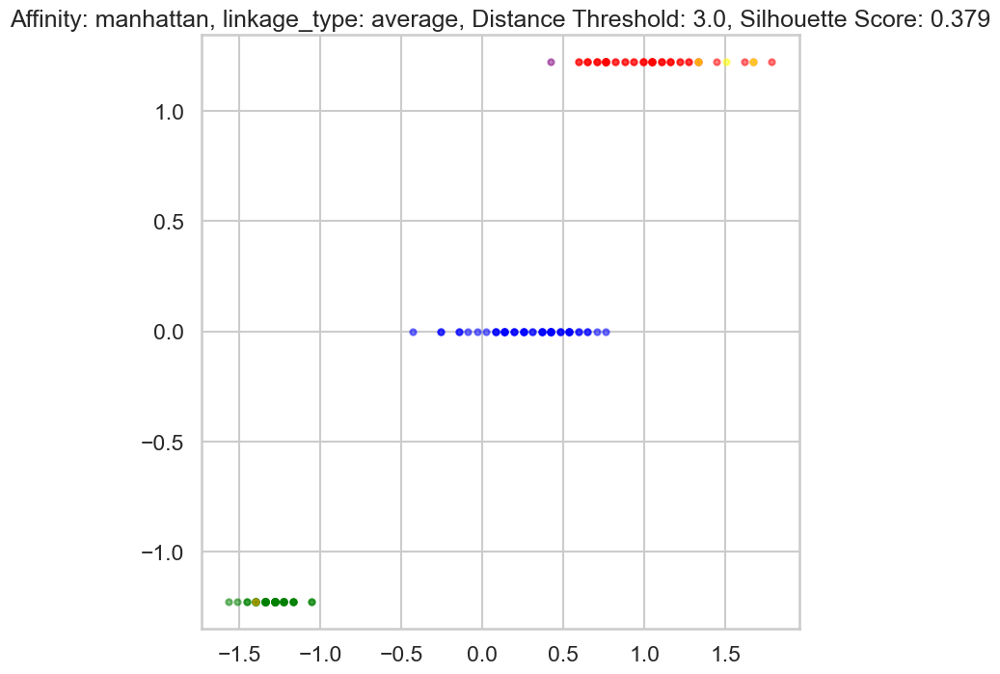

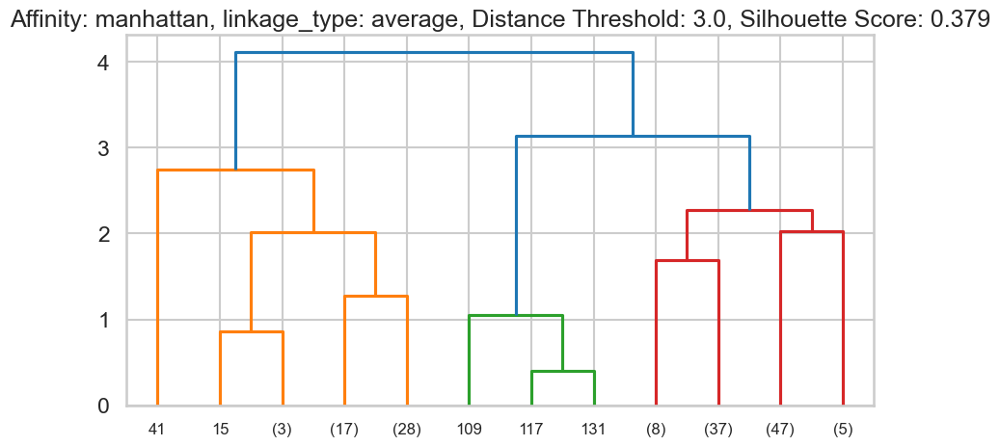

Affinity: manhattan, linkage_type: average, Distance Threshold: 3.0, Silhouette Score: 0.379
[2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 5 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 4 0 0 3 0
 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


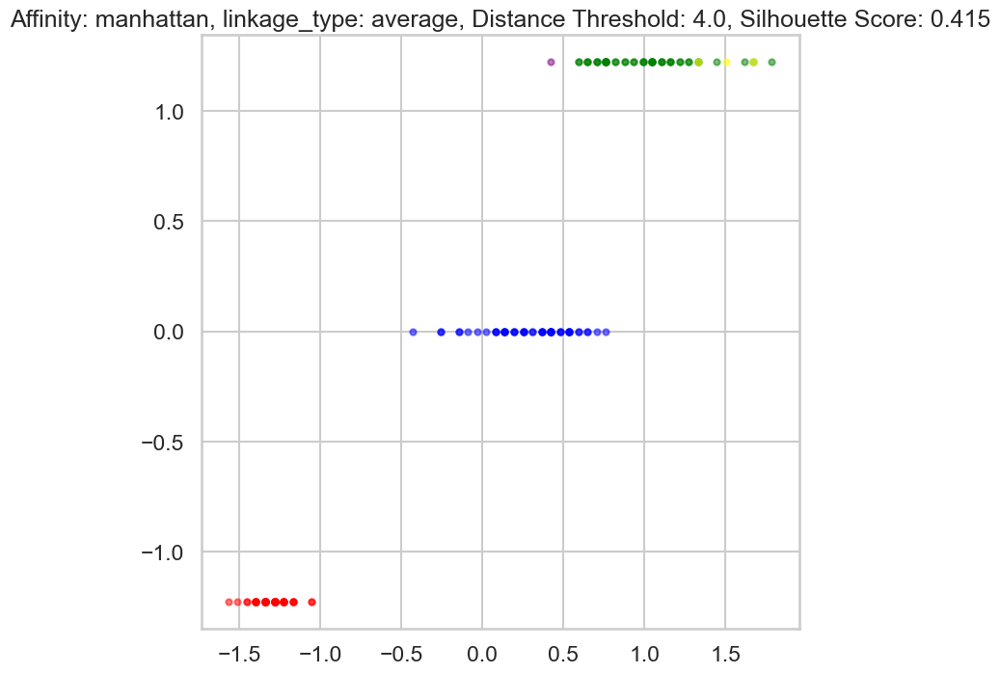

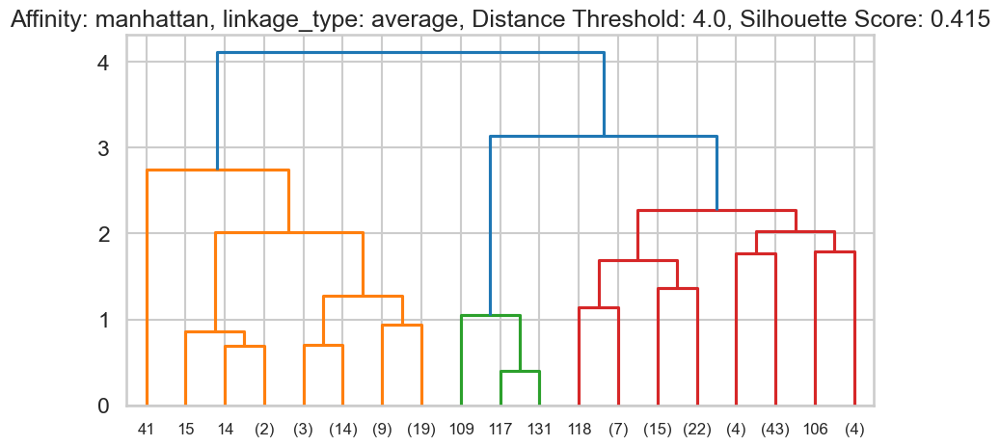

Affinity: manhattan, linkage_type: average, Distance Threshold: 4.0, Silhouette Score: 0.415
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 4 2 2 3 2
 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2]


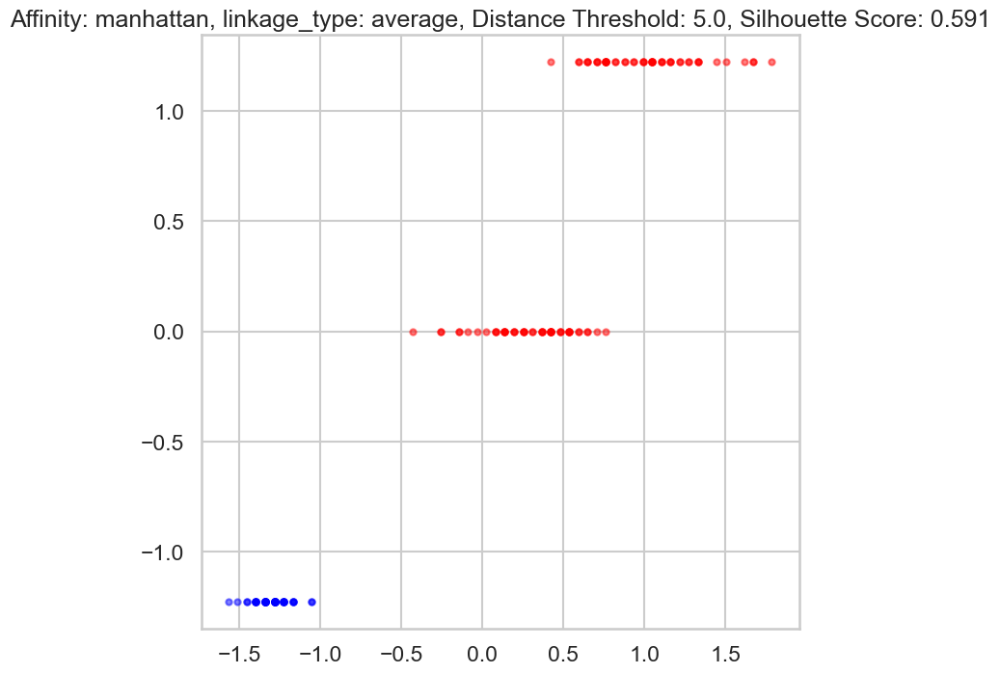

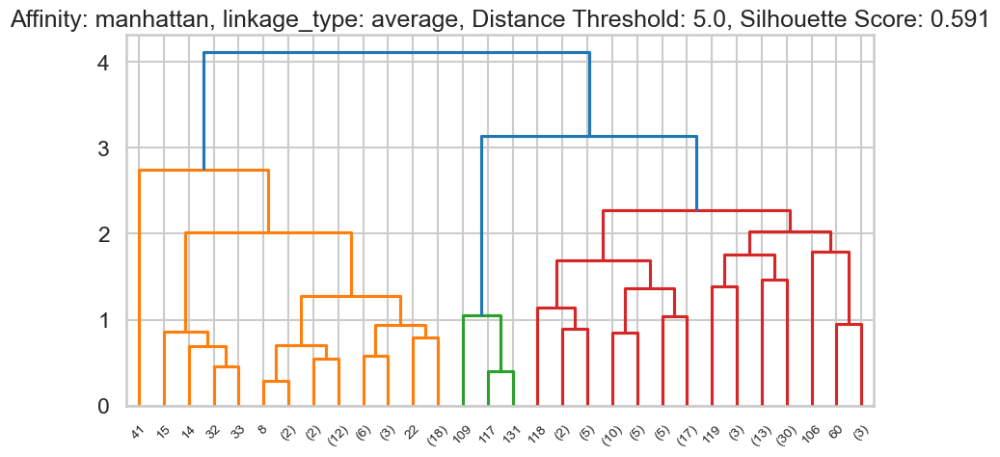

Affinity: manhattan, linkage_type: average, Distance Threshold: 5.0, Silhouette Score: 0.591
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


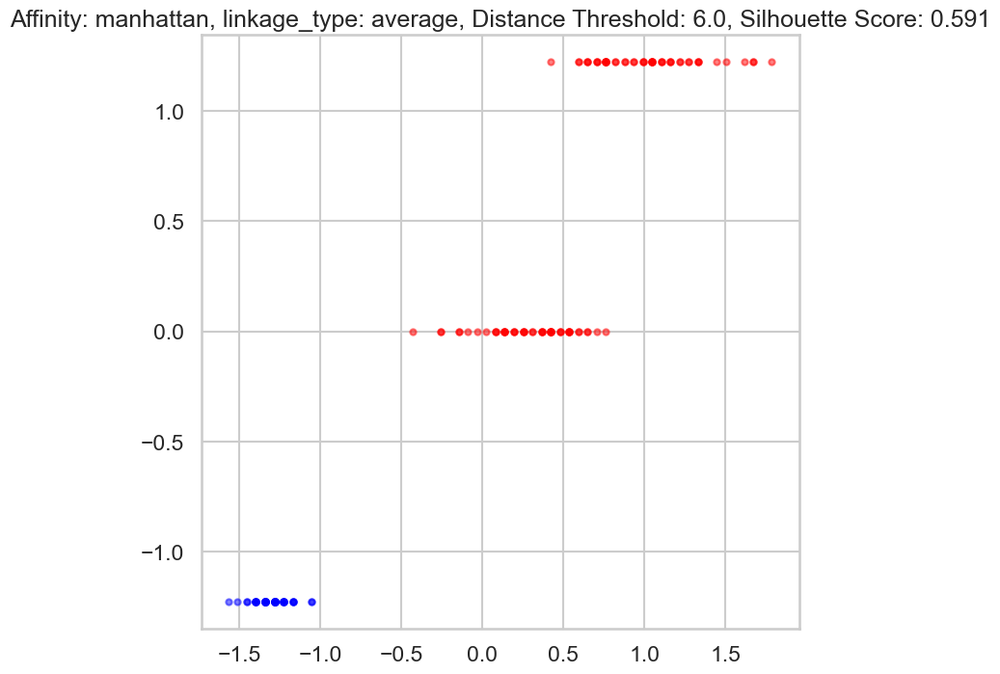

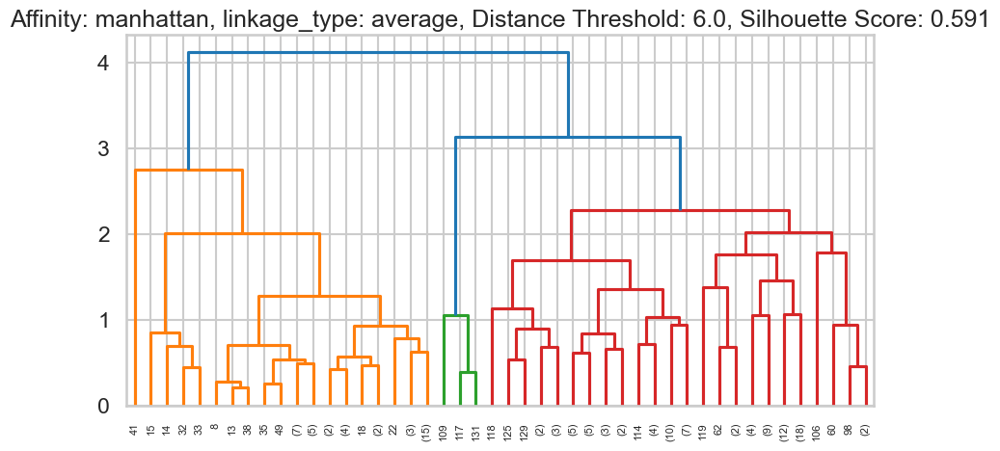

Affinity: manhattan, linkage_type: average, Distance Threshold: 6.0, Silhouette Score: 0.591
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


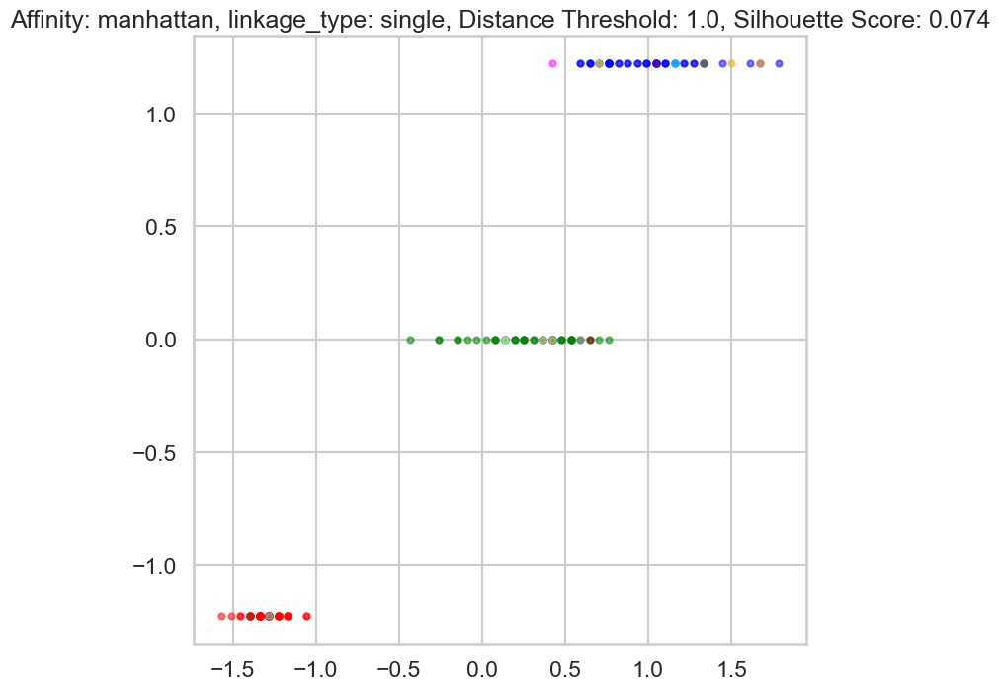

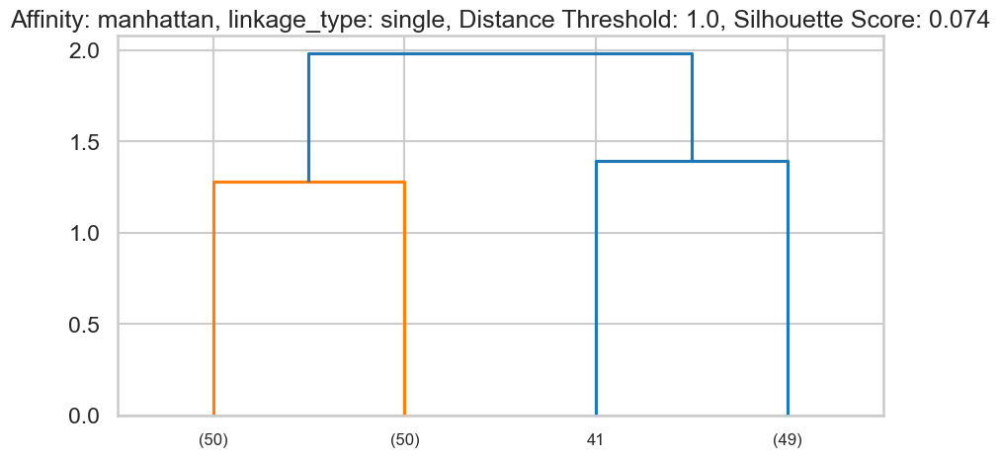

Affinity: manhattan, linkage_type: single, Distance Threshold: 1.0, Silhouette Score: 0.074
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 12  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  7  0  0  0  0  0  0
  0  0  2  2  2  2  2  2  2  2  2  2  2  2  8  2  2  2  2  2  6  2  9  2
 14  2  2  2  2  2  2  2  2  2  2  2  2  2  2  6  2  2  2  2  2  2  2  2
  2  2  2  2  1  1  1  1  1  1 11  1 10 13  1  1  1  1  1  1  1  5  1  3
  1  1  1  1  1  1  1  1  1  1  1  5  1  1  4  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1]


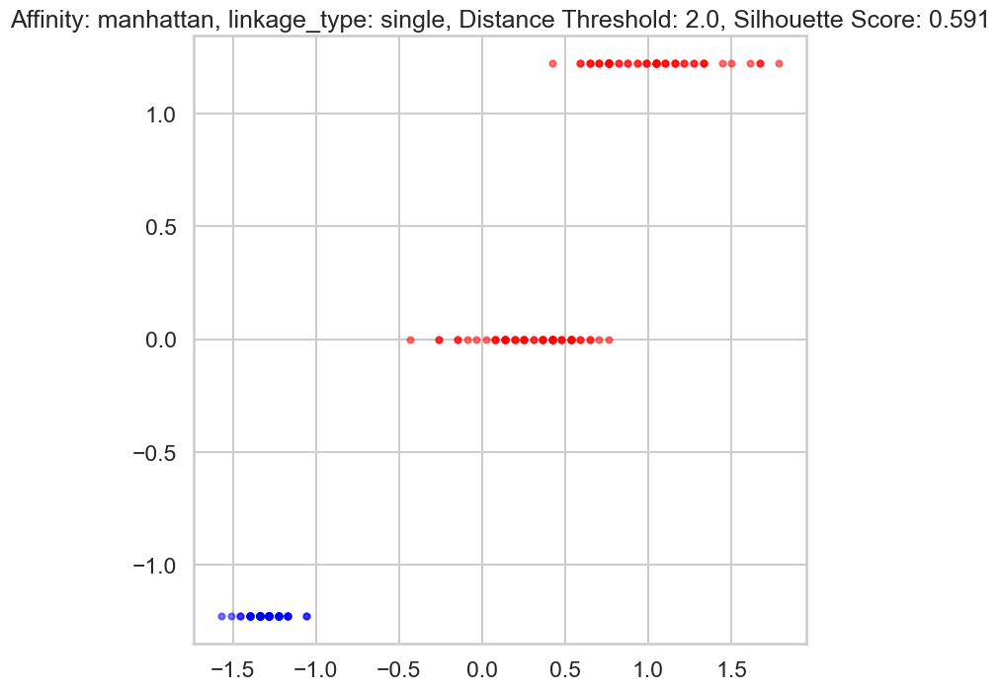

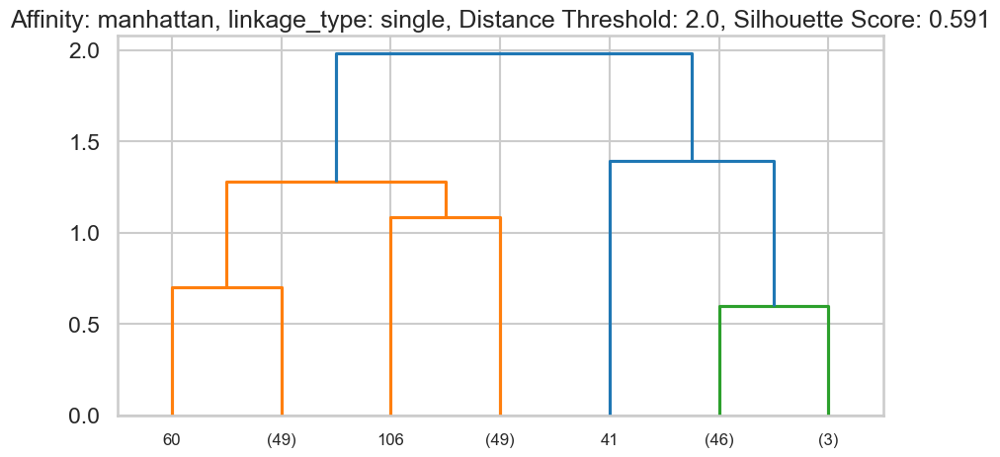

Affinity: manhattan, linkage_type: single, Distance Threshold: 2.0, Silhouette Score: 0.591
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]


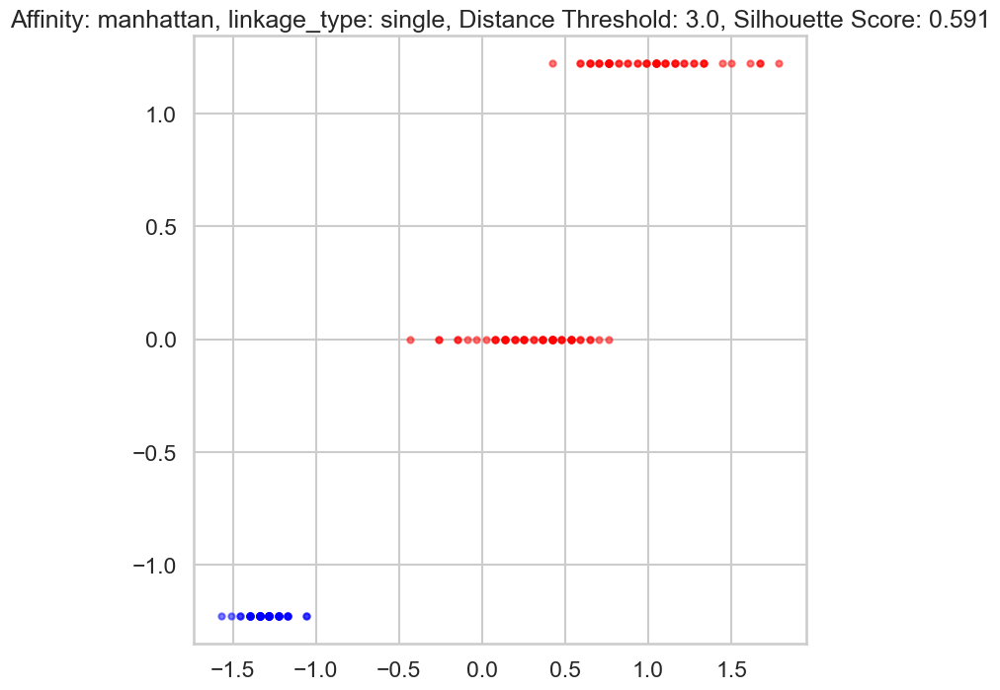

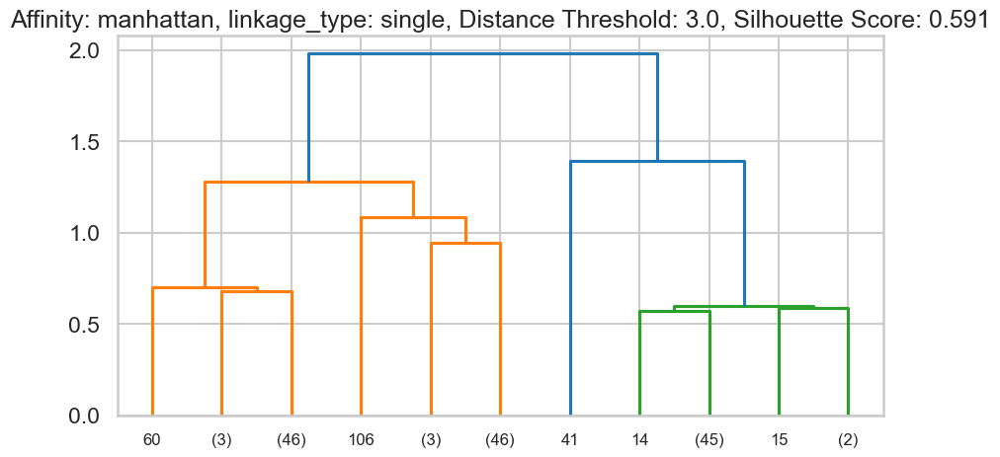

Affinity: manhattan, linkage_type: single, Distance Threshold: 3.0, Silhouette Score: 0.591
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)


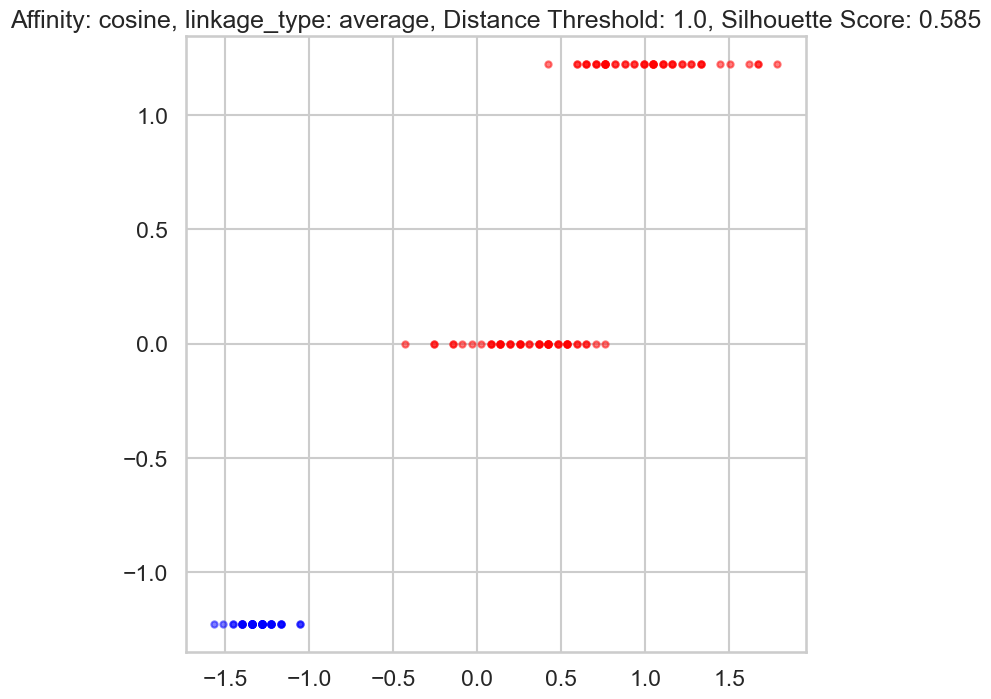

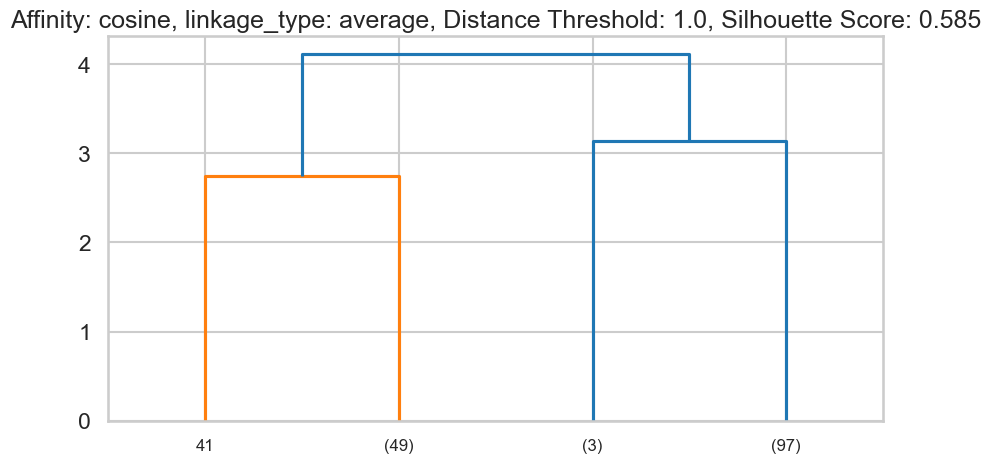

Affinity: cosine, linkage_type: average, Distance Threshold: 1.0, Silhouette Score: 0.585
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 0 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0]
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to n_samples - 1 (inclusive)
An error occurred: Number of labels is 1. Valid values are 2 to 

In [19]:
# Define parameters to try
affinities = ['euclidean', 'manhattan', 'cosine']
linkage_types = ['average', 'single']
distance_thresholds = [1.0,2.0,3.0, 4.0,5.0,6.0]

# Store results
best_score = -1
best_params = None
all_scores = {}
        
# Try different parameters
for affinity in affinities:
    for linkage_type in linkage_types:
        for distance_threshold in distance_thresholds:
            try:
                # Perform hierarchical clustering
                X = agg_clus(df_iris_norm, affinity=affinity, linkage_type=linkage_type, distance_threshold=distance_threshold)


                # Compute silhouette score
                score = silhouette_score(df_iris_norm, X.labels_)

                # Store results
                params = (affinity, linkage_type, distance_threshold)
                all_scores[params] = score

                # Plot clusters
                plt.title(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                display_cluster(df_iris_norm[['petal length (cm)', 'target']].to_numpy(copy=True), X, len(np.unique(X.labels_)) )            

                # Plot dendrogram
                fig, ax = plt.subplots(figsize=(10, 5))
                n = linkage(df_iris_norm,method=linkage_type)
                dendrogram(n, truncate_mode='level', p=distance_threshold)
                plt.title(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                plt.show()

                # Print resulting clusters
                print(f'Affinity: {affinity}, linkage_type: {linkage_type}, Distance Threshold: {distance_threshold}, Silhouette Score: {score:.3f}')
                print(X.labels_)

                # Update best score
                if score > best_score:
                    best_score = score
                    best_params = params
            except Exception as e:
                print(f"An error occurred: {e}")
                continue

# Print best parameters and score
print(f'Best Parameters: {best_params}, Silhouette Score: {best_score:.3f}')

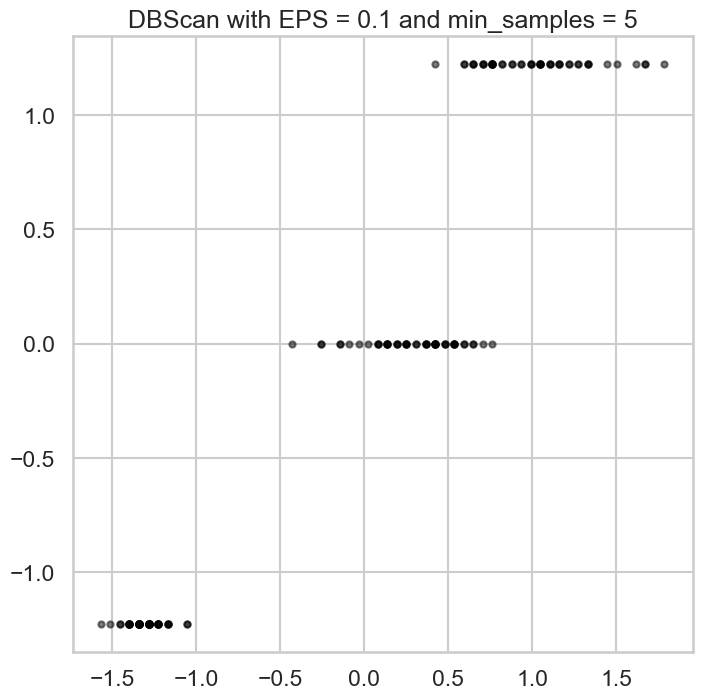

EPS: 0.1, Min Samples: 5, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


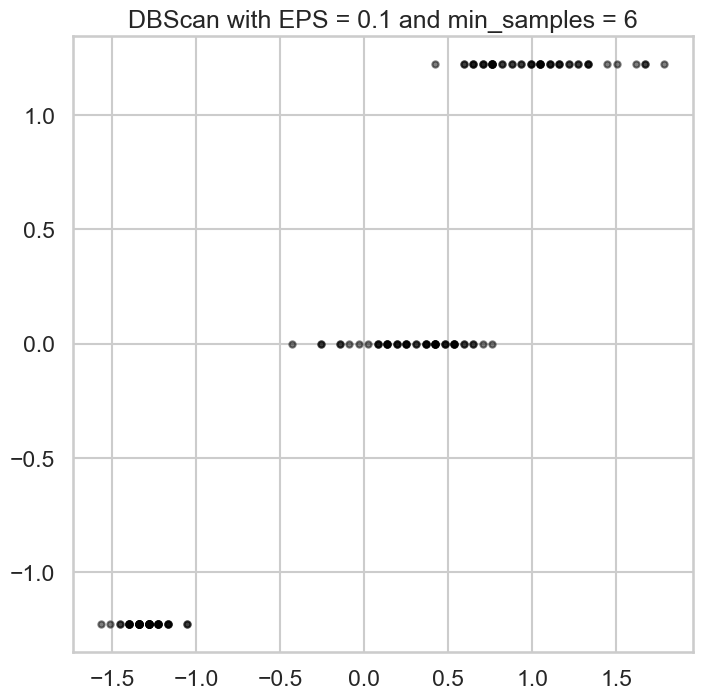

EPS: 0.1, Min Samples: 6, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


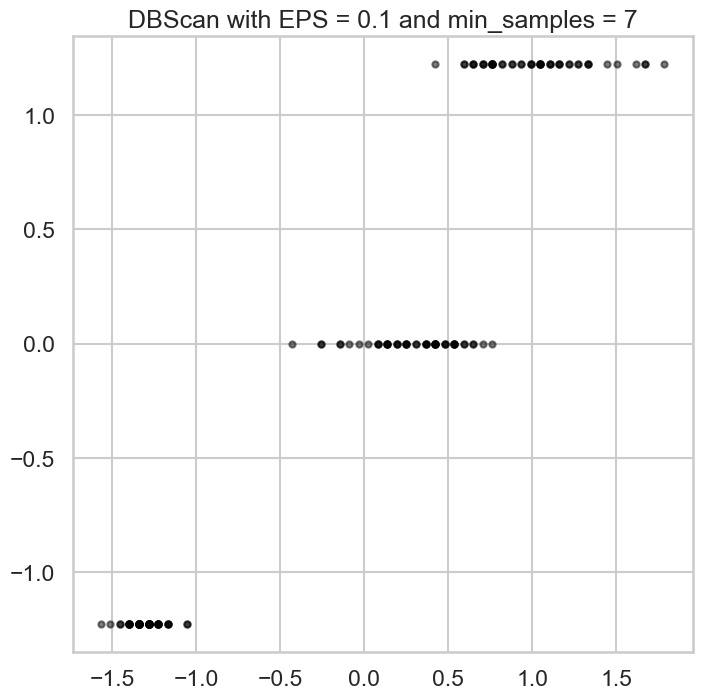

EPS: 0.1, Min Samples: 7, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


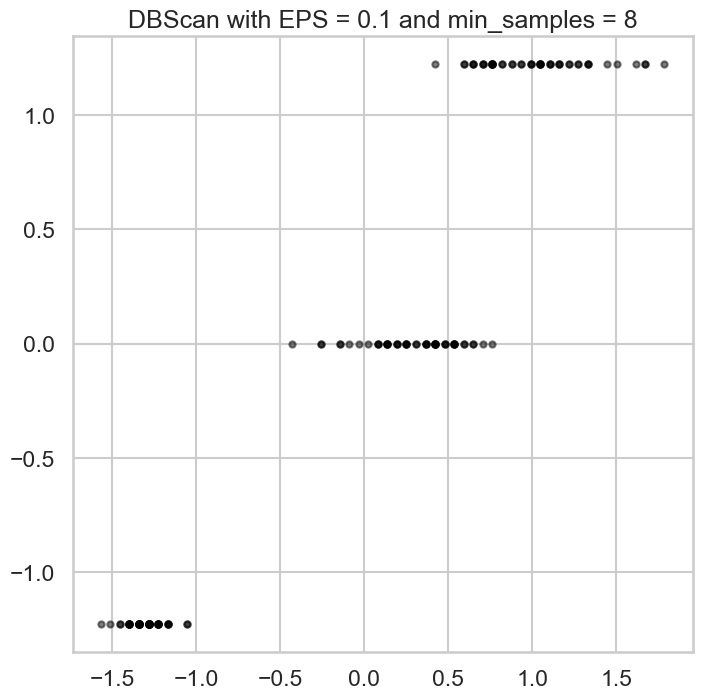

EPS: 0.1, Min Samples: 8, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


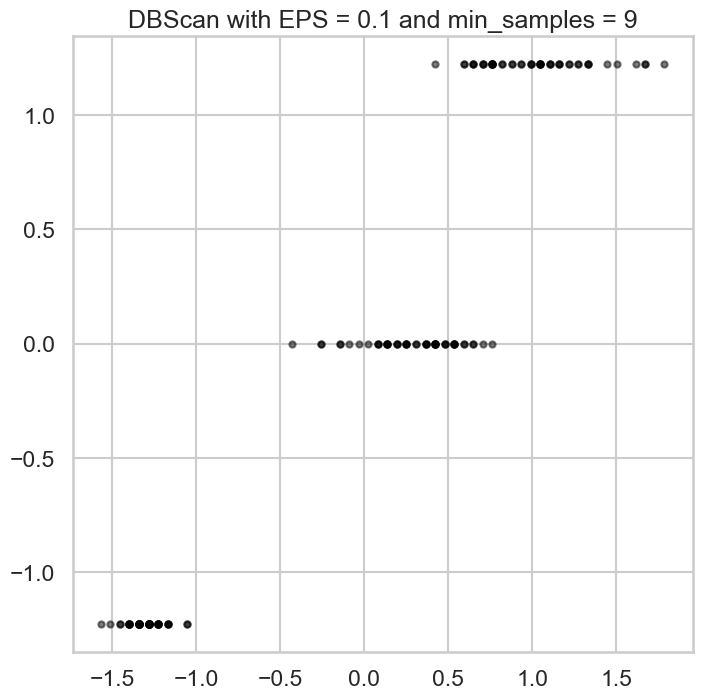

EPS: 0.1, Min Samples: 9, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


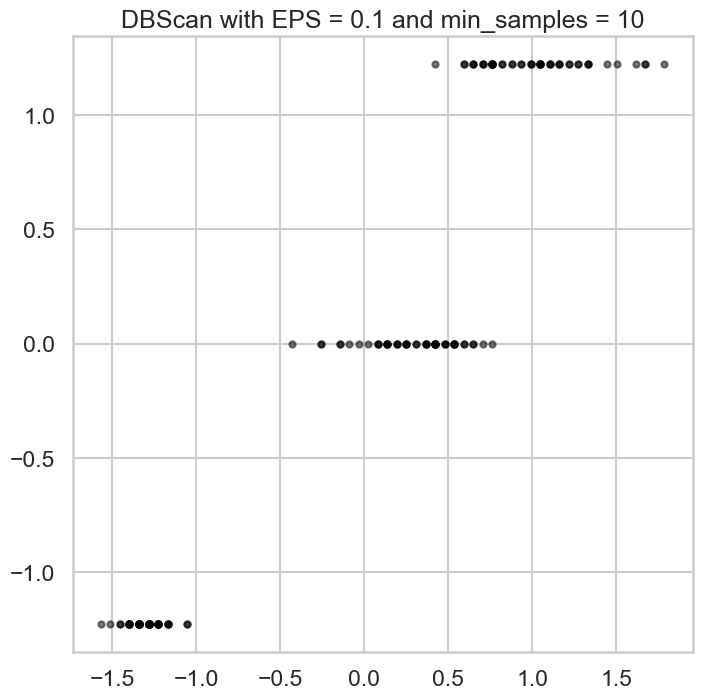

EPS: 0.1, Min Samples: 10, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


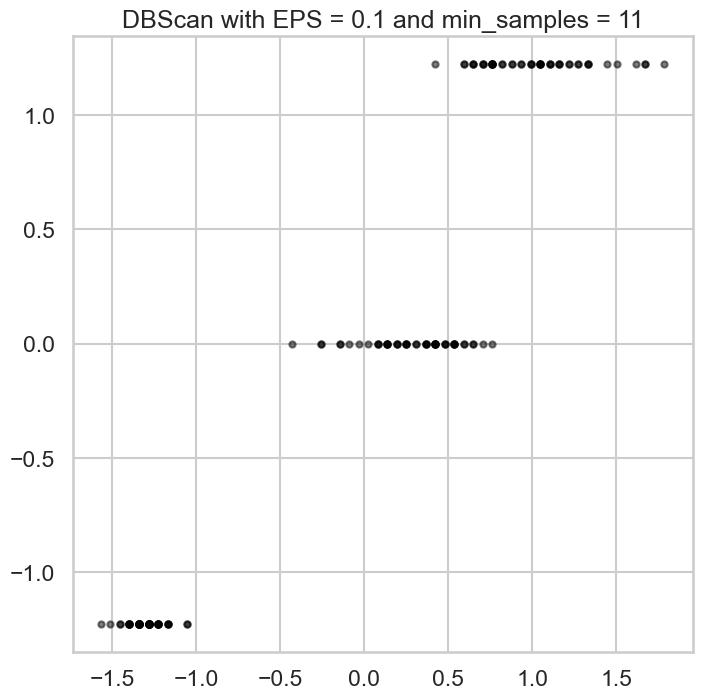

EPS: 0.1, Min Samples: 11, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


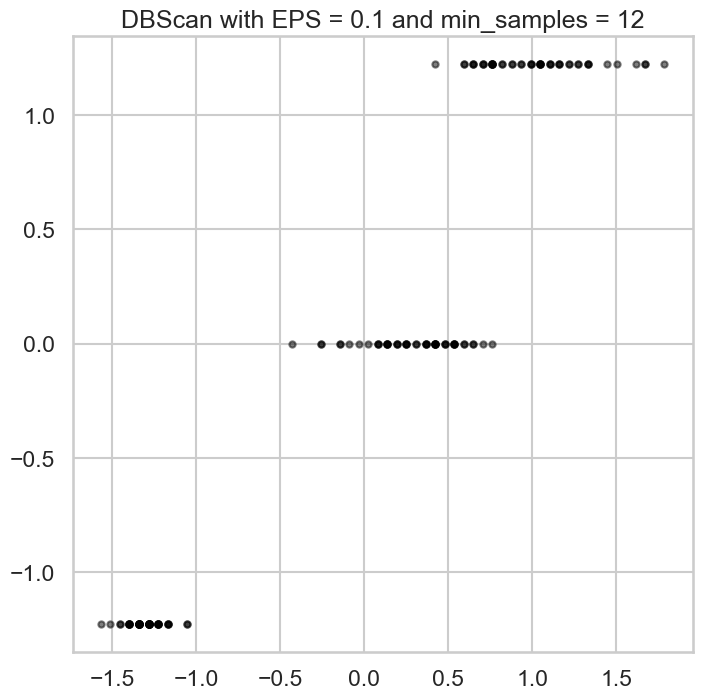

EPS: 0.1, Min Samples: 12, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


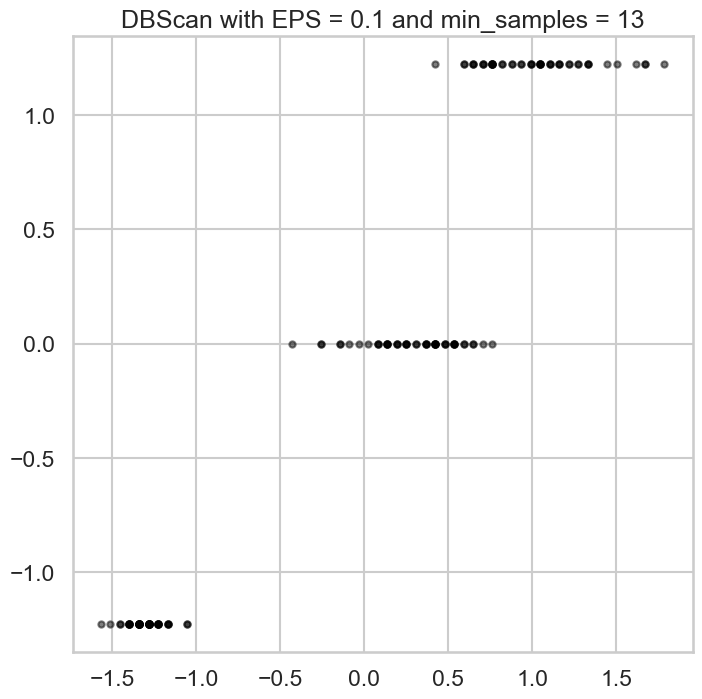

EPS: 0.1, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


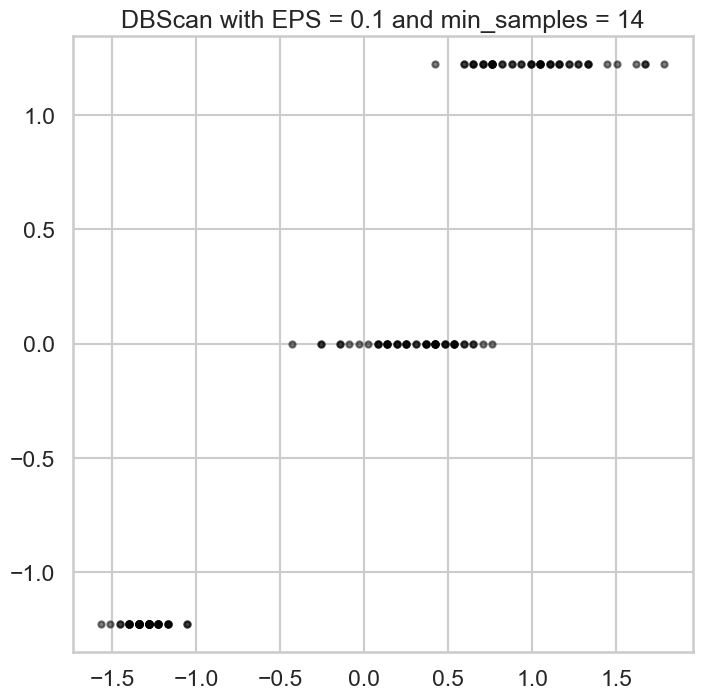

EPS: 0.1, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


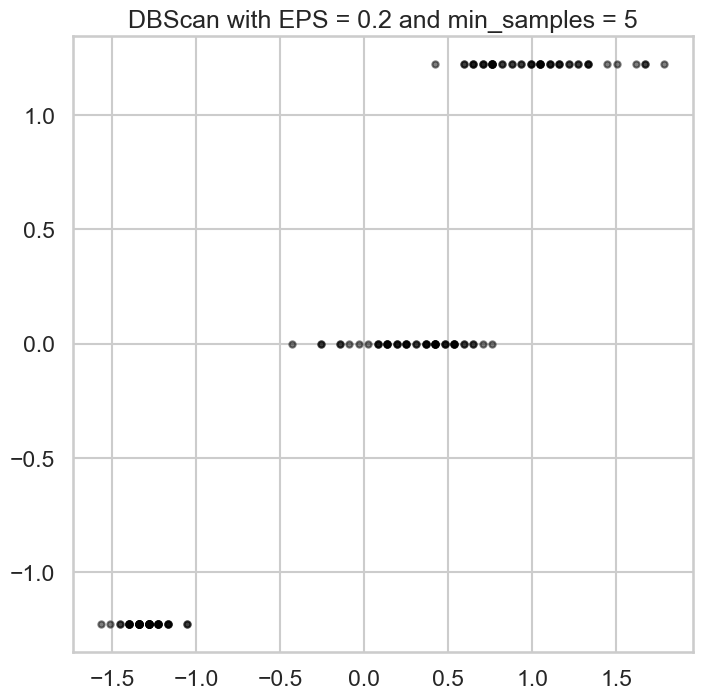

EPS: 0.2, Min Samples: 5, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


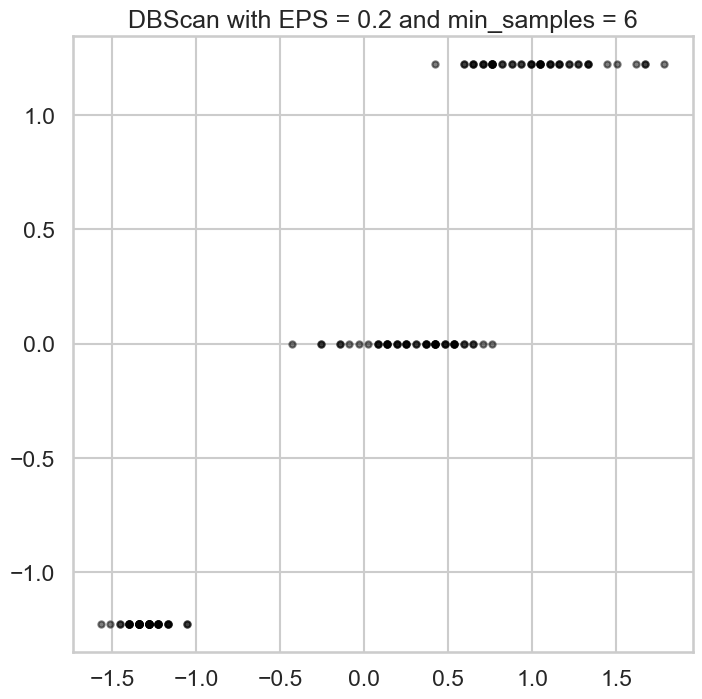

EPS: 0.2, Min Samples: 6, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


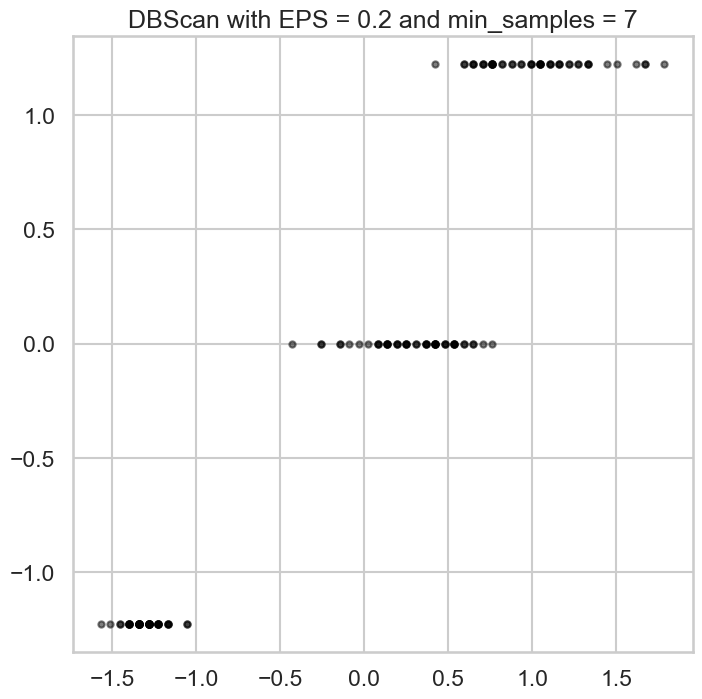

EPS: 0.2, Min Samples: 7, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


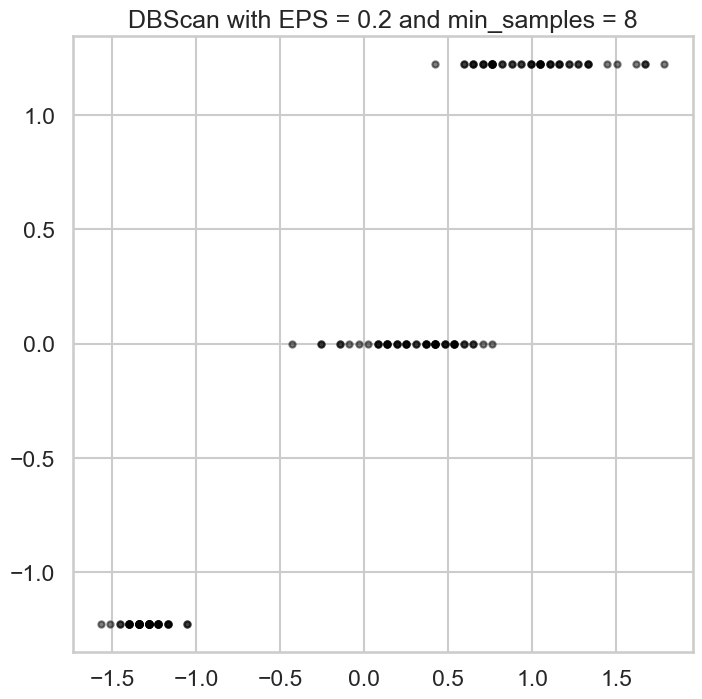

EPS: 0.2, Min Samples: 8, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


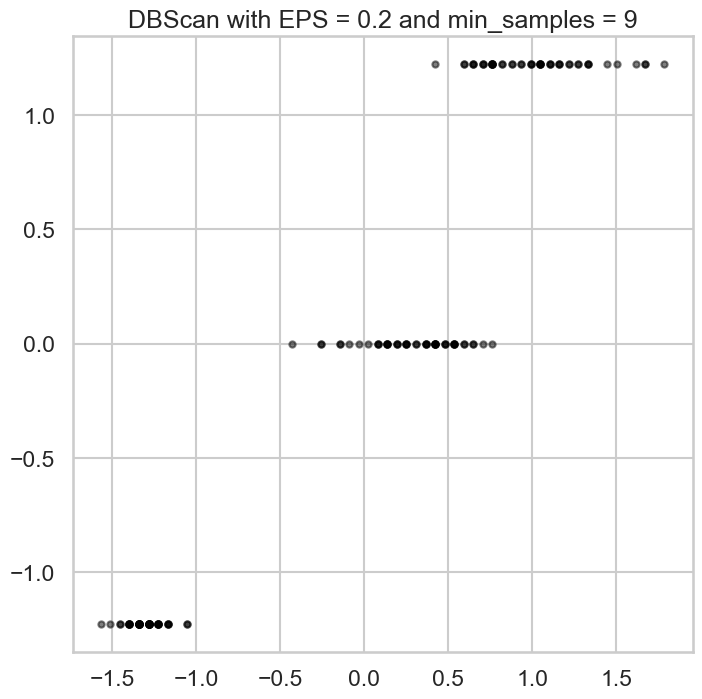

EPS: 0.2, Min Samples: 9, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


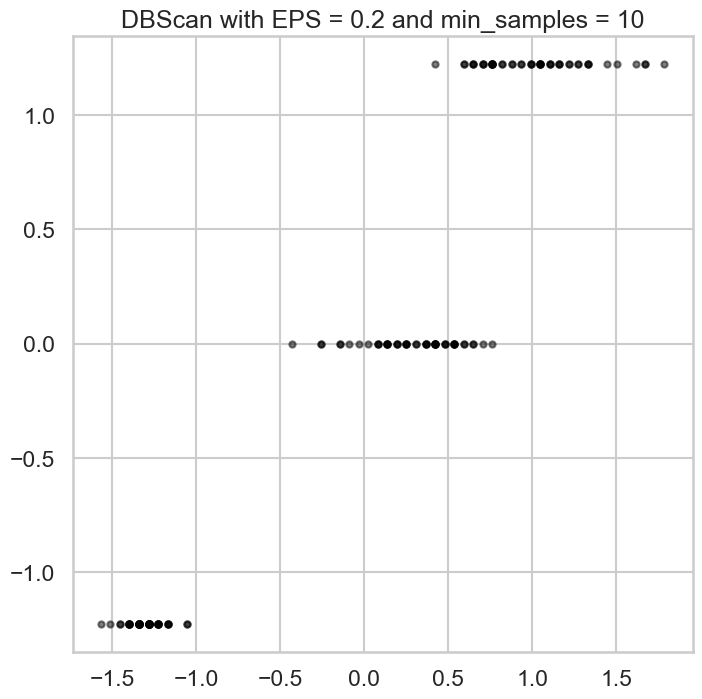

EPS: 0.2, Min Samples: 10, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


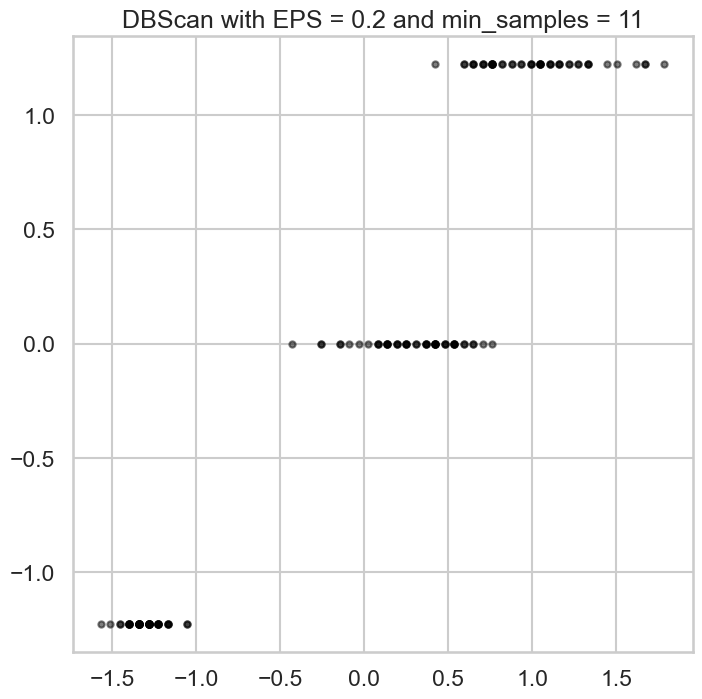

EPS: 0.2, Min Samples: 11, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


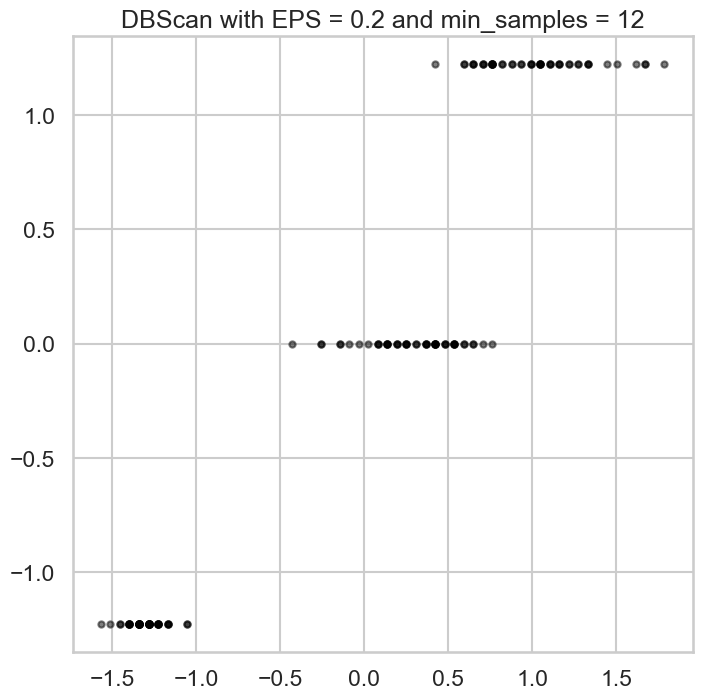

EPS: 0.2, Min Samples: 12, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


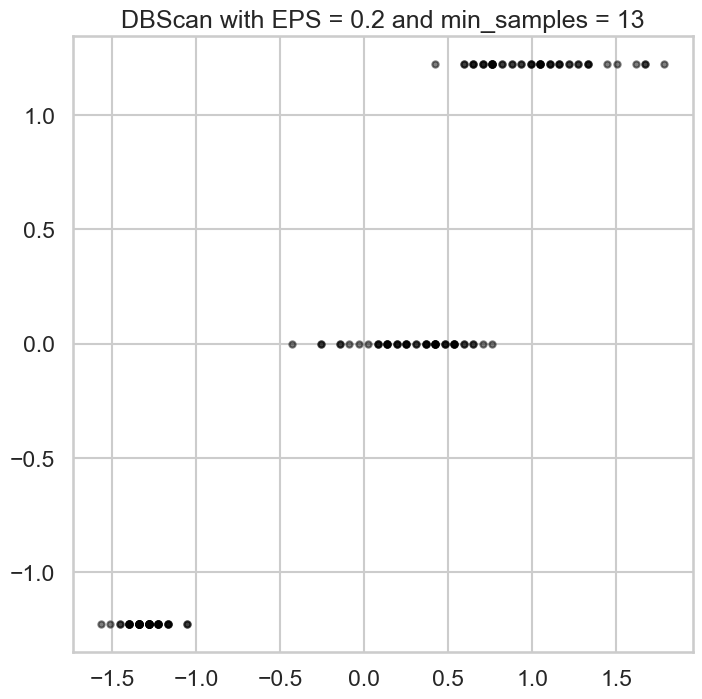

EPS: 0.2, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


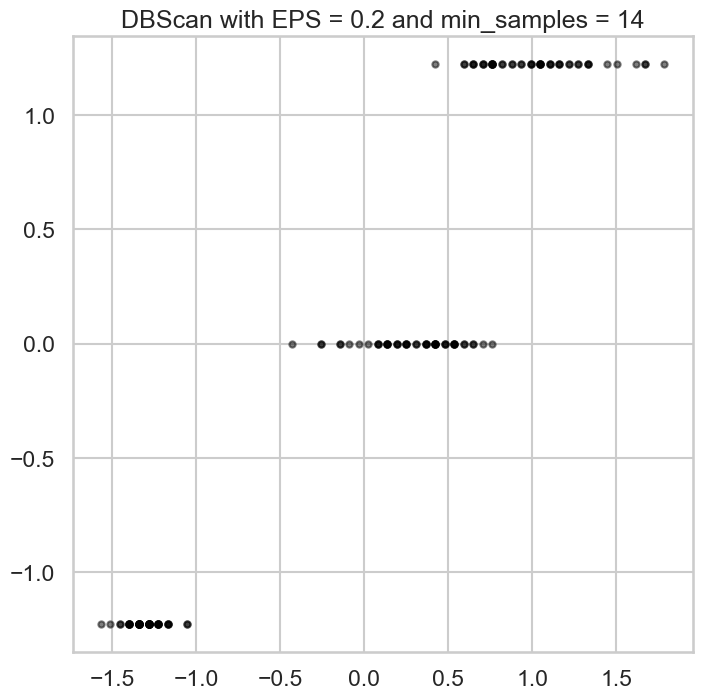

EPS: 0.2, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


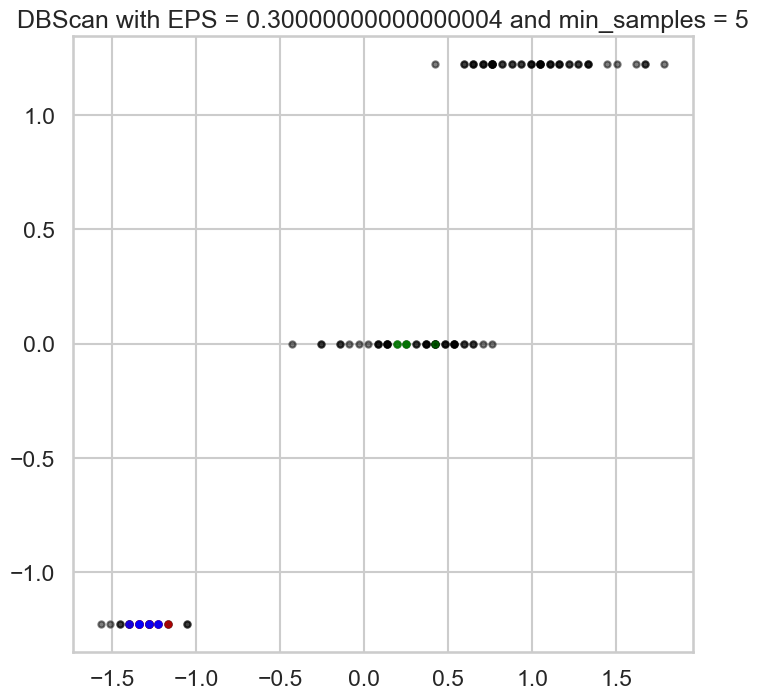

EPS: 0.30000000000000004, Min Samples: 5, Silhouette Score: -0.191
[ 0  1  1  1  0 -1 -1  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0 -1 -1 -1
 -1  1  0  0  0  1  1 -1 -1 -1  1 -1 -1  0 -1  0  0 -1  1 -1 -1  1 -1  1
 -1  0 -1 -1 -1 -1 -1  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  2 -1 -1 -1 -1 -1 -1  2
  2 -1 -1  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


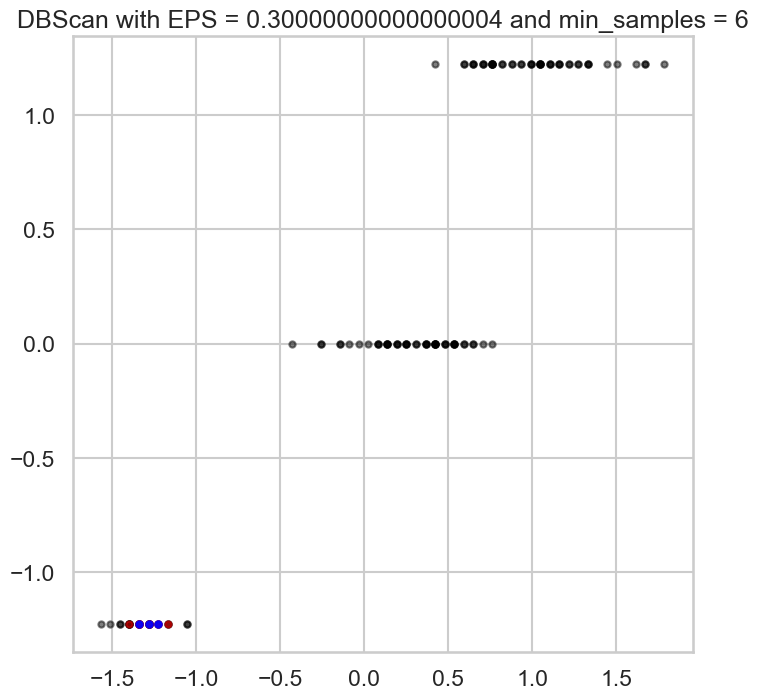

EPS: 0.30000000000000004, Min Samples: 6, Silhouette Score: 0.177
[ 0  1 -1  1  0 -1 -1  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0 -1 -1 -1
 -1  1  0  0  0  1  1 -1 -1 -1  1 -1 -1 -1 -1  0  0 -1 -1 -1 -1  1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


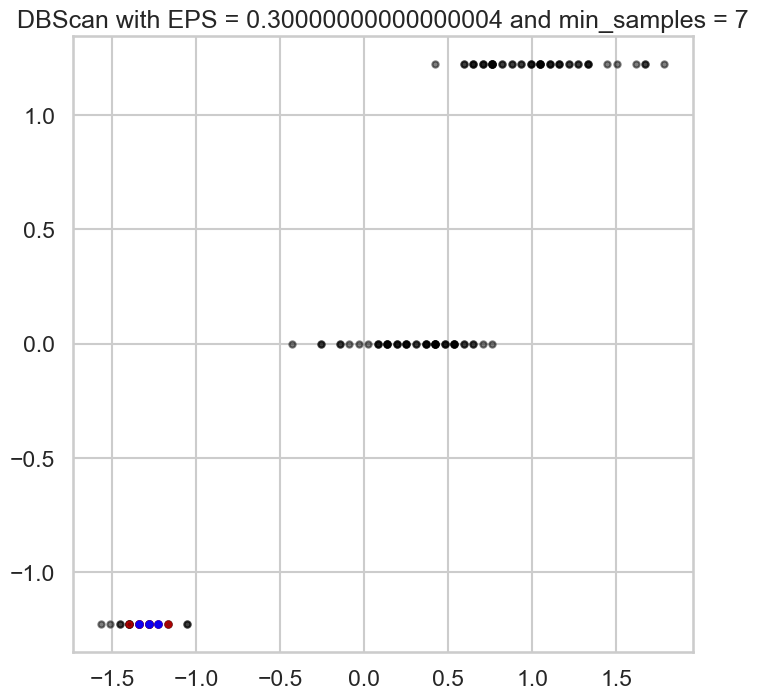

EPS: 0.30000000000000004, Min Samples: 7, Silhouette Score: 0.177
[ 0  1 -1  1  0 -1 -1  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0 -1 -1 -1
 -1  1  0  0  0  1  1 -1 -1 -1  1 -1 -1 -1 -1  0  0 -1 -1 -1 -1  1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


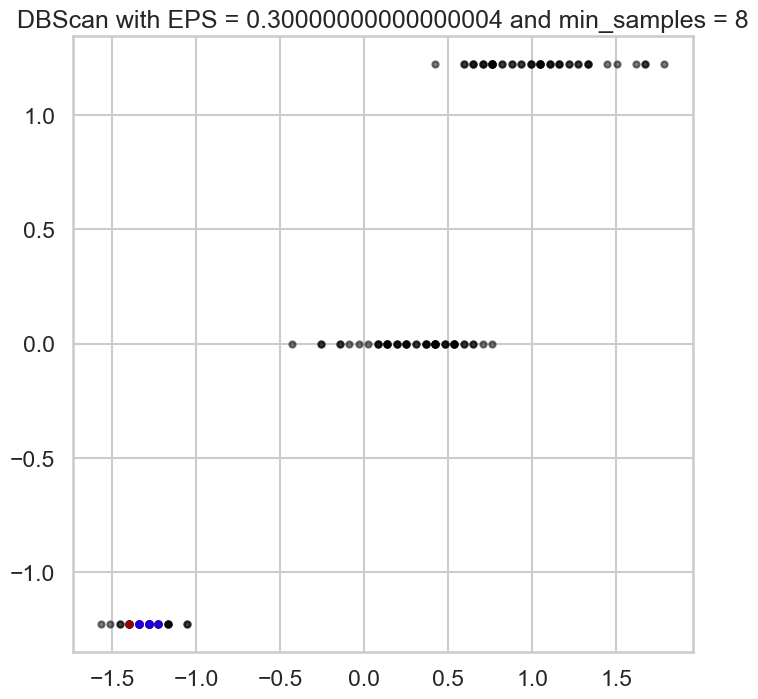

EPS: 0.30000000000000004, Min Samples: 8, Silhouette Score: 0.158
[ 0  1 -1  1  0 -1 -1  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1
 -1 -1  0  0  0  1  1 -1 -1 -1  1 -1 -1 -1 -1  0  0 -1 -1 -1 -1  1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


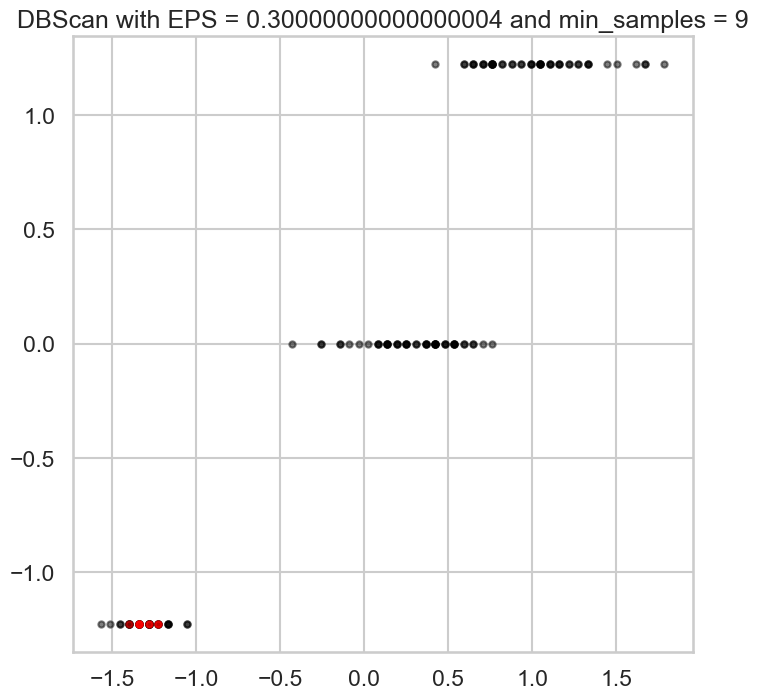

EPS: 0.30000000000000004, Min Samples: 9, Silhouette Score: 0.093
[ 0 -1 -1 -1 -1 -1 -1  0 -1 -1 -1  0 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1 -1
 -1 -1  0 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0 -1 -1 -1 -1 -1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


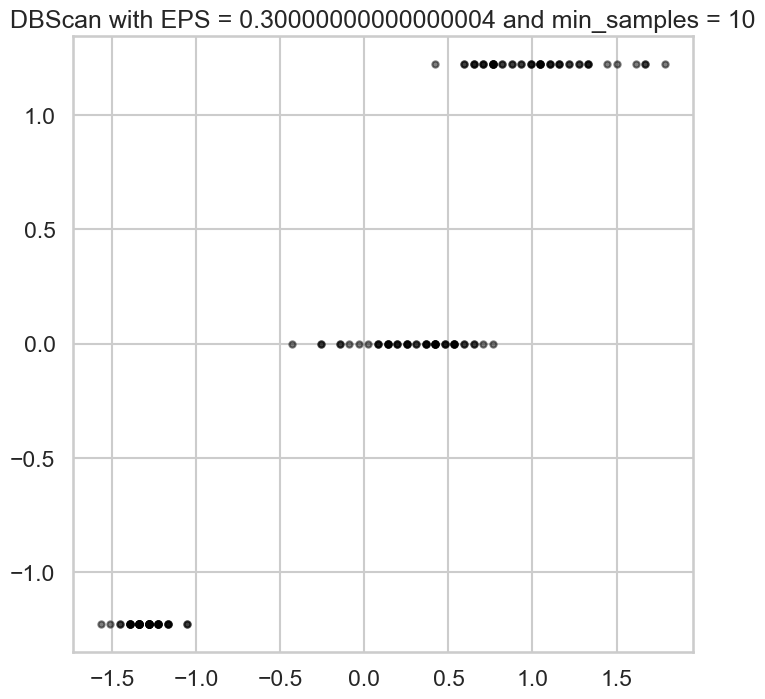

EPS: 0.30000000000000004, Min Samples: 10, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


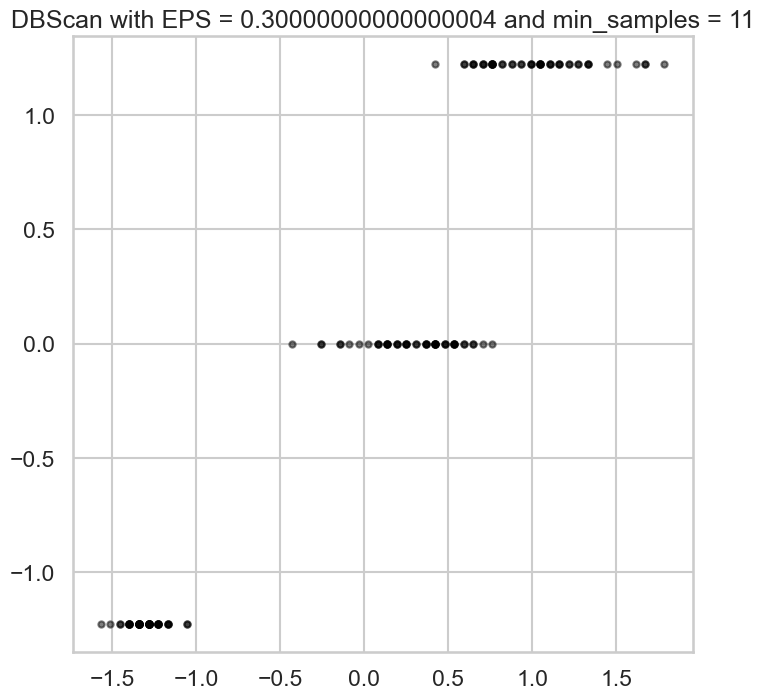

EPS: 0.30000000000000004, Min Samples: 11, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


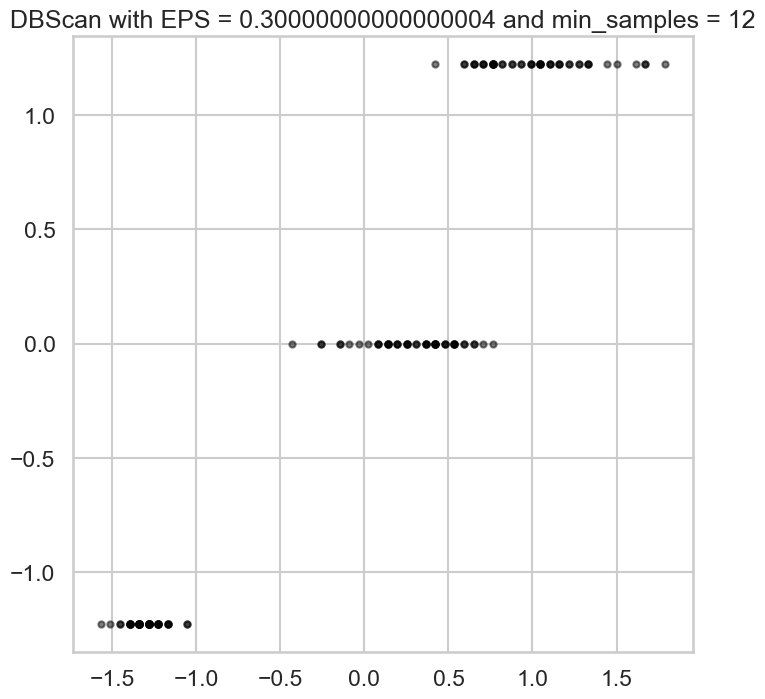

EPS: 0.30000000000000004, Min Samples: 12, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


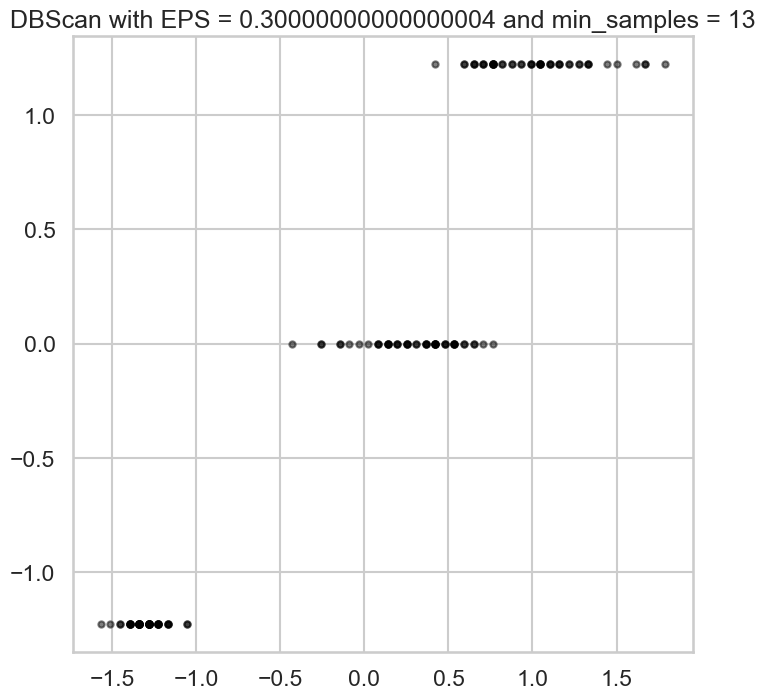

EPS: 0.30000000000000004, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


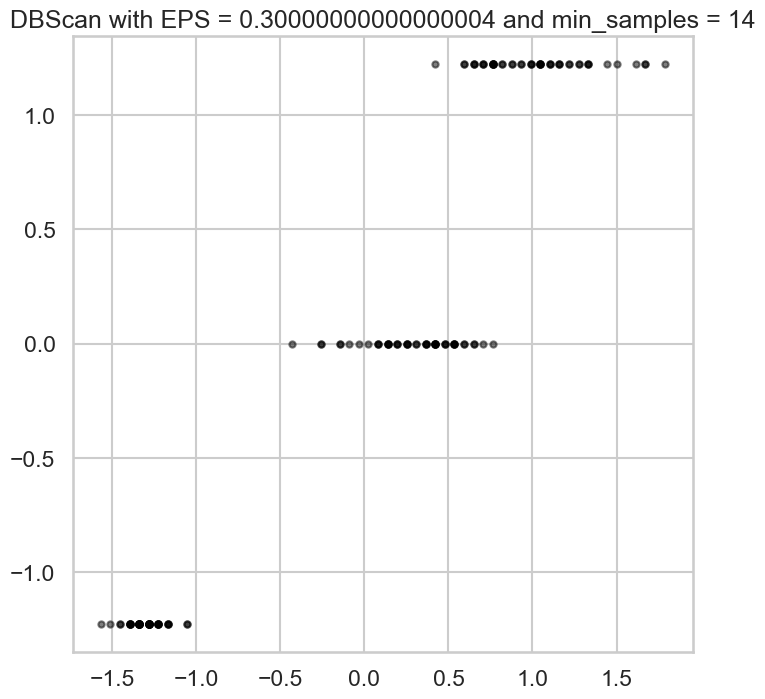

EPS: 0.30000000000000004, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


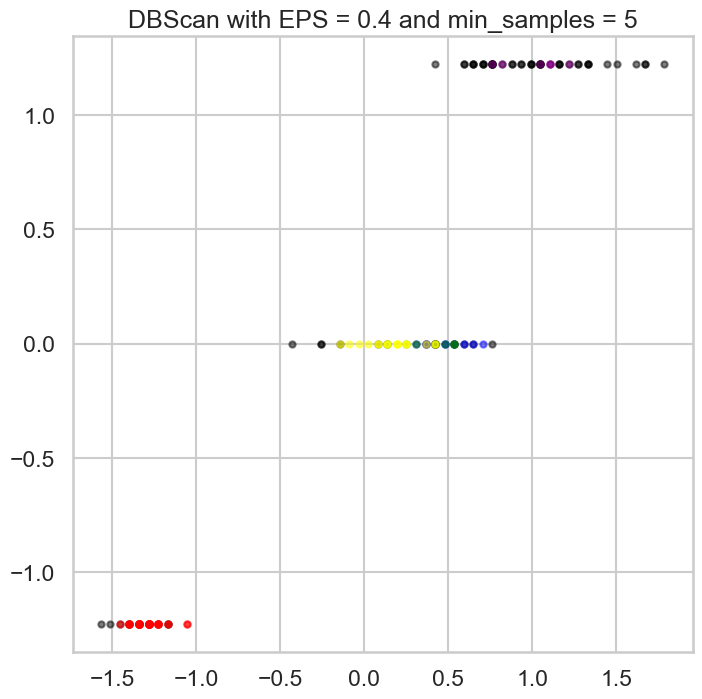

EPS: 0.4, Min Samples: 5, Silhouette Score: 0.046
[ 0  0  0  0  0 -1  0  0 -1  0  0  0  0 -1 -1 -1 -1  0 -1  0  0  0 -1  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1  1  3  1  3 -1 -1  1 -1 -1  2 -1  2  3  1  3  3 -1  3 -1  2
 -1  2  1  1  1  1  2  3  3  3  3 -1 -1 -1  1 -1  3  3  3  2  3 -1  3  3
  3  2 -1  3 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
  4 -1 -1 -1  4 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  4  4 -1  4
  4  4 -1 -1 -1 -1]


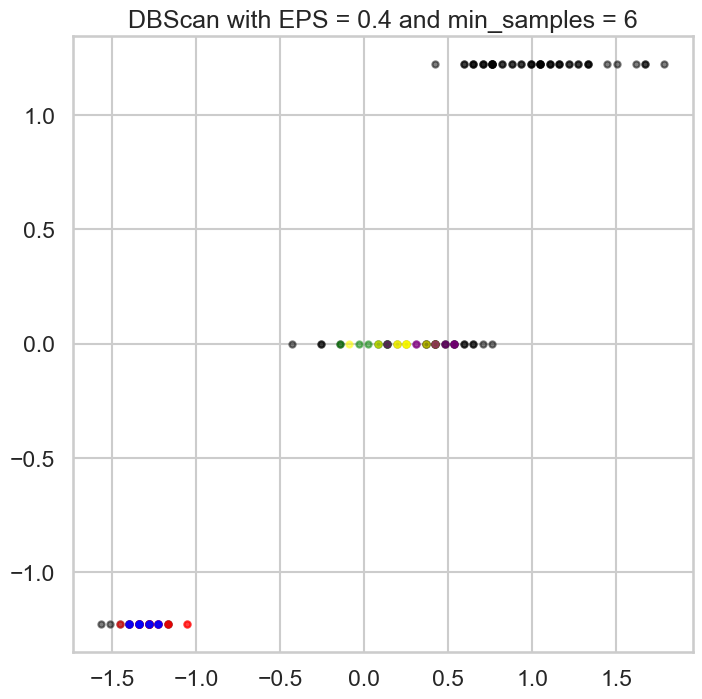

EPS: 0.4, Min Samples: 6, Silhouette Score: -0.030
[ 0  1  1  1  0 -1  0  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1  0  0  0 -1  0
  0  1  0  0  0  1  1  0 -1 -1  1  0  0  0  1  0  0 -1  1  0  0  1  0  1
  0  0 -1 -1 -1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1  4  3 -1 -1 -1 -1  2 -1  4
 -1  4  4 -1 -1 -1  4  2  2  2  3 -1 -1 -1 -1 -1  3  2  3  4  2 -1  3  3
  3  4 -1  3 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


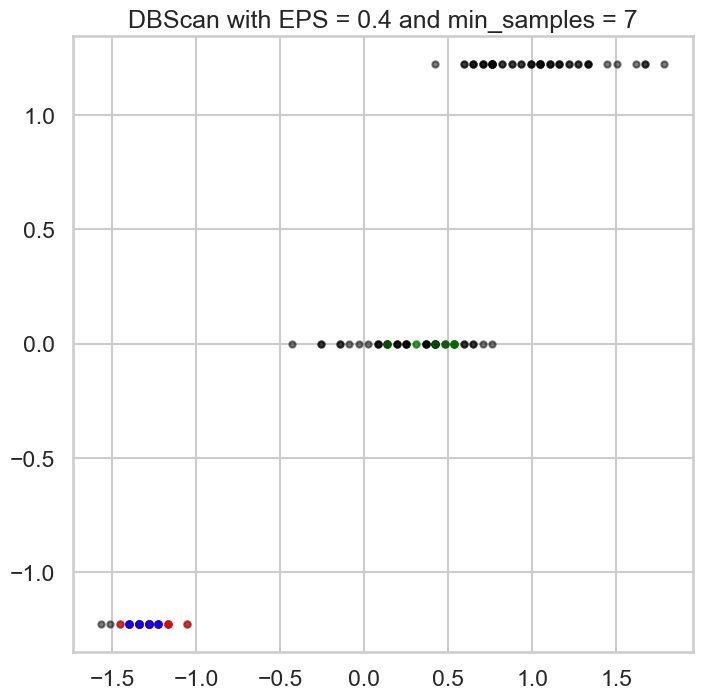

EPS: 0.4, Min Samples: 7, Silhouette Score: -0.126
[ 0  1  1  1  0 -1  0  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0  0 -1  0
  0  1  0  0  0  1  1  0 -1 -1  1  0  0  0  1  0  0 -1  1  0 -1  1 -1  1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  2 -1 -1 -1 -1 -1 -1 -1  2
 -1  2  2 -1 -1 -1  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  2 -1 -1 -1 -1
 -1  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


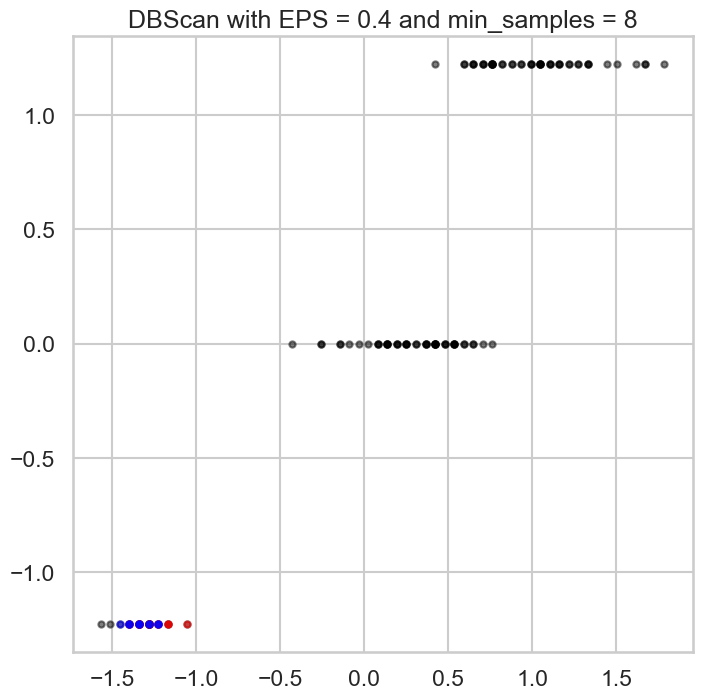

EPS: 0.4, Min Samples: 8, Silhouette Score: 0.299
[ 0  1  1  1  0 -1  0  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0 -1 -1  0
  0  1  0  0  0  1  1  0 -1 -1  1  1  0  0  1  0  0 -1  1  0 -1  1 -1  1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


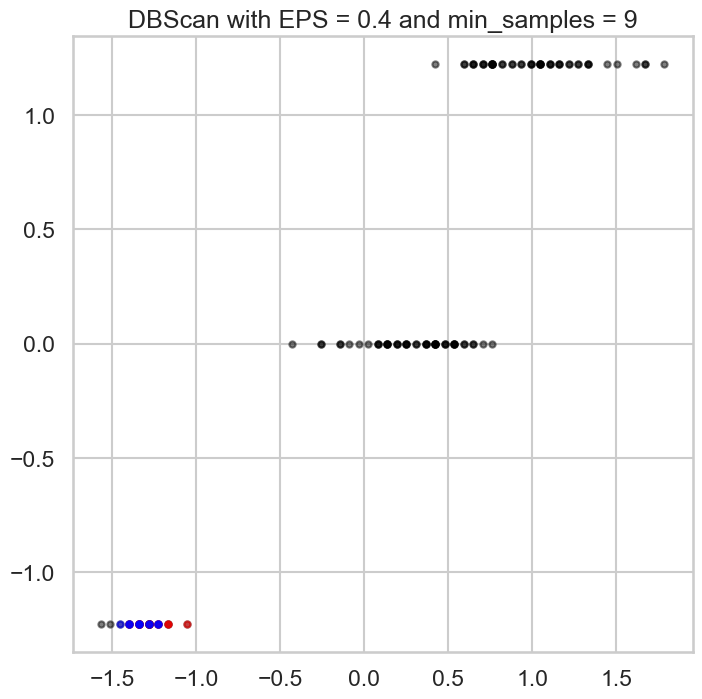

EPS: 0.4, Min Samples: 9, Silhouette Score: 0.291
[ 0  1  1  1  0 -1 -1  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0 -1 -1  0
  0  1  0  0  0  1  1  0 -1 -1  1  1  0  0  1  0  0 -1  1  0 -1  1 -1  1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


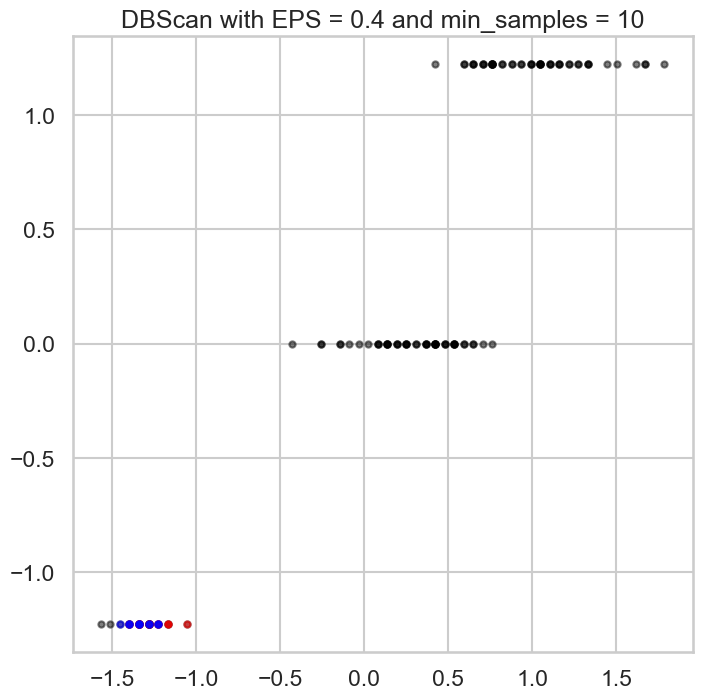

EPS: 0.4, Min Samples: 10, Silhouette Score: 0.291
[ 0  1  1  1  0 -1 -1  0 -1  1 -1  0  1 -1 -1 -1 -1  0 -1 -1  0 -1 -1  0
  0  1  0  0  0  1  1  0 -1 -1  1  1  0  0  1  0  0 -1  1  0 -1  1 -1  1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


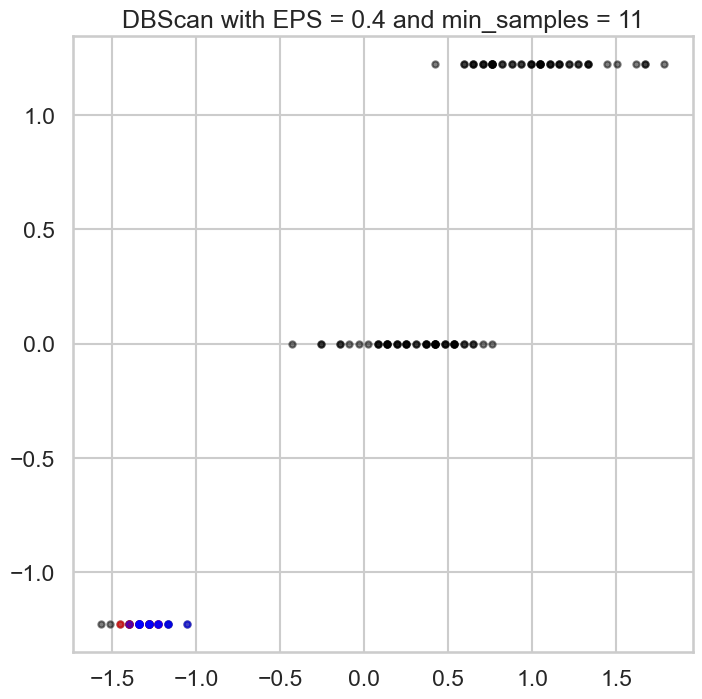

EPS: 0.4, Min Samples: 11, Silhouette Score: 0.280
[ 1  0  0  0  1 -1 -1  1 -1  0 -1  1  0 -1 -1 -1 -1  1 -1 -1  1 -1 -1  1
  1  0  1  1  1  0  0  1 -1 -1  0  0 -1  1  0  1  1 -1  0  1 -1  0 -1  0
 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


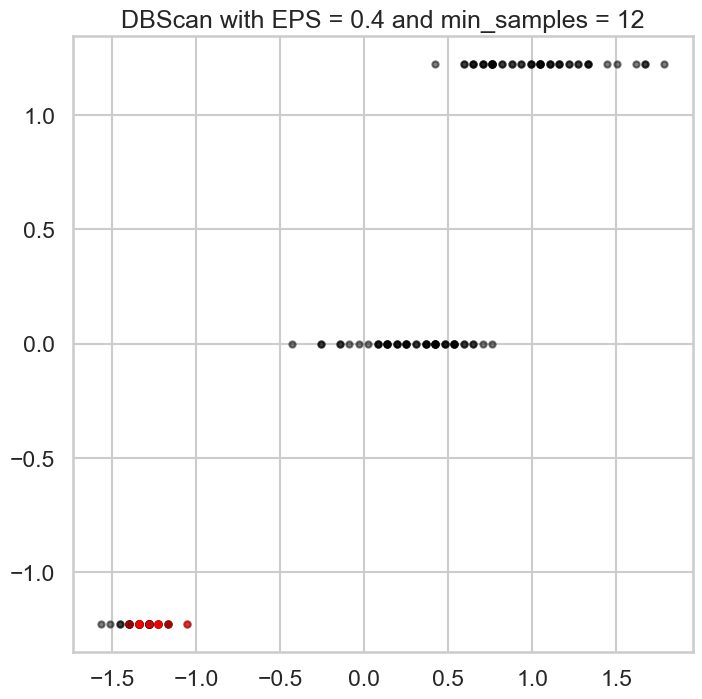

EPS: 0.4, Min Samples: 12, Silhouette Score: 0.126
[ 0 -1 -1 -1 -1 -1 -1  0 -1 -1 -1  0 -1 -1 -1 -1 -1  0 -1 -1 -1 -1 -1  0
  0 -1  0 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  0  0 -1 -1  0 -1 -1 -1 -1
 -1  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


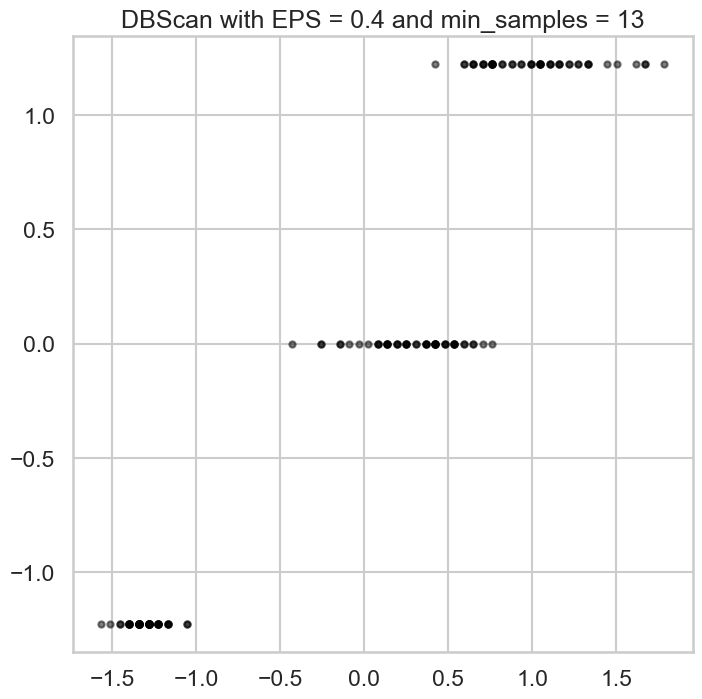

EPS: 0.4, Min Samples: 13, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


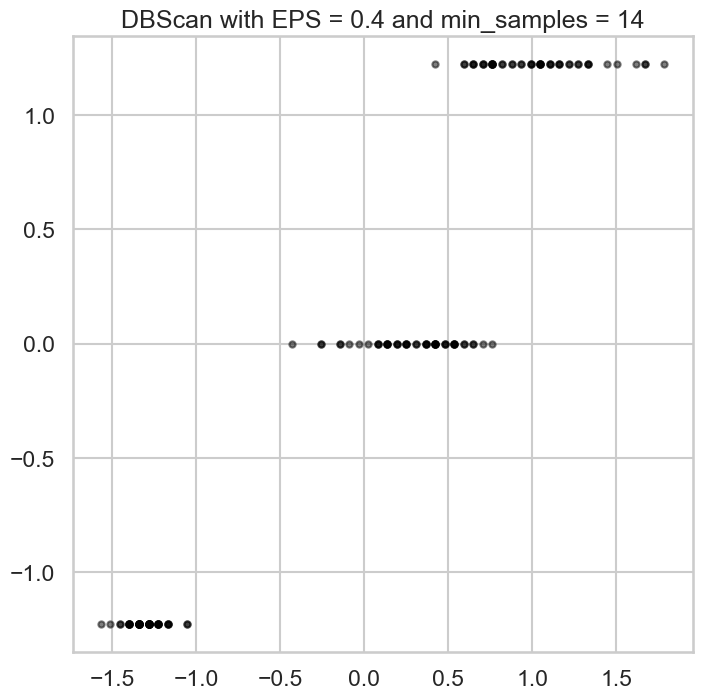

EPS: 0.4, Min Samples: 14, Silhouette Score: -1.000
[-1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


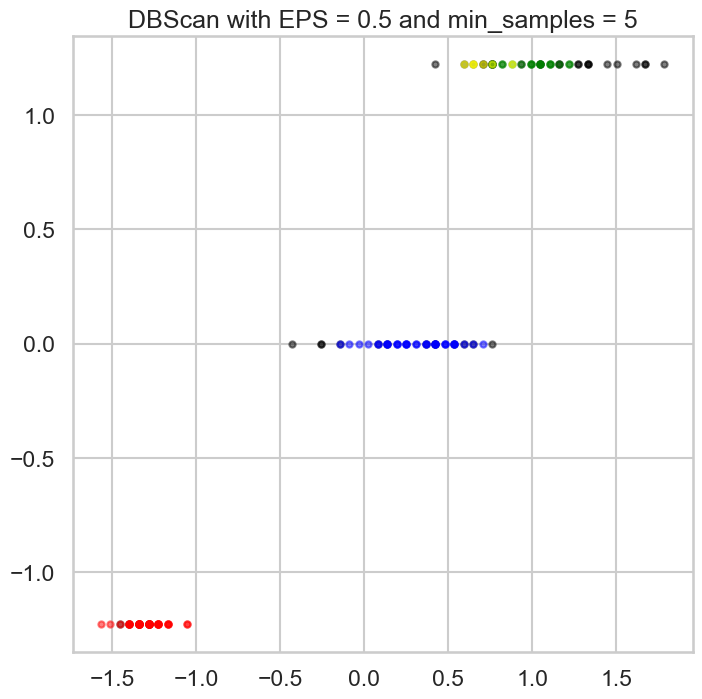

EPS: 0.5, Min Samples: 5, Silhouette Score: 0.223
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1 -1 -1  1 -1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  2  2  2 -1 -1 -1 -1 -1  2  3  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  3  2 -1  3  3  2 -1 -1 -1  2  3 -1 -1 -1  2 -1  2  2  2 -1  2
  2  2  3  2 -1 -1]


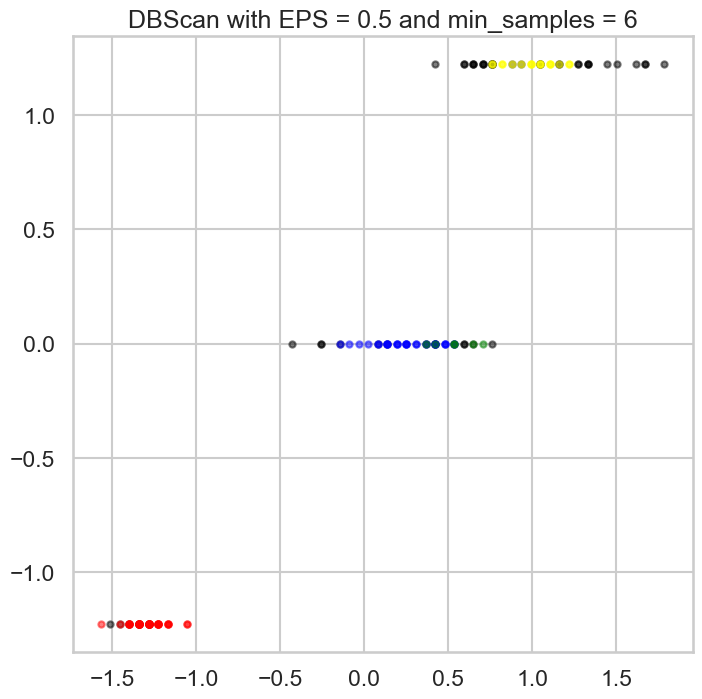

EPS: 0.5, Min Samples: 6, Silhouette Score: 0.201
[ 0  0  0  0  0  0  0  0 -1  0  0  0  0 -1 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  2  2  2  1  1  1 -1 -1  1 -1 -1  1 -1  1  1  2  1  1 -1  1 -1  1
 -1  1  1  1 -1  2  1  1  1  1  1 -1  1 -1  2 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  3  3  3 -1 -1 -1 -1 -1  3 -1  3 -1 -1  3  3 -1 -1 -1
  3 -1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1  3 -1 -1 -1 -1  3 -1  3  3  3 -1  3
  3  3 -1  3 -1 -1]


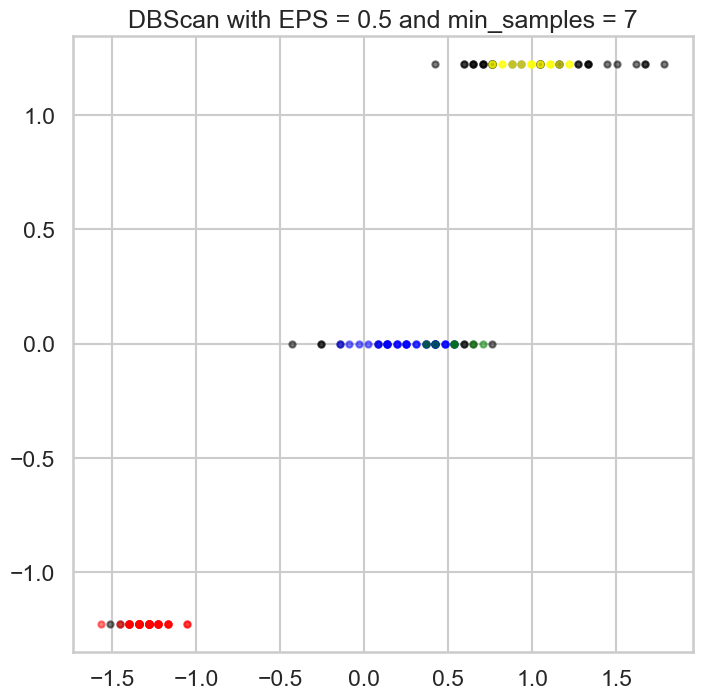

EPS: 0.5, Min Samples: 7, Silhouette Score: 0.196
[ 0  0  0  0  0  0  0  0 -1  0  0  0  0 -1 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  2  2  2  1  1  1 -1 -1  1 -1 -1  1 -1  1  1  2  1  1 -1  1 -1  1
 -1  1  1  1 -1  2  1  1  1  1  1 -1  1 -1  2 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  3  3  3 -1 -1 -1 -1 -1  3 -1  3 -1 -1  3  3 -1 -1 -1
  3 -1 -1 -1  3 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  3 -1  3  3  3 -1  3
  3  3 -1  3 -1 -1]


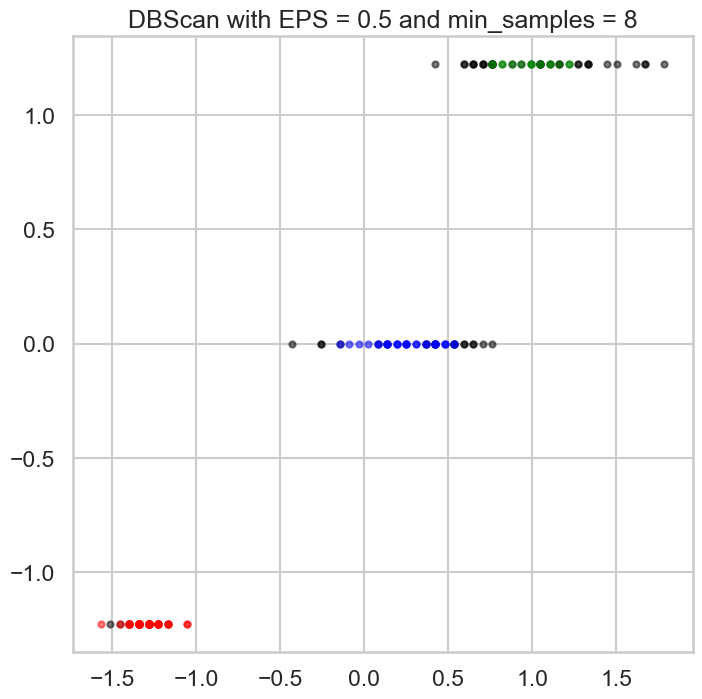

EPS: 0.5, Min Samples: 8, Silhouette Score: 0.208
[ 0  0  0  0  0  0  0  0 -1  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1  1  1  1 -1 -1  1 -1 -1  1 -1  1  1 -1  1  1 -1  1 -1  1
 -1  1  1  1 -1 -1  1  1  1  1  1 -1  1 -1 -1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  2  2  2 -1 -1 -1 -1 -1  2 -1  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  2 -1  2  2  2 -1  2
  2  2 -1  2 -1 -1]


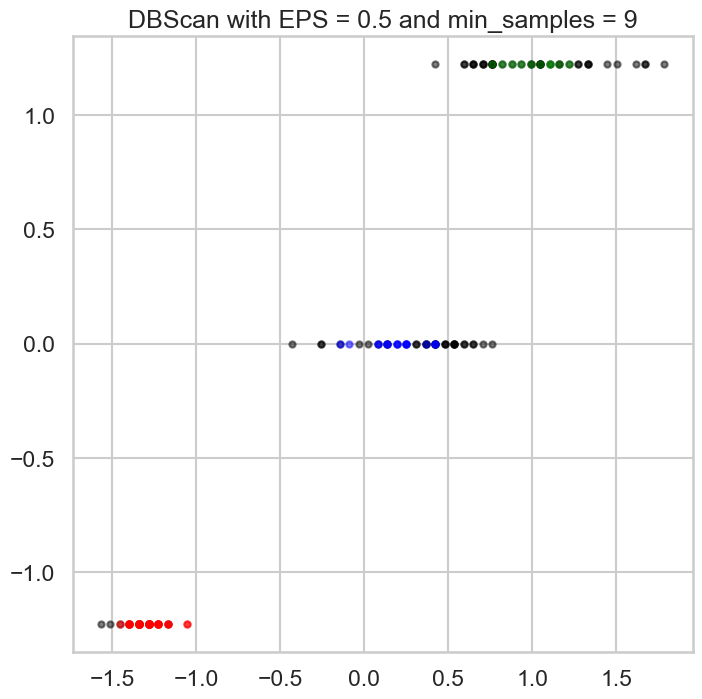

EPS: 0.5, Min Samples: 9, Silhouette Score: 0.084
[ 0  0  0  0  0  0  0  0 -1  0  0  0  0 -1 -1 -1  0  0 -1  0  0  0 -1  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1  1 -1  1  1 -1  1 -1  1
 -1 -1 -1 -1 -1 -1  1  1 -1 -1  1 -1 -1 -1 -1 -1  1  1  1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1  2 -1 -1 -1 -1 -1 -1 -1  2 -1 -1  2 -1 -1 -1 -1
  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  2  2  2 -1  2
  2  2 -1 -1 -1 -1]


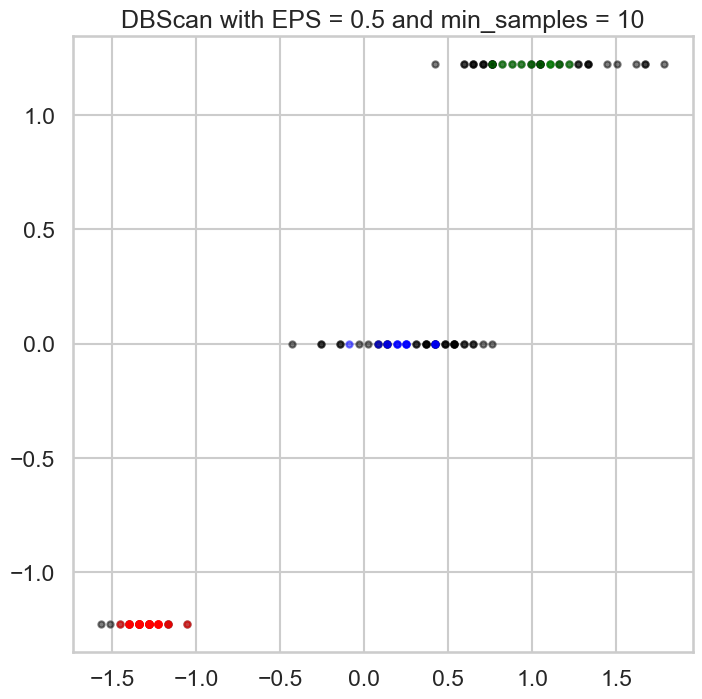

EPS: 0.5, Min Samples: 10, Silhouette Score: 0.010
[ 0  0  0  0  0 -1  0  0 -1  0 -1  0  0 -1 -1 -1 -1  0 -1  0  0  0 -1  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1  1 -1  1  1 -1 -1 -1  1
 -1 -1 -1 -1 -1 -1  1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1  2 -1 -1 -1 -1 -1 -1 -1  2 -1 -1  2 -1 -1 -1 -1
  2 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  2  2  2 -1  2
  2  2 -1 -1 -1 -1]


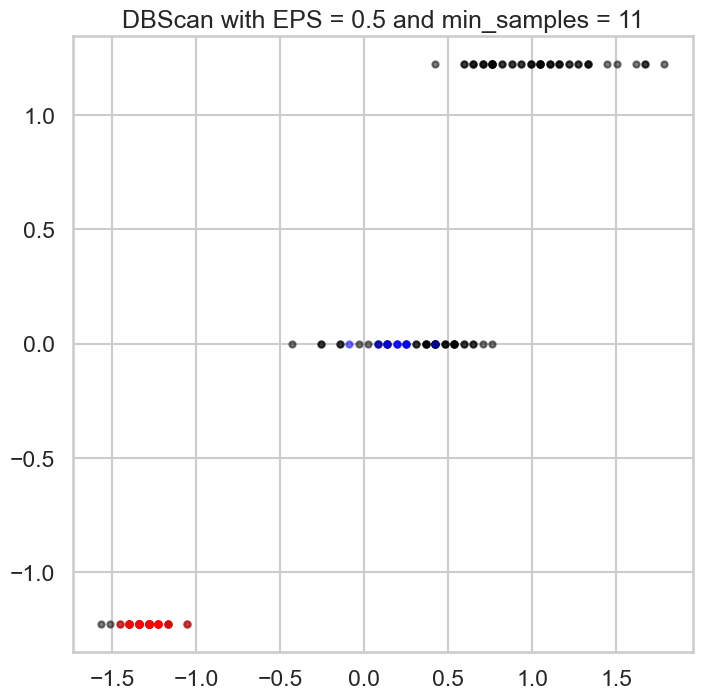

EPS: 0.5, Min Samples: 11, Silhouette Score: 0.062
[ 0  0  0  0  0 -1  0  0 -1  0 -1  0  0 -1 -1 -1 -1  0 -1  0  0  0 -1  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1  1 -1 -1  1 -1 -1 -1  1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1 -1 -1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


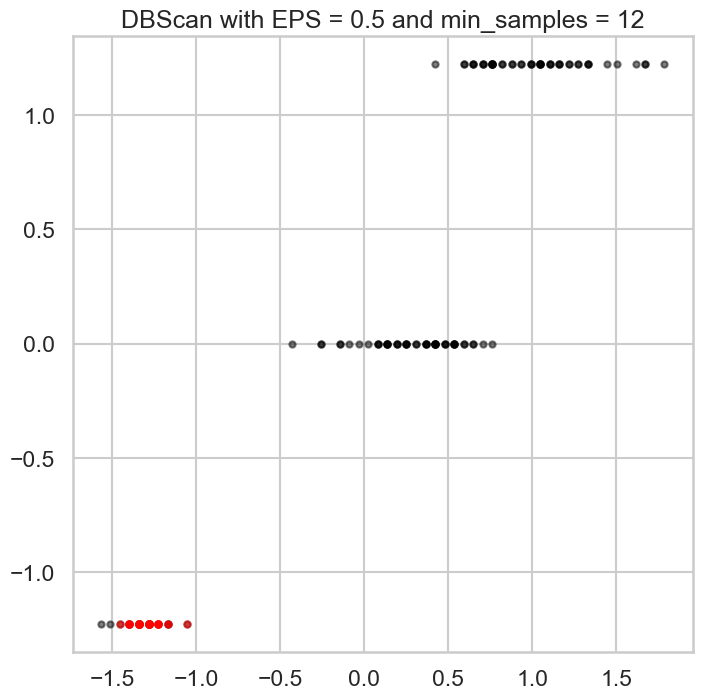

EPS: 0.5, Min Samples: 12, Silhouette Score: 0.435
[ 0  0  0  0  0 -1  0  0 -1  0 -1  0  0 -1 -1 -1 -1  0 -1  0  0  0 -1  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0 -1  0  0  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


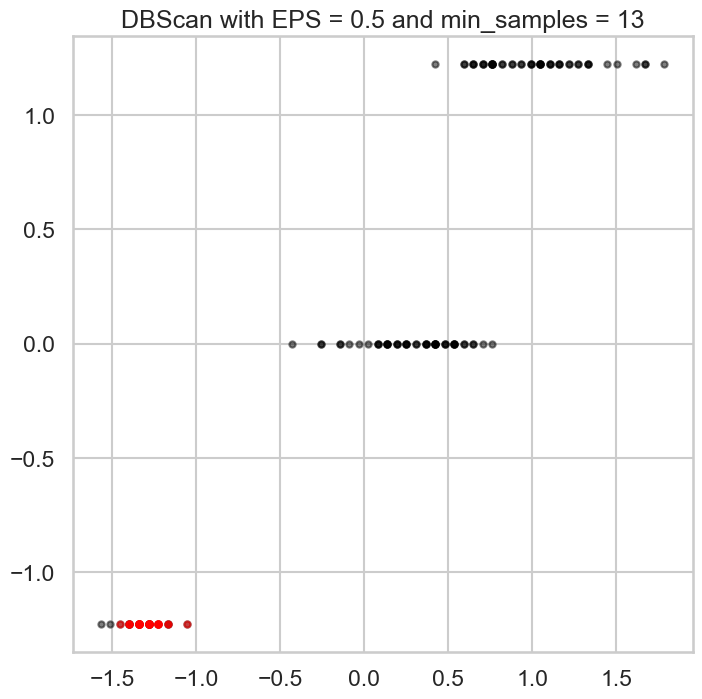

EPS: 0.5, Min Samples: 13, Silhouette Score: 0.397
[ 0  0  0  0  0 -1  0  0 -1  0 -1  0  0 -1 -1 -1 -1  0 -1 -1  0  0 -1  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0 -1  0  0 -1  0  0 -1  0 -1  0
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


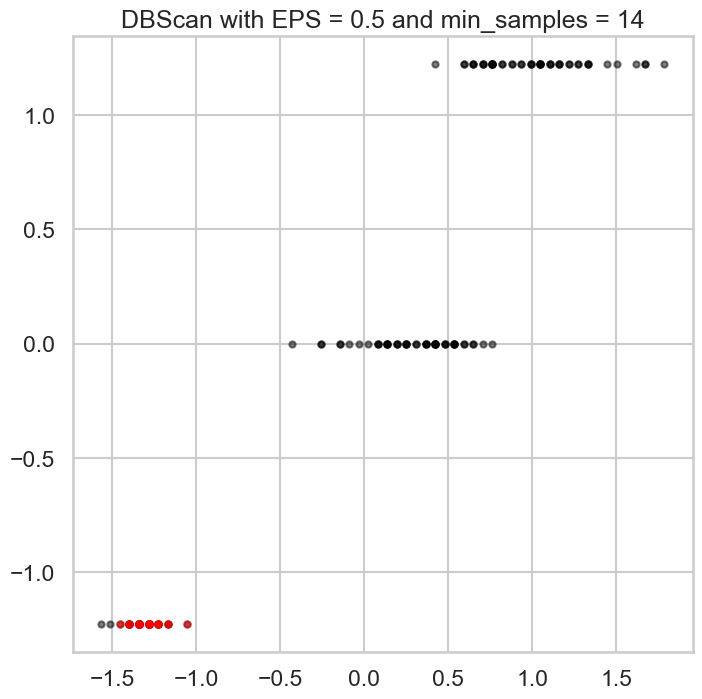

EPS: 0.5, Min Samples: 14, Silhouette Score: 0.288
[ 0 -1  0 -1  0 -1 -1  0 -1  0 -1  0 -1 -1 -1 -1 -1  0 -1 -1  0  0 -1  0
  0 -1  0  0  0  0 -1  0 -1 -1  0  0  0  0 -1  0  0 -1 -1  0 -1 -1 -1 -1
  0  0 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


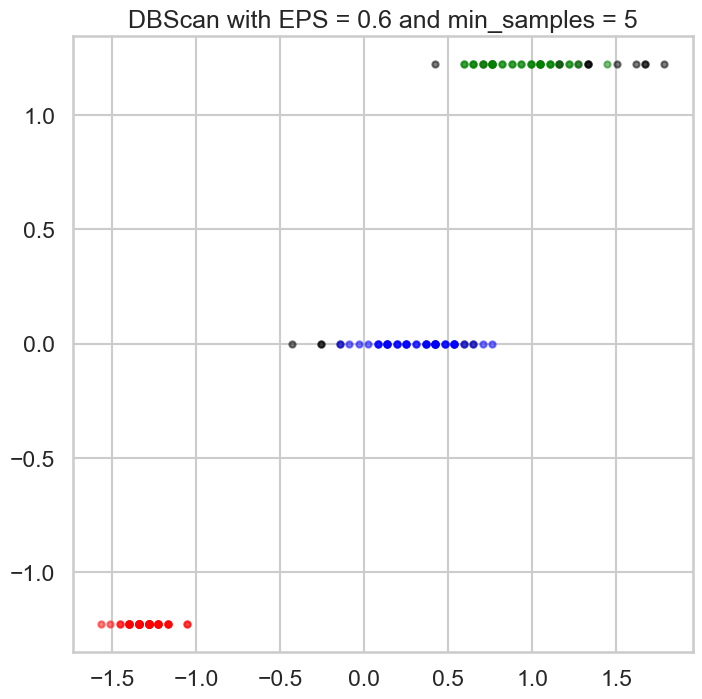

EPS: 0.6, Min Samples: 5, Silhouette Score: 0.367
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2 -1 -1  2  2  2  2 -1  2  2 -1 -1 -1
  2  2 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


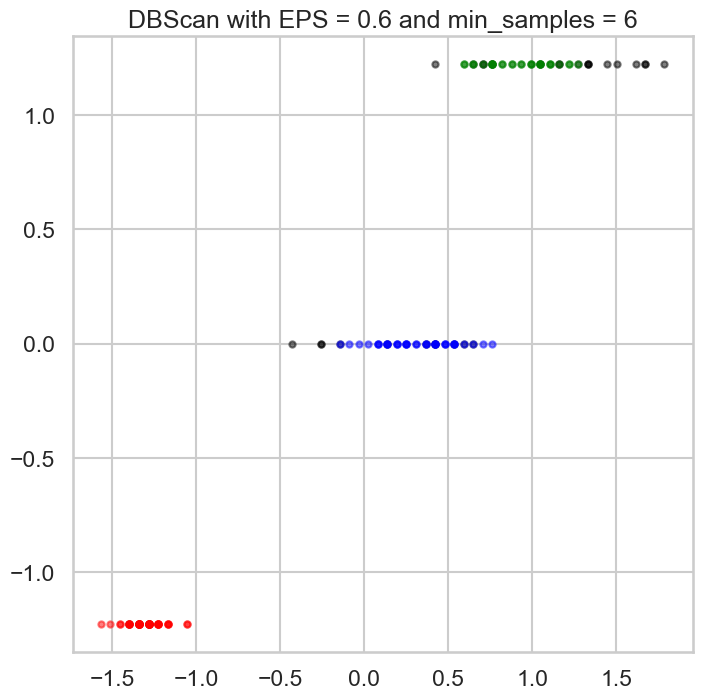

EPS: 0.6, Min Samples: 6, Silhouette Score: 0.354
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


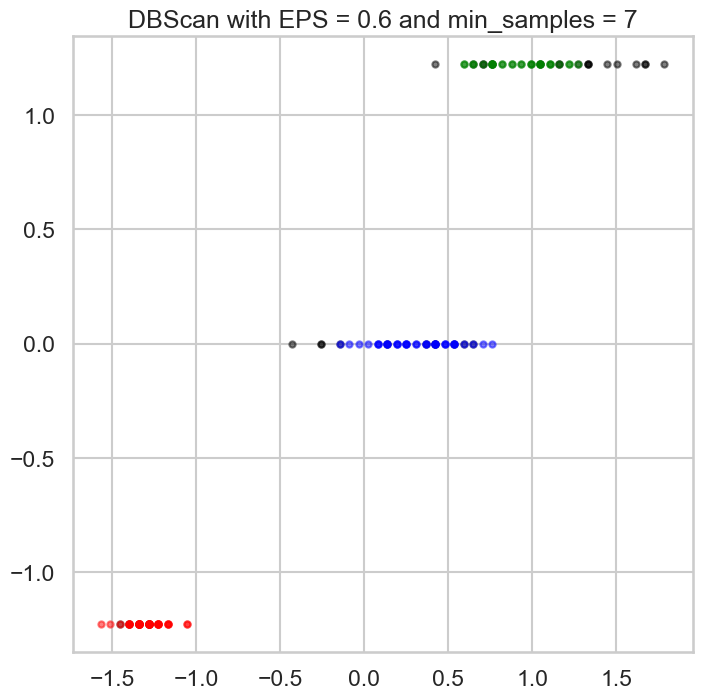

EPS: 0.6, Min Samples: 7, Silhouette Score: 0.346
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


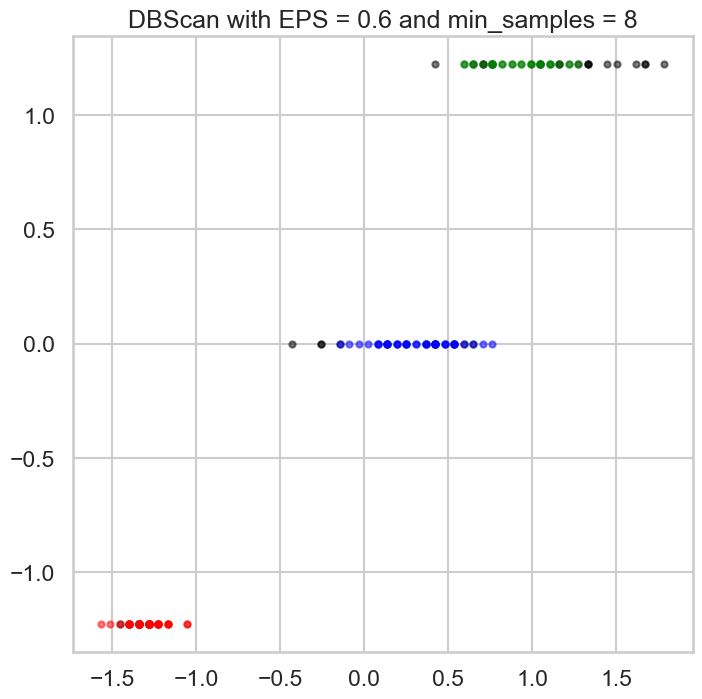

EPS: 0.6, Min Samples: 8, Silhouette Score: 0.346
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


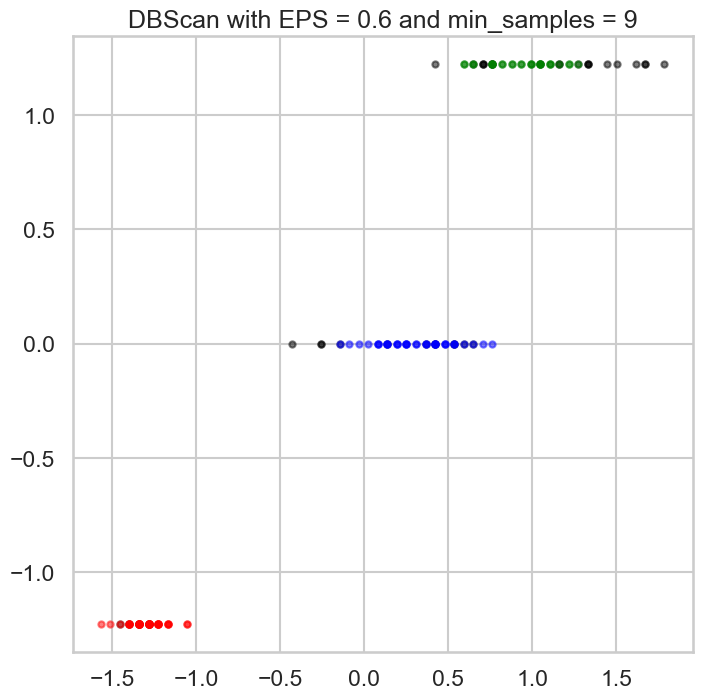

EPS: 0.6, Min Samples: 9, Silhouette Score: 0.336
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2 -1  2  2 -1]


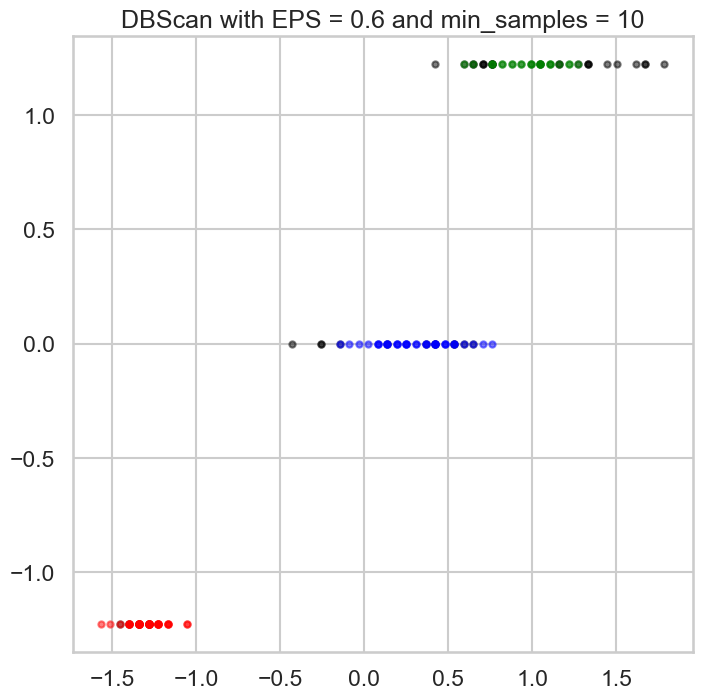

EPS: 0.6, Min Samples: 10, Silhouette Score: 0.324
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2 -1  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1 -1  2 -1  2  2  2 -1 -1 -1  2  2 -1 -1  2  2 -1  2  2  2 -1  2
  2  2 -1  2  2 -1]


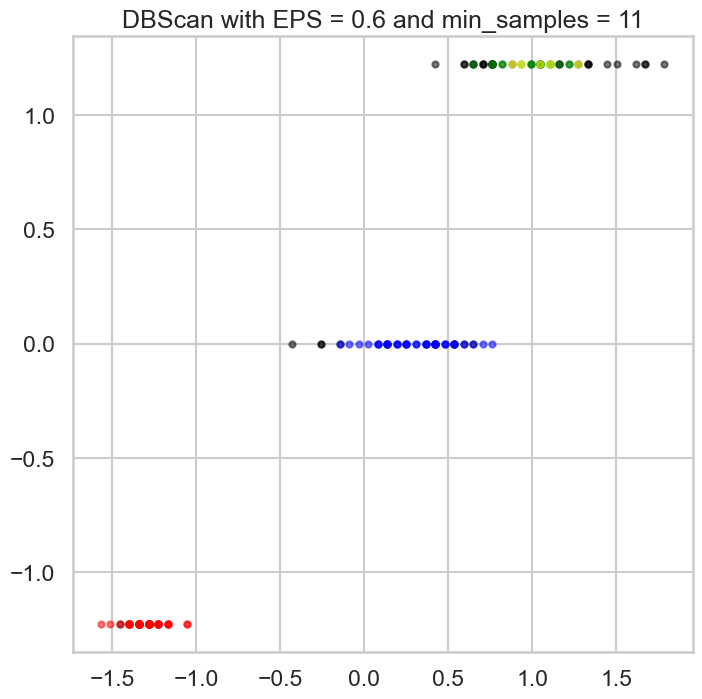

EPS: 0.6, Min Samples: 11, Silhouette Score: 0.255
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1 -1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  3 -1  2  2  2 -1 -1 -1 -1 -1  2 -1  2 -1 -1  3  2 -1 -1 -1
  2 -1 -1 -1  2 -1 -1  2  2 -1 -1 -1  2 -1 -1 -1  3  2 -1  2  2  2 -1  2
  3  2 -1  2  3 -1]


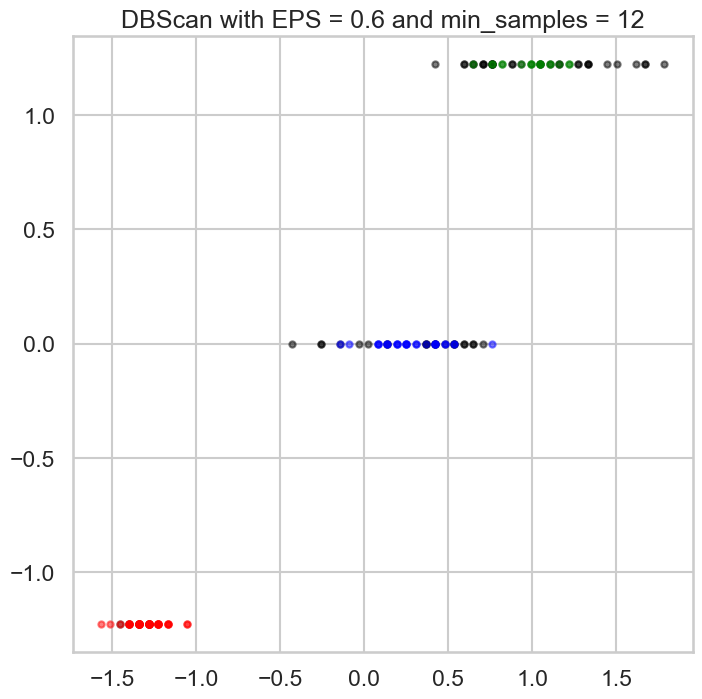

EPS: 0.6, Min Samples: 12, Silhouette Score: 0.230
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1  1  1 -1 -1 -1  1 -1  1 -1  1  1 -1  1  1 -1  1 -1  1
 -1  1  1 -1 -1 -1  1  1 -1 -1  1  1  1 -1 -1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1  2  2  2 -1 -1 -1 -1 -1  2 -1  2 -1 -1 -1  2 -1 -1 -1
  2 -1 -1 -1  2 -1 -1  2  2 -1 -1 -1  2 -1 -1 -1 -1  2 -1  2  2  2 -1  2
 -1  2 -1  2 -1 -1]


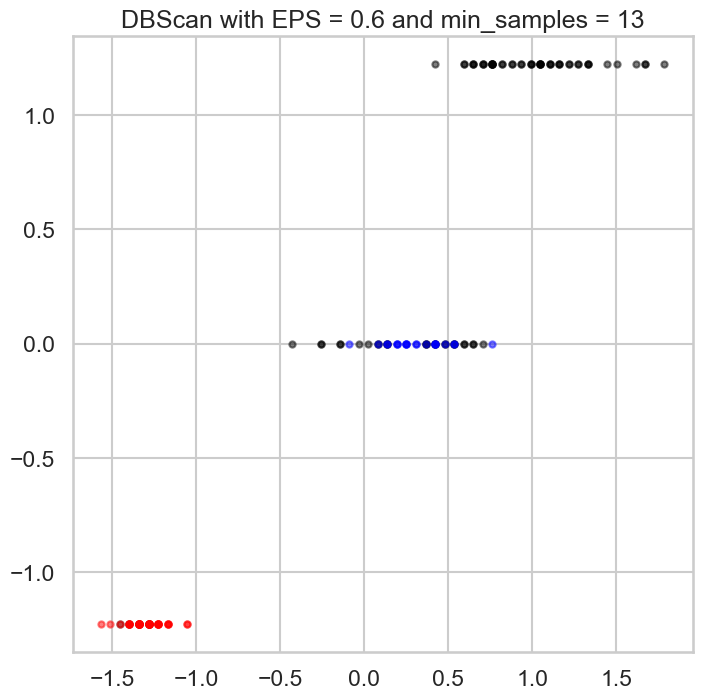

EPS: 0.6, Min Samples: 13, Silhouette Score: 0.233
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1  1  1 -1  1  1 -1 -1 -1  1
 -1  1  1 -1 -1 -1  1 -1 -1 -1  1  1  1 -1 -1 -1  1 -1  1  1  1 -1  1  1
  1  1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


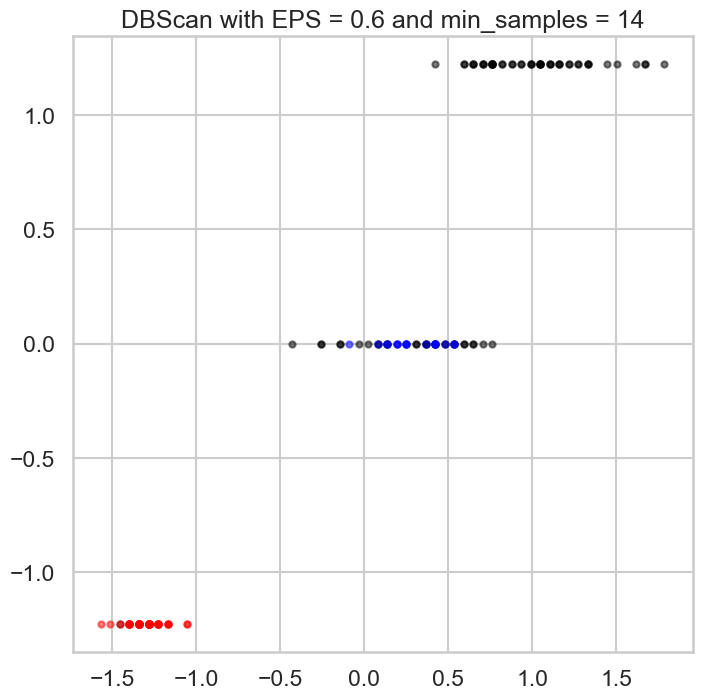

EPS: 0.6, Min Samples: 14, Silhouette Score: 0.216
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0 -1 -1 -1 -1 -1  1 -1 -1 -1 -1 -1  1 -1  1  1 -1  1  1 -1 -1 -1  1
 -1  1 -1 -1 -1 -1  1 -1 -1 -1  1 -1  1 -1 -1 -1  1 -1  1  1  1 -1  1  1
  1 -1 -1  1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1 -1
 -1 -1 -1 -1 -1 -1]


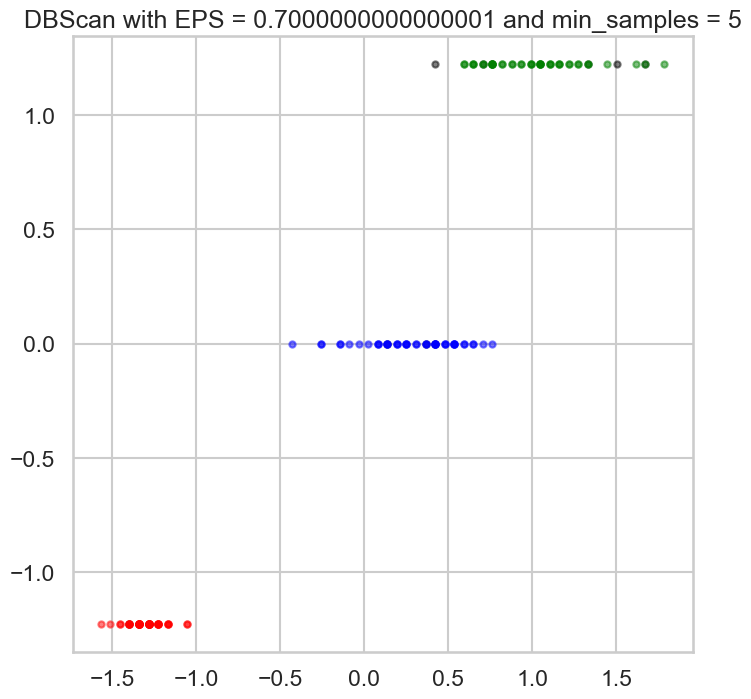

EPS: 0.7000000000000001, Min Samples: 5, Silhouette Score: 0.454
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


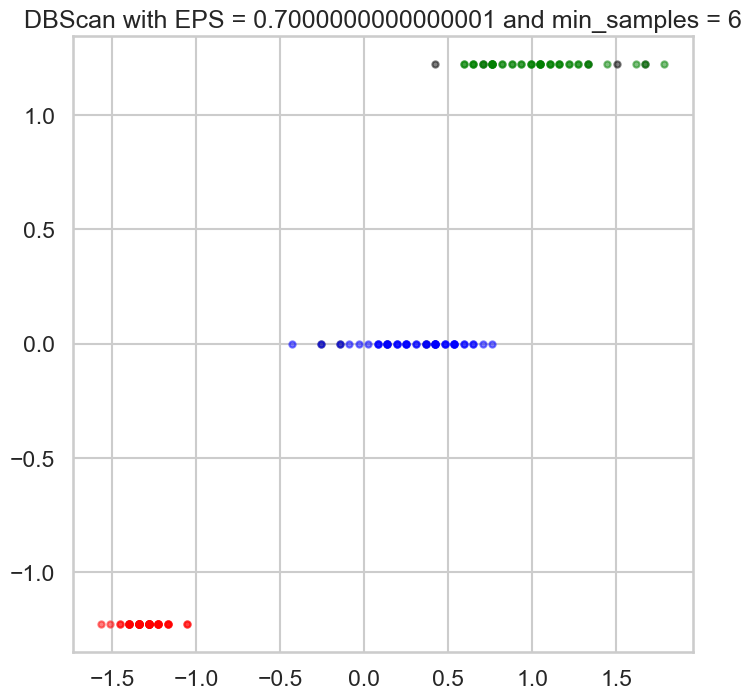

EPS: 0.7000000000000001, Min Samples: 6, Silhouette Score: 0.439
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


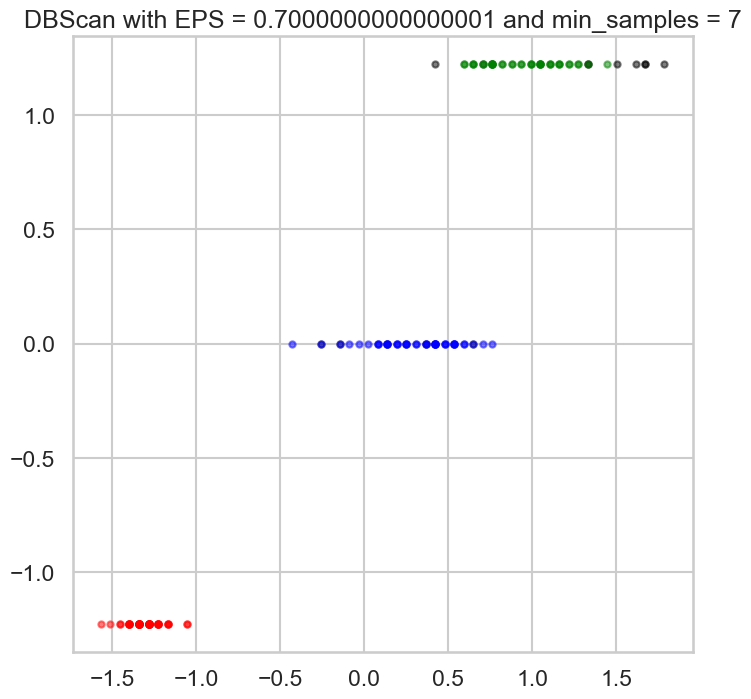

EPS: 0.7000000000000001, Min Samples: 7, Silhouette Score: 0.416
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


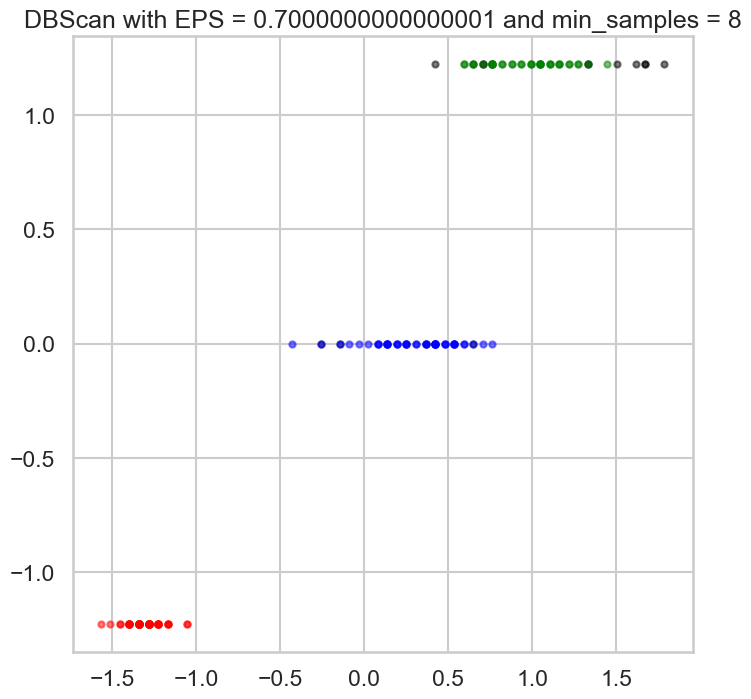

EPS: 0.7000000000000001, Min Samples: 8, Silhouette Score: 0.405
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2  2  2 -1  2  2  2 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


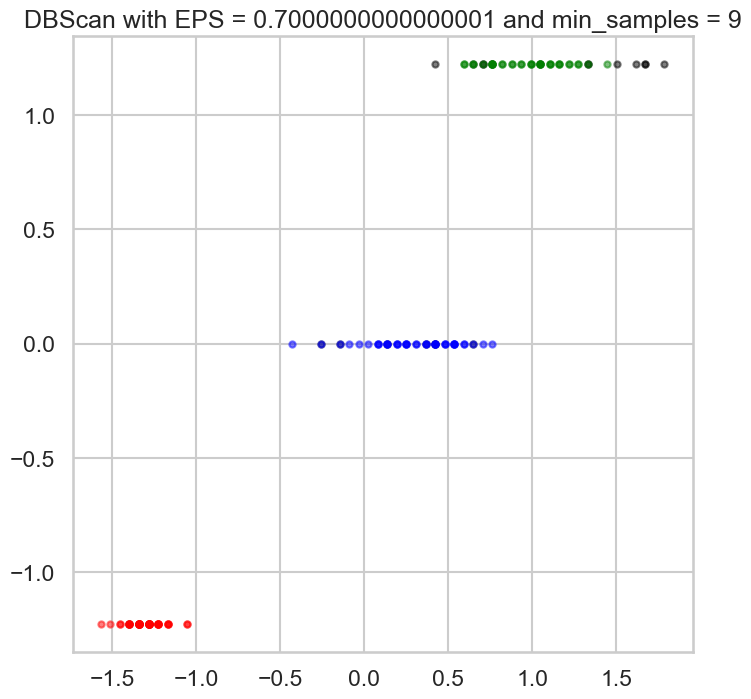

EPS: 0.7000000000000001, Min Samples: 9, Silhouette Score: 0.400
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2  2 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2  2  2 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


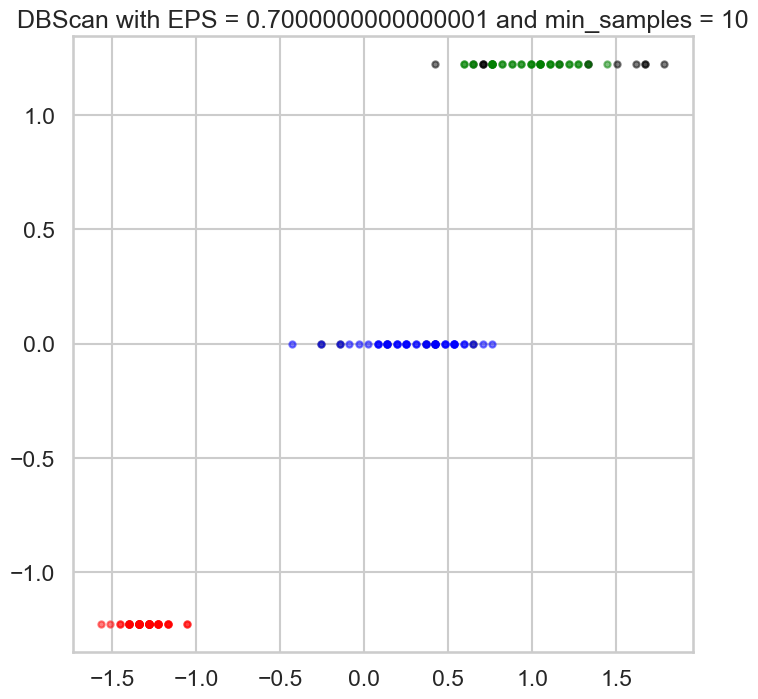

EPS: 0.7000000000000001, Min Samples: 10, Silhouette Score: 0.394
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2 -1 -1  2 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2  2  2 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2 -1  2  2  2]


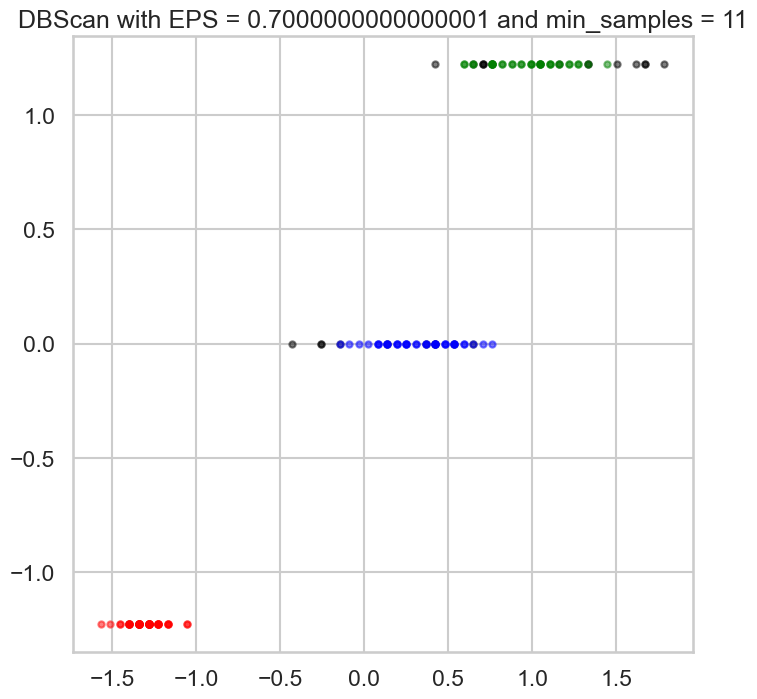

EPS: 0.7000000000000001, Min Samples: 11, Silhouette Score: 0.382
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2  2  2 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2 -1  2  2  2]


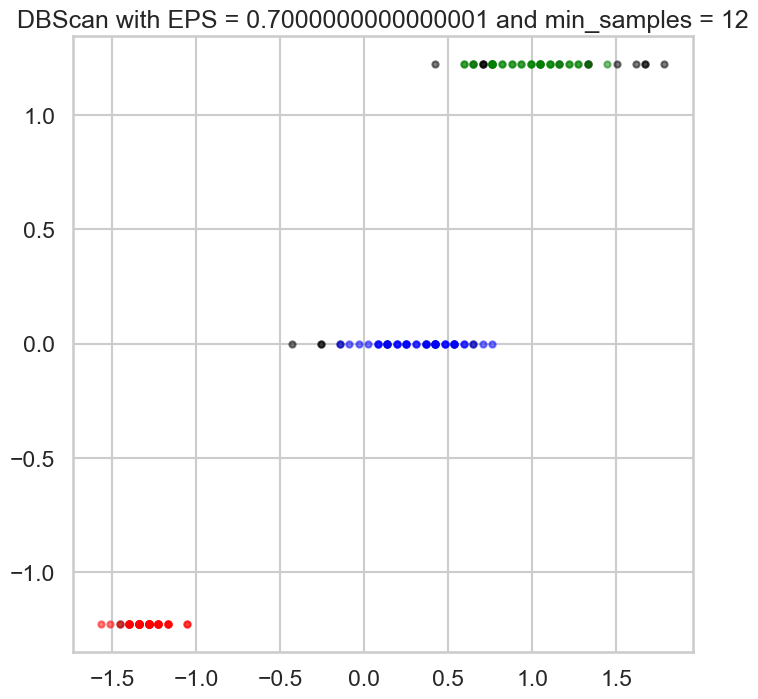

EPS: 0.7000000000000001, Min Samples: 12, Silhouette Score: 0.362
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1 -1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2  2  2  2  2 -1 -1  2 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2  2  2 -1  2  2 -1 -1  2  2  2  2  2  2  2  2
  2  2 -1  2  2  2]


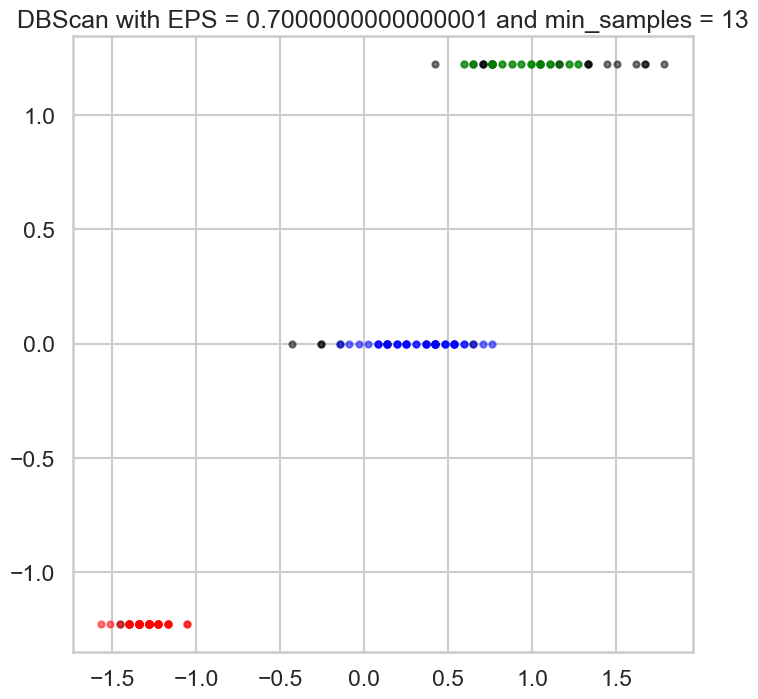

EPS: 0.7000000000000001, Min Samples: 13, Silhouette Score: 0.342
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1 -1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2 -1  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2 -1  2
  2  2 -1  2  2  2]


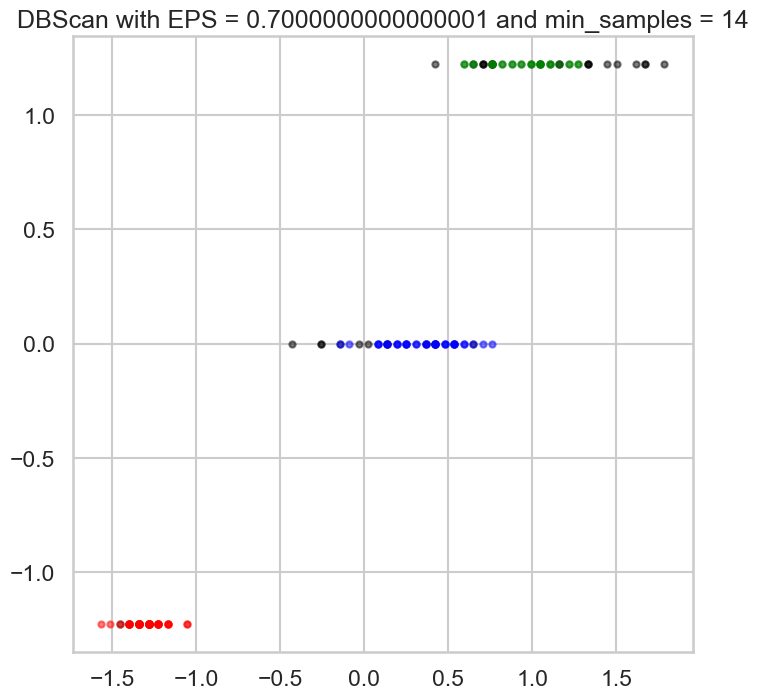

EPS: 0.7000000000000001, Min Samples: 14, Silhouette Score: 0.334
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1 -1  1  1 -1 -1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1  1
 -1  1  1  1  1  1  1  1 -1 -1  1  1  1 -1  1 -1  1  1  1  1  1 -1  1  1
  1  1 -1  1  2 -1  2  2  2 -1 -1 -1 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2 -1 -1  2  2  2  2  2  2 -1 -1 -1  2  2 -1 -1  2  2  2  2  2  2 -1  2
  2  2 -1  2  2  2]


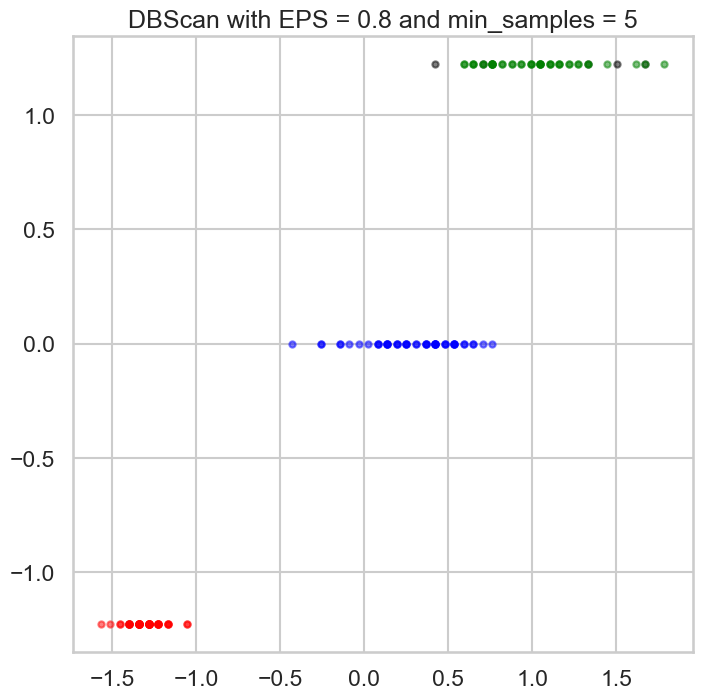

EPS: 0.8, Min Samples: 5, Silhouette Score: 0.474
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


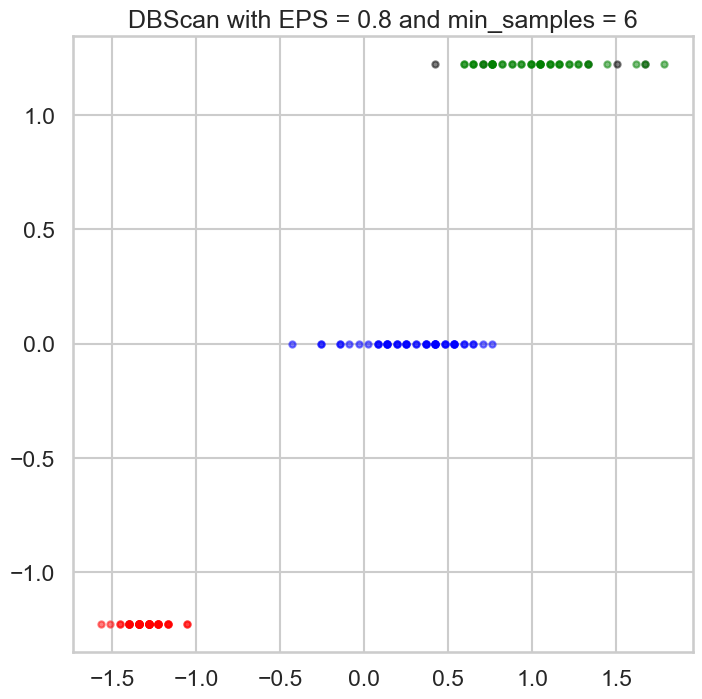

EPS: 0.8, Min Samples: 6, Silhouette Score: 0.474
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


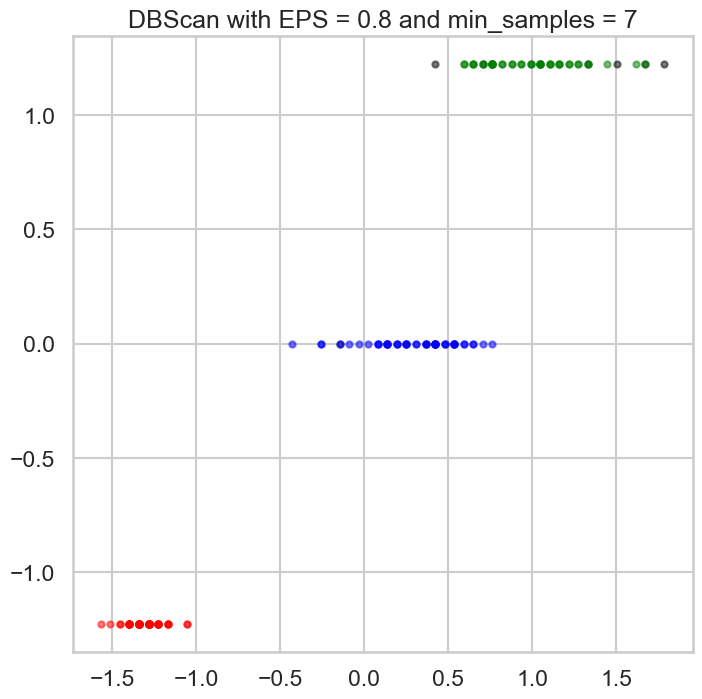

EPS: 0.8, Min Samples: 7, Silhouette Score: 0.450
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


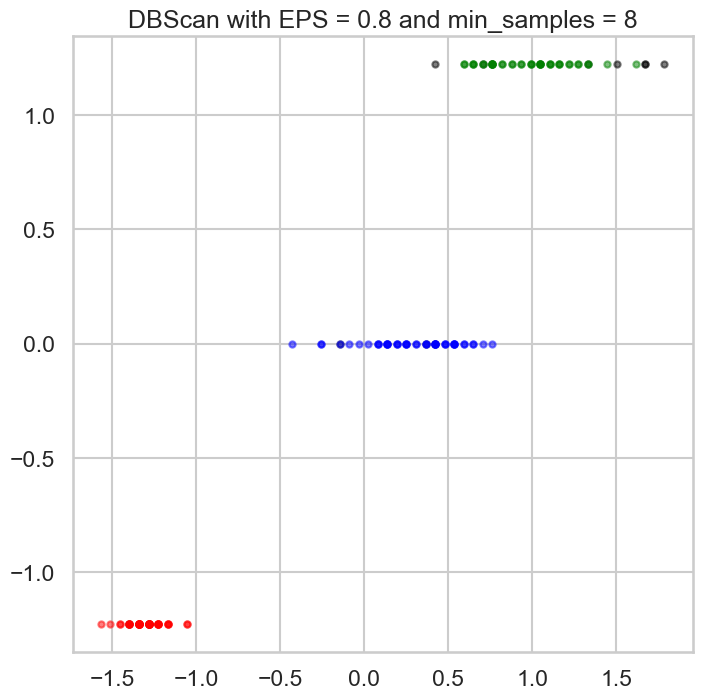

EPS: 0.8, Min Samples: 8, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


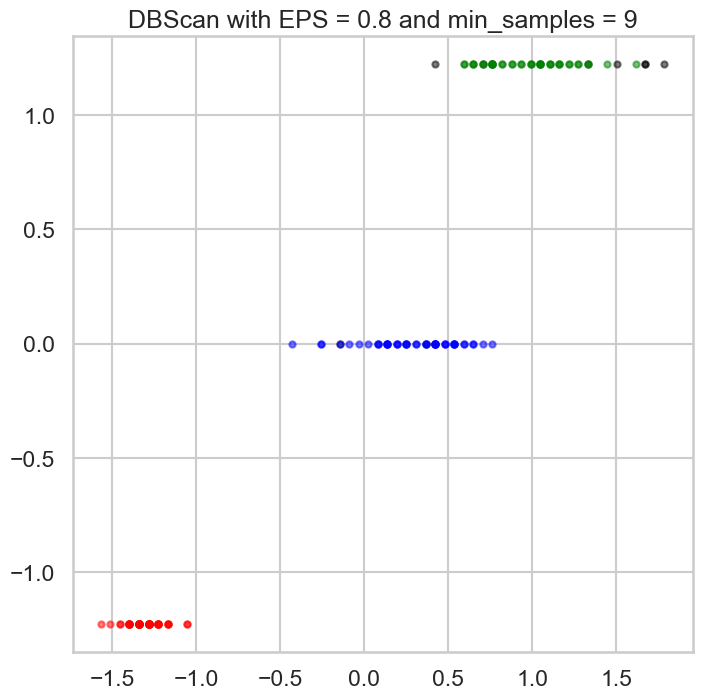

EPS: 0.8, Min Samples: 9, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


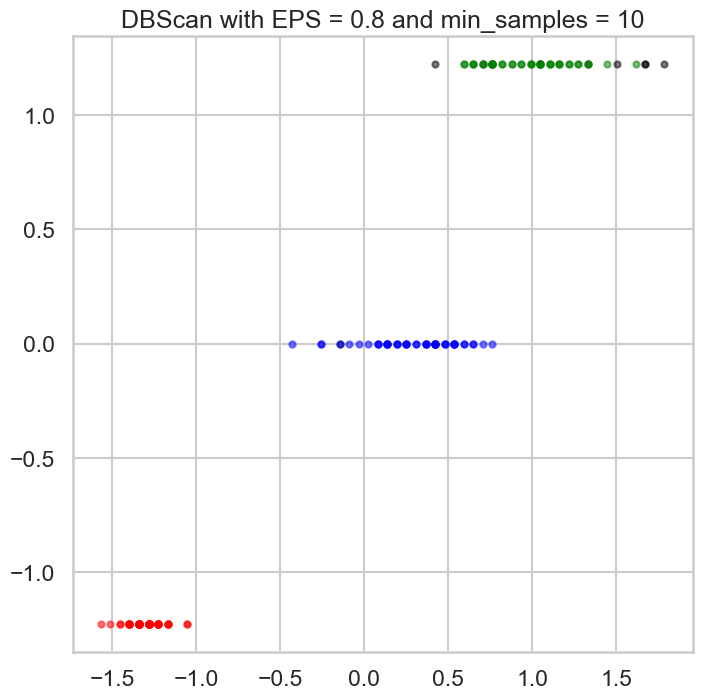

EPS: 0.8, Min Samples: 10, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


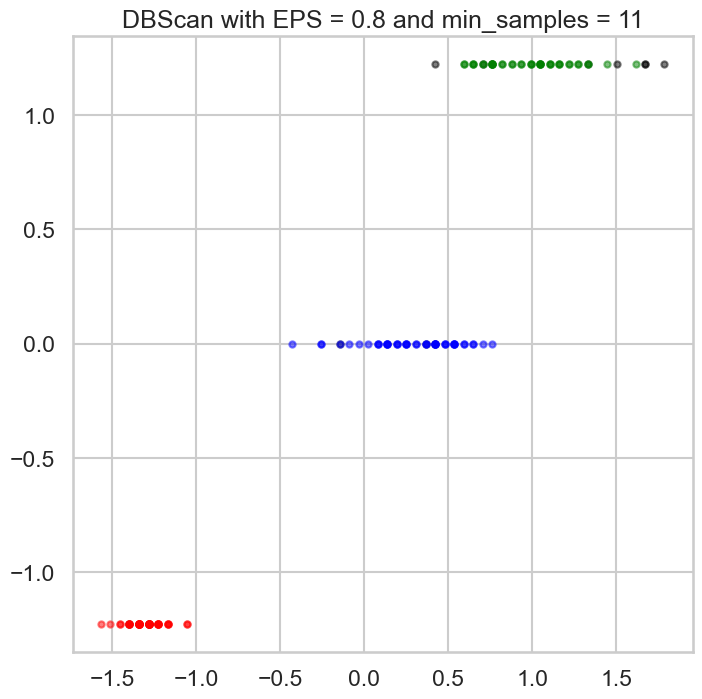

EPS: 0.8, Min Samples: 11, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


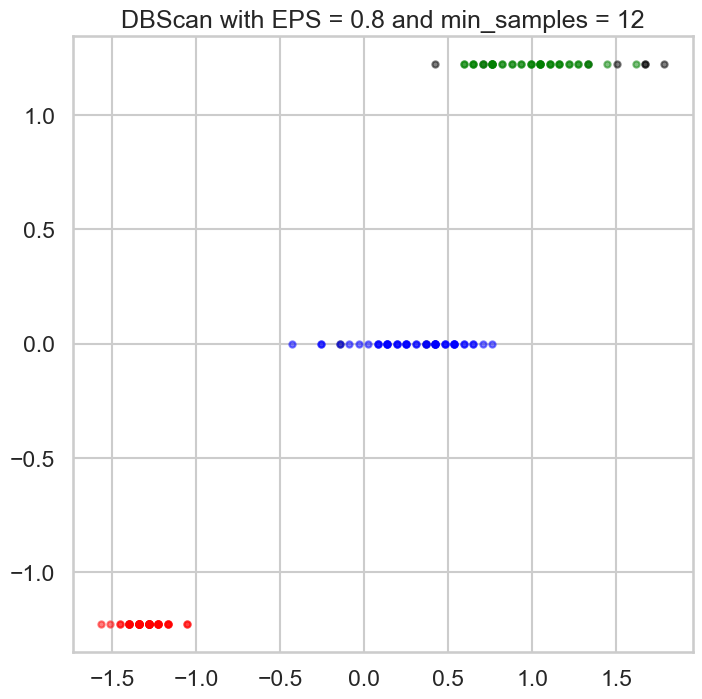

EPS: 0.8, Min Samples: 12, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


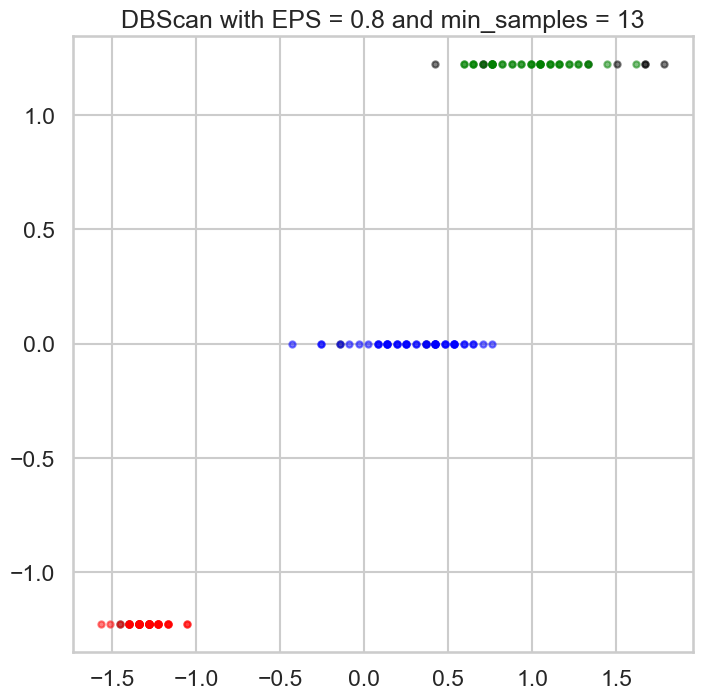

EPS: 0.8, Min Samples: 13, Silhouette Score: 0.424
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


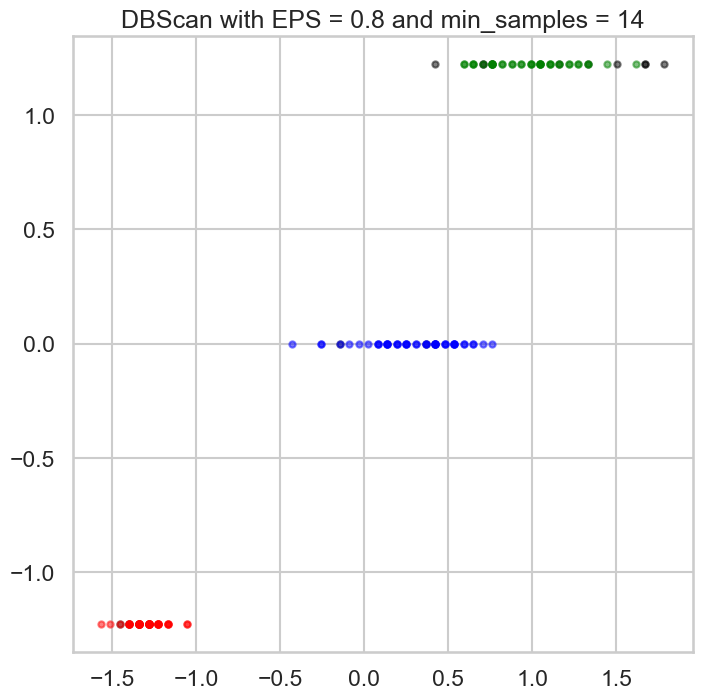

EPS: 0.8, Min Samples: 14, Silhouette Score: 0.420
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2 -1 -1  2  2  2 -1 -1  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


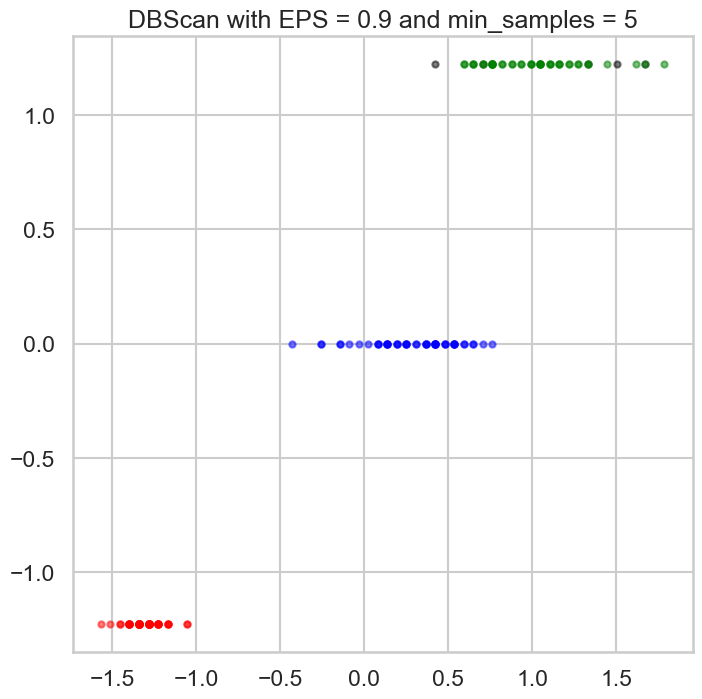

EPS: 0.9, Min Samples: 5, Silhouette Score: 0.474
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


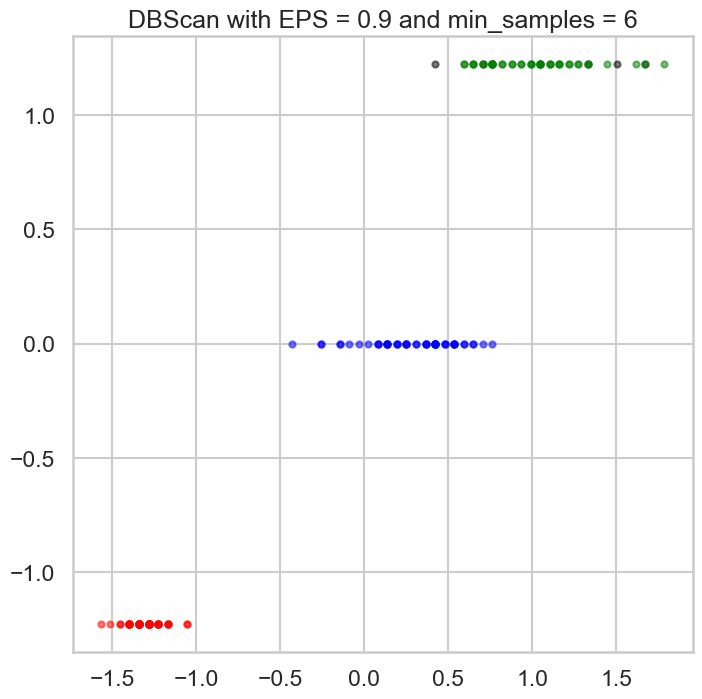

EPS: 0.9, Min Samples: 6, Silhouette Score: 0.474
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1  2 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


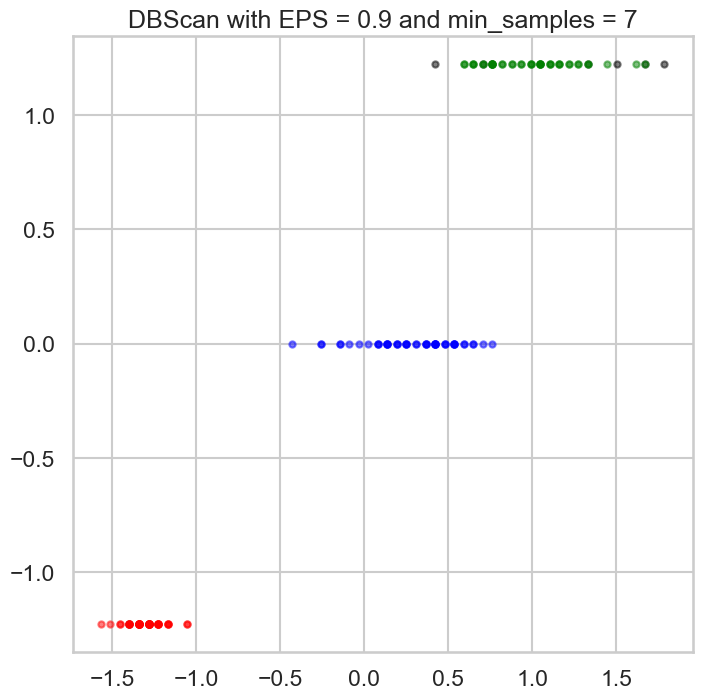

EPS: 0.9, Min Samples: 7, Silhouette Score: 0.463
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


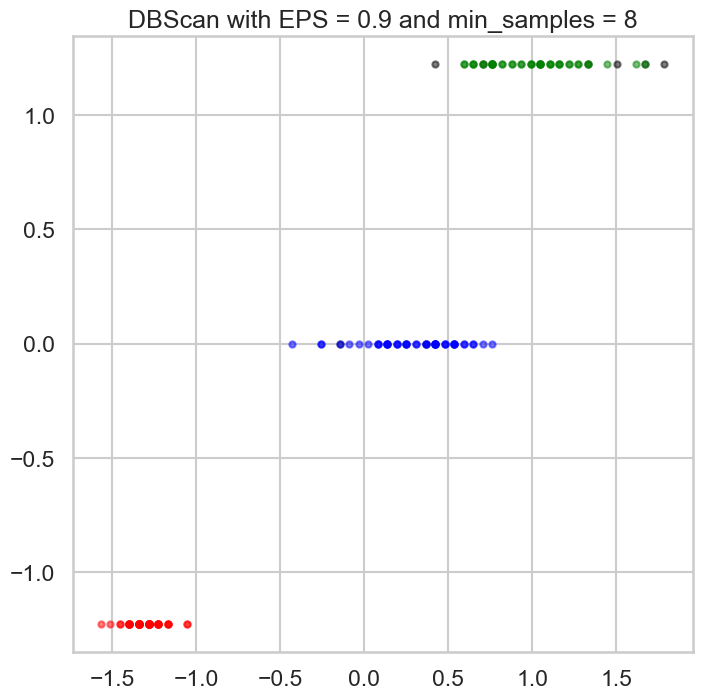

EPS: 0.9, Min Samples: 8, Silhouette Score: 0.450
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


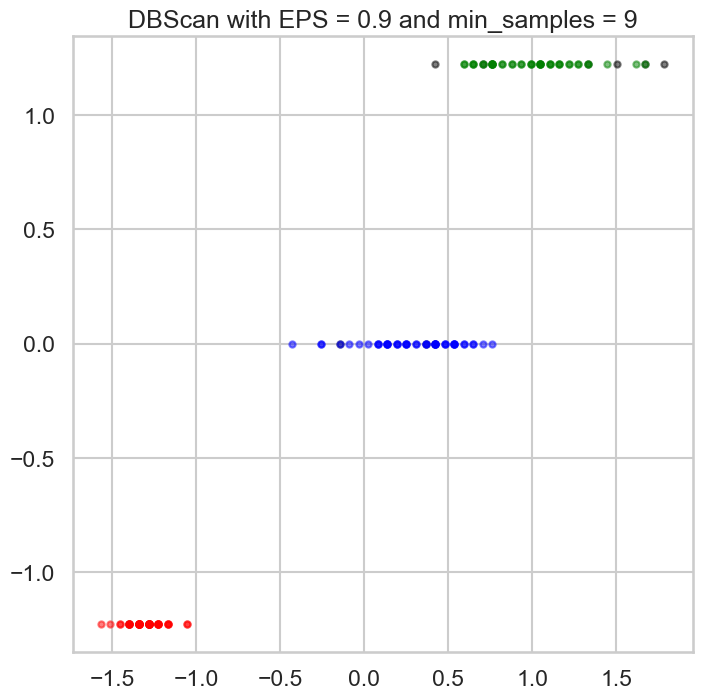

EPS: 0.9, Min Samples: 9, Silhouette Score: 0.450
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


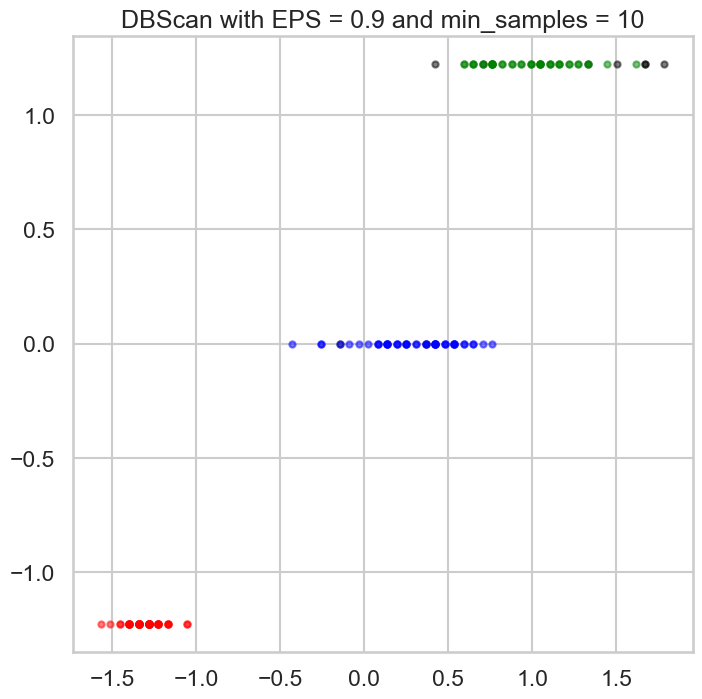

EPS: 0.9, Min Samples: 10, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


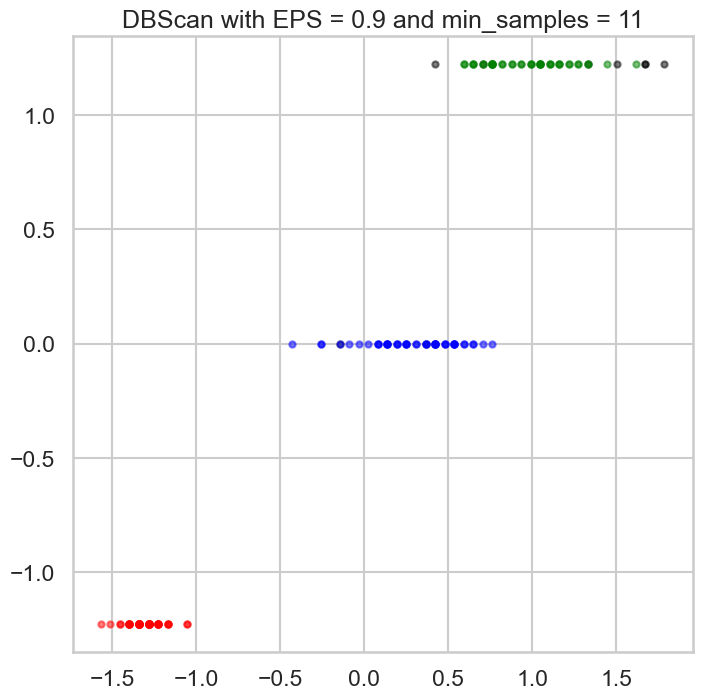

EPS: 0.9, Min Samples: 11, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


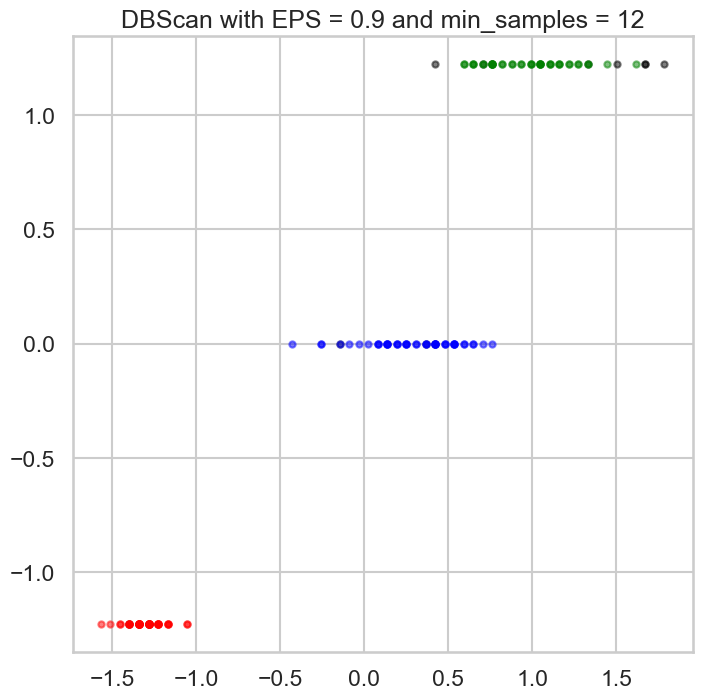

EPS: 0.9, Min Samples: 12, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


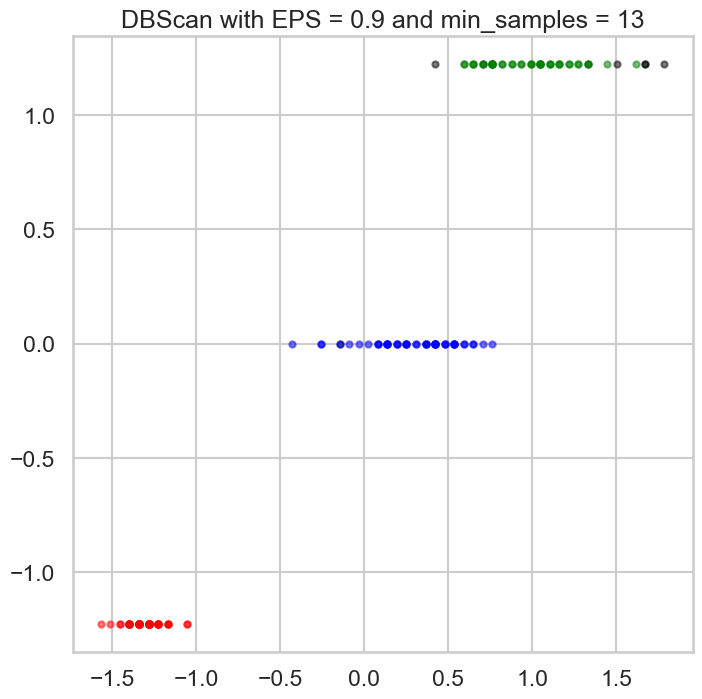

EPS: 0.9, Min Samples: 13, Silhouette Score: 0.446
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


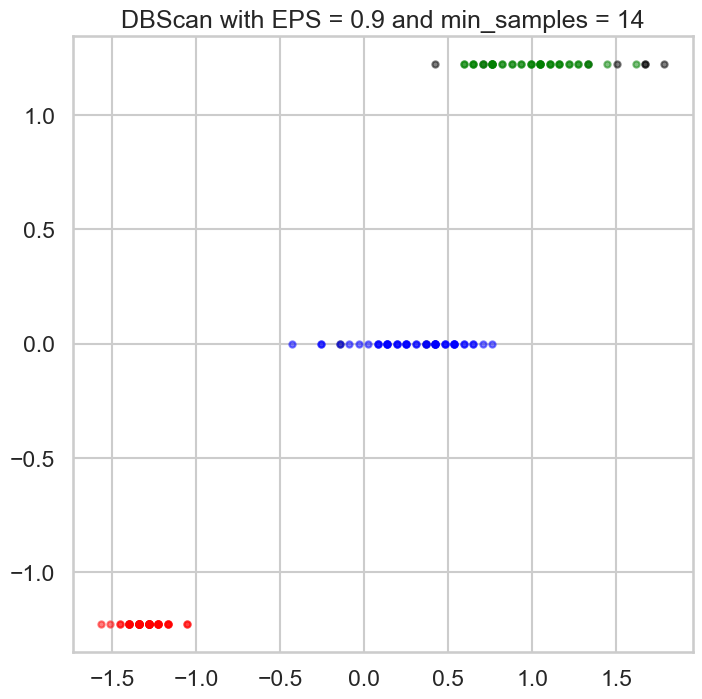

EPS: 0.9, Min Samples: 14, Silhouette Score: 0.438
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1 -1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2 -1  2  2  2  2  2  2  2 -1 -1 -1
  2  2 -1  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


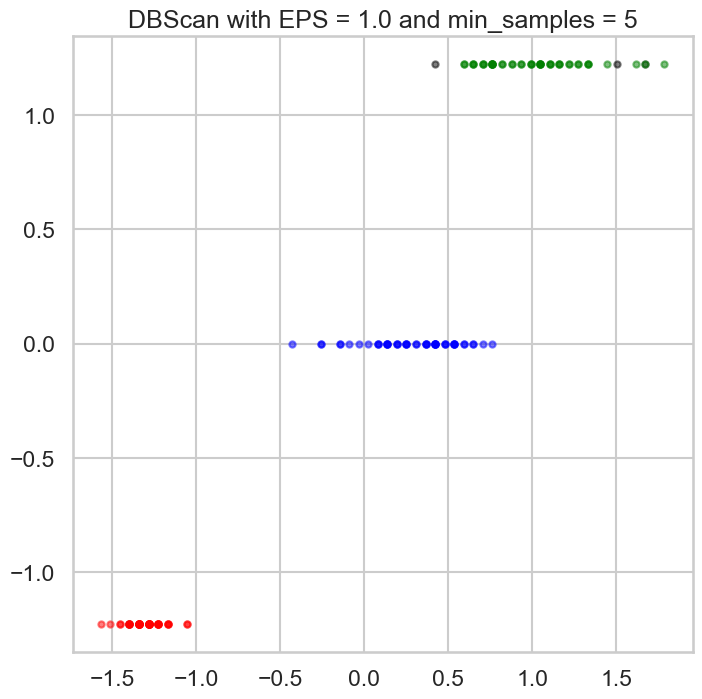

EPS: 1.0, Min Samples: 5, Silhouette Score: 0.477
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


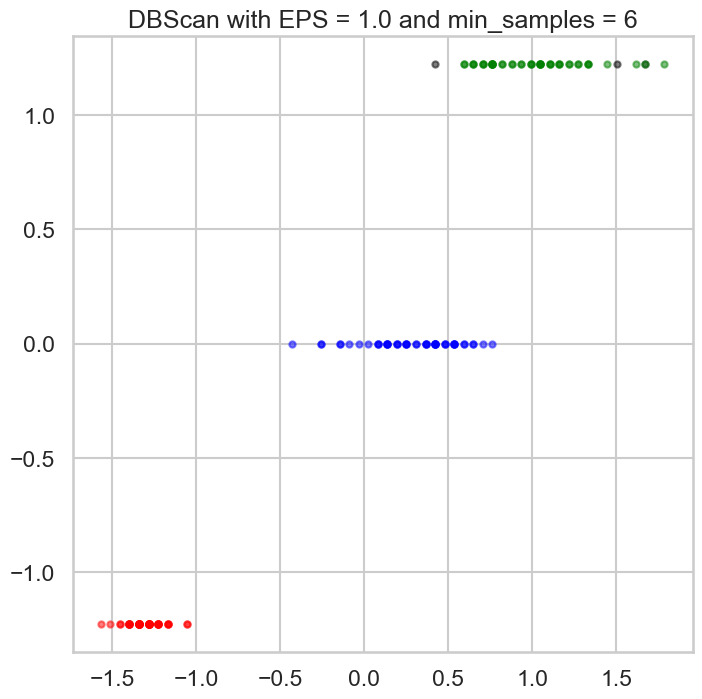

EPS: 1.0, Min Samples: 6, Silhouette Score: 0.477
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


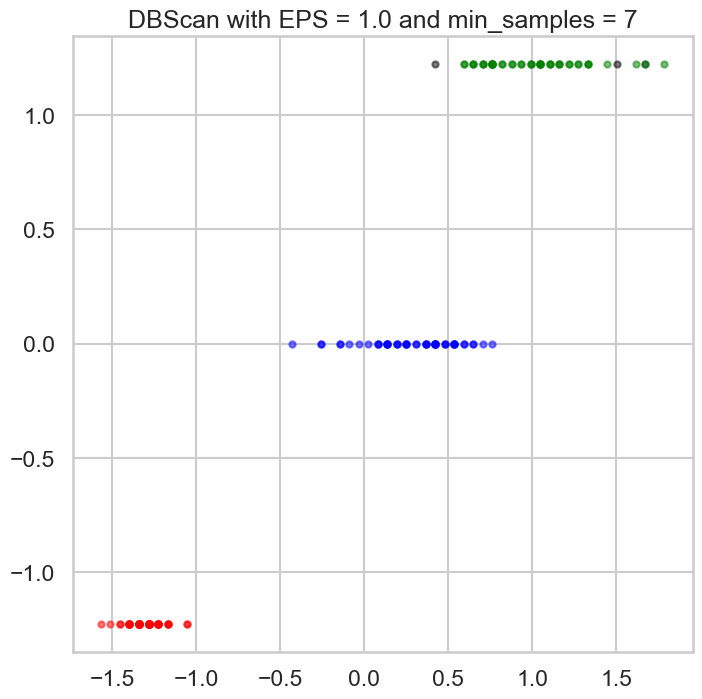

EPS: 1.0, Min Samples: 7, Silhouette Score: 0.477
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


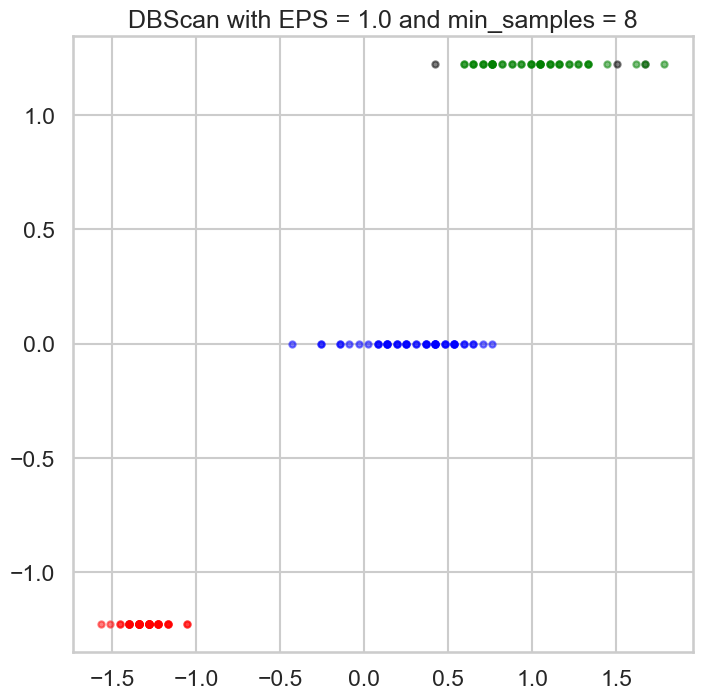

EPS: 1.0, Min Samples: 8, Silhouette Score: 0.477
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


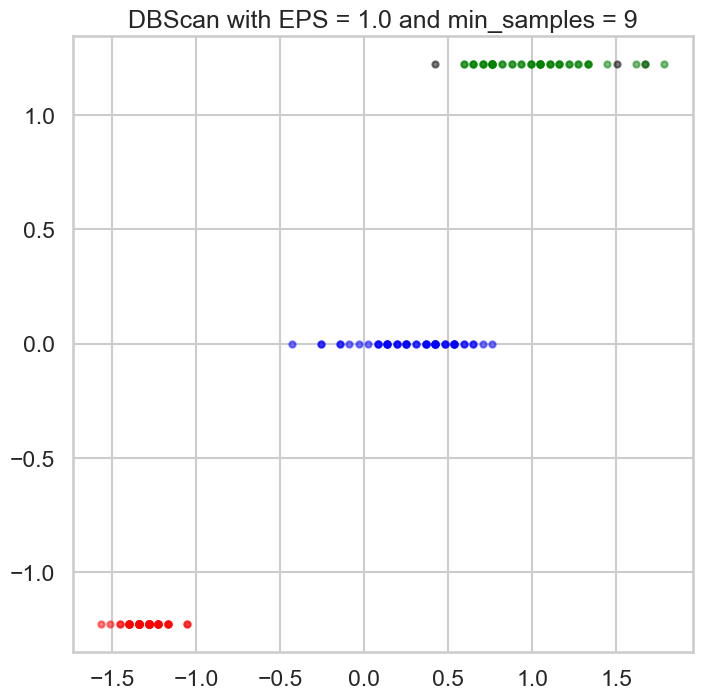

EPS: 1.0, Min Samples: 9, Silhouette Score: 0.477
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


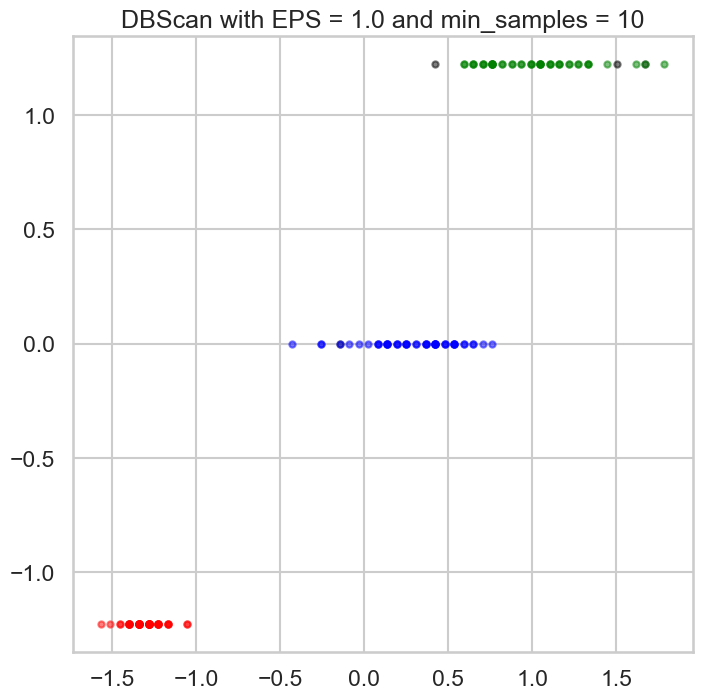

EPS: 1.0, Min Samples: 10, Silhouette Score: 0.473
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1  2  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


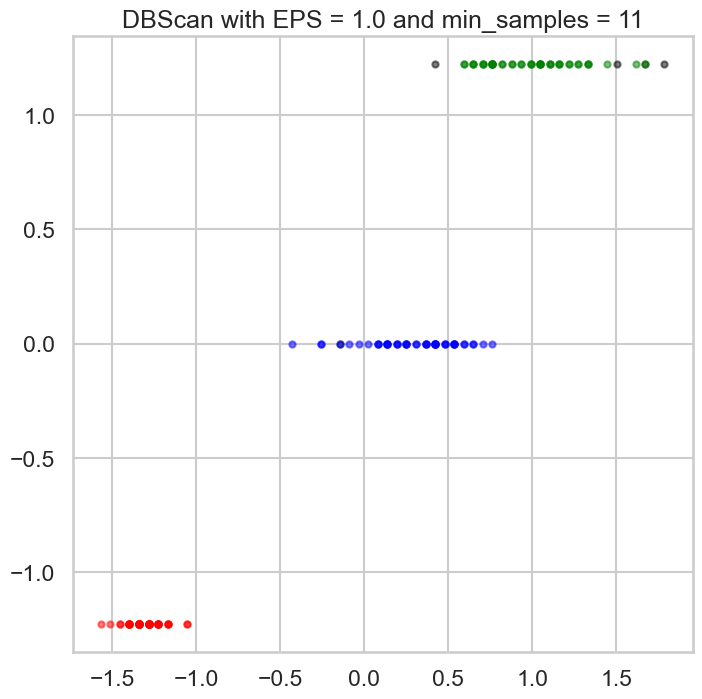

EPS: 1.0, Min Samples: 11, Silhouette Score: 0.468
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


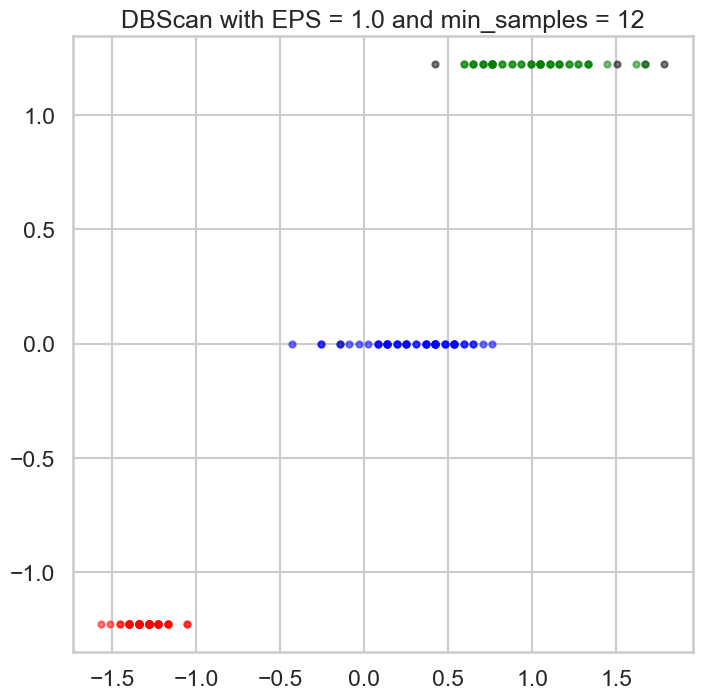

EPS: 1.0, Min Samples: 12, Silhouette Score: 0.468
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


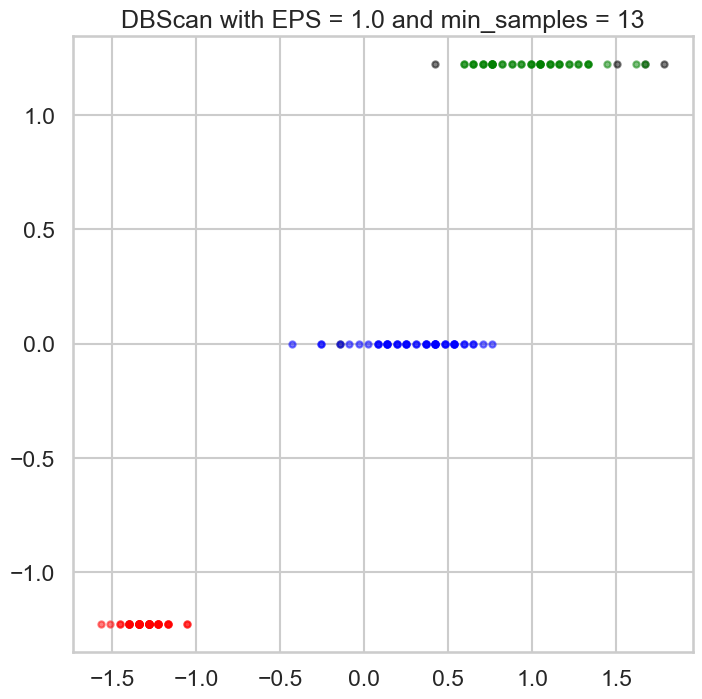

EPS: 1.0, Min Samples: 13, Silhouette Score: 0.463
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]


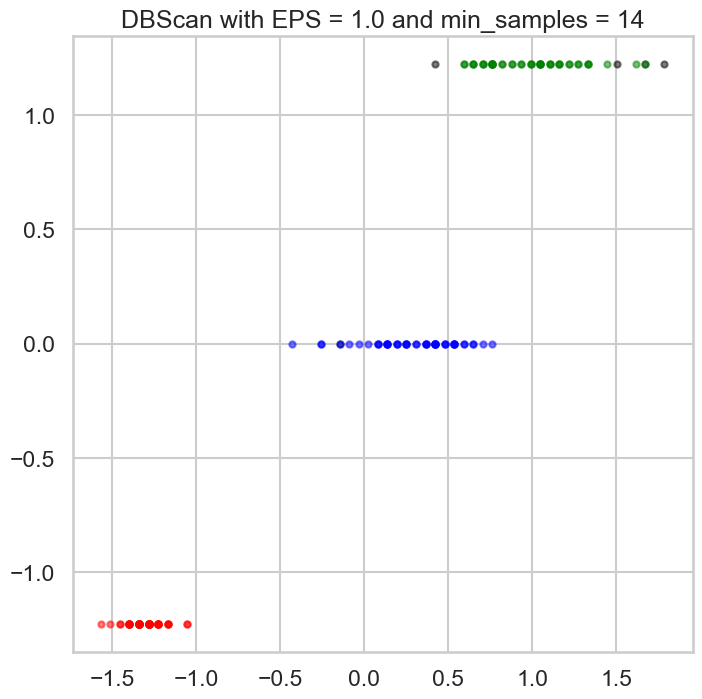

EPS: 1.0, Min Samples: 14, Silhouette Score: 0.463
[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0
  0  0  1  1  1  1  1  1  1  1  1  1 -1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1  1
  1  1  1  1  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2 -1 -1  2
  2  2  2  2  2  2  2  2  2  2  2 -1  2  2  2  2  2  2  2  2  2  2  2  2
  2  2  2  2  2  2]
Best Parameters: (1.0, 5), Silhouette Score: 0.477


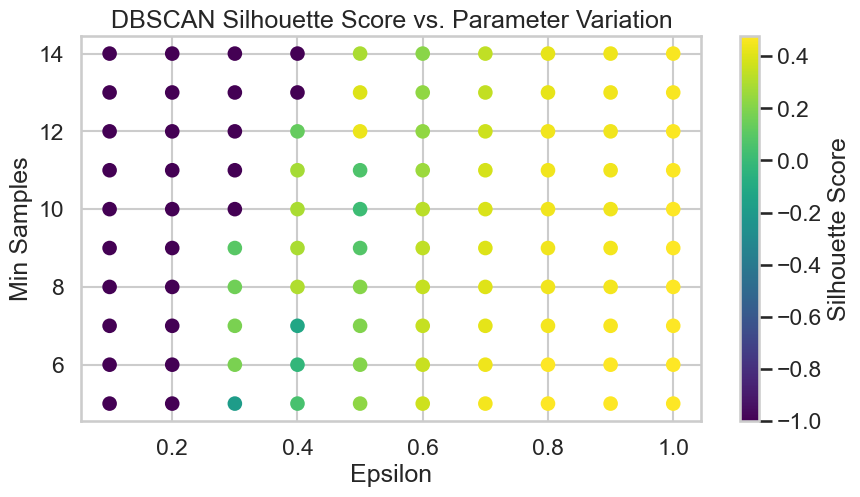

In [20]:
# Define parameters to try
eps_values = np.arange(0.1, 1.1, 0.1)
min_samples_values = range(5, 15,1)


# Store results
best_score = -1
best_params = None
all_scores = {}

# Try different parameters
for eps in eps_values:
    for min_samples in min_samples_values:
        try:
            # Perform DBSCAN clustering
            model = DBSCAN(eps=eps, min_samples=min_samples)
            model.fit(df_iris_norm)


            
            # Compute the silhouette score for the current clustering
            labels = model.labels_
            if len(np.unique(labels)) > 1: # Skip if there's only one cluster
                score = silhouette_score(df_iris_norm, labels)
            else:
                score = -1
            
            # Store results
            params = (eps, min_samples)
            all_scores[params] = score

            # Plot clusters
            plt.title(f'DBScan with EPS = {eps} and min_samples = {min_samples}')
            display_cluster(df_iris_norm[['petal length (cm)', 'target']].to_numpy(copy=True), model, len(np.unique(model.labels_)))
            plt.show()

            # Print resulting clusters
            print(f'EPS: {eps}, Min Samples: {min_samples}, Silhouette Score: {score:.3f}')
            print(model.labels_)

            # Update best score
            if score > best_score:
                best_score = score
                best_params = params
        except Exception as e:
            print(f"An error occurred: {e}")
            continue

# Print best parameters and score
print(f'Best Parameters: {best_params}, Silhouette Score: {best_score:.3f}')

# Plot silhouette score versus parameter variation
scores = [score for params, score in all_scores.items()]
params = list(all_scores.keys())
eps_values = [p[0] for p in params]
min_samples_values = [p[1] for p in params]

fig, ax = plt.subplots(figsize=(10, 5))
sc = ax.scatter(eps_values, min_samples_values, c=scores, cmap='viridis')
cbar = plt.colorbar(sc)
ax.set_xlabel('Epsilon')
ax.set_ylabel('Min Samples')
cbar.ax.set_ylabel('Silhouette Score')
plt.title('DBSCAN Silhouette Score vs. Parameter Variation')
plt.show()

Silhouette score for spherical: 0.4428547611030686


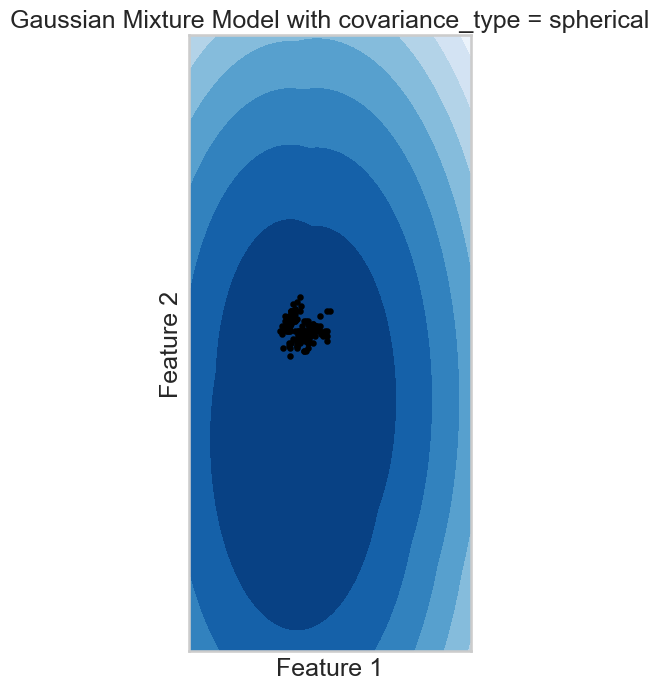

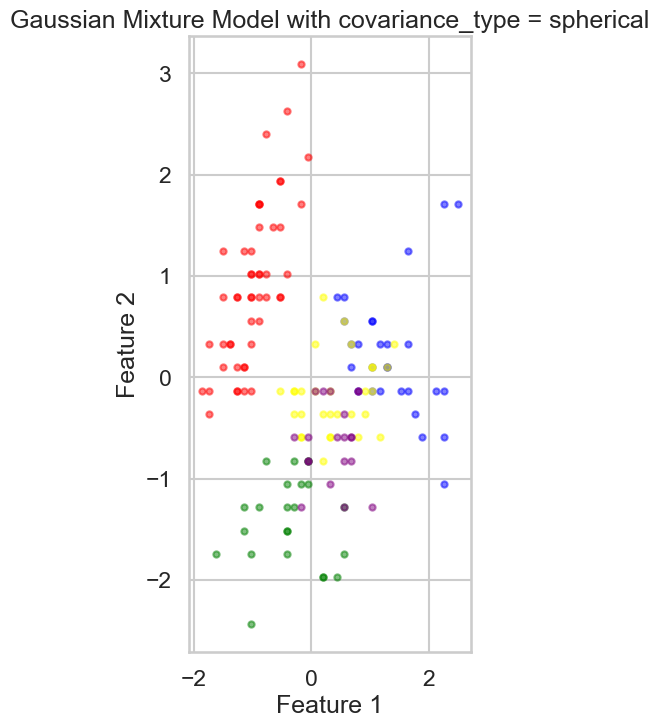

Silhouette score for diag: 0.3988994531598049


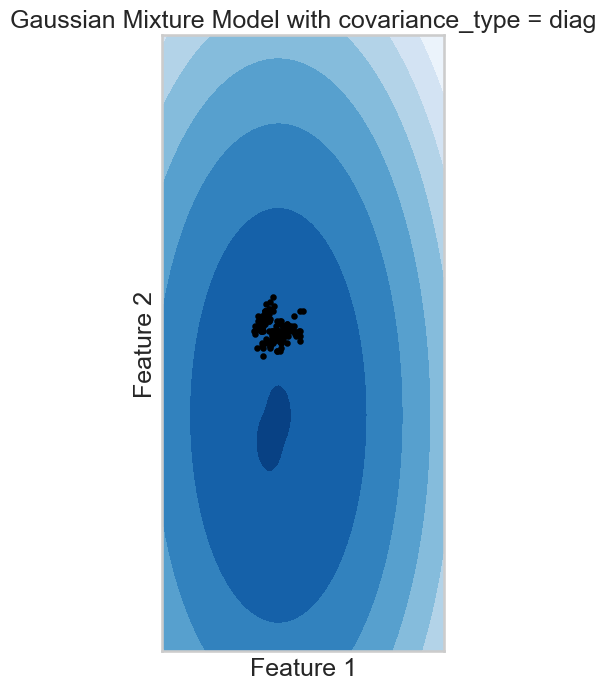

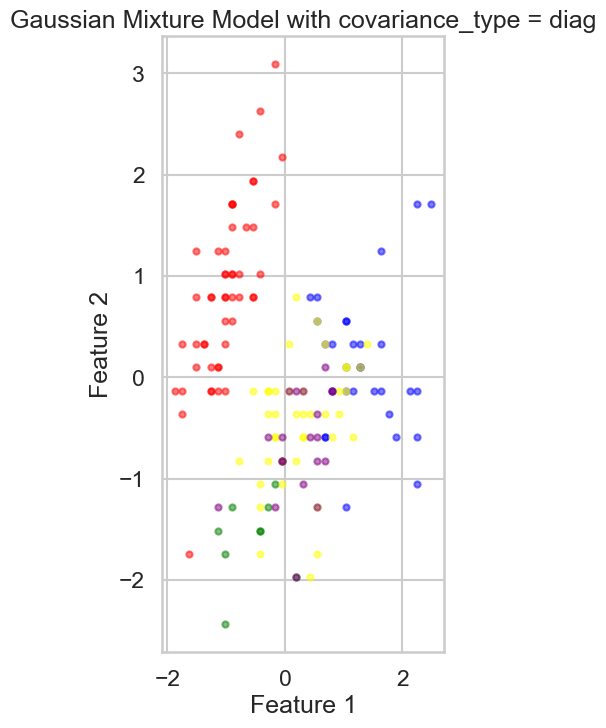

Silhouette score for tied: 0.3631164548656693


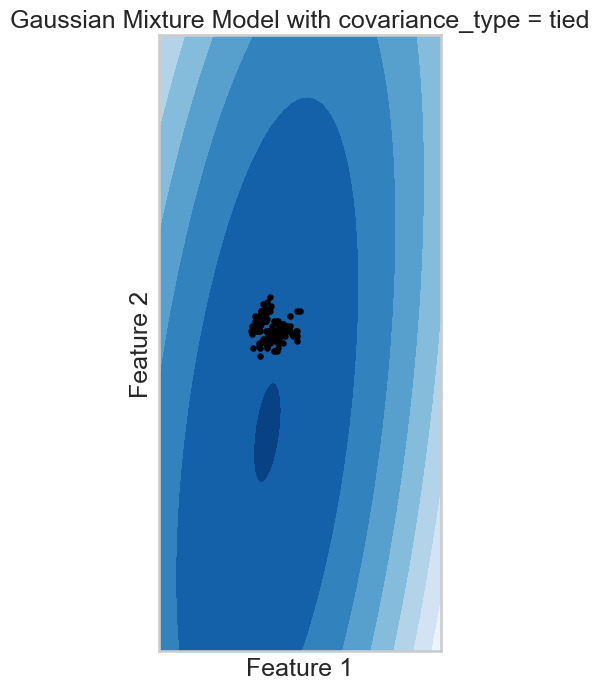

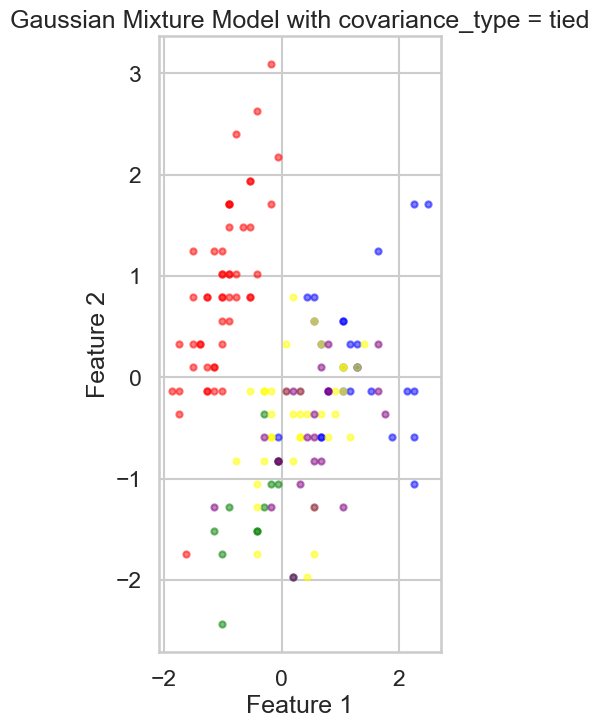

Silhouette score for full: 0.37006425727744535


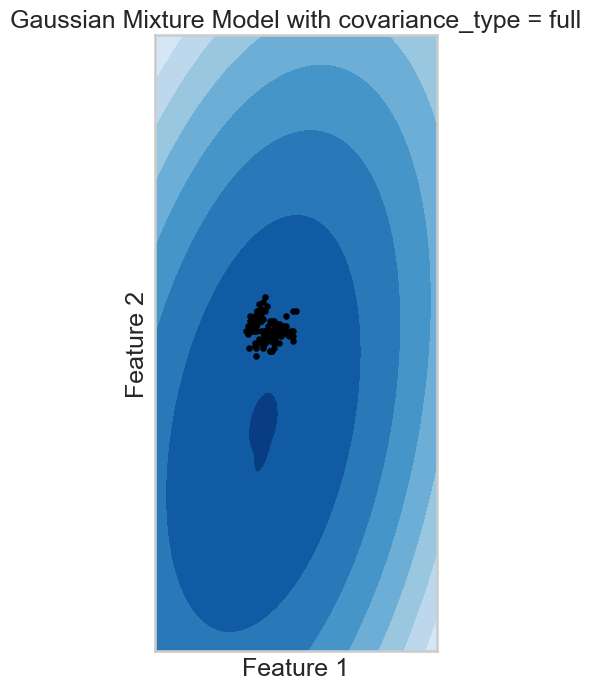

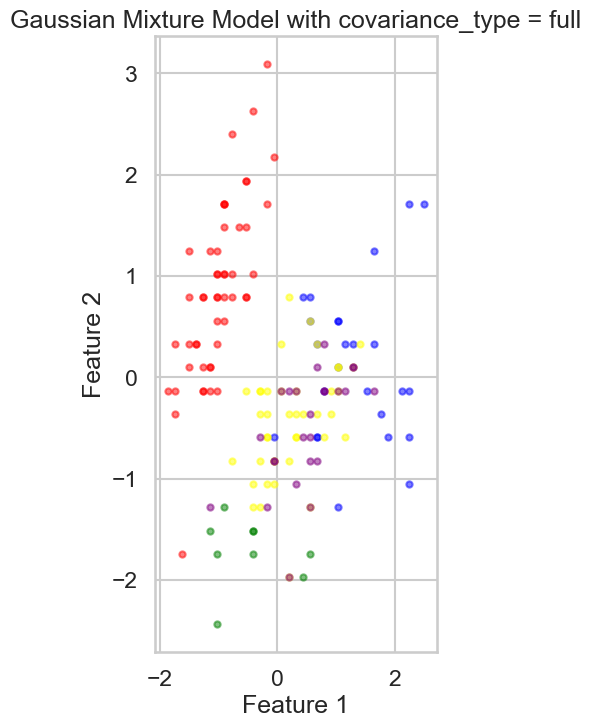

In [21]:
# Define covariance types to try
covariance_types = ['spherical', 'diag', 'tied', 'full']

# Define number of components
n_components = 5

# Loop over covariance types
for type in covariance_types:
    # Create GMM object and fit to data
    gmm = GaussianMixture(n_components=n_components, covariance_type=type, random_state=0)
    gmm.fit(df_iris_norm)
    
    # Get silhouette score
    labels = gmm.predict(df_iris_norm)
    score = silhouette_score(df_iris_norm, labels)
    print(f'Silhouette score for {type}: {score}')

    # Define the grid for the contour plot
    x_min, x_max = -10, 15
    y_min, y_max = -10, 15
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))
    Z = -gmm.score_samples(np.c_[xx.ravel(), yy.ravel(), np.zeros_like(xx.ravel()), np.zeros_like(xx.ravel()), np.zeros_like(xx.ravel())])
    Z = Z.reshape(xx.shape)

    # Create the contour plot
    plt.subplot(1, 2, 1)
    plt.contourf(xx, yy, Z, cmap=plt.cm.Blues_r)
    plt.scatter(df_iris_norm.iloc[:, 0], df_iris.iloc[:, 1], s=10, color='black')
    plt.title(f'Gaussian Mixture Model with covariance_type = {type}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xticks(())
    plt.yticks(())
    plt.show()


    # Display the scatter plot with highlighted clusters
    plt.subplot(1, 2, 2)
    display_cluster_gmm(df_iris_norm.iloc[:, :5].to_numpy(copy=True), gmm=gmm, num_clusters=n_components)
    plt.title(f'Gaussian Mixture Model with covariance_type = {type}')
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    
    plt.show()


## Customer dataset
Repeat all the above on the customer data set 